# LIBRARIES

In [1]:
import yfinance as yf

import pandas as pd 
import numpy as np 

import matplotlib
from matplotlib import pyplot as plt

import ta
import os
import glob
import time

# DATA PREP

## MAIN DATASET (HISTROCAL MARKET DATA)

### IMPORT

#### 1h DATA

In [2]:
path = r"C:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\Data\1h_data"
filenames = glob.glob(path + "\*.csv")

df = pd.DataFrame()
dataframes_1h = []

for file in filenames:   
   curr_symbol = os.path.basename(os.path.normpath(file))[3:-4]
   globals()["df_1h_{}".format(curr_symbol)] = pd.read_csv(file).iloc[:,1:]
   dataframes_1h.append(globals()["df_1h_{}".format(curr_symbol)])
   globals()["df_1h_{}".format(curr_symbol)].name = str("df_1h_{}".format(curr_symbol))

In [3]:
dataframes_1h[0].name

'df_1h_1INCHUSDT'

In [4]:
dataframes_1h

[            times  opens  highs   lows  closes    volumes
 0    1.648523e+12  1.751  1.760  1.743   1.754   179989.3
 1    1.648526e+12  1.755  1.781  1.754   1.779   159346.5
 2    1.648530e+12  1.779  1.796  1.777   1.791   273710.8
 3    1.648534e+12  1.791  1.800  1.782   1.787   185924.1
 4    1.648537e+12  1.787  1.789  1.774   1.774   189931.2
 ..            ...    ...    ...    ...     ...        ...
 995  1.652105e+12  1.312  1.313  1.287   1.292   579849.0
 996  1.652108e+12  1.291  1.304  1.283   1.302   683972.4
 997  1.652112e+12  1.301  1.360  1.283   1.299  2695223.2
 998  1.652116e+12  1.298  1.369  1.289   1.328  2877711.9
 999  1.652119e+12  1.328  1.340  1.308   1.318   538654.1
 
 [1000 rows x 6 columns],
             times    opens    highs     lows   closes     volumes
 0    1.648552e+12  14.2290  14.3797  14.1939  14.3237   375686.28
 1    1.648555e+12  14.3261  14.5437  14.2487  14.3831   813741.22
 2    1.648559e+12  14.3859  14.4400  14.0209  14.1430   804683

#### 15m DATA

In [5]:
path = r"C:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\Data\15m_data"
filenames = glob.glob(path + "\*.csv")

df = pd.DataFrame()
dataframes_15m = []

for file in filenames:   
   curr_symbol = os.path.basename(os.path.normpath(file))[3:-4]
   globals()["df_15m_{}".format(curr_symbol)] = pd.read_csv(file).iloc[:,1:]
   dataframes_15m.append(globals()["df_15m_{}".format(curr_symbol)])
   globals()["df_15m_{}".format(curr_symbol)].name = str("df_15m_{}".format(curr_symbol))

In [6]:
dataframes_15m[0].name

'df_15m__1INCHUSDT'

In [7]:
dataframes_15m

[            times  opens  highs   lows  closes   volumes
 0    1.651220e+12  1.304  1.308  1.300   1.303   54651.9
 1    1.651221e+12  1.303  1.303  1.292   1.296   18456.6
 2    1.651222e+12  1.296  1.297  1.290   1.294   44238.8
 3    1.651223e+12  1.292  1.292  1.282   1.286   30406.9
 4    1.651224e+12  1.286  1.288  1.279   1.283   66969.3
 ..            ...    ...    ...    ...     ...       ...
 995  1.652116e+12  1.298  1.322  1.289   1.310  650204.1
 996  1.652116e+12  1.309  1.344  1.306   1.344  721999.8
 997  1.652117e+12  1.345  1.369  1.330   1.363  793215.2
 998  1.652118e+12  1.364  1.369  1.324   1.328  712292.8
 999  1.652119e+12  1.328  1.340  1.308   1.318  537111.9
 
 [1000 rows x 6 columns],
             times    opens    highs     lows   closes    volumes
 0    1.651250e+12  22.4113  22.4121  21.9549  22.2053  755483.77
 1    1.651251e+12  22.2125  22.4253  21.9300  22.2022  534404.07
 2    1.651252e+12  22.2084  22.5362  22.1649  22.5168  380247.26
 3    1.6512

### FIRST GLANCE

#### 1h DATA

In [8]:
for curr_df in dataframes_1h:
    print(curr_df.head())

          times  opens  highs   lows  closes   volumes
0  1.648523e+12  1.751  1.760  1.743   1.754  179989.3
1  1.648526e+12  1.755  1.781  1.754   1.779  159346.5
2  1.648530e+12  1.779  1.796  1.777   1.791  273710.8
3  1.648534e+12  1.791  1.800  1.782   1.787  185924.1
4  1.648537e+12  1.787  1.789  1.774   1.774  189931.2
          times    opens    highs     lows   closes     volumes
0  1.648552e+12  14.2290  14.3797  14.1939  14.3237   375686.28
1  1.648555e+12  14.3261  14.5437  14.2487  14.3831   813741.22
2  1.648559e+12  14.3859  14.4400  14.0209  14.1430   804683.95
3  1.648562e+12  14.1400  14.2422  14.0636  14.1302   697470.05
4  1.648566e+12  14.1310  14.2800  13.7090  13.8464  1194288.90
          times  opens  highs   lows  closes      volumes
0  1.582027e+12  16.52  16.77  16.44   16.77   3306.94534
1  1.582031e+12  16.75  17.00  16.67   16.86   8057.93437
2  1.582034e+12  16.85  16.89  16.47   16.56   3379.03554
3  1.582038e+12  16.47  16.48  15.61   15.74  13504.95

In [9]:
for curr_df in dataframes_1h:
    print(curr_df.describe().T)

          count          mean           std           min           25%  \
times    1000.0  1.650321e+12  1.039750e+09  1.648523e+12  1.649422e+12   
opens    1000.0  1.510649e+00  2.255260e-01  1.104000e+00  1.315000e+00   
highs    1000.0  1.522275e+00  2.278012e-01  1.117000e+00  1.325750e+00   
lows     1000.0  1.498237e+00  2.229841e-01  1.071000e+00  1.302000e+00   
closes   1000.0  1.510234e+00  2.255116e-01  1.103000e+00  1.315000e+00   
volumes  1000.0  3.199812e+05  5.066432e+05  1.793680e+04  1.002712e+05   

                  50%           75%           max  
times    1.650321e+12  1.651220e+12  1.652119e+12  
opens    1.500000e+00  1.641250e+00  2.052000e+00  
highs    1.509500e+00  1.652250e+00  2.100000e+00  
lows     1.492000e+00  1.630000e+00  1.994000e+00  
closes   1.500000e+00  1.642000e+00  2.052000e+00  
volumes  1.776568e+05  3.183672e+05  6.367546e+06  
          count          mean           std           min           25%  \
times    1000.0  1.650350e+12  1.03

In [10]:
for curr_df in dataframes_1h:
    print(curr_df.isnull().values.any())

False
False
False
False
False
False
False
False
False
False
False
False
False
False
False


#### 15m DATA

In [11]:
for curr_df in dataframes_15m:
    print(curr_df.head())

          times  opens  highs   lows  closes  volumes
0  1.651220e+12  1.304  1.308  1.300   1.303  54651.9
1  1.651221e+12  1.303  1.303  1.292   1.296  18456.6
2  1.651222e+12  1.296  1.297  1.290   1.294  44238.8
3  1.651223e+12  1.292  1.292  1.282   1.286  30406.9
4  1.651224e+12  1.286  1.288  1.279   1.283  66969.3
          times    opens    highs     lows   closes    volumes
0  1.651250e+12  22.4113  22.4121  21.9549  22.2053  755483.77
1  1.651251e+12  22.2125  22.4253  21.9300  22.2022  534404.07
2  1.651252e+12  22.2084  22.5362  22.1649  22.5168  380247.26
3  1.651252e+12  22.5236  22.8379  22.4030  22.4606  394328.05
4  1.651253e+12  22.4555  22.7437  22.4396  22.5442  264928.24
          times  opens  highs   lows  closes      volumes
0  1.584749e+12  15.73  16.65  15.56   16.52  39295.06984
1  1.584750e+12  16.52  16.92  16.36   16.58  20729.80993
2  1.584751e+12  16.58  16.61  16.00   16.09  15553.53882
3  1.584752e+12  16.09  16.32  15.94   16.27  18641.10104
4  1.584

In [12]:
for curr_df in dataframes_15m:
    print(curr_df.describe().T)

          count          mean           std           min           25%  \
times    1000.0  1.651670e+12  2.599375e+08  1.651220e+12  1.651445e+12   
opens    1000.0  1.248093e+00  6.672351e-02  1.099000e+00  1.186000e+00   
highs    1000.0  1.254205e+00  6.808447e-02  1.106000e+00  1.191000e+00   
lows     1000.0  1.242018e+00  6.581020e-02  1.071000e+00  1.181750e+00   
closes   1000.0  1.248075e+00  6.674307e-02  1.098000e+00  1.186000e+00   
volumes  1000.0  1.335322e+05  2.178986e+05  1.964300e+03  3.025375e+04   

                  50%           75%           max  
times    1.651670e+12  1.651894e+12  1.652119e+12  
opens    1.270000e+00  1.303000e+00  1.371000e+00  
highs    1.275000e+00  1.310250e+00  1.399000e+00  
lows     1.266000e+00  1.297000e+00  1.358000e+00  
closes   1.270000e+00  1.303000e+00  1.372000e+00  
volumes  6.177875e+04  1.332622e+05  2.934218e+06  
          count          mean           std           min           25%  \
times    1000.0  1.651699e+12  2.59

In [13]:
for curr_df in dataframes_15m:
    print(curr_df.isnull().values.any())

False
False
False
False
False
False
False
False
False
False
False
False
False
False
False


### Visualization

In [14]:
plt.rcParams["figure.figsize"] = (30,40)

#### DEFINE HELPER FUNCTIONS

In [15]:
def plot_prices(dataframes):
    size = len(dataframes)
    fig, axes = plt.subplots(size, 1)
    plt.subplots_adjust(hspace=1)

    count=0
    for r in range(size):        
        dataframes[count]["closes"].plot(ax = axes[r])
        axes[r].set_title(dataframes[count].name.split("_")[-1])
        axes[r].set_xlabel("time")
        axes[r].set_ylabel("price")
        count+=1
    

#### 1h DATA

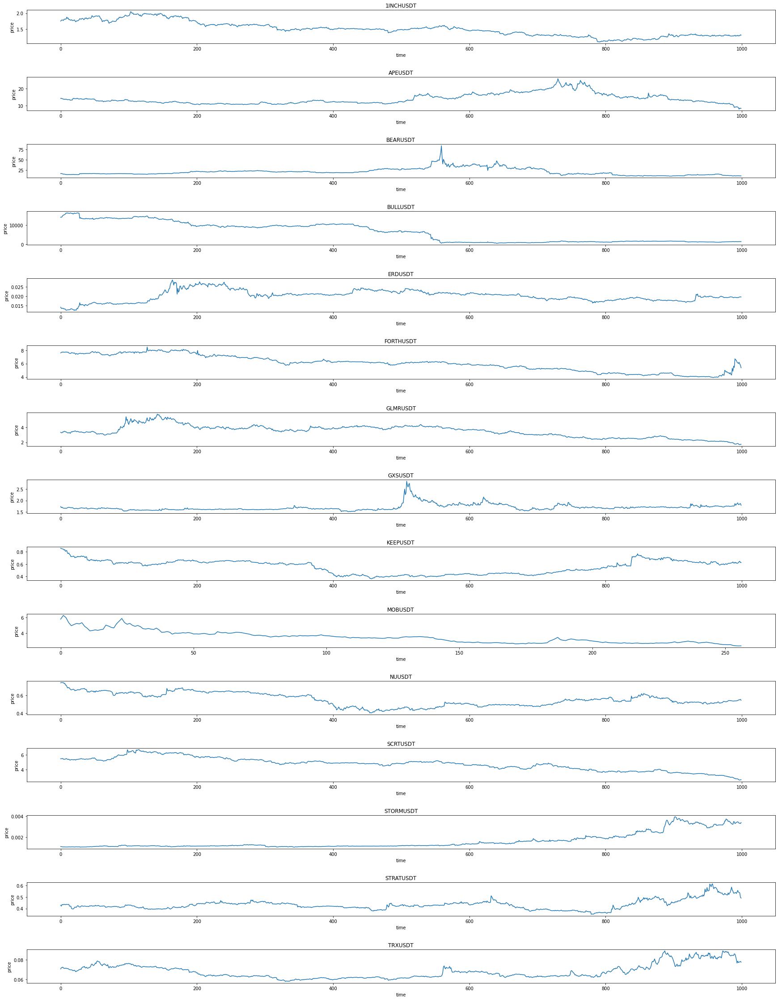

In [16]:
plot_prices(dataframes_1h)

#### 15m DATA

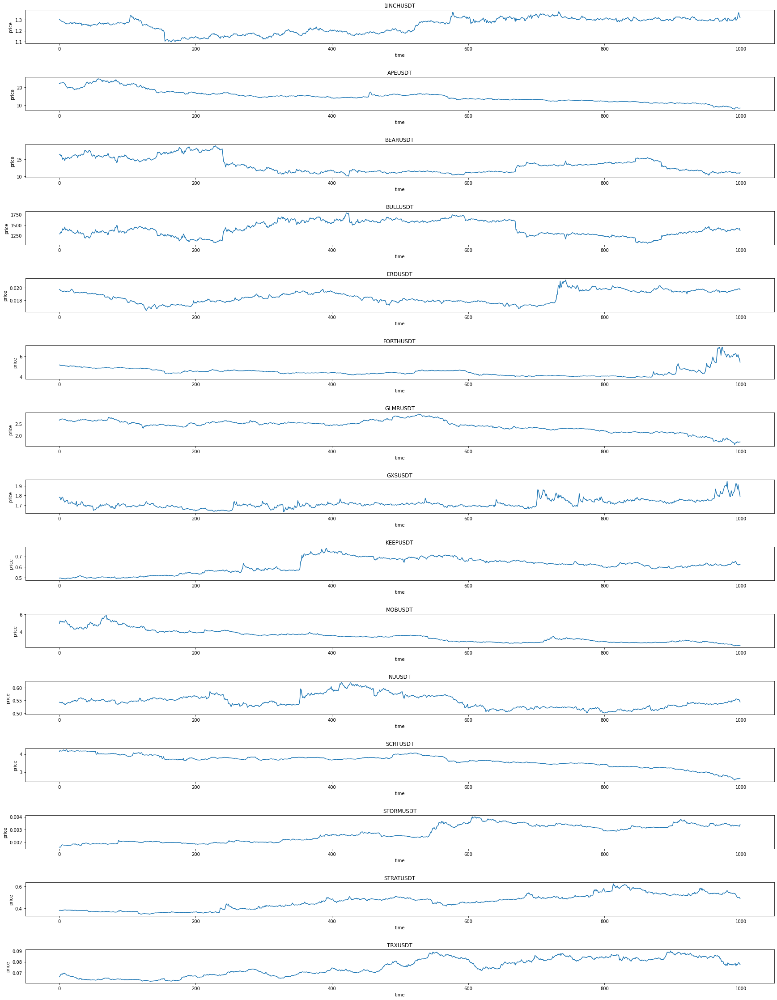

In [17]:
plot_prices(dataframes_15m)

## INDICATORS

In [18]:
plt.rcParams["figure.figsize"] = (30,40)

### DEFINE HELPER FUNCTIONS

In [19]:
def plot_indicator_itself(dataframes, indicator_name):
    size = len(dataframes)
    fig, axes = plt.subplots(size, 1)    
    plt.subplots_adjust(hspace=1)
    
    count = 0
    for r in range(size):
        dataframes[count][indicator_name].plot(ax = axes[r])
        axes[r].set_title(dataframes[count].name.split("_")[-1])
        axes[r].set_xlabel("time")
        axes[r].set_ylabel(indicator_name)
        count+=1

In [20]:
def plot_indicator_on_price(dataframes, indicator_name):
    size = len(dataframes)
    fig, axes = plt.subplots(size, 1)    
    plt.subplots_adjust(hspace=1)
    
    count = 0
    for r in range(size):
        dataframes[count][[indicator_name, "closes"]].plot(ax = axes[r])
        axes[r].set_title(dataframes[count].name.split("_")[-1])
        axes[r].set_xlabel("time")
        axes[r].set_ylabel(indicator_name +  "/price")
        count+=1


### CREATION

#### VOLATILITY INDICATORS

##### adx

In [21]:
class Adx():
    WINDOW = 14
    @classmethod
    def calculate_indicator(cls, df, window=WINDOW):
        return pd.Series(ta.trend.ADXIndicator(df["highs"], df["lows"], df["closes"], window = window).adx(), dtype = float)

In [22]:
for curr_df in dataframes_1h:    
    curr_df["adx"] = Adx.calculate_indicator(curr_df);

c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
  dip[idx] = 100 * (self._dip[idx] / value)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
  din[idx] = 100 * (self._din[idx] / value)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
  dip[idx] = 100 * (self._dip[idx] / value)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
  din[idx] = 100 * (self._din[idx] / value)
c:\U

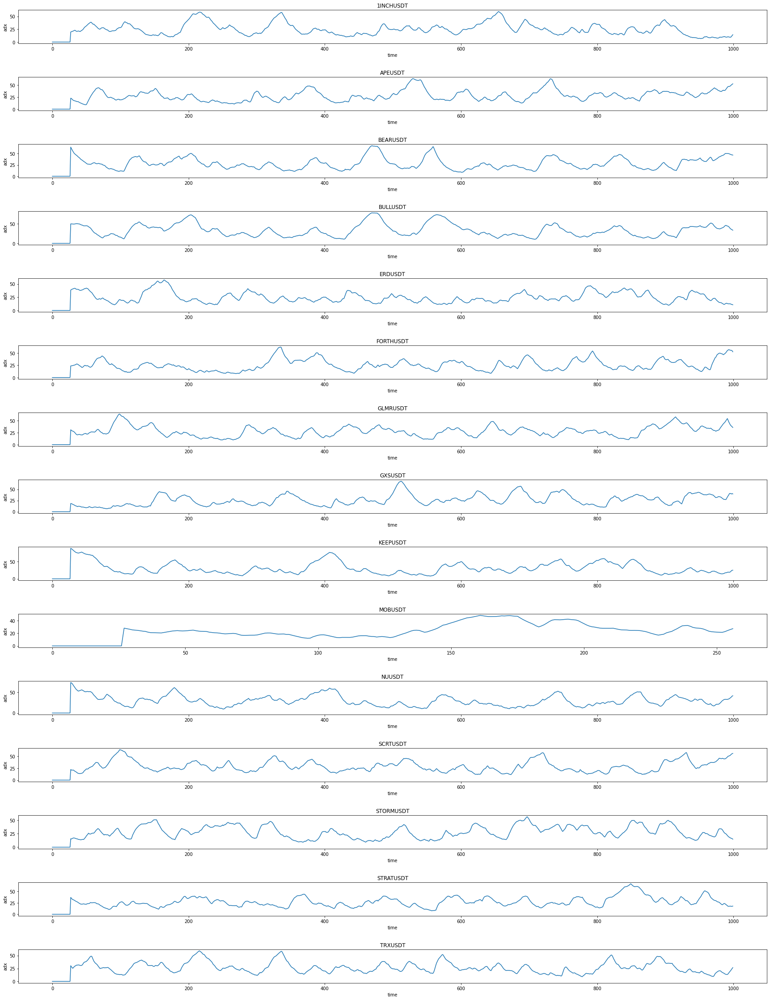

In [23]:
plot_indicator_itself(dataframes_1h, "adx")

In [24]:
for curr_df in dataframes_15m:
    curr_df["adx"] = Adx.calculate_indicator(curr_df);

c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
  dip[idx] = 100 * (self._dip[idx] / value)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
  din[idx] = 100 * (self._din[idx] / value)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:769: RuntimeWarning: invalid value encountered in double_scalars
  dip[idx] = 100 * (self._dip[idx] / value)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:774: RuntimeWarning: invalid value encountered in double_scalars
  din[idx] = 100 * (self._din[idx] / value)
c:\U

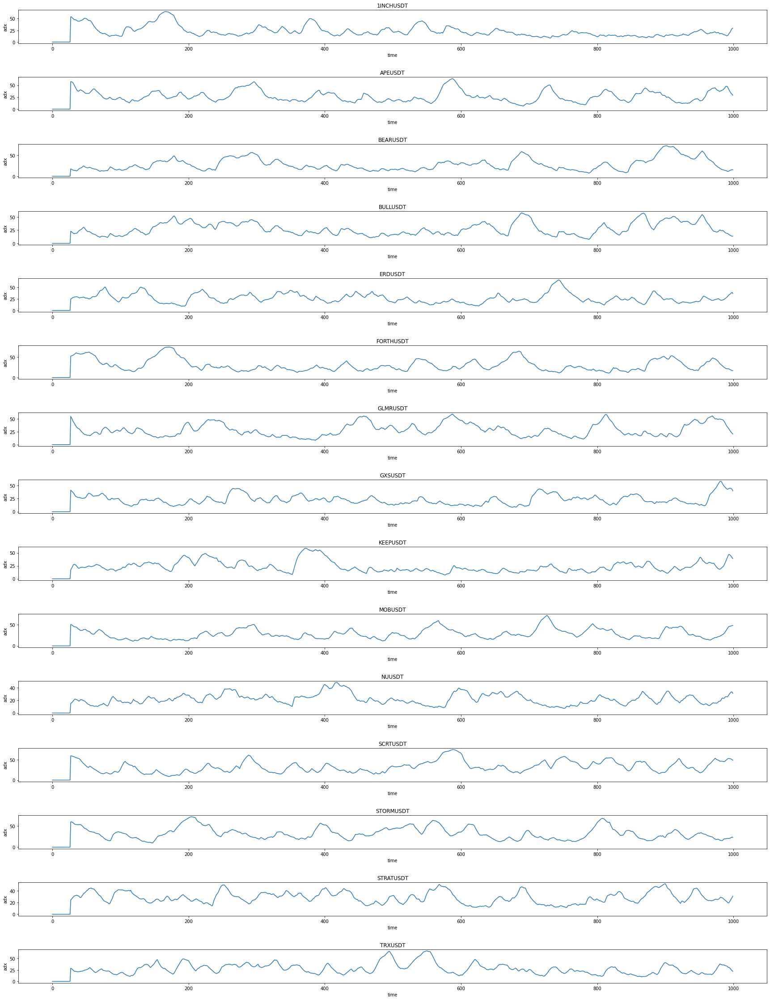

In [25]:
plot_indicator_itself(dataframes_15m, "adx")

#### TREND INDICATORS

##### macd

In [26]:
class Macd():
    WINDOW_SLOW = 26
    WINDOW_FAST = 12
    WINDOW_SIGN = 9
    @classmethod
    def calculate_indicator(cls, df, window_slow=WINDOW_SLOW, window_fast = WINDOW_FAST, window_sign = WINDOW_SIGN):
        return pd.Series(ta.trend.MACD(df["closes"], window_slow = window_slow, window_fast = window_fast, window_sign = window_sign).macd_diff(), dtype = float)

In [27]:
for curr_df in dataframes_1h:
    curr_df["macd_hist"] = Macd.calculate_indicator(curr_df) 

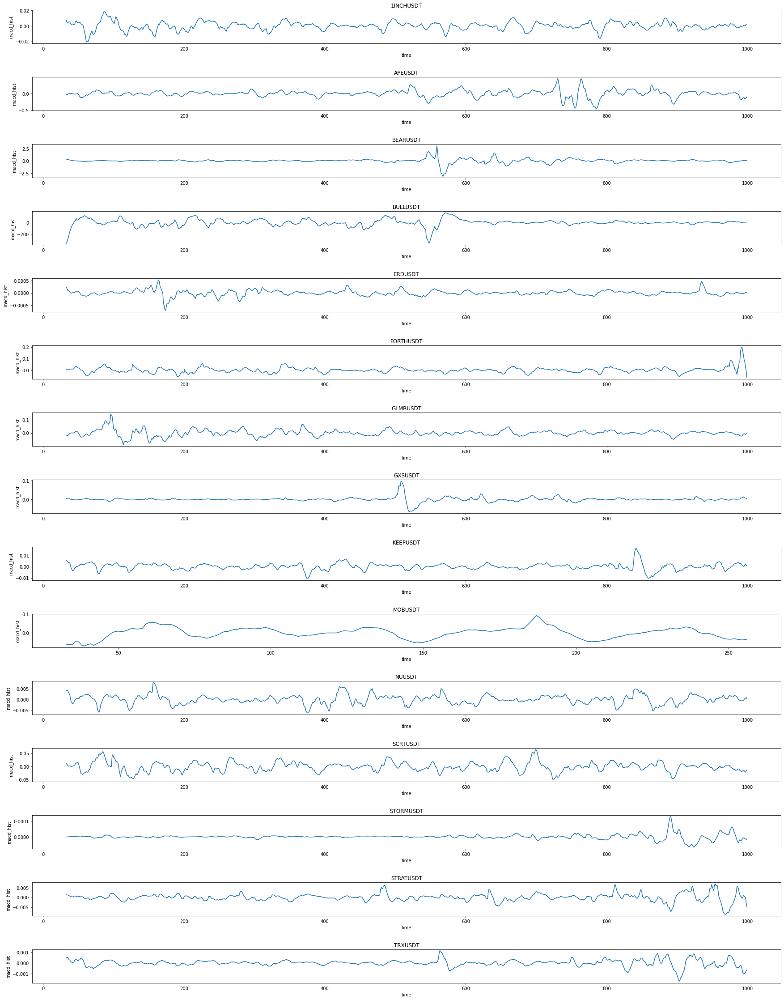

In [28]:
plot_indicator_itself(dataframes_1h, "macd_hist")

In [29]:
for curr_df in dataframes_15m:
    curr_df["macd_hist"] = Macd.calculate_indicator(curr_df) 

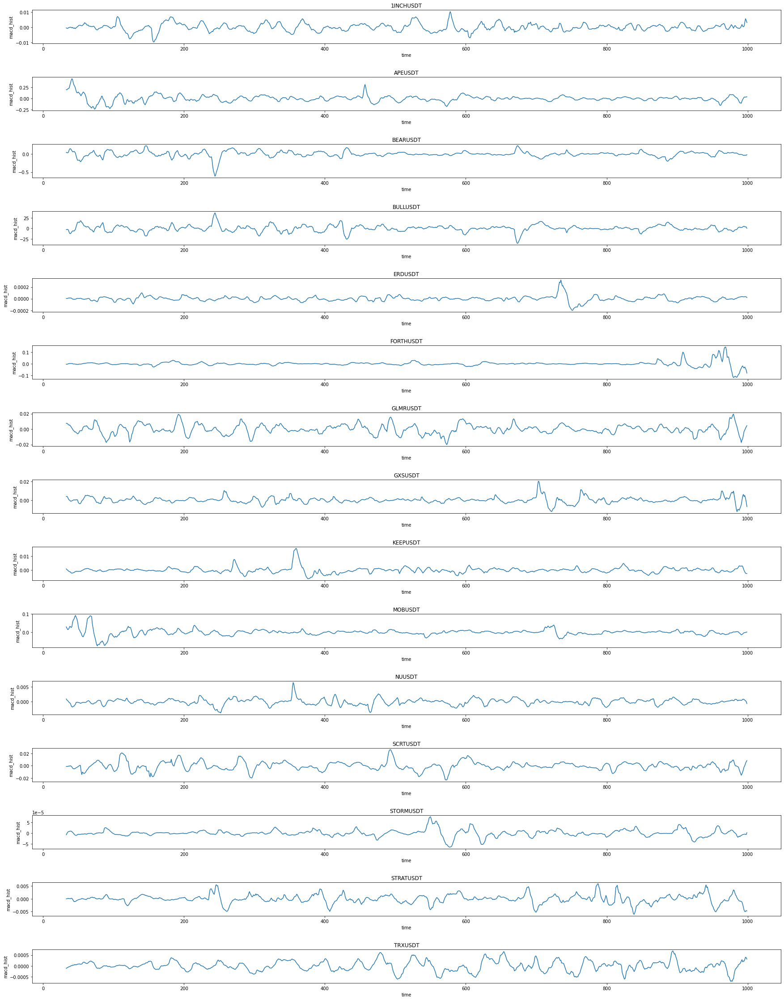

In [30]:
plot_indicator_itself(dataframes_15m, "macd_hist")

##### psar

In [31]:
class Psar():
    STEP = 0.2
    MAX_STEP = 0.2
    @classmethod
    def calculate_indicator(cls, df, step=STEP, max_step = MAX_STEP):
        return pd.Series(ta.trend.PSARIndicator(df["highs"], df["lows"], df["closes"], step = step, max_step = max_step).psar(), dtype = float)

In [32]:
for curr_df in dataframes_1h:
    curr_df["psar"] = Psar.calculate_indicator(curr_df);

c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:938: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  self._psar_up = pd.Series(index=self._psar.index)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:939: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  self._psar_down = pd.Series(index=self._psar.index)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:938: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly t

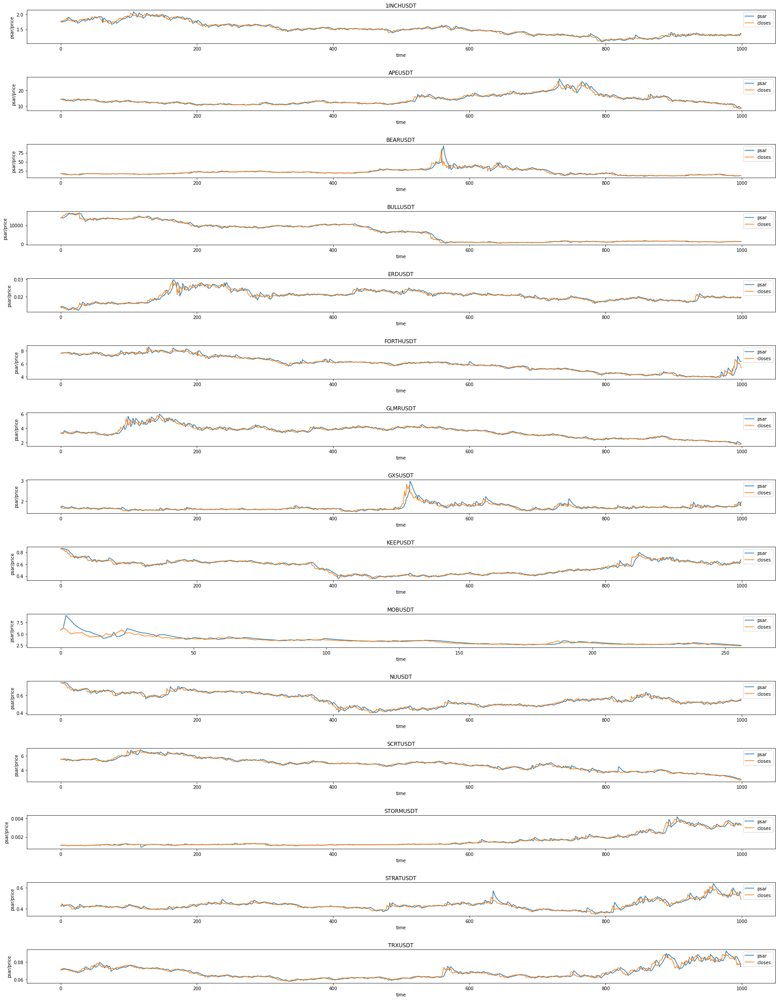

In [33]:
plot_indicator_on_price(dataframes_1h, "psar")

In [34]:
for curr_df in dataframes_15m:
    curr_df["psar"] = Psar.calculate_indicator(curr_df);

c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:938: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  self._psar_up = pd.Series(index=self._psar.index)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:939: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  self._psar_down = pd.Series(index=self._psar.index)
c:\Users\oztin\Desktop\PyProjects\py3.9.8\DataScience\Financial\AlgorithmicTrading\senior_design_project\venv\lib\site-packages\ta\trend.py:938: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly t

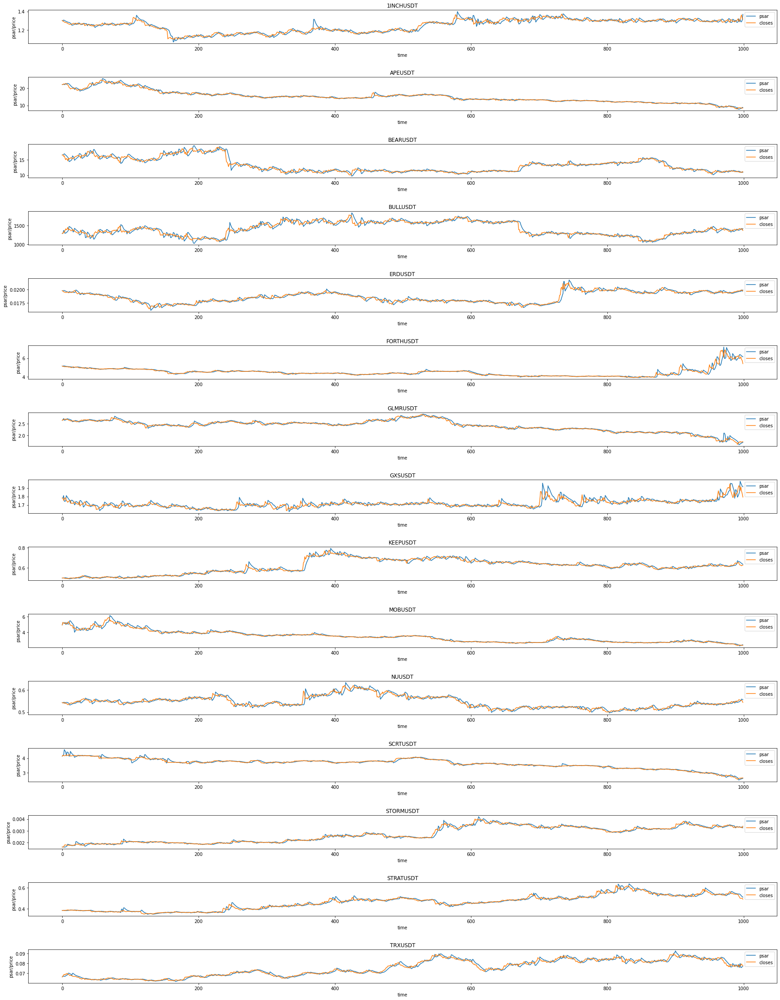

In [35]:
plot_indicator_on_price(dataframes_15m, "psar")

##### sma

In [36]:
class Sma():
    WINDOW = 14
    @classmethod
    def calculate_indicator(cls, df, window=WINDOW):
        return pd.Series(ta.trend.SMAIndicator(df["closes"], window = window).sma_indicator(), dtype = float)

In [37]:
for curr_df in dataframes_1h:
    curr_df["sma"] = Sma.calculate_indicator(curr_df) 

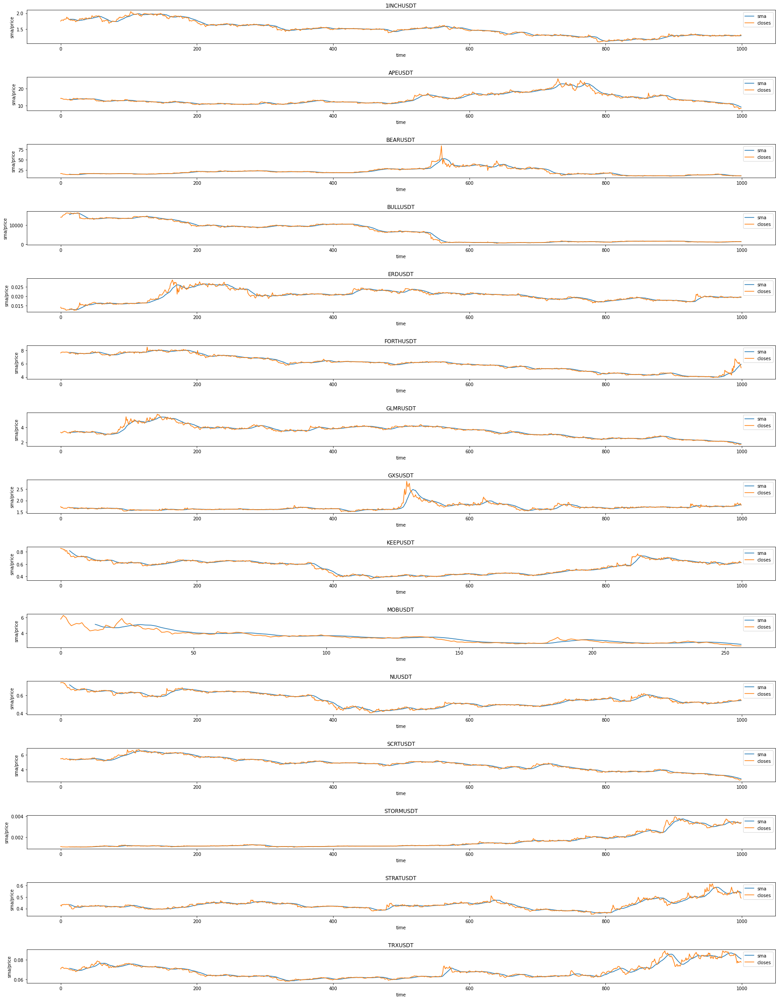

In [38]:
plot_indicator_on_price(dataframes_1h, "sma")

In [39]:
for curr_df in dataframes_15m:
    curr_df["sma"] = Sma.calculate_indicator(curr_df) 

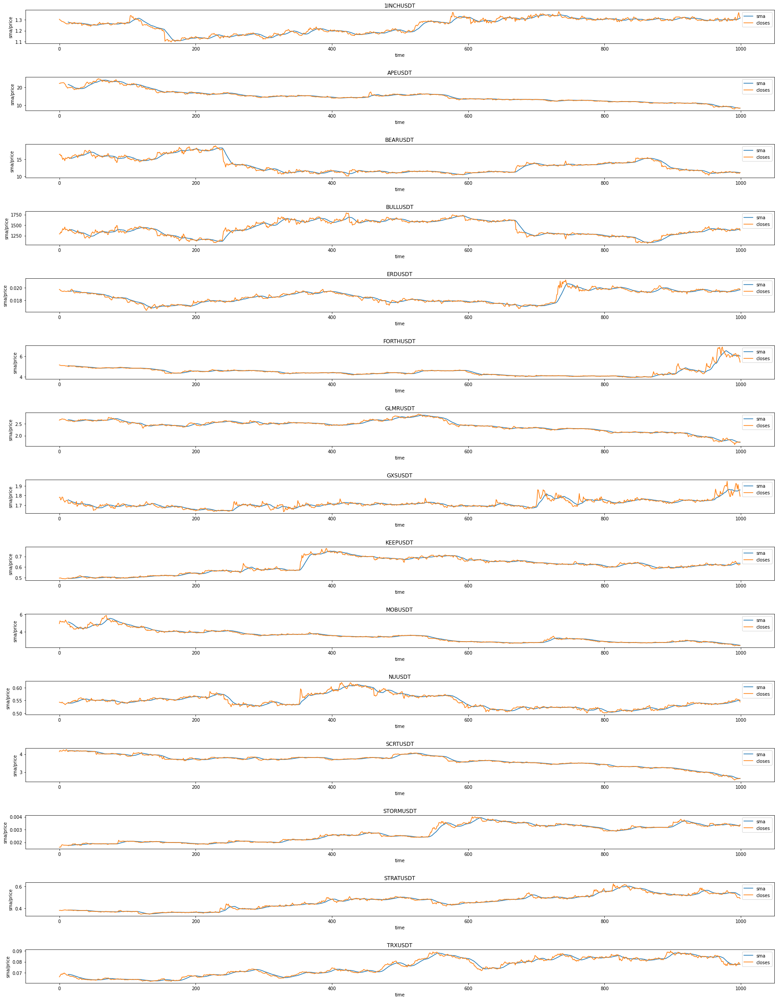

In [40]:
plot_indicator_on_price(dataframes_15m, "sma")

##### wma

In [41]:
class Wma():
    WINDOW = 14
    @classmethod
    def calculate_indicator(cls, df, window=WINDOW):
        return pd.Series(ta.trend.WMAIndicator(df["closes"], window = window).wma(), dtype = float)

In [42]:
for curr_df in dataframes_1h:
    curr_df["wma"] = Wma.calculate_indicator(curr_df) 

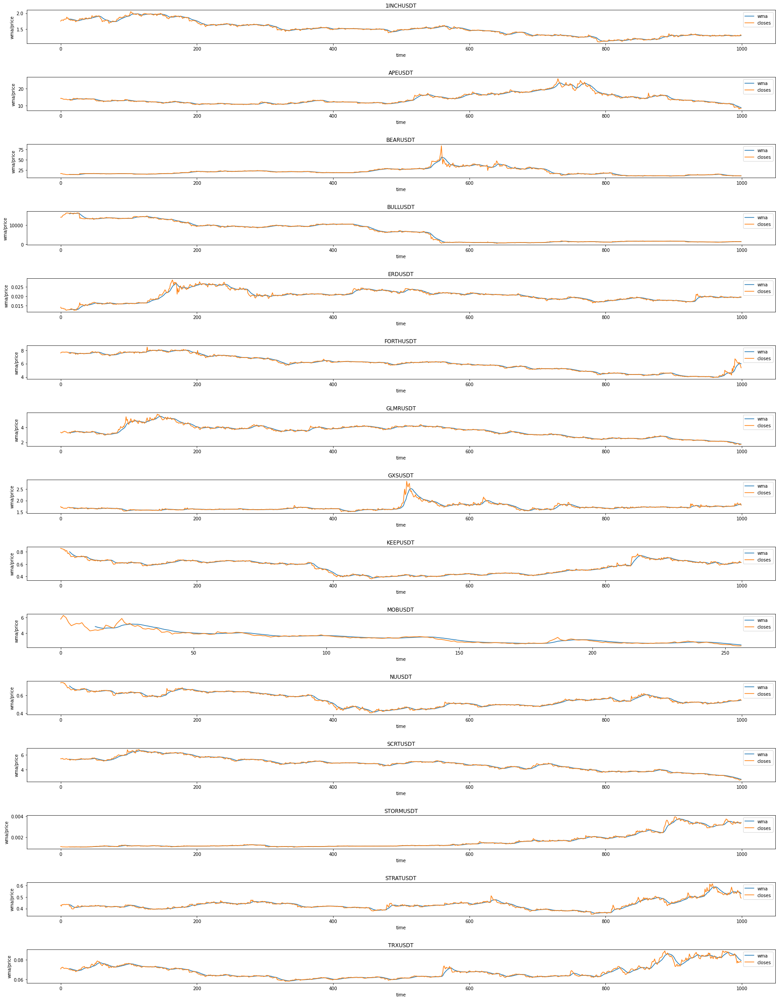

In [43]:
plot_indicator_on_price(dataframes_1h, "wma")

In [44]:
for curr_df in dataframes_15m:
    curr_df["wma"] = Wma.calculate_indicator(curr_df) 

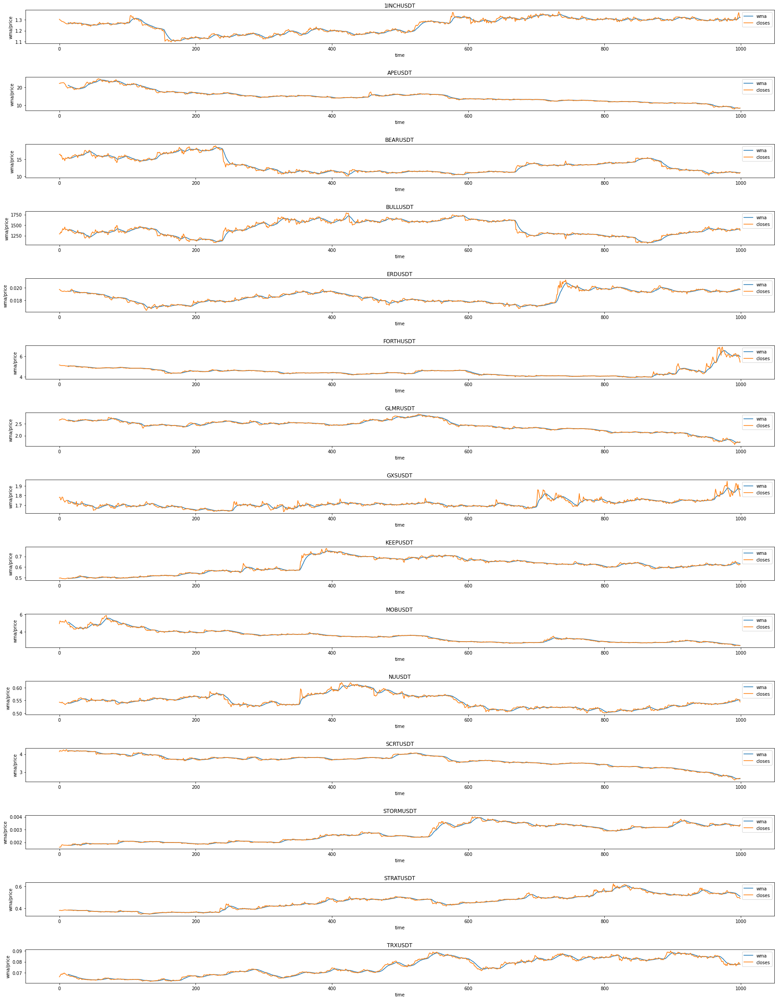

In [45]:
plot_indicator_on_price(dataframes_15m, "wma")

##### ema

In [46]:
class Ema():
    WINDOW = 14
    @classmethod
    def calculate_indicator(cls, df, window=WINDOW):
        return pd.Series(ta.trend.EMAIndicator(df["closes"], window = window).ema_indicator(), dtype = float)

In [47]:
for curr_df in dataframes_1h:
    curr_df["ema"] = Ema.calculate_indicator(curr_df) 

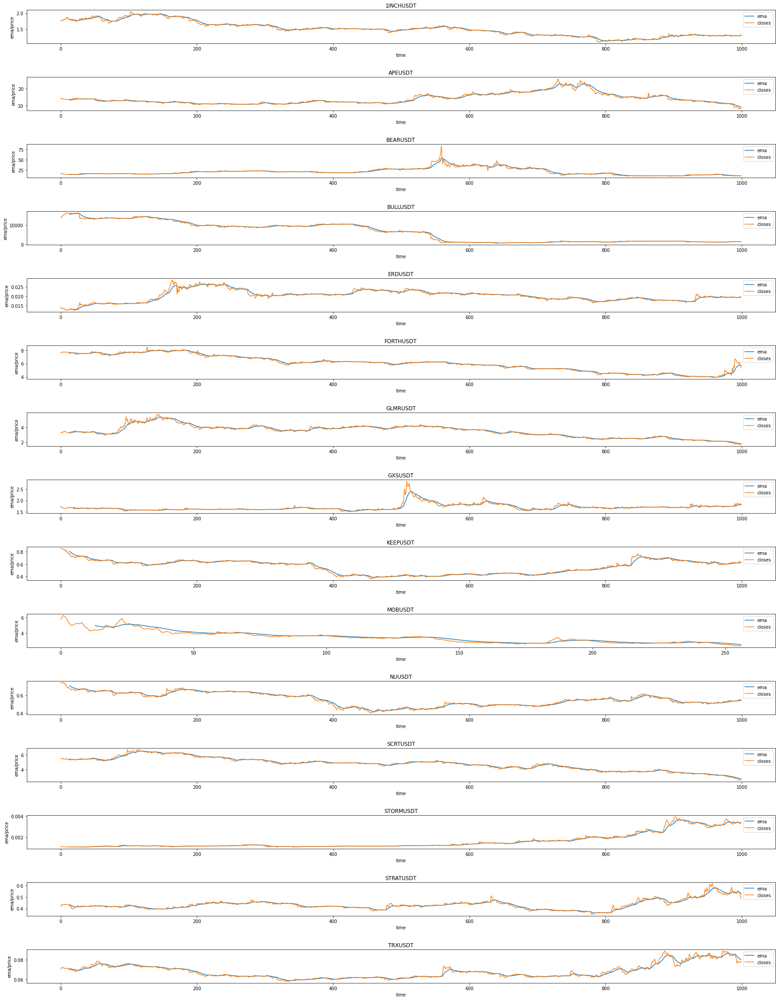

In [48]:
plot_indicator_on_price(dataframes_1h, "ema")

In [49]:
for curr_df in dataframes_15m:
    curr_df["ema"] = Ema.calculate_indicator(curr_df) 

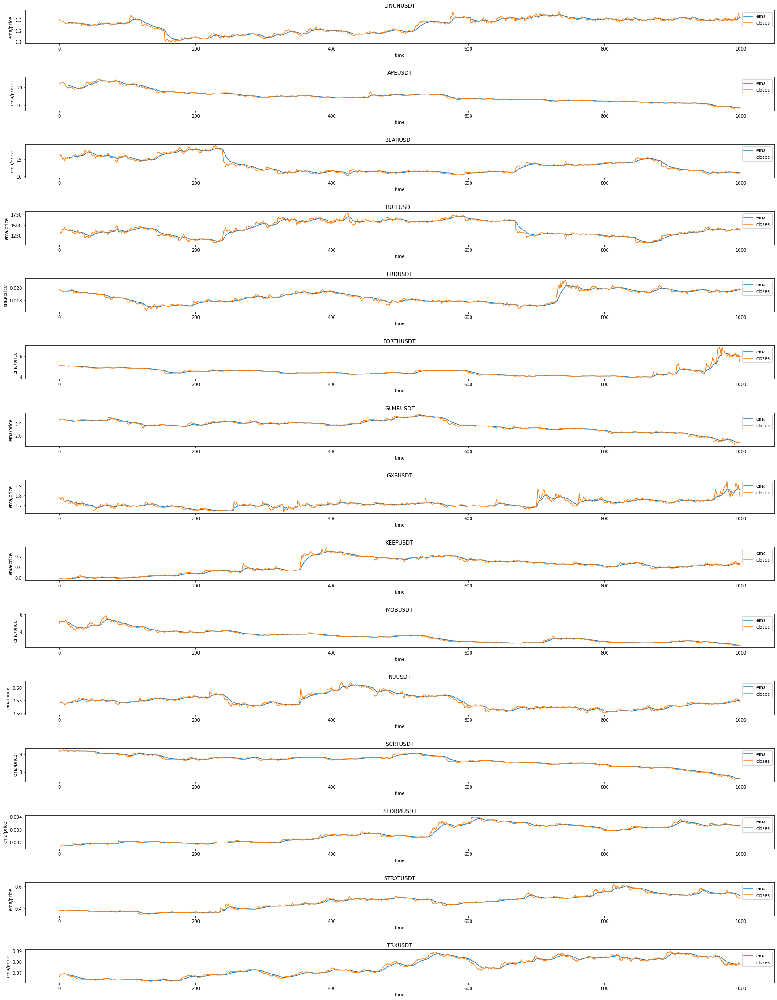

In [50]:
plot_indicator_on_price(dataframes_15m, "ema")

## GET DATASET READY TO TEST

### HANDLE MISSING VALUES

In [51]:
for curr_df in dataframes_1h:    
    curr_df.dropna(axis = 0, how= "any", inplace = True)

for curr_df in dataframes_15m:    
    curr_df.dropna(axis = 0, how= "any", inplace = True)

In [52]:
for curr_df in dataframes_1h:
    curr_df.reset_index(inplace = True)

for curr_df in dataframes_15m:
    curr_df.reset_index(inplace = True)

### DEFINE HELPER FUNCTIONS

#### HEIKEN ASHI

##### DEFINE

In [53]:
def convert_to_heiken_ashi(opens, highs, lows, closes):
    ha_closes = pd.Series([], dtype = float)
    ha_opens = pd.Series([], dtype = float)
    ha_highs = pd.Series([], dtype = float)
    ha_lows =  pd.Series([], dtype = float)    
    
    for i in range(0, len(closes)):            
        ha_closes[i] = (opens[i] + highs[i] + lows[i] + closes[i]) / 4
        if i == 0:                
            ha_opens[i] = (opens[i] + closes[i]) / 2
        else:                
            ha_opens[i] = (opens[i - 1] + closes[i - 1]) / 2
        
        ha_highs[i] = max(opens[i], closes[i], highs[i])
        ha_lows[i] = min(opens[i], closes[i], lows[i])
                        
    return ha_opens.to_numpy(), ha_highs.to_numpy(), ha_lows.to_numpy(), ha_closes.to_numpy()

##### PREPARE

In [54]:
for curr_df in dataframes_1h:
    curr_df["ha_opens"], curr_df["ha_highs"], curr_df["ha_lows"], curr_df["ha_closes"] = convert_to_heiken_ashi(curr_df["opens"], curr_df["highs"], curr_df["lows"], curr_df["closes"])

for curr_df in dataframes_15m:
    curr_df["ha_opens"], curr_df["ha_highs"], curr_df["ha_lows"], curr_df["ha_closes"] = convert_to_heiken_ashi(curr_df["opens"], curr_df["highs"], curr_df["lows"], curr_df["closes"])

# STRATEGY TESTS

In [62]:
plt.rcParams["figure.figsize"] = (30,5)

### HODL STRATEGY

In [56]:
for curr_df in dataframes_15m:
    print("Hodl strategy expected return (pct) of {}: {}".format(curr_df.name.split("_")[-1], (100 * (curr_df["closes"].iloc[-1] - curr_df["closes"].iloc[0])) /curr_df["closes"].iloc[0]))

Hodl strategy expected return (pct) of 1INCHUSDT: 5.693664795509218
Hodl strategy expected return (pct) of APEUSDT: -57.663335972000255
Hodl strategy expected return (pct) of BEARUSDT: -32.7710843373494
Hodl strategy expected return (pct) of BULLUSDT: 5.791070587599496
Hodl strategy expected return (pct) of ERDUSDT: 2.2515044615065203
Hodl strategy expected return (pct) of FORTHUSDT: 10.408163265306117
Hodl strategy expected return (pct) of GLMRUSDT: -34.81445312499999
Hodl strategy expected return (pct) of GXSUSDT: 3.1242807825086314
Hodl strategy expected return (pct) of KEEPUSDT: 22.209188660801573
Hodl strategy expected return (pct) of MOBUSDT: -45.26532479414456
Hodl strategy expected return (pct) of NUUSDT: -2.4582809976673325
Hodl strategy expected return (pct) of SCRTUSDT: -36.46607528170703
Hodl strategy expected return (pct) of STORMUSDT: 81.46367521367522
Hodl strategy expected return (pct) of STRATUSDT: 28.24267782426778
Hodl strategy expected return (pct) of TRXUSDT: 21.92

## Confirmations

### Why to filter?
Expected finding: using filters increases profit and (profit count / loss count) ratio

#### determine via psar

In [57]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]    
    return True if curr_sar < curr_ha_close else False
    
    
def flow(df1):    
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count    
    
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    
    for index in range(len(df1["closes"])):        
        curr_close = df1["closes"][index]                 
              
        if not in_position:                  
            if determinator(df1, index):
                bought_at = curr_close
                in_position = True                    
        else:
            if not determinator(df1, index):
                sold_at = curr_close
                in_position = False                        

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)                                            
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: -9.382635519559628
max loss: -2.665957732991444
max profit: 6.076634532329038
transaction count: 122
loss count: 74
profit count: 48
profit percentage: -9.382635519559628
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


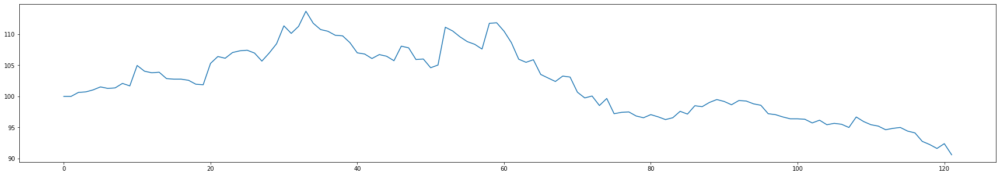

profit: -12.56849406271482
max loss: -5.8466520210943145
max profit: 11.277065005800097
transaction count: 99
loss count: 62
profit count: 37
profit percentage: -12.56849406271482
Hodl strategy expected return of APEUSDT: -57.663335972000255


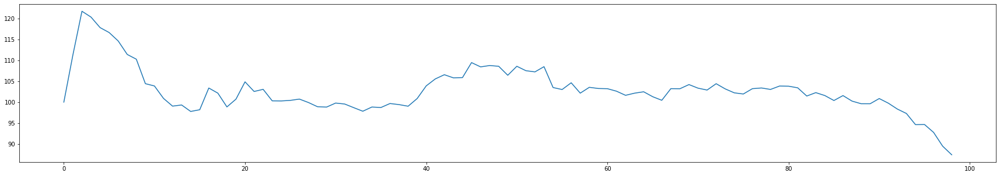

profit: -1.4255550116354812
max loss: -11.44898025725334
max profit: 15.270300023768101
transaction count: 108
loss count: 63
profit count: 45
profit percentage: -1.4255550116354812
Hodl strategy expected return of BEARUSDT: -32.7710843373494


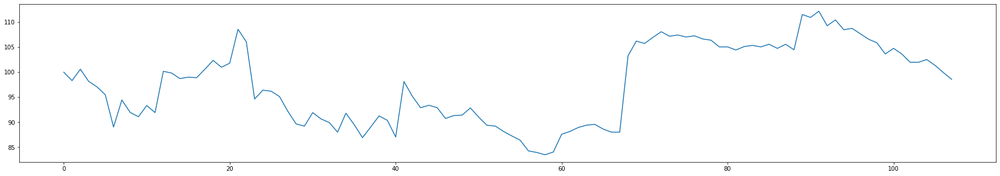

profit: -28.141267283039483
max loss: -8.237223493516396
max profit: 7.008977835808565
transaction count: 118
loss count: 70
profit count: 48
profit percentage: -28.141267283039483
Hodl strategy expected return of BULLUSDT: 5.791070587599496


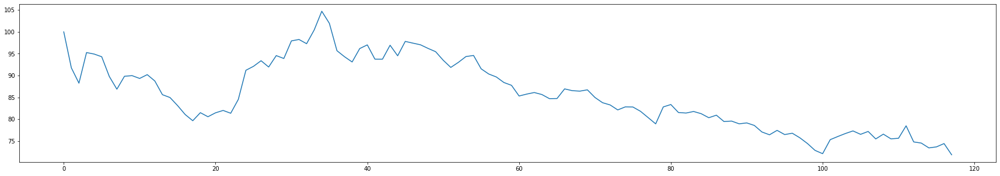

profit: 11.236488970429434
max loss: -2.629454040716311
max profit: 12.426460060393339
transaction count: 104
loss count: 67
profit count: 37
profit percentage: 11.236488970429434
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


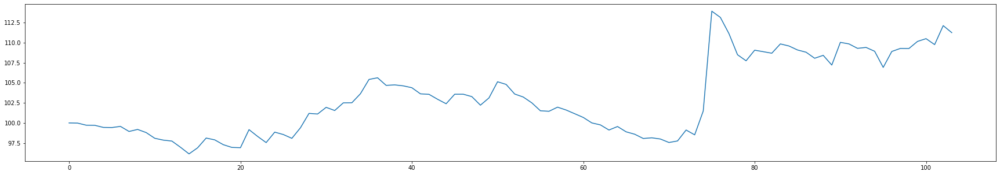

profit: 6.693300156533127
max loss: -5.512786042372952
max profit: 11.071637925828782
transaction count: 99
loss count: 55
profit count: 44
profit percentage: 6.693300156533127
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


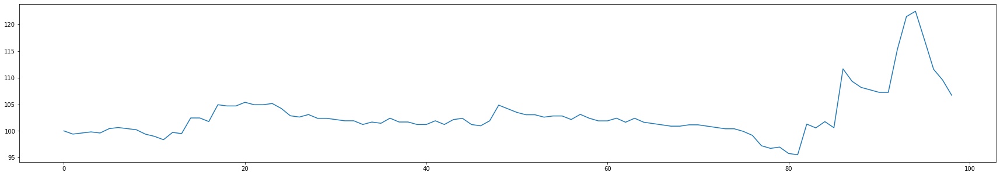

profit: -7.113453253240451
max loss: -5.3710518127521
max profit: 6.926974739750676
transaction count: 104
loss count: 61
profit count: 43
profit percentage: -7.11345325324045
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


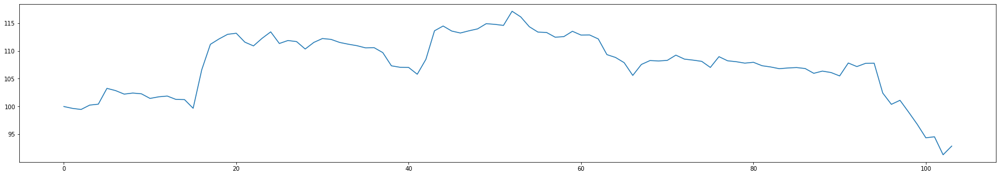

profit: -4.434997737942112
max loss: -3.3409676950180796
max profit: 5.246150023804702
transaction count: 124
loss count: 71
profit count: 53
profit percentage: -4.434997737942112
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


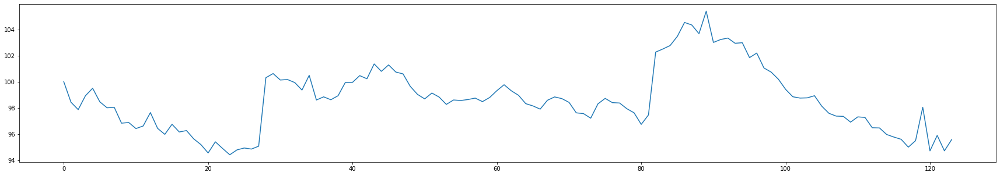

profit: 4.655566005991574
max loss: -4.451587890343575
max profit: 26.44650351124386
transaction count: 113
loss count: 68
profit count: 45
profit percentage: 4.655566005991574
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


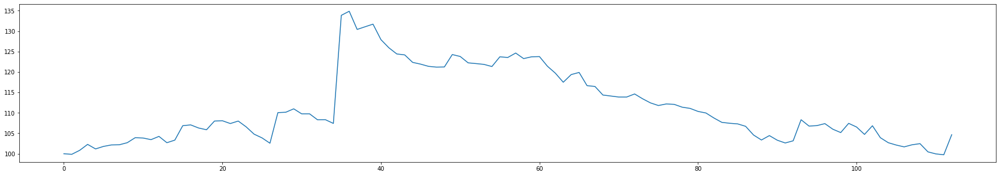

profit: -4.606420747745361
max loss: -6.118459183240304
max profit: 19.34068155096378
transaction count: 111
loss count: 70
profit count: 41
profit percentage: -4.606420747745361
Hodl strategy expected return of MOBUSDT: -45.26532479414456


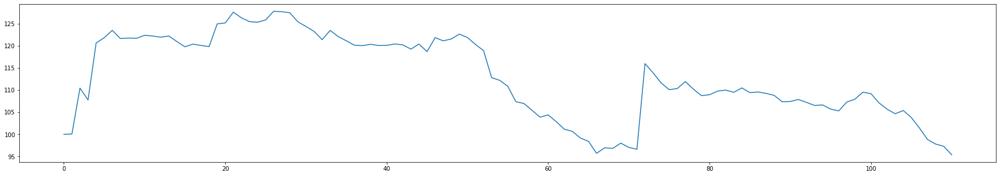

profit: -0.4154962252732304
max loss: -4.4722909634503765
max profit: 3.136306511240818
transaction count: 126
loss count: 68
profit count: 58
profit percentage: -0.4154962252732304
Hodl strategy expected return of NUUSDT: -2.4582809976673325


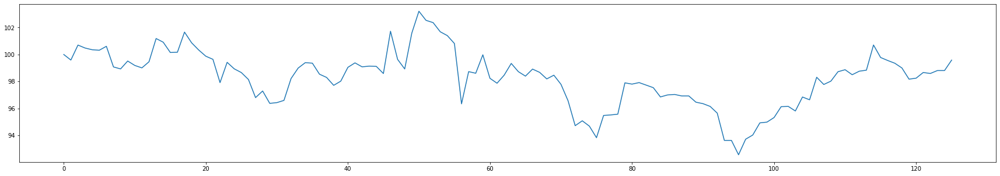

profit: -10.38490917592165
max loss: -3.729758359054145
max profit: 4.570109703125851
transaction count: 96
loss count: 56
profit count: 40
profit percentage: -10.384909175921647
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


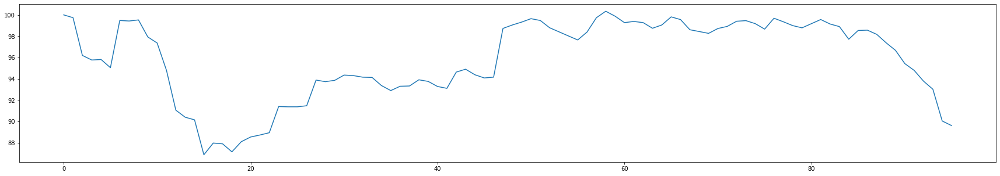

profit: 98.85893384522578
max loss: -9.024318517259758
max profit: 30.79558529394069
transaction count: 115
loss count: 62
profit count: 53
profit percentage: 98.85893384522578
Hodl strategy expected return of STORMUSDT: 81.46367521367522


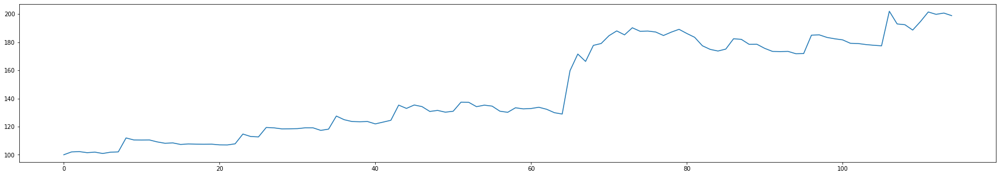

profit: 38.95859627676697
max loss: -4.573026843989368
max profit: 7.7721075710356615
transaction count: 104
loss count: 58
profit count: 46
profit percentage: 38.95859627676697
Hodl strategy expected return of STRATUSDT: 28.24267782426778


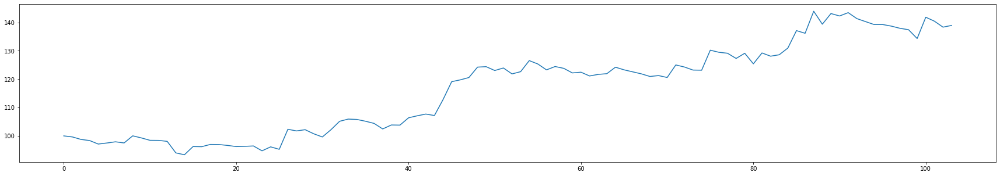

profit: 51.029976491938044
max loss: -3.850299361079749
max profit: 11.233003963276815
transaction count: 100
loss count: 52
profit count: 48
profit percentage: 51.029976491938044
Hodl strategy expected return of TRXUSDT: 21.927066960075457


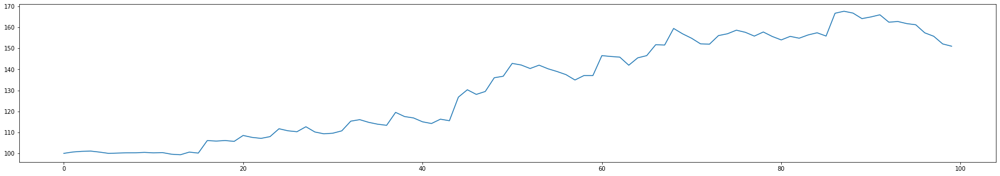

cumulative profit percentage: 132.9596327298127
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 957
cumulative profit count: 686
(profit count / loss count) ratio: 0.7168234064785789


In [58]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

#### eliminate via sma + psar + adx & determine via psar

In [59]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
        
        curr_adx = df2["adx"][index]
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close and curr_adx >= 25 else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 4.288689421909623
max loss: -1.7260725937936314
max profit: 3.8415285673319346
transaction count: 17
loss count: 8
profit count: 9
profit percentage: 4.288689421909623
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


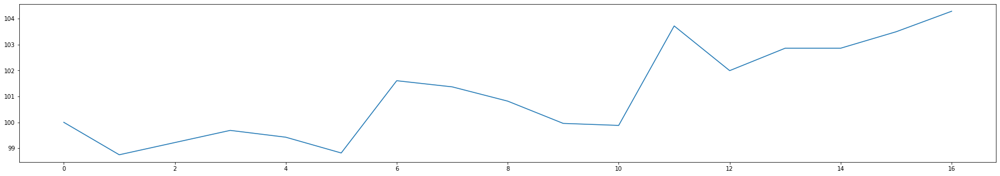

profit: 11.907509909237959
max loss: -2.027428444407107
max profit: 6.027333365209614
transaction count: 22
loss count: 12
profit count: 10
profit percentage: 11.907509909237959
Hodl strategy expected return of APEUSDT: -57.663335972000255


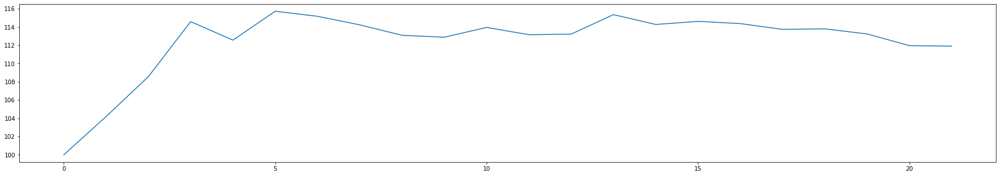

profit: 0.3226909504140423
max loss: -3.7960004619293244
max profit: 6.350194845289238
transaction count: 25
loss count: 14
profit count: 11
profit percentage: 0.3226909504140423
Hodl strategy expected return of BEARUSDT: -32.7710843373494


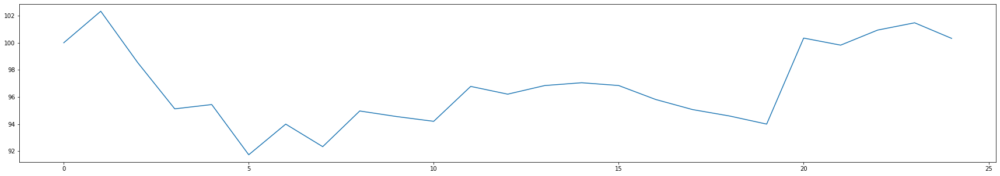

profit: 7.096486930636459
max loss: -5.527182360833194
max profit: 7.901828082974205
transaction count: 39
loss count: 18
profit count: 21
profit percentage: 7.096486930636458
Hodl strategy expected return of BULLUSDT: 5.791070587599496


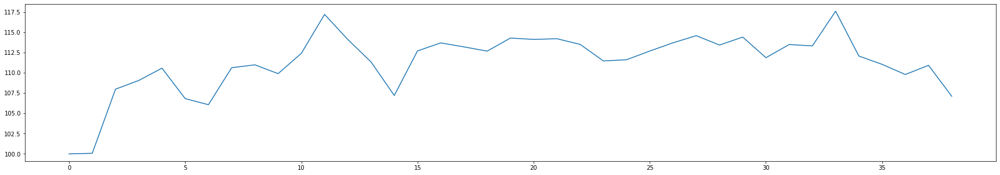

profit: -1.4411374989266648
max loss: -2.257394690958563
max profit: 2.2672995284184765
transaction count: 29
loss count: 20
profit count: 9
profit percentage: -1.4411374989266648
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


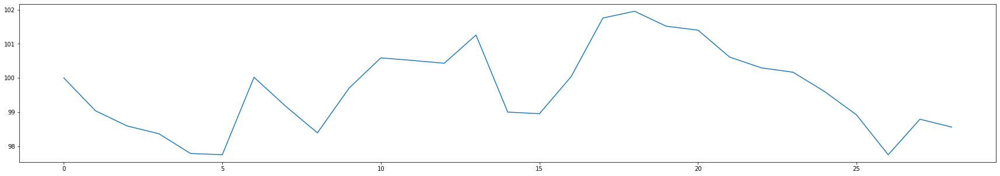

profit: 20.386442428234787
max loss: -5.556297342841603
max profit: 11.28431061210955
transaction count: 18
loss count: 5
profit count: 13
profit percentage: 20.386442428234787
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


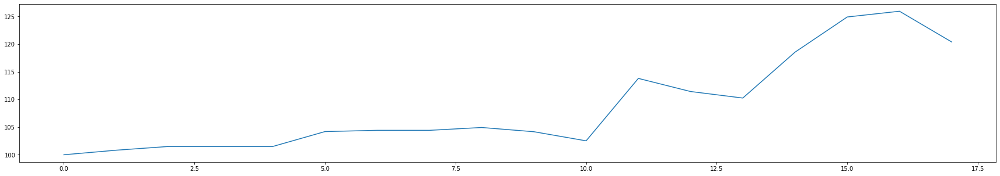

profit: 10.381861312586366
max loss: -0.9958022325825624
max profit: 6.673959904864859
transaction count: 26
loss count: 12
profit count: 14
profit percentage: 10.381861312586366
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


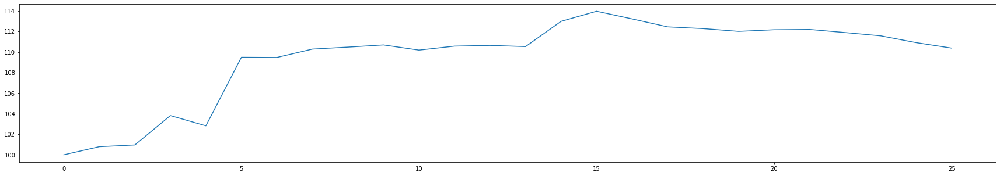

profit: -1.9771794611634448
max loss: -3.3283826390345013
max profit: 5.267871331791724
transaction count: 47
loss count: 23
profit count: 24
profit percentage: -1.9771794611634448
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


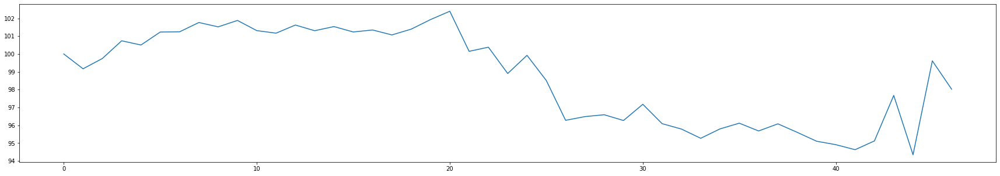

profit: 26.85894009533878
max loss: -4.522405970557969
max profit: 26.69561302310825
transaction count: 29
loss count: 11
profit count: 18
profit percentage: 26.85894009533878
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


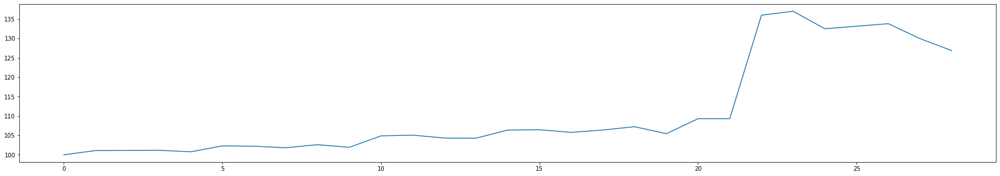

profit: 8.561627910211726
max loss: -2.179135602453073
max profit: 17.421071516681366
transaction count: 10
loss count: 7
profit count: 3
profit percentage: 8.561627910211726
Hodl strategy expected return of MOBUSDT: -45.26532479414456


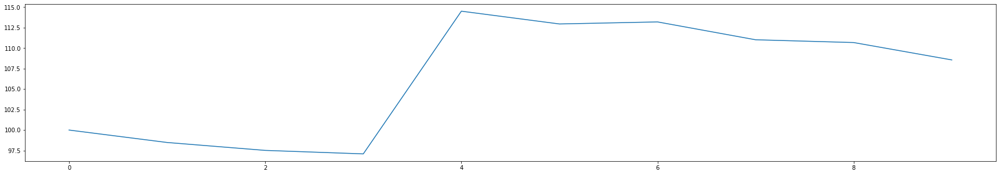

profit: 1.3370511298723073
max loss: -2.1244957533590423
max profit: 2.668207540963678
transaction count: 34
loss count: 19
profit count: 15
profit percentage: 1.3370511298723073
Hodl strategy expected return of NUUSDT: -2.4582809976673325


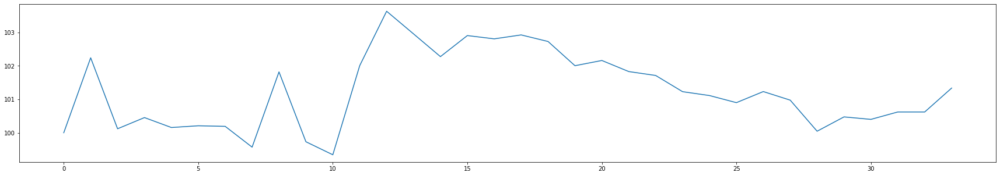

profit: 1.0817690918509726
max loss: -0.8278537352793762
max profit: 2.5489669975851967
transaction count: 13
loss count: 8
profit count: 5
profit percentage: 1.0817690918509726
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


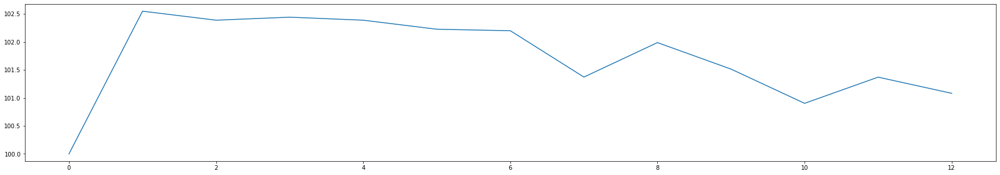

profit: 49.33936956165263
max loss: -6.984692117582853
max profit: 15.060278829944224
transaction count: 34
loss count: 17
profit count: 17
profit percentage: 49.33936956165263
Hodl strategy expected return of STORMUSDT: 81.46367521367522


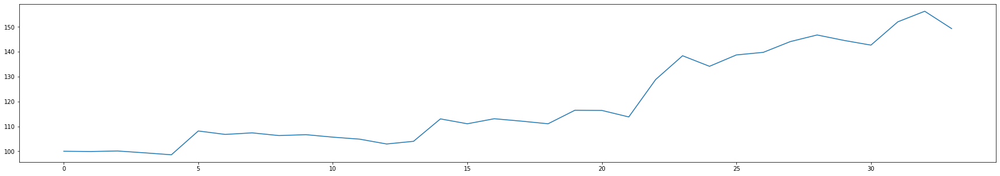

profit: 10.186496021557815
max loss: -3.520161307520951
max profit: 6.280736485434673
transaction count: 36
loss count: 24
profit count: 12
profit percentage: 10.186496021557815
Hodl strategy expected return of STRATUSDT: 28.24267782426778


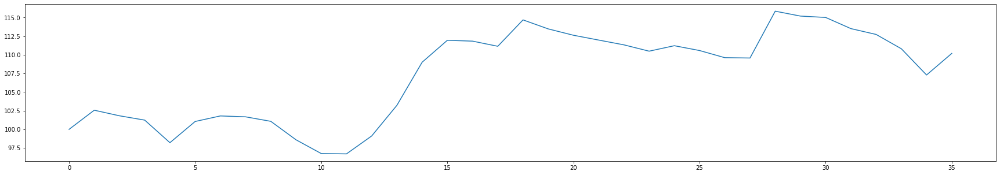

profit: 27.374207374795134
max loss: -1.7510973773374587
max profit: 6.6891722951455534
transaction count: 28
loss count: 13
profit count: 15
profit percentage: 27.374207374795134
Hodl strategy expected return of TRXUSDT: 21.927066960075457


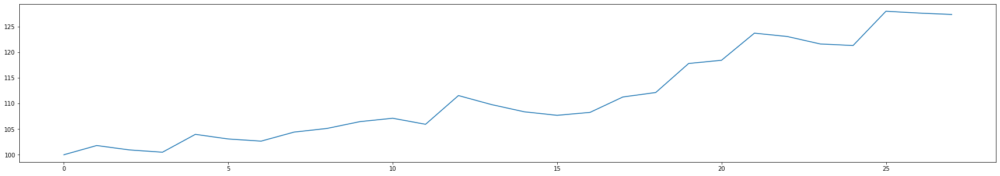

cumulative profit percentage: 175.7048251782085
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 211
cumulative profit count: 196
(profit count / loss count) ratio: 0.9289099526066351


In [60]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### Why not to use indicators from the same class?
Expected finding: using indicators from same class changes results just a little

#### determine via psar + macd

In [61]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    curr_macd = df1["macd_hist"][index]
    return True if curr_sar < curr_ha_close and curr_macd > 0 else False
    
    
def flow(df1):    
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count    
    
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    
    for index in range(len(df1["closes"])):        
        curr_close = df1["closes"][index]                 
              
        if not in_position:                  
            if determinator(df1, index):
                bought_at = curr_close
                in_position = True                    
        else:
            if not determinator(df1, index):
                sold_at = curr_close
                in_position = False                        

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)                                            
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: -9.40052573169865
max loss: -2.5767436699285753
max profit: 6.0087116217944185
transaction count: 75
loss count: 46
profit count: 29
profit percentage: -9.40052573169865
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


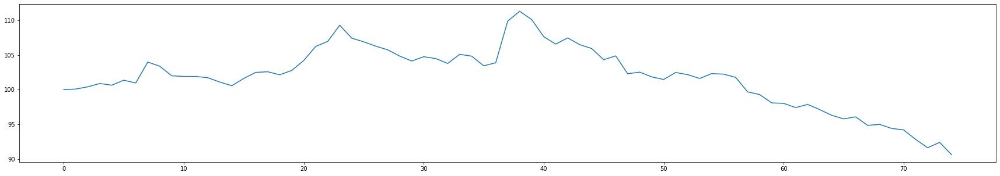

profit: -10.730343159025267
max loss: -6.510357569755314
max profit: 11.277065005800097
transaction count: 72
loss count: 43
profit count: 29
profit percentage: -10.730343159025267
Hodl strategy expected return of APEUSDT: -57.663335972000255


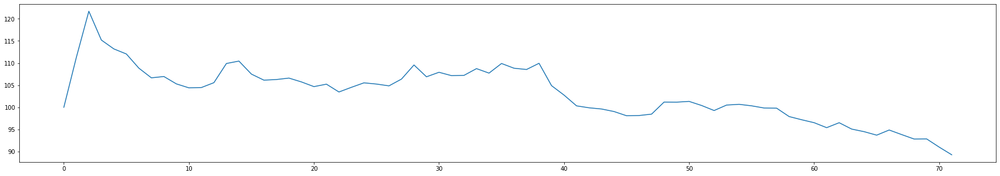

profit: -2.5805933420901823
max loss: -4.059246318257038
max profit: 14.561985502757238
transaction count: 75
loss count: 49
profit count: 26
profit percentage: -2.5805933420901823
Hodl strategy expected return of BEARUSDT: -32.7710843373494


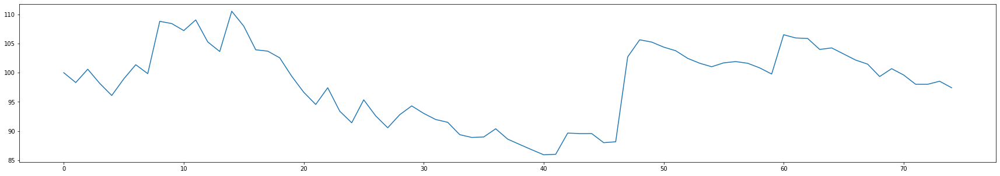

profit: -24.350376330648857
max loss: -4.846705436009742
max profit: 7.010180511508736
transaction count: 81
loss count: 48
profit count: 33
profit percentage: -24.350376330648857
Hodl strategy expected return of BULLUSDT: 5.791070587599496


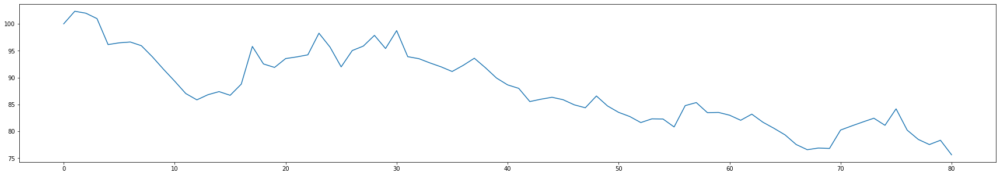

profit: 5.673990286583091
max loss: -2.1410827734191002
max profit: 11.275850811786029
transaction count: 72
loss count: 49
profit count: 23
profit percentage: 5.673990286583091
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


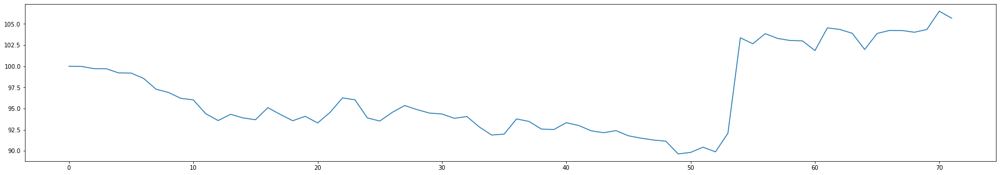

profit: -0.030941430627507316
max loss: -5.433132555040132
max profit: 5.280441469092722
transaction count: 66
loss count: 34
profit count: 32
profit percentage: -0.030941430627507316
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


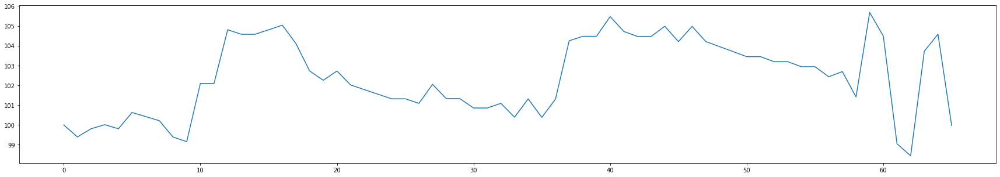

profit: -2.8661446388714324
max loss: -3.382210856850051
max profit: 4.50075320746592
transaction count: 68
loss count: 40
profit count: 28
profit percentage: -2.8661446388714324
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


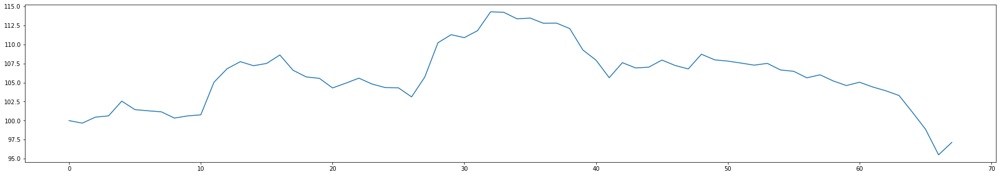

profit: -7.282524829600973
max loss: -3.333791858873923
max profit: 5.2286364931205895
transaction count: 82
loss count: 48
profit count: 34
profit percentage: -7.282524829600972
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


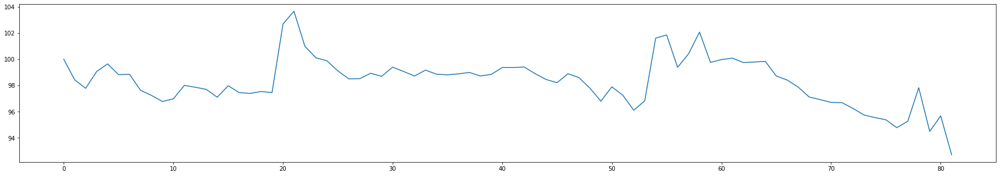

profit: 1.11926631911615
max loss: -4.3964383218832666
max profit: 23.971433459886143
transaction count: 75
loss count: 49
profit count: 26
profit percentage: 1.11926631911615
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


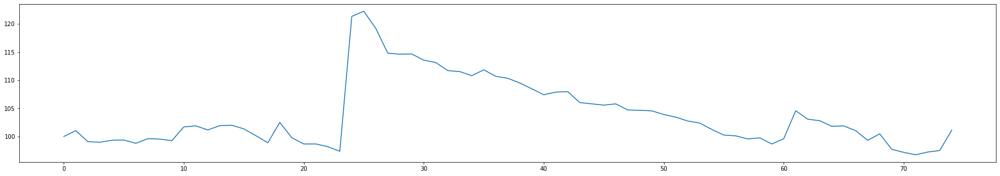

profit: 7.104555601275692
max loss: -3.7275718623539973
max profit: 19.628495222124002
transaction count: 73
loss count: 49
profit count: 24
profit percentage: 7.104555601275693
Hodl strategy expected return of MOBUSDT: -45.26532479414456


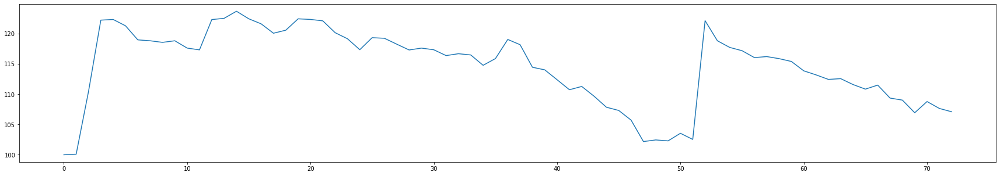

profit: 1.673494366989388
max loss: -2.0574198813545053
max profit: 2.400472708524603
transaction count: 84
loss count: 42
profit count: 42
profit percentage: 1.673494366989388
Hodl strategy expected return of NUUSDT: -2.4582809976673325


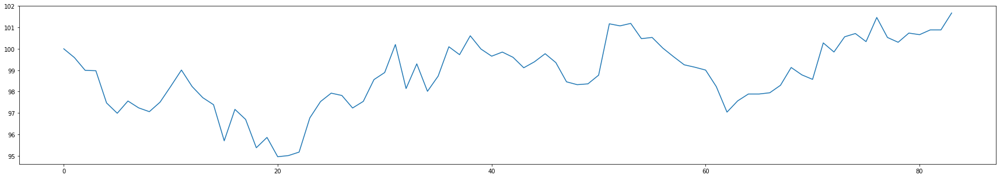

profit: -4.525003155273595
max loss: -3.7813102119460495
max profit: 4.677615954341178
transaction count: 58
loss count: 34
profit count: 24
profit percentage: -4.525003155273595
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


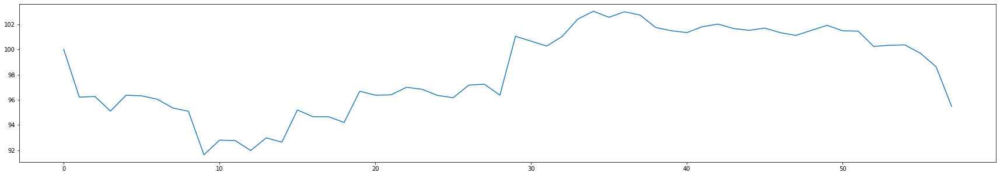

profit: 127.60894296211862
max loss: -6.1329184998270705
max profit: 32.52464407930145
transaction count: 60
loss count: 28
profit count: 32
profit percentage: 127.60894296211862
Hodl strategy expected return of STORMUSDT: 81.46367521367522


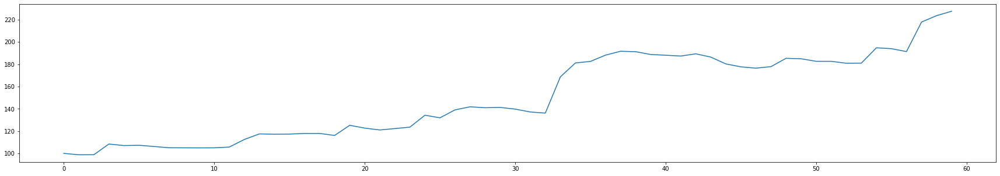

profit: 13.216990745660581
max loss: -3.696941876911339
max profit: 6.191750210221315
transaction count: 68
loss count: 38
profit count: 30
profit percentage: 13.216990745660583
Hodl strategy expected return of STRATUSDT: 28.24267782426778


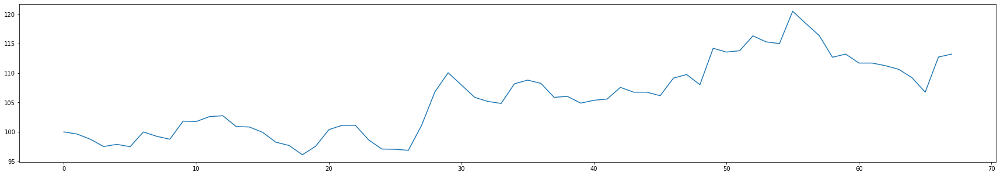

profit: 49.99264385125082
max loss: -3.626884093234736
max profit: 10.102037549160897
transaction count: 65
loss count: 32
profit count: 33
profit percentage: 49.99264385125081
Hodl strategy expected return of TRXUSDT: 21.927066960075457


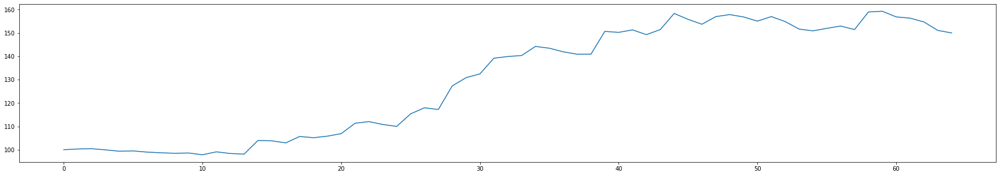

cumulative profit percentage: 144.62343151515788
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 629
cumulative profit count: 445
(profit count / loss count) ratio: 0.7074721780604134


In [62]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

#### determine via psar only

In [63]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]    
    return True if curr_sar < curr_ha_close else False
    
    
def flow(df1):    
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count    
    
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    
    for index in range(len(df1["closes"])):        
        curr_close = df1["closes"][index]                 
              
        if not in_position:                  
            if determinator(df1, index):
                bought_at = curr_close
                in_position = True                    
        else:
            if not determinator(df1, index):
                sold_at = curr_close
                in_position = False                        

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)                                            
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: -9.382635519559628
max loss: -2.665957732991444
max profit: 6.076634532329038
transaction count: 122
loss count: 74
profit count: 48
profit percentage: -9.382635519559628
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


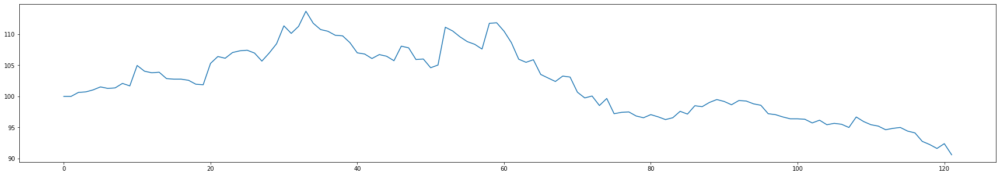

profit: -12.56849406271482
max loss: -5.8466520210943145
max profit: 11.277065005800097
transaction count: 99
loss count: 62
profit count: 37
profit percentage: -12.56849406271482
Hodl strategy expected return of APEUSDT: -57.663335972000255


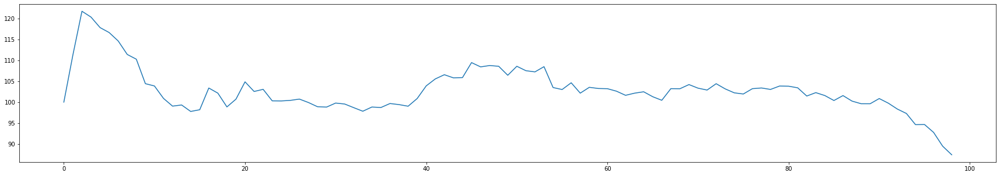

profit: -1.4255550116354812
max loss: -11.44898025725334
max profit: 15.270300023768101
transaction count: 108
loss count: 63
profit count: 45
profit percentage: -1.4255550116354812
Hodl strategy expected return of BEARUSDT: -32.7710843373494


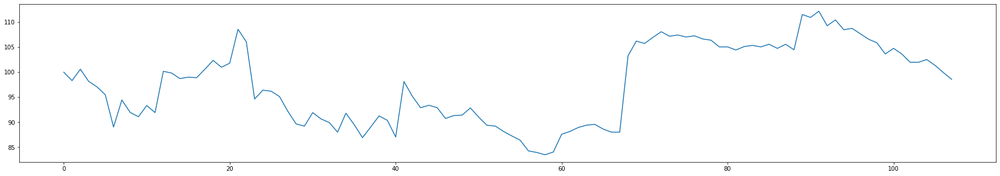

profit: -28.141267283039483
max loss: -8.237223493516396
max profit: 7.008977835808565
transaction count: 118
loss count: 70
profit count: 48
profit percentage: -28.141267283039483
Hodl strategy expected return of BULLUSDT: 5.791070587599496


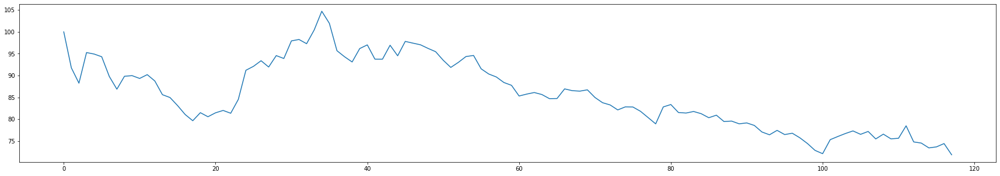

profit: 11.236488970429434
max loss: -2.629454040716311
max profit: 12.426460060393339
transaction count: 104
loss count: 67
profit count: 37
profit percentage: 11.236488970429434
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


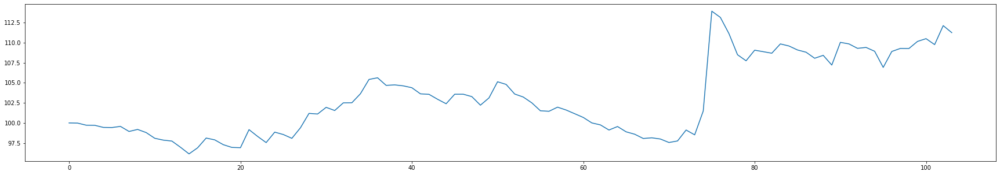

profit: 6.693300156533127
max loss: -5.512786042372952
max profit: 11.071637925828782
transaction count: 99
loss count: 55
profit count: 44
profit percentage: 6.693300156533127
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


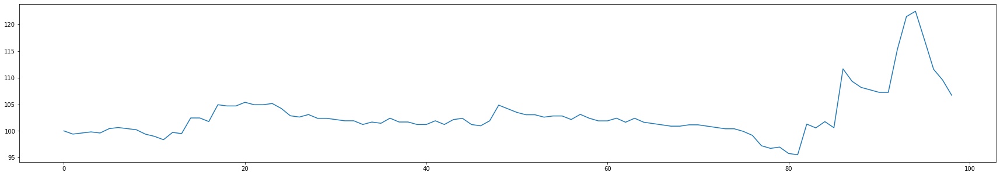

profit: -7.113453253240451
max loss: -5.3710518127521
max profit: 6.926974739750676
transaction count: 104
loss count: 61
profit count: 43
profit percentage: -7.11345325324045
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


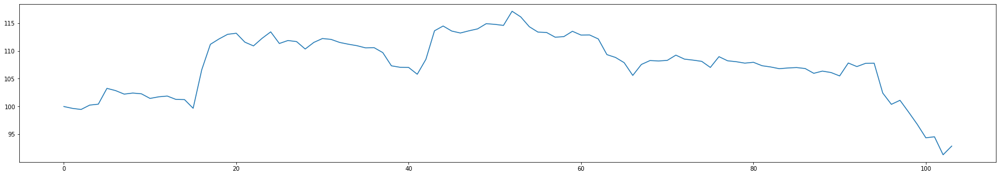

profit: -4.434997737942112
max loss: -3.3409676950180796
max profit: 5.246150023804702
transaction count: 124
loss count: 71
profit count: 53
profit percentage: -4.434997737942112
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


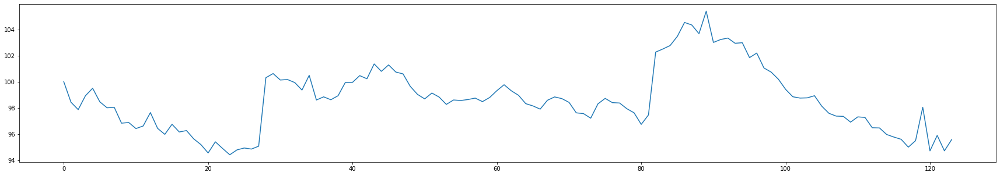

profit: 4.655566005991574
max loss: -4.451587890343575
max profit: 26.44650351124386
transaction count: 113
loss count: 68
profit count: 45
profit percentage: 4.655566005991574
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


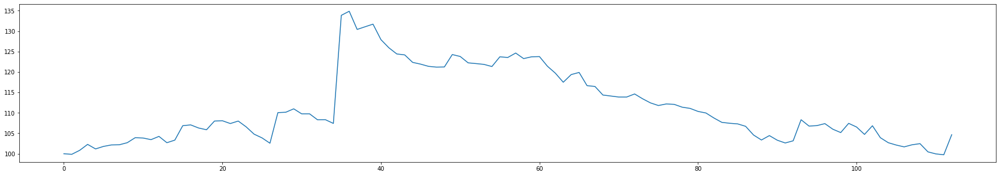

profit: -4.606420747745361
max loss: -6.118459183240304
max profit: 19.34068155096378
transaction count: 111
loss count: 70
profit count: 41
profit percentage: -4.606420747745361
Hodl strategy expected return of MOBUSDT: -45.26532479414456


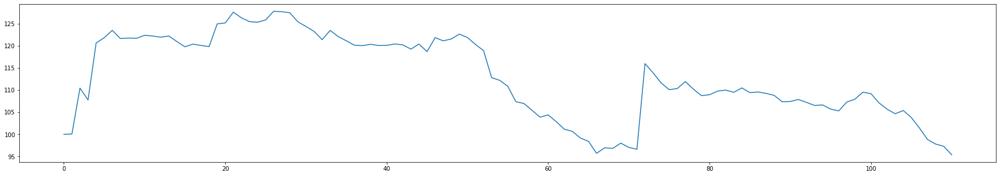

profit: -0.4154962252732304
max loss: -4.4722909634503765
max profit: 3.136306511240818
transaction count: 126
loss count: 68
profit count: 58
profit percentage: -0.4154962252732304
Hodl strategy expected return of NUUSDT: -2.4582809976673325


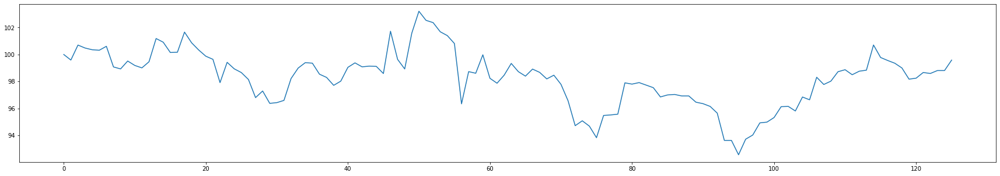

profit: -10.38490917592165
max loss: -3.729758359054145
max profit: 4.570109703125851
transaction count: 96
loss count: 56
profit count: 40
profit percentage: -10.384909175921647
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


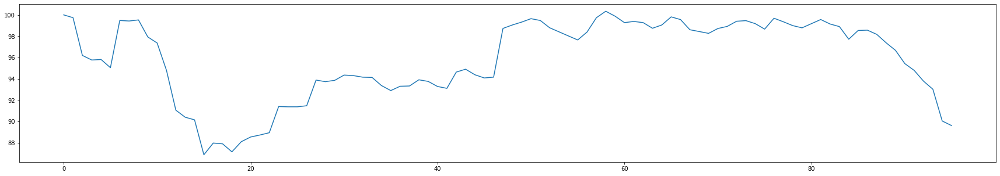

profit: 98.85893384522578
max loss: -9.024318517259758
max profit: 30.79558529394069
transaction count: 115
loss count: 62
profit count: 53
profit percentage: 98.85893384522578
Hodl strategy expected return of STORMUSDT: 81.46367521367522


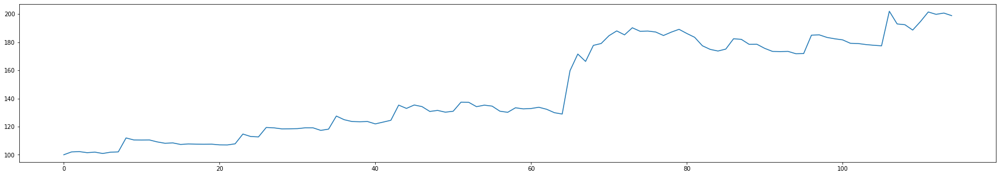

profit: 38.95859627676697
max loss: -4.573026843989368
max profit: 7.7721075710356615
transaction count: 104
loss count: 58
profit count: 46
profit percentage: 38.95859627676697
Hodl strategy expected return of STRATUSDT: 28.24267782426778


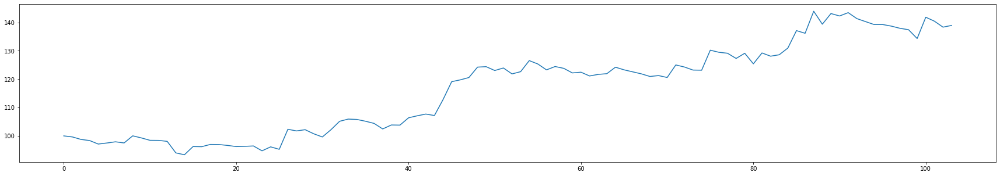

profit: 51.029976491938044
max loss: -3.850299361079749
max profit: 11.233003963276815
transaction count: 100
loss count: 52
profit count: 48
profit percentage: 51.029976491938044
Hodl strategy expected return of TRXUSDT: 21.927066960075457


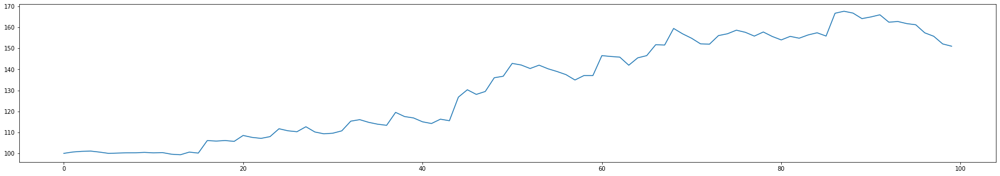

cumulative profit percentage: 132.9596327298127
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 957
cumulative profit count: 686
(profit count / loss count) ratio: 0.7168234064785789


In [64]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### Why to use sma/wma/ema to confirm trend indicators?
Expected finding: using ma reduces false signals, thus decreases loss count

#### eliminate via psar only & determine via psar

In [65]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
            
        ready = True if curr_psar < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 14.398493337433862
max loss: -2.6625883220032733
max profit: 6.456979311554036
transaction count: 66
loss count: 30
profit count: 36
profit percentage: 14.398493337433862
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


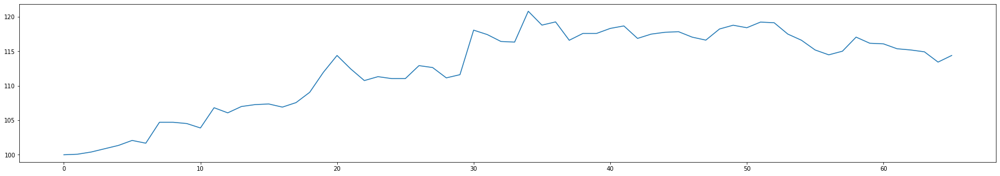

profit: 24.66203390312603
max loss: -2.6556596921744244
max profit: 12.35102217262579
transaction count: 50
loss count: 27
profit count: 23
profit percentage: 24.66203390312603
Hodl strategy expected return of APEUSDT: -57.663335972000255


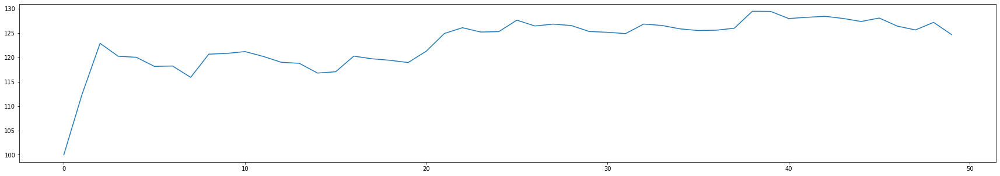

profit: 27.729605927991614
max loss: -4.21104883568097
max profit: 17.36493144274722
transaction count: 64
loss count: 35
profit count: 29
profit percentage: 27.729605927991614
Hodl strategy expected return of BEARUSDT: -32.7710843373494


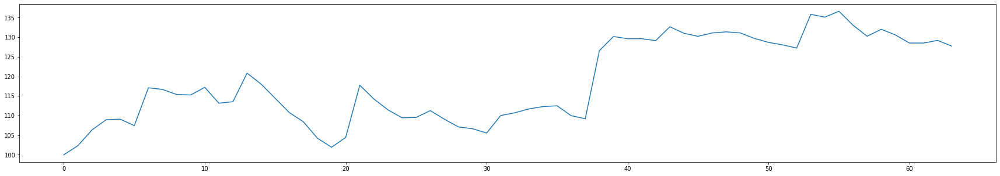

profit: 4.287718194596792
max loss: -5.304923033688098
max profit: 8.28159845113008
transaction count: 79
loss count: 42
profit count: 37
profit percentage: 4.287718194596792
Hodl strategy expected return of BULLUSDT: 5.791070587599496


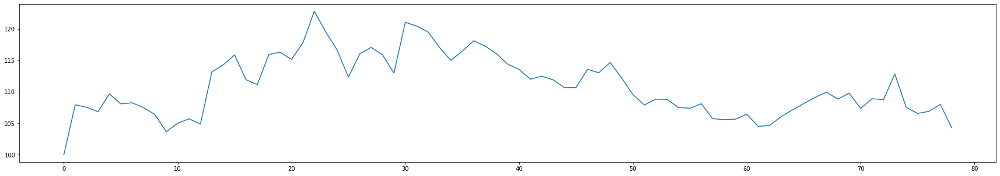

profit: 17.05608242670455
max loss: -2.307287573869445
max profit: 12.356192119971013
transaction count: 60
loss count: 35
profit count: 25
profit percentage: 17.05608242670455
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


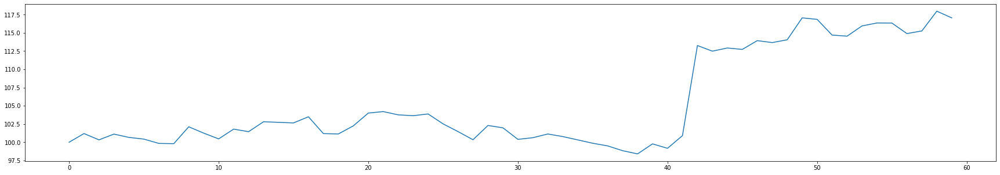

profit: 26.486540560126087
max loss: -5.837840333544278
max profit: 11.856097606526674
transaction count: 59
loss count: 23
profit count: 36
profit percentage: 26.486540560126087
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


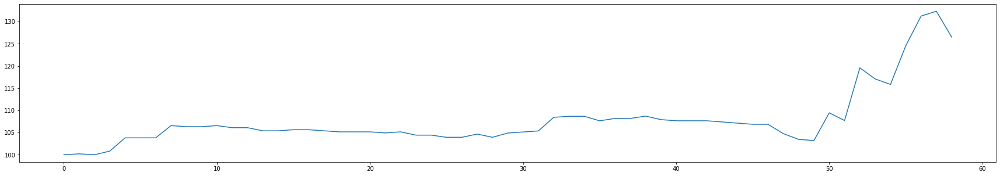

profit: 16.783796765140764
max loss: -2.4356371532641816
max profit: 6.609257750856415
transaction count: 52
loss count: 26
profit count: 26
profit percentage: 16.783796765140764
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


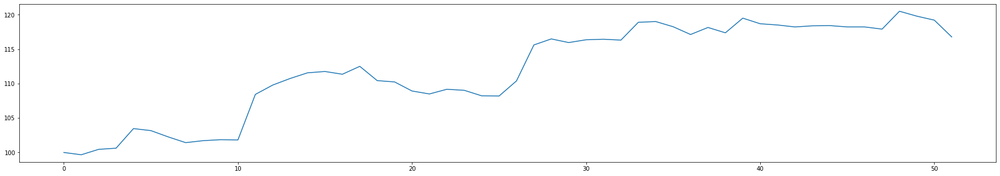

profit: 20.124888385473696
max loss: -4.078862358992822
max profit: 6.4556646328066165
transaction count: 73
loss count: 32
profit count: 41
profit percentage: 20.124888385473696
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


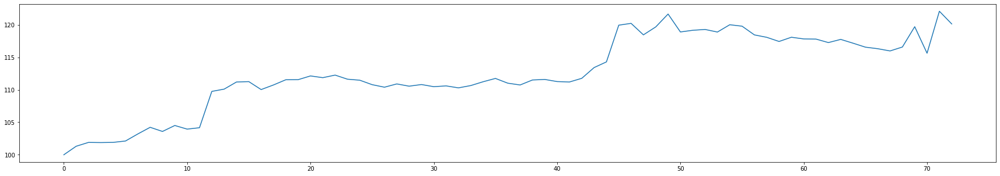

profit: 15.199502290891118
max loss: -4.478459388955514
max profit: 26.436197803911696
transaction count: 70
loss count: 39
profit count: 31
profit percentage: 15.199502290891118
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


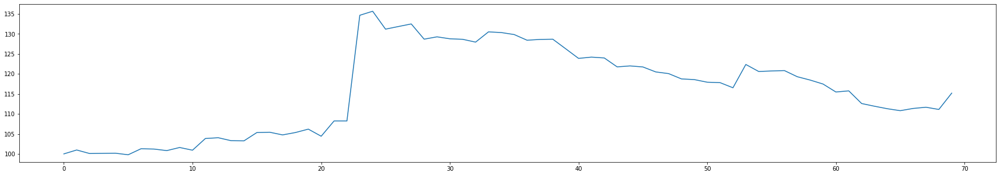

profit: 11.10943702397411
max loss: -2.2550495165074693
max profit: 18.059365450338802
transaction count: 49
loss count: 27
profit count: 22
profit percentage: 11.10943702397411
Hodl strategy expected return of MOBUSDT: -45.26532479414456


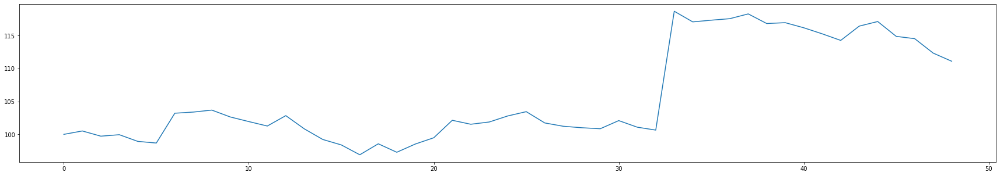

profit: 19.29293877152334
max loss: -2.3753151739637133
max profit: 2.8507569428721524
transaction count: 80
loss count: 33
profit count: 47
profit percentage: 19.29293877152334
Hodl strategy expected return of NUUSDT: -2.4582809976673325


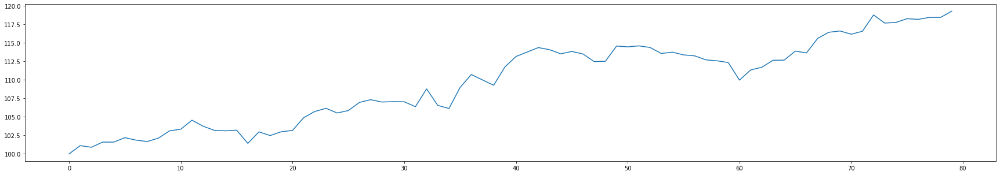

profit: 9.099478236783256
max loss: -2.5399660266111823
max profit: 5.303288283153549
transaction count: 50
loss count: 29
profit count: 21
profit percentage: 9.099478236783256
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


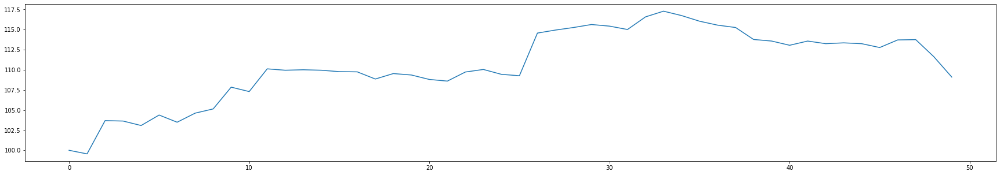

profit: 95.65262284314414
max loss: -8.995939099018614
max profit: 29.27109455462069
transaction count: 69
loss count: 35
profit count: 34
profit percentage: 95.65262284314414
Hodl strategy expected return of STORMUSDT: 81.46367521367522


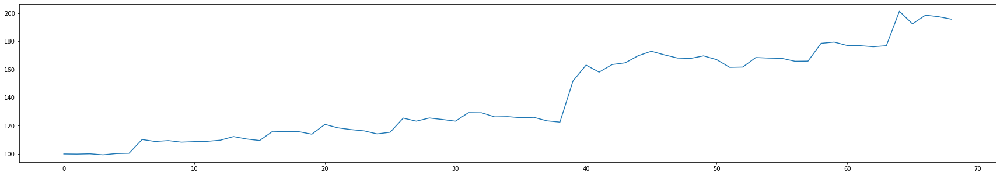

profit: 29.59194325746094
max loss: -4.163421164599313
max profit: 6.787436033444052
transaction count: 62
loss count: 34
profit count: 28
profit percentage: 29.59194325746094
Hodl strategy expected return of STRATUSDT: 28.24267782426778


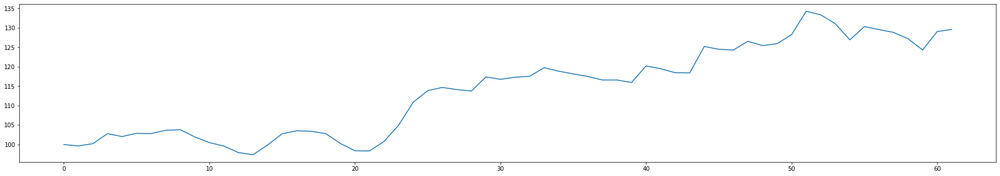

profit: 76.5109959023332
max loss: -2.7314619621684244
max profit: 11.476783552404271
transaction count: 60
loss count: 27
profit count: 33
profit percentage: 76.5109959023332
Hodl strategy expected return of TRXUSDT: 21.927066960075457


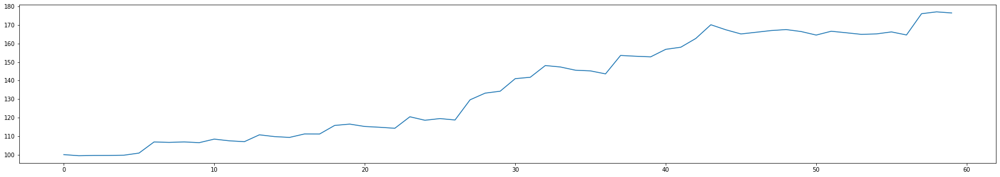

cumulative profit percentage: 407.98607782670354
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 474
cumulative profit count: 469
(profit count / loss count) ratio: 0.989451476793249


In [66]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

#### eliminate via psar + wma & determine via psar

In [67]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 15.286675627708576
max loss: -2.040411011954788
max profit: 6.5531434817698795
transaction count: 55
loss count: 28
profit count: 27
profit percentage: 15.286675627708576
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


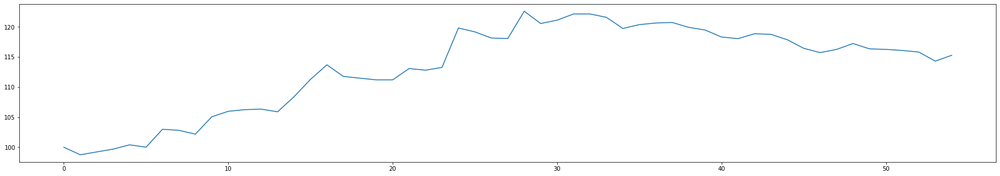

profit: 13.915252361070216
max loss: -2.462796984409181
max profit: 9.770416273405402
transaction count: 34
loss count: 18
profit count: 16
profit percentage: 13.915252361070216
Hodl strategy expected return of APEUSDT: -57.663335972000255


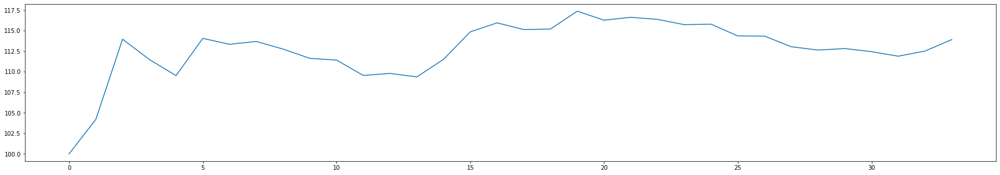

profit: 26.778743721476985
max loss: -4.46206640918723
max profit: 15.563060490013157
transaction count: 53
loss count: 29
profit count: 24
profit percentage: 26.778743721476985
Hodl strategy expected return of BEARUSDT: -32.7710843373494


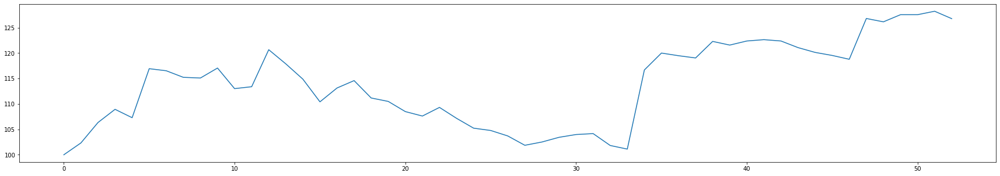

profit: 10.76060535748671
max loss: -5.7162852092768475
max profit: 7.904994787124608
transaction count: 67
loss count: 35
profit count: 32
profit percentage: 10.76060535748671
Hodl strategy expected return of BULLUSDT: 5.791070587599496


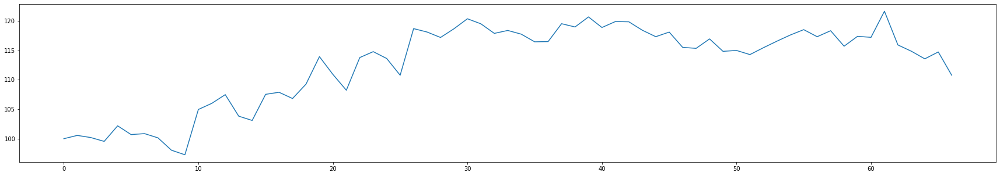

profit: 17.205193066936644
max loss: -2.2633969438184494
max profit: 12.384767531898007
transaction count: 44
loss count: 25
profit count: 19
profit percentage: 17.205193066936644
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


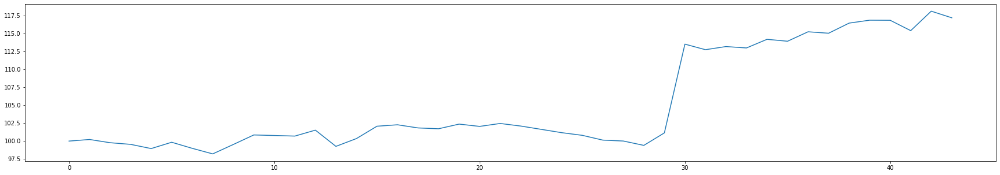

profit: 28.23186863958537
max loss: -5.9183939372116185
max profit: 12.019694302063172
transaction count: 47
loss count: 17
profit count: 30
profit percentage: 28.23186863958537
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


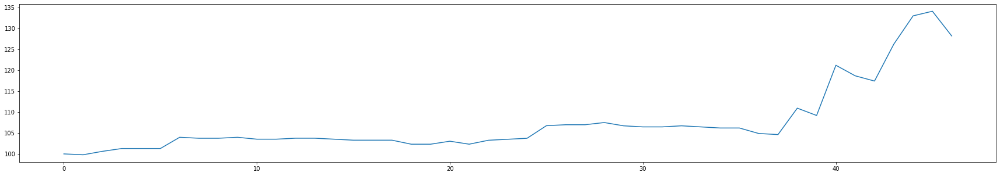

profit: 17.204163522410965
max loss: -2.10369746768383
max profit: 6.6524739992879205
transaction count: 39
loss count: 18
profit count: 21
profit percentage: 17.204163522410965
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


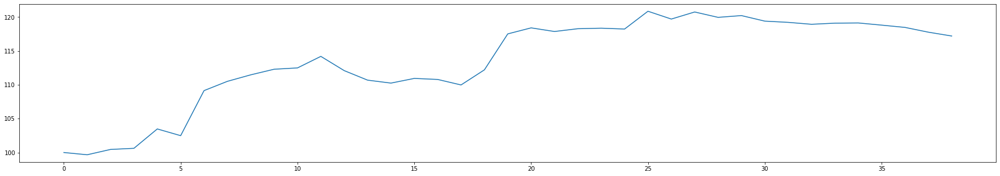

profit: 16.934664916982484
max loss: -3.9705377428595767
max profit: 6.284217956825529
transaction count: 62
loss count: 26
profit count: 36
profit percentage: 16.934664916982484
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


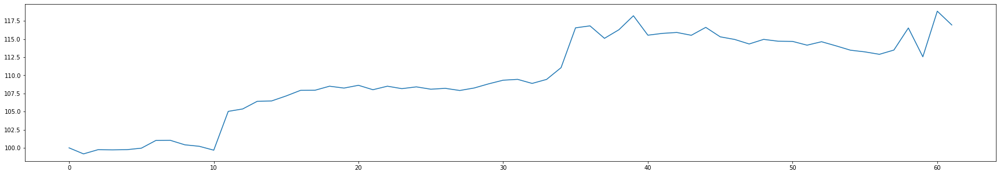

profit: 21.26881536248115
max loss: -4.482932480634446
max profit: 26.462602316300732
transaction count: 55
loss count: 28
profit count: 27
profit percentage: 21.26881536248115
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


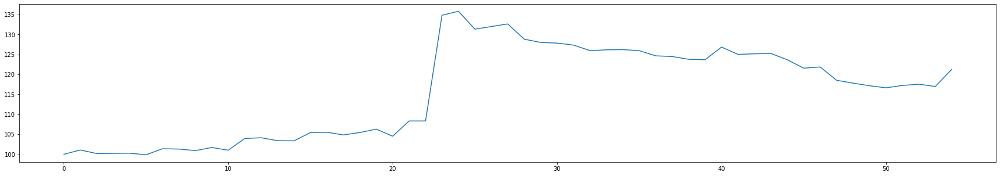

profit: 14.747495293674675
max loss: -2.3033032674636473
max profit: 18.264850048757836
transaction count: 34
loss count: 18
profit count: 16
profit percentage: 14.747495293674675
Hodl strategy expected return of MOBUSDT: -45.26532479414456


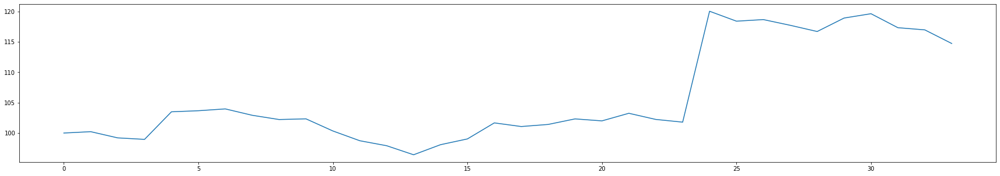

profit: 14.326300356458518
max loss: -2.184833926142261
max profit: 2.78832577732112
transaction count: 65
loss count: 29
profit count: 36
profit percentage: 14.32630035645852
Hodl strategy expected return of NUUSDT: -2.4582809976673325


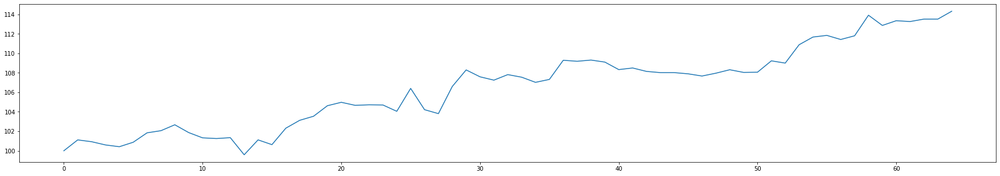

profit: 14.758876039993012
max loss: -0.8966426122214415
max profit: 5.291354427607018
transaction count: 37
loss count: 19
profit count: 18
profit percentage: 14.758876039993012
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


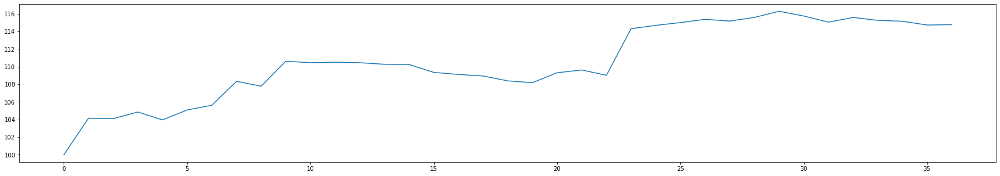

profit: 94.8756989468036
max loss: -9.156429922265346
max profit: 29.134608102531473
transaction count: 50
loss count: 26
profit count: 24
profit percentage: 94.87569894680361
Hodl strategy expected return of STORMUSDT: 81.46367521367522


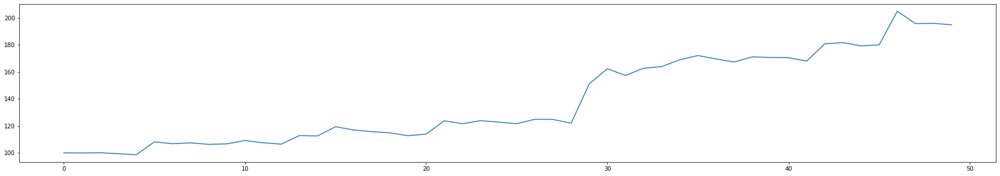

profit: 29.171562225473906
max loss: -4.025889391256371
max profit: 6.563224242893369
transaction count: 53
loss count: 30
profit count: 23
profit percentage: 29.17156222547391
Hodl strategy expected return of STRATUSDT: 28.24267782426778


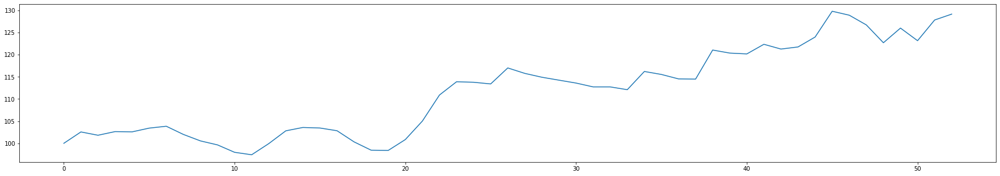

profit: 74.61589418838963
max loss: -2.7300943600656353
max profit: 11.471037298736121
transaction count: 55
loss count: 24
profit count: 31
profit percentage: 74.61589418838963
Hodl strategy expected return of TRXUSDT: 21.927066960075457


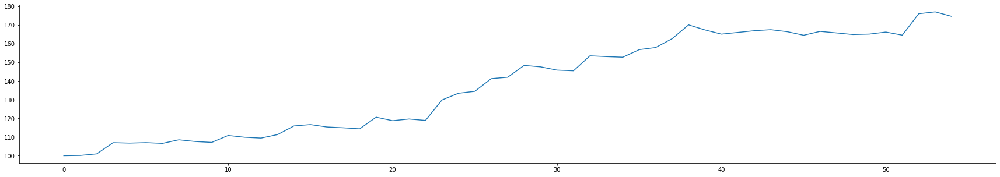

cumulative profit percentage: 410.0818096269324
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 370
cumulative profit count: 380
(profit count / loss count) ratio: 1.027027027027027


In [68]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### Why to use adx to eliminate signals?
Expected finding: using adx reduces false signals, thus decreases loss count

#### eliminate via psar only & determine via psar

In [69]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]        
            
        ready = True if curr_psar < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 14.398493337433862
max loss: -2.6625883220032733
max profit: 6.456979311554036
transaction count: 66
loss count: 30
profit count: 36
profit percentage: 14.398493337433862
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


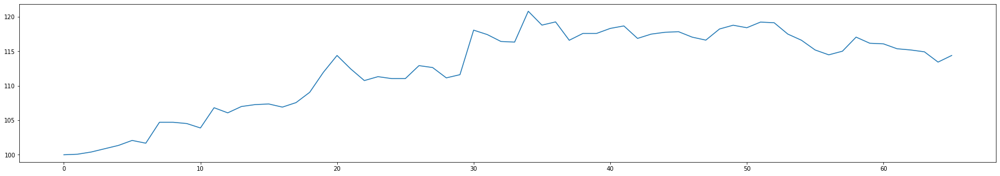

profit: 24.66203390312603
max loss: -2.6556596921744244
max profit: 12.35102217262579
transaction count: 50
loss count: 27
profit count: 23
profit percentage: 24.66203390312603
Hodl strategy expected return of APEUSDT: -57.663335972000255


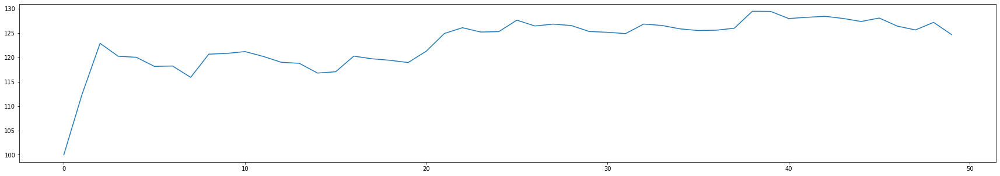

profit: 27.729605927991614
max loss: -4.21104883568097
max profit: 17.36493144274722
transaction count: 64
loss count: 35
profit count: 29
profit percentage: 27.729605927991614
Hodl strategy expected return of BEARUSDT: -32.7710843373494


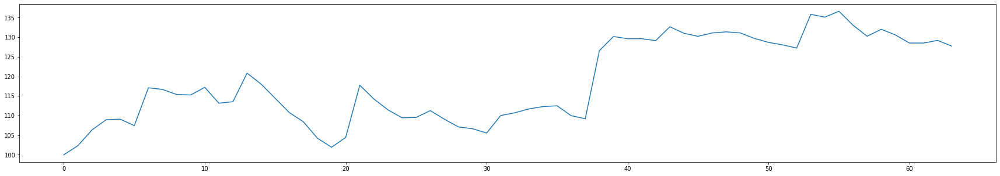

profit: 4.287718194596792
max loss: -5.304923033688098
max profit: 8.28159845113008
transaction count: 79
loss count: 42
profit count: 37
profit percentage: 4.287718194596792
Hodl strategy expected return of BULLUSDT: 5.791070587599496


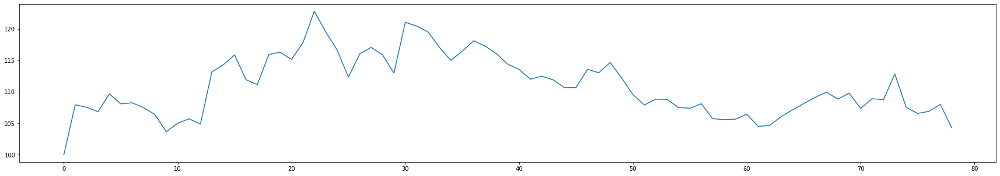

profit: 17.05608242670455
max loss: -2.307287573869445
max profit: 12.356192119971013
transaction count: 60
loss count: 35
profit count: 25
profit percentage: 17.05608242670455
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


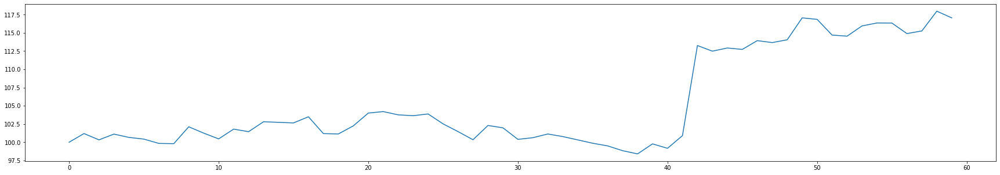

profit: 26.486540560126087
max loss: -5.837840333544278
max profit: 11.856097606526674
transaction count: 59
loss count: 23
profit count: 36
profit percentage: 26.486540560126087
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


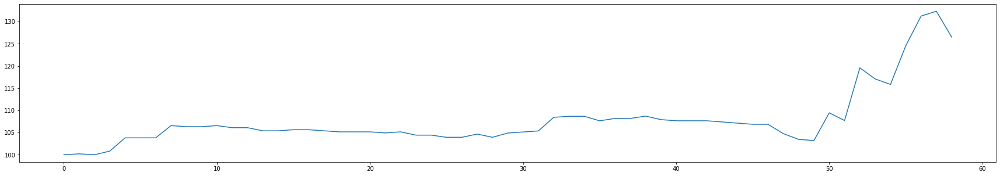

profit: 16.783796765140764
max loss: -2.4356371532641816
max profit: 6.609257750856415
transaction count: 52
loss count: 26
profit count: 26
profit percentage: 16.783796765140764
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


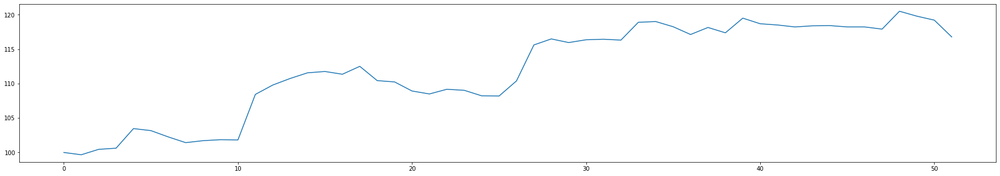

profit: 20.124888385473696
max loss: -4.078862358992822
max profit: 6.4556646328066165
transaction count: 73
loss count: 32
profit count: 41
profit percentage: 20.124888385473696
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


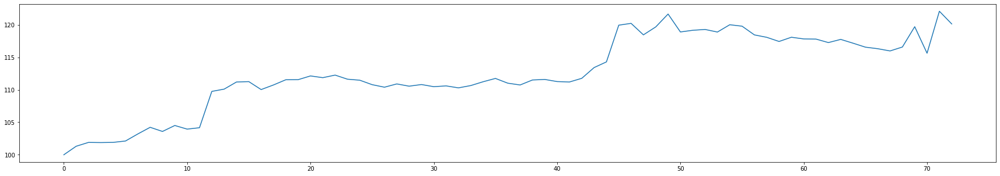

profit: 15.199502290891118
max loss: -4.478459388955514
max profit: 26.436197803911696
transaction count: 70
loss count: 39
profit count: 31
profit percentage: 15.199502290891118
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


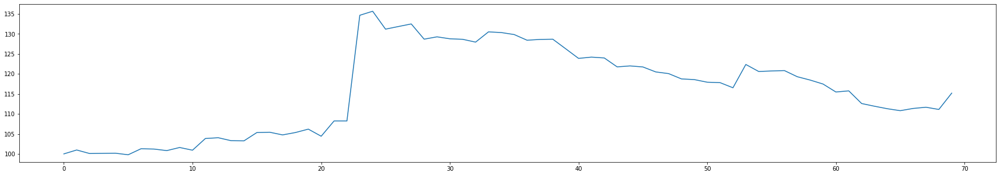

profit: 11.10943702397411
max loss: -2.2550495165074693
max profit: 18.059365450338802
transaction count: 49
loss count: 27
profit count: 22
profit percentage: 11.10943702397411
Hodl strategy expected return of MOBUSDT: -45.26532479414456


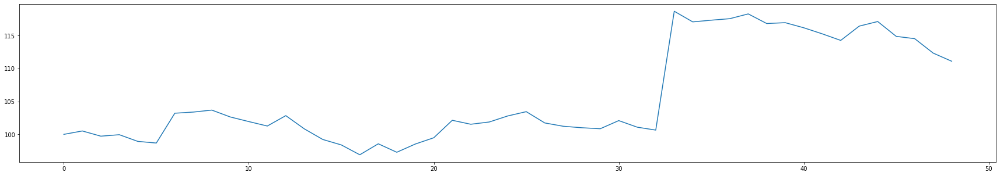

profit: 19.29293877152334
max loss: -2.3753151739637133
max profit: 2.8507569428721524
transaction count: 80
loss count: 33
profit count: 47
profit percentage: 19.29293877152334
Hodl strategy expected return of NUUSDT: -2.4582809976673325


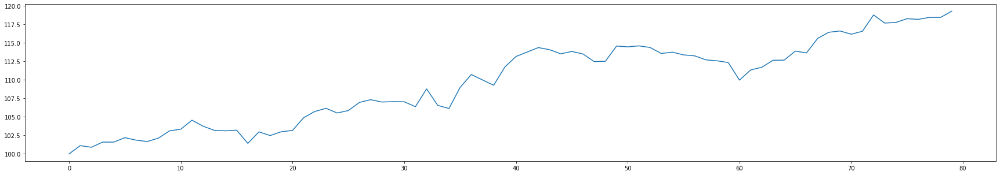

profit: 9.099478236783256
max loss: -2.5399660266111823
max profit: 5.303288283153549
transaction count: 50
loss count: 29
profit count: 21
profit percentage: 9.099478236783256
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


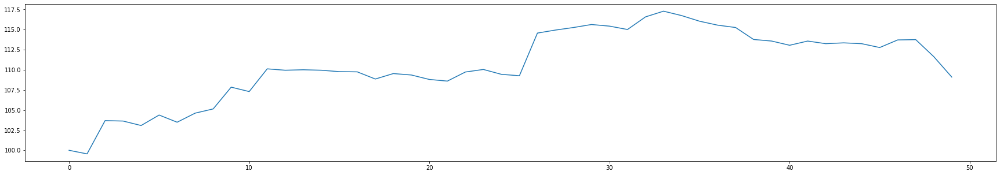

profit: 95.65262284314414
max loss: -8.995939099018614
max profit: 29.27109455462069
transaction count: 69
loss count: 35
profit count: 34
profit percentage: 95.65262284314414
Hodl strategy expected return of STORMUSDT: 81.46367521367522


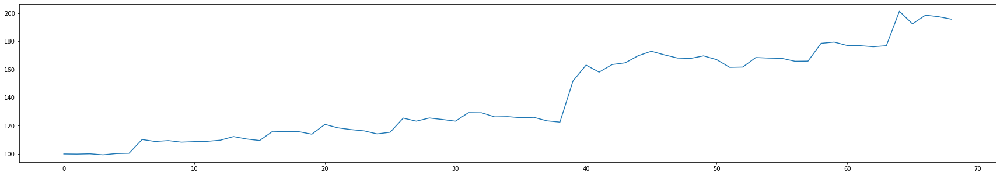

profit: 29.59194325746094
max loss: -4.163421164599313
max profit: 6.787436033444052
transaction count: 62
loss count: 34
profit count: 28
profit percentage: 29.59194325746094
Hodl strategy expected return of STRATUSDT: 28.24267782426778


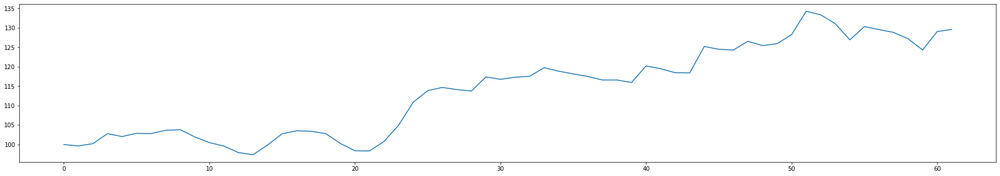

profit: 76.5109959023332
max loss: -2.7314619621684244
max profit: 11.476783552404271
transaction count: 60
loss count: 27
profit count: 33
profit percentage: 76.5109959023332
Hodl strategy expected return of TRXUSDT: 21.927066960075457


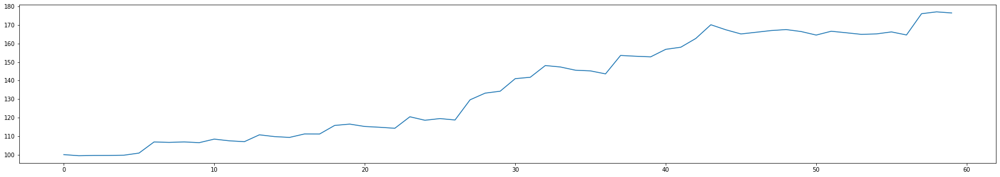

cumulative profit percentage: 407.98607782670354
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 474
cumulative profit count: 469
(profit count / loss count) ratio: 0.989451476793249


In [70]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

#### eliminate psar +  adx & determine via psar

In [71]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_adx = df2["adx"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_adx >= 25 else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 2.595409705650013
max loss: -2.291209101204558
max profit: 3.8503755392830357
transaction count: 22
loss count: 9
profit count: 13
profit percentage: 2.595409705650013
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


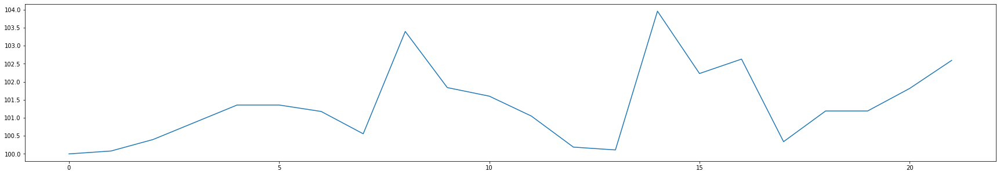

profit: 22.05077926952201
max loss: -2.478991627341202
max profit: 12.35102217262579
transaction count: 41
loss count: 21
profit count: 20
profit percentage: 22.05077926952201
Hodl strategy expected return of APEUSDT: -57.663335972000255


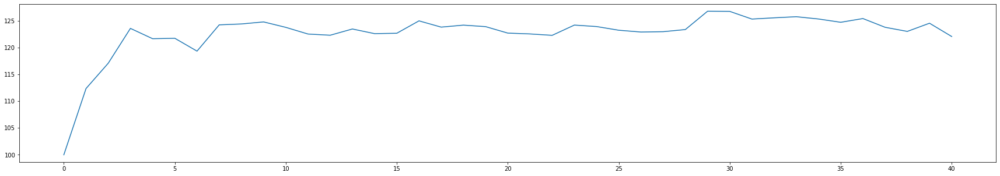

profit: -11.188111471034986
max loss: -3.7960004619293244
max profit: 5.976708029692091
transaction count: 37
loss count: 22
profit count: 15
profit percentage: -11.188111471034986
Hodl strategy expected return of BEARUSDT: -32.7710843373494


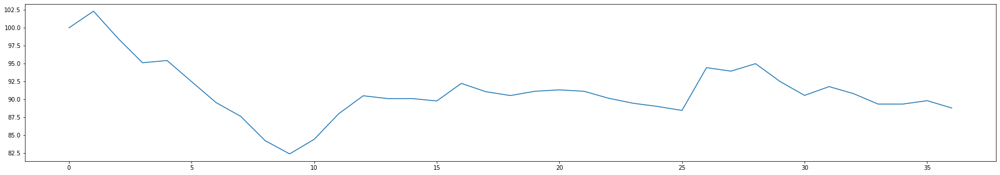

profit: 15.828185502250136
max loss: -5.8919652271481056
max profit: 8.401769744075423
transaction count: 48
loss count: 20
profit count: 28
profit percentage: 15.828185502250134
Hodl strategy expected return of BULLUSDT: 5.791070587599496


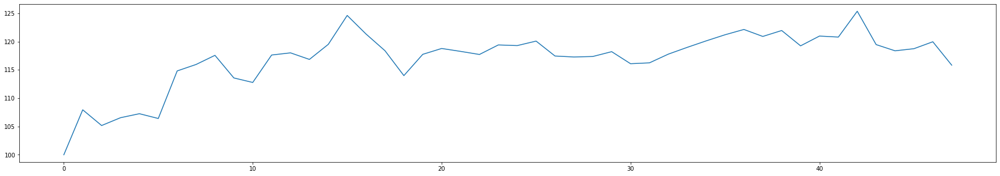

profit: 1.5071849184848531
max loss: -2.2698721933085864
max profit: 2.2876614002543647
transaction count: 36
loss count: 22
profit count: 14
profit percentage: 1.5071849184848531
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


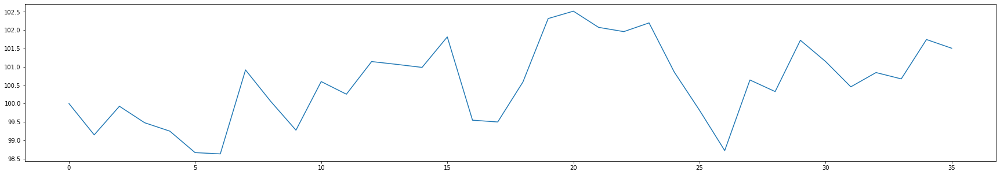

profit: 22.57939040636022
max loss: -5.657510326447394
max profit: 11.489864540294747
transaction count: 23
loss count: 7
profit count: 16
profit percentage: 22.57939040636022
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


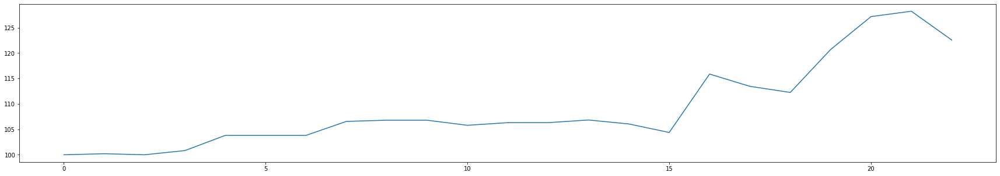

profit: 10.20538521158609
max loss: -2.2984381236631606
max profit: 6.628034792172031
transaction count: 38
loss count: 18
profit count: 20
profit percentage: 10.20538521158609
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


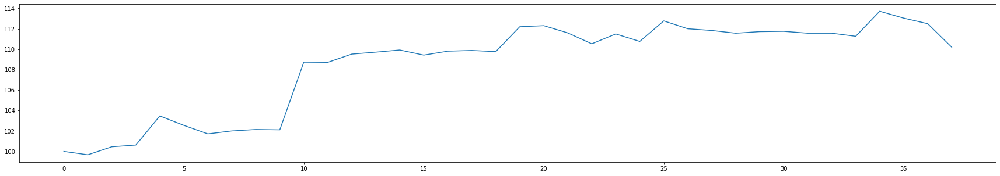

profit: 0.6655111770970308
max loss: -3.4181156786713274
max profit: 5.409892895500661
transaction count: 52
loss count: 26
profit count: 26
profit percentage: 0.6655111770970308
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


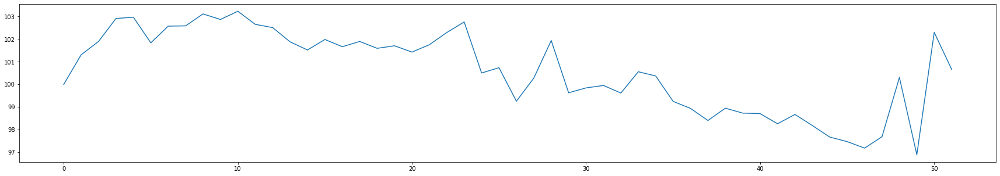

profit: 27.023783084590647
max loss: -4.517893492040173
max profit: 26.668976011510665
transaction count: 35
loss count: 16
profit count: 19
profit percentage: 27.023783084590647
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


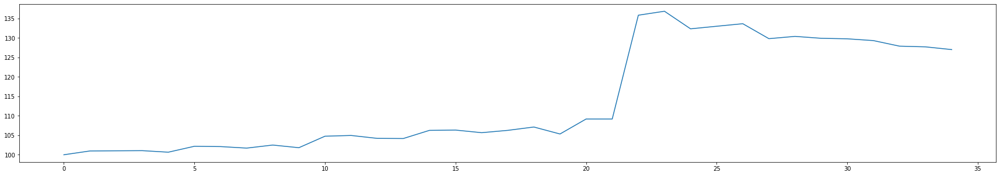

profit: 9.154173727640725
max loss: -2.2153659786447975
max profit: 17.567886380903886
transaction count: 18
loss count: 11
profit count: 7
profit percentage: 9.154173727640725
Hodl strategy expected return of MOBUSDT: -45.26532479414456


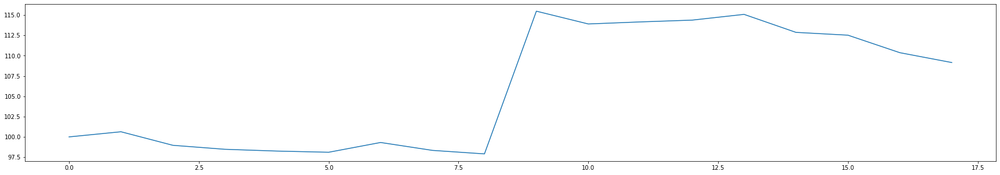

profit: 5.999826055415639
max loss: -2.224924341612933
max profit: 2.6862997718281463
transaction count: 45
loss count: 21
profit count: 24
profit percentage: 5.999826055415639
Hodl strategy expected return of NUUSDT: -2.4582809976673325


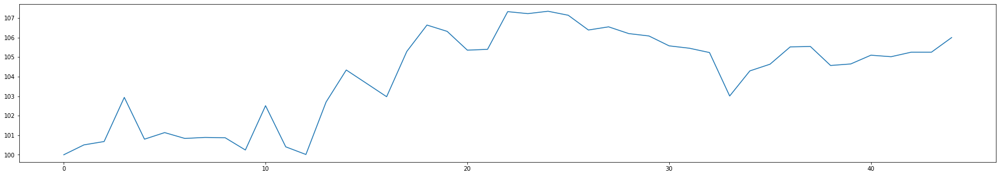

profit: -4.598077599358575
max loss: -2.221070583354333
max profit: 2.6181920665116536
transaction count: 28
loss count: 19
profit count: 9
profit percentage: -4.598077599358575
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


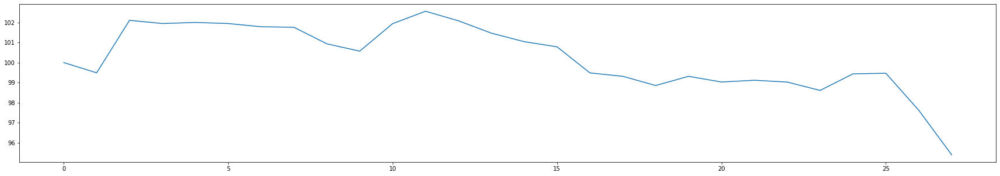

profit: 60.589905793878756
max loss: -7.0815690492465535
max profit: 15.215824165102475
transaction count: 47
loss count: 20
profit count: 27
profit percentage: 60.58990579387875
Hodl strategy expected return of STORMUSDT: 81.46367521367522


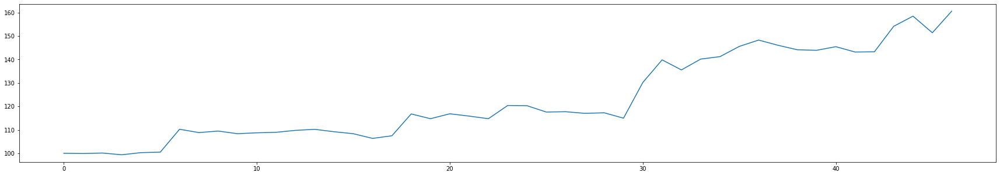

profit: 18.684139561786225
max loss: -3.8853591230189153
max profit: 6.932329138106155
transaction count: 44
loss count: 26
profit count: 18
profit percentage: 18.684139561786225
Hodl strategy expected return of STRATUSDT: 28.24267782426778


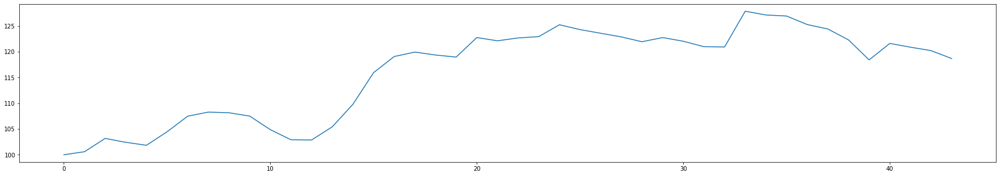

profit: 28.640838106249845
max loss: -1.7646863948650804
max profit: 8.379023970631579
transaction count: 30
loss count: 15
profit count: 15
profit percentage: 28.640838106249845
Hodl strategy expected return of TRXUSDT: 21.927066960075457


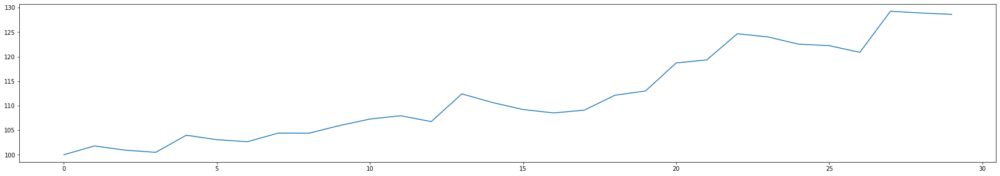

cumulative profit percentage: 209.73832345011863
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 273
cumulative profit count: 271
(profit count / loss count) ratio: 0.9926739926739927


In [72]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### Why not to use sma/wma/ema while triggering?
Expected finding: using ma causes lags, thus decreases profit

#### eliminate via sma + psar + adx & determine via psar + sma

In [73]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
        
        curr_adx = df2["adx"][index]
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close and curr_adx >= 25 else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    curr_ma = df1["sma"][index]
    return True if curr_sar < curr_ha_close and curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 2.085701919001508
max loss: -1.7000569669496883
max profit: 3.783628468531134
transaction count: 16
loss count: 8
profit count: 8
profit percentage: 2.085701919001508
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


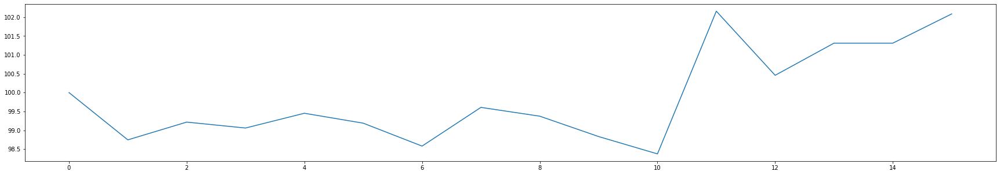

profit: 11.214611680945225
max loss: -2.027428444407107
max profit: 6.027333365209614
transaction count: 22
loss count: 13
profit count: 9
profit percentage: 11.214611680945225
Hodl strategy expected return of APEUSDT: -57.663335972000255


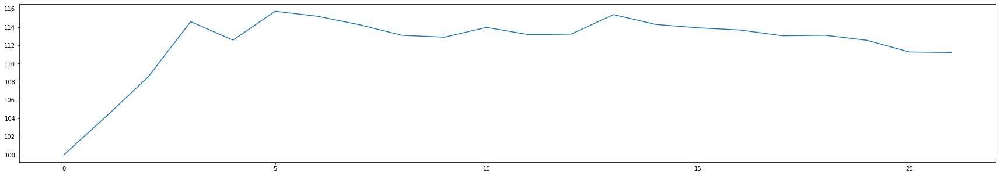

profit: 0.4182252524929595
max loss: -3.7960004619293244
max profit: 6.356241946168041
transaction count: 25
loss count: 14
profit count: 11
profit percentage: 0.4182252524929595
Hodl strategy expected return of BEARUSDT: -32.7710843373494


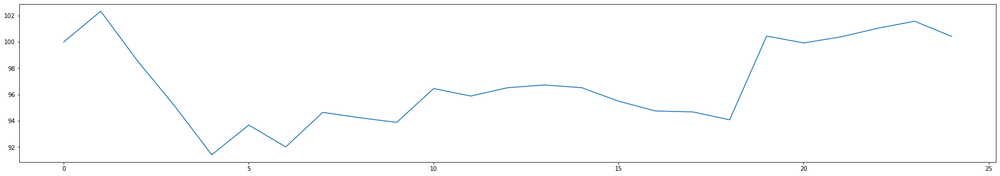

profit: 3.9964199280245367
max loss: -5.3671898517853975
max profit: 7.901828082974205
transaction count: 35
loss count: 17
profit count: 18
profit percentage: 3.9964199280245367
Hodl strategy expected return of BULLUSDT: 5.791070587599496


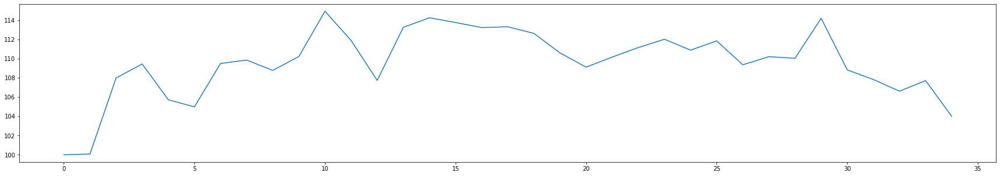

profit: -4.068708019047577
max loss: -2.2406925869795913
max profit: 1.4928099823936947
transaction count: 27
loss count: 19
profit count: 8
profit percentage: -4.068708019047577
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


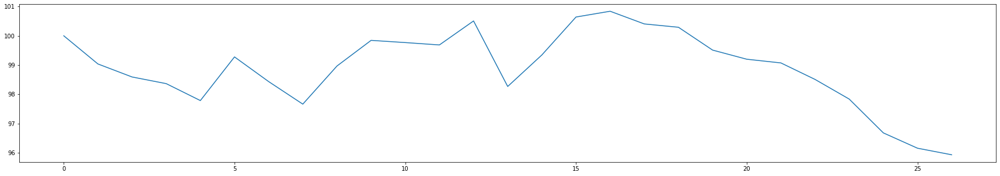

profit: 11.465642072124439
max loss: -5.144568095636515
max profit: 7.921935274013833
transaction count: 15
loss count: 4
profit count: 11
profit percentage: 11.465642072124437
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


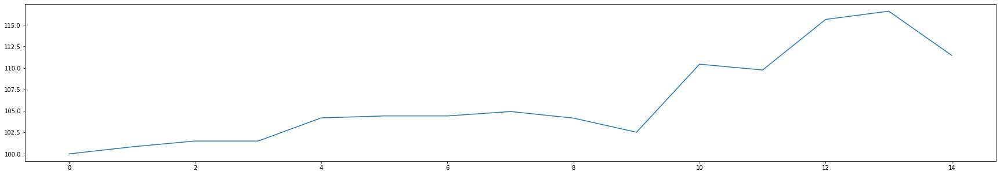

profit: 6.619674191571306
max loss: -0.9870023626323814
max profit: 4.3325906690422755
transaction count: 24
loss count: 12
profit count: 12
profit percentage: 6.619674191571306
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


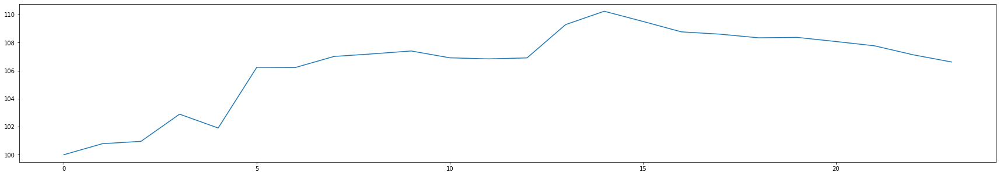

profit: -3.453429158991142
max loss: -3.2782563129594138
max profit: 5.18853579115941
transaction count: 45
loss count: 23
profit count: 22
profit percentage: -3.453429158991142
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


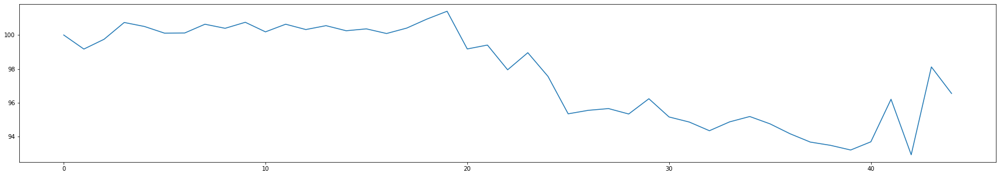

profit: 21.38335078956824
max loss: -4.375346430095163
max profit: 25.827525414629534
transaction count: 28
loss count: 12
profit count: 16
profit percentage: 21.38335078956824
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


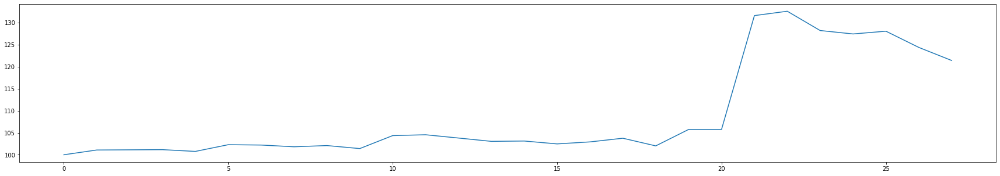

profit: 8.561627910211726
max loss: -2.179135602453073
max profit: 17.421071516681366
transaction count: 10
loss count: 7
profit count: 3
profit percentage: 8.561627910211726
Hodl strategy expected return of MOBUSDT: -45.26532479414456


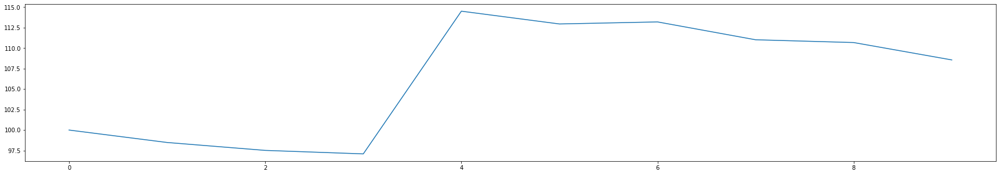

profit: -1.8434872255099037
max loss: -2.1244957533590423
max profit: 2.252075705719818
transaction count: 34
loss count: 19
profit count: 15
profit percentage: -1.8434872255099037
Hodl strategy expected return of NUUSDT: -2.4582809976673325


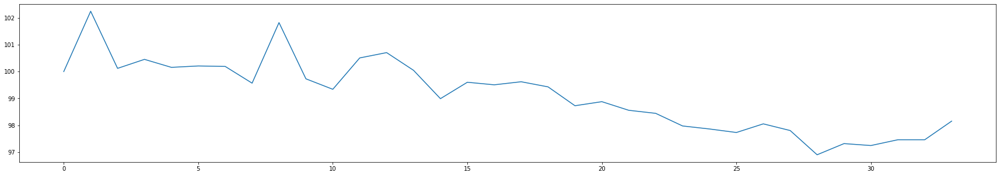

profit: 0.6081554751400233
max loss: -0.8280708487688315
max profit: 2.5489669975851967
transaction count: 12
loss count: 7
profit count: 5
profit percentage: 0.6081554751400233
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


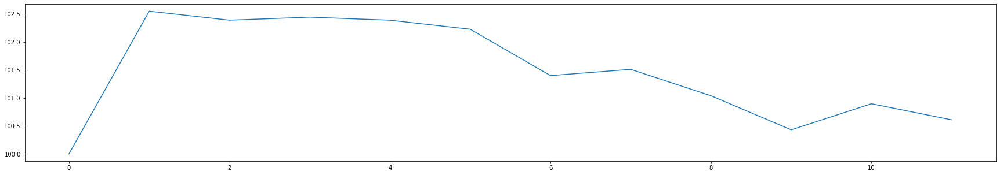

profit: 50.38311254146416
max loss: -4.574547956180453
max profit: 14.928639576413644
transaction count: 33
loss count: 17
profit count: 16
profit percentage: 50.38311254146416
Hodl strategy expected return of STORMUSDT: 81.46367521367522


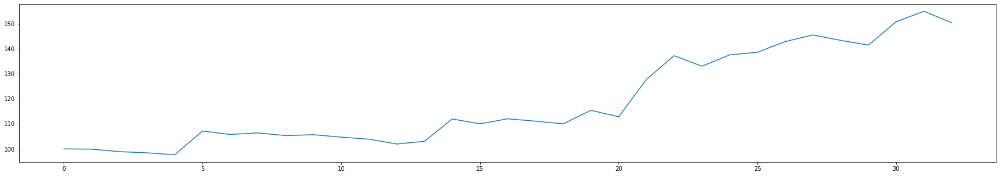

profit: 8.527250339747255
max loss: -3.5345552192551963
max profit: 6.306418367229199
transaction count: 36
loss count: 24
profit count: 12
profit percentage: 8.527250339747255
Hodl strategy expected return of STRATUSDT: 28.24267782426778


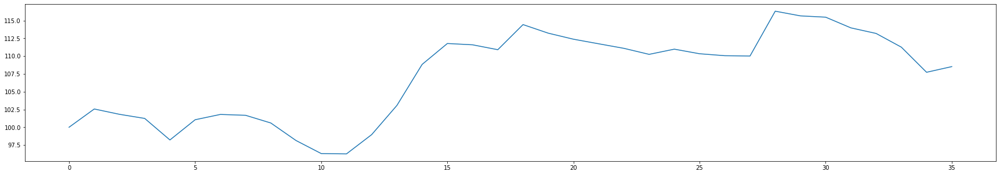

profit: 28.231915731939125
max loss: -1.753932953835431
max profit: 6.734215629256681
transaction count: 28
loss count: 12
profit count: 16
profit percentage: 28.231915731939125
Hodl strategy expected return of TRXUSDT: 21.927066960075457


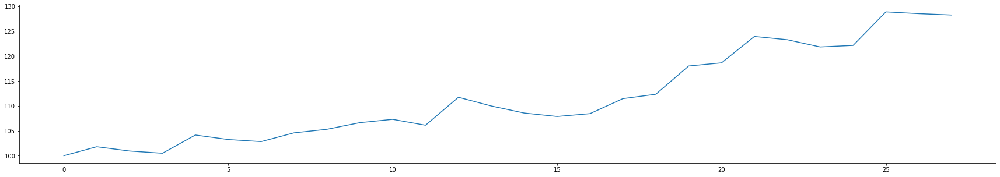

cumulative profit percentage: 144.13006342868186
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 208
cumulative profit count: 182
(profit count / loss count) ratio: 0.875


In [74]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

#### eliminate via sma + psar + adx & determine via psar only

In [75]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
        
        curr_adx = df2["adx"][index]
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close and curr_adx >= 25 else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 4.288689421909623
max loss: -1.7260725937936314
max profit: 3.8415285673319346
transaction count: 17
loss count: 8
profit count: 9
profit percentage: 4.288689421909623
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


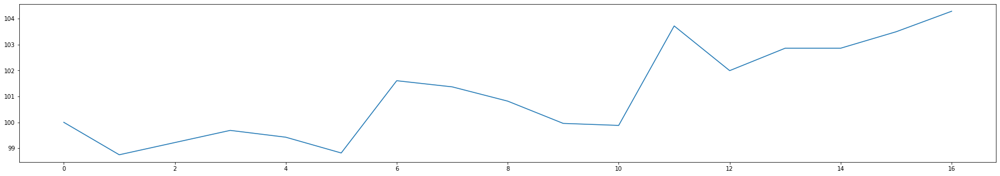

profit: 11.907509909237959
max loss: -2.027428444407107
max profit: 6.027333365209614
transaction count: 22
loss count: 12
profit count: 10
profit percentage: 11.907509909237959
Hodl strategy expected return of APEUSDT: -57.663335972000255


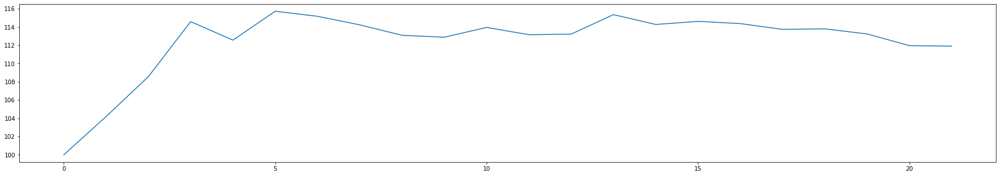

KeyboardInterrupt: 

In [76]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### Why not to use adx while triggering?
Expected finding: using adx causes lags, thus decreases profit

#### eliminate via sma + psar + adx & determine via psar + adx

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
        
        curr_adx = df2["adx"][index]
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close and curr_adx >= 25 else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    curr_adx = df1["adx"][index]
    return True if curr_sar < curr_ha_close and curr_adx >= 25 else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]
        curr_close = df1["closes"][index]        
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: -3.8662041946924433
max loss: -1.3975073605974444
max profit: 0.47096700240716416
transaction count: 9
loss count: 6
profit count: 3
profit percentage: -3.8662041946924433
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


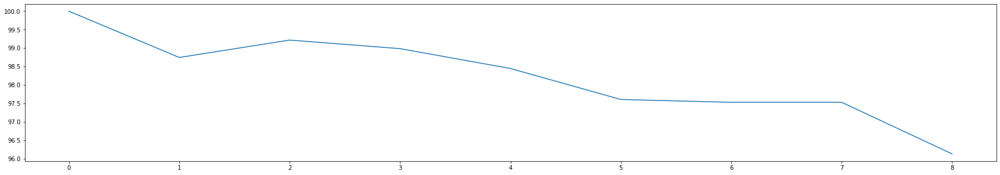

profit: 11.099279333580384
max loss: -2.027428444407107
max profit: 6.027333365209614
transaction count: 7
loss count: 3
profit count: 4
profit percentage: 11.099279333580384
Hodl strategy expected return of APEUSDT: -57.663335972000255


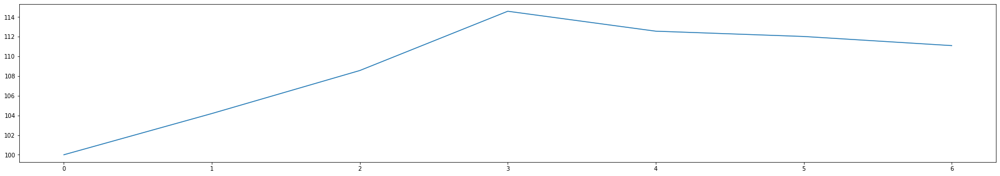

profit: -7.317520549976479
max loss: -3.709677419354847
max profit: 2.613693059721925
transaction count: 12
loss count: 8
profit count: 4
profit percentage: -7.317520549976479
Hodl strategy expected return of BEARUSDT: -32.7710843373494


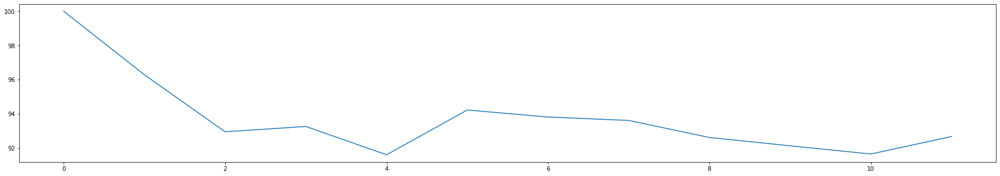

profit: 4.76523427018617
max loss: -5.119128374946527
max profit: 7.895749799518853
transaction count: 23
loss count: 10
profit count: 13
profit percentage: 4.76523427018617
Hodl strategy expected return of BULLUSDT: 5.791070587599496


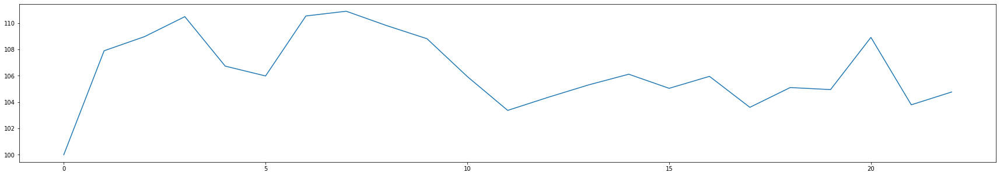

profit: -0.9283056384619499
max loss: -1.3092520053784682
max profit: 1.7414525288590283
transaction count: 17
loss count: 11
profit count: 6
profit percentage: -0.9283056384619499
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


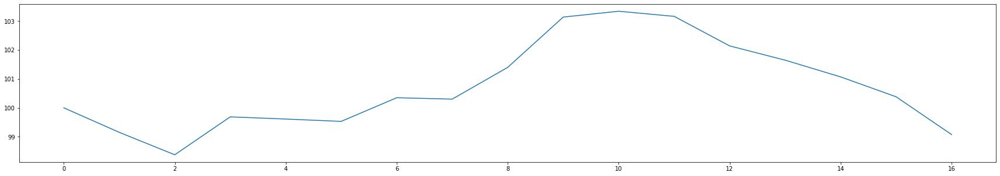

profit: 6.408109567353762
max loss: -4.9111435184932475
max profit: 10.944991299557287
transaction count: 17
loss count: 7
profit count: 10
profit percentage: 6.408109567353762
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


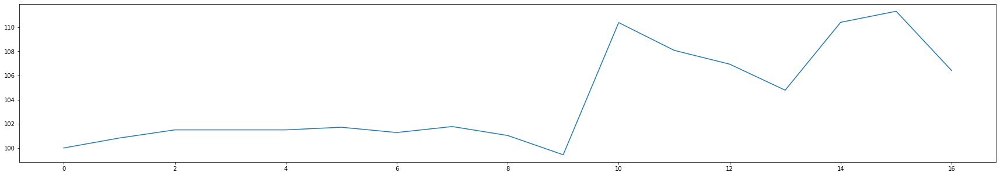

profit: 3.175808911307044
max loss: -1.4839480256252529
max profit: 2.243421310218679
transaction count: 12
loss count: 4
profit count: 8
profit percentage: 3.175808911307044
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


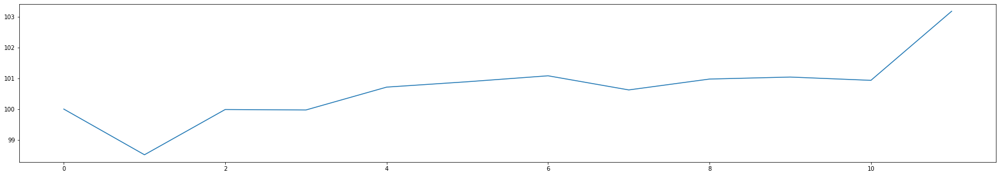

profit: -8.355098883609074
max loss: -2.089806956233673
max profit: 4.925113811682749
transaction count: 25
loss count: 16
profit count: 9
profit percentage: -8.355098883609074
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


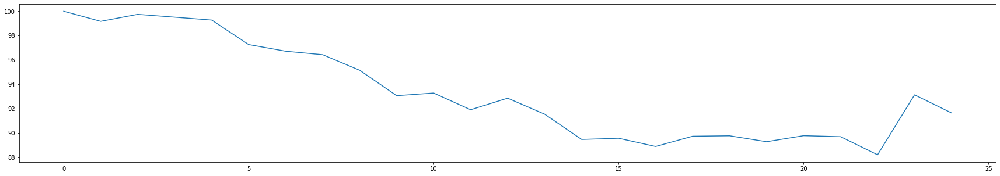

profit: -12.547384265658266
max loss: -5.513993201815978
max profit: 3.554294908211702
transaction count: 28
loss count: 17
profit count: 11
profit percentage: -12.547384265658266
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


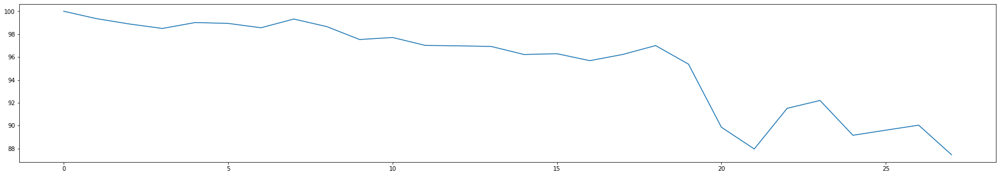

profit: 10.118018429903486
max loss: -2.210376714603541
max profit: 17.670828185528123
transaction count: 8
loss count: 5
profit count: 3
profit percentage: 10.118018429903486
Hodl strategy expected return of MOBUSDT: -45.26532479414456


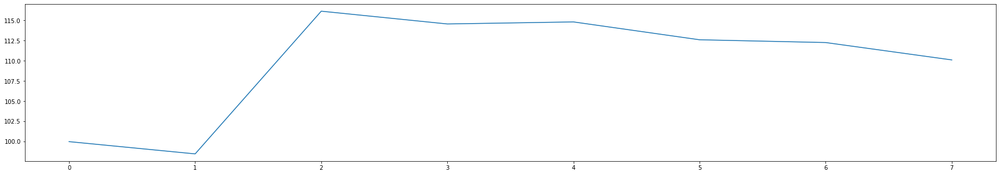

profit: 1.2784149724086973
max loss: -2.0778767242884584
max profit: 2.608755474557654
transaction count: 18
loss count: 9
profit count: 9
profit percentage: 1.2784149724086973
Hodl strategy expected return of NUUSDT: -2.4582809976673325


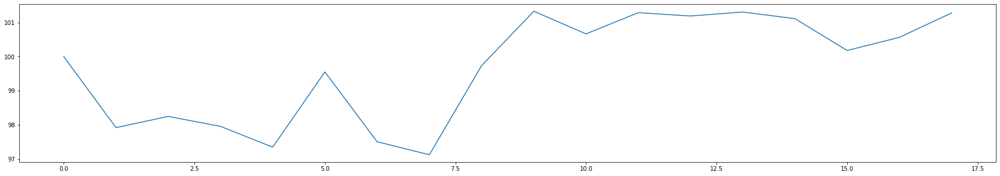

profit: -0.4175095502520634
max loss: -0.6022975817408849
max profit: 0.6067676633396104
transaction count: 10
loss count: 5
profit count: 5
profit percentage: -0.4175095502520634
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


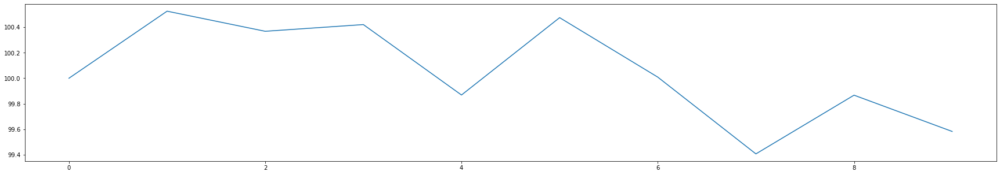

profit: 23.059738421479565
max loss: -5.755577966260731
max profit: 12.410083012988537
transaction count: 27
loss count: 15
profit count: 12
profit percentage: 23.059738421479565
Hodl strategy expected return of STORMUSDT: 81.46367521367522


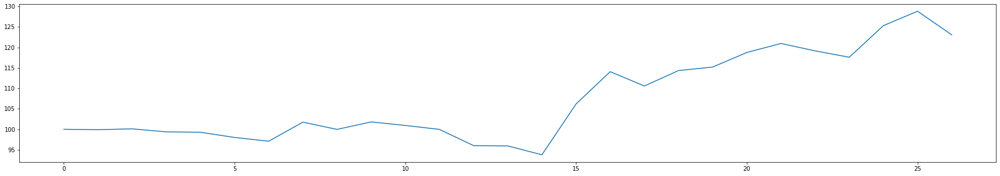

profit: 1.8828888288806382
max loss: -6.227681620681409
max profit: 6.154064393924003
transaction count: 27
loss count: 16
profit count: 11
profit percentage: 1.8828888288806382
Hodl strategy expected return of STRATUSDT: 28.24267782426778


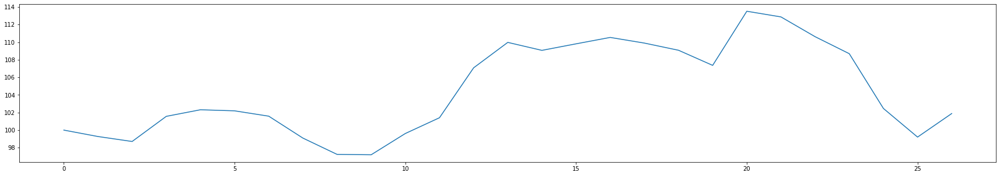

profit: 18.459755411367254
max loss: -1.3505440970309337
max profit: 6.221021746230207
transaction count: 27
loss count: 13
profit count: 14
profit percentage: 18.459755411367254
Hodl strategy expected return of TRXUSDT: 21.927066960075457


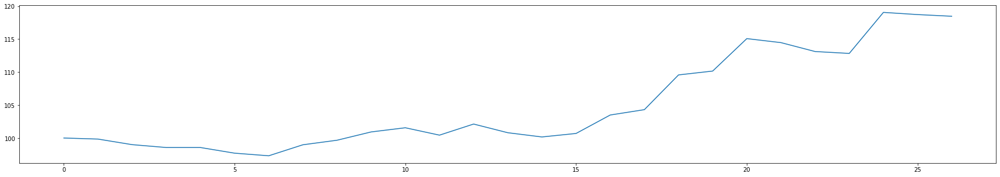

cumulative profit percentage: 46.815225063816726
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 145
cumulative profit count: 122
(profit count / loss count) ratio: 0.8413793103448276


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

#### eliminate via sma + psar + adx & determine via psar only

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
        
        curr_adx = df2["adx"][index]
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close and curr_adx >= 25 else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 4.288689421909623
max loss: -1.7260725937936314
max profit: 3.8415285673319346
transaction count: 17
loss count: 8
profit count: 9
profit percentage: 4.288689421909623
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


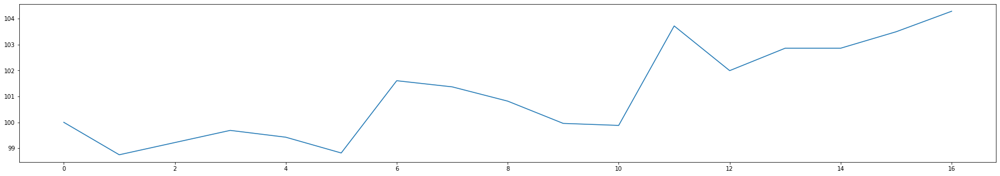

profit: 11.907509909237959
max loss: -2.027428444407107
max profit: 6.027333365209614
transaction count: 22
loss count: 12
profit count: 10
profit percentage: 11.907509909237959
Hodl strategy expected return of APEUSDT: -57.663335972000255


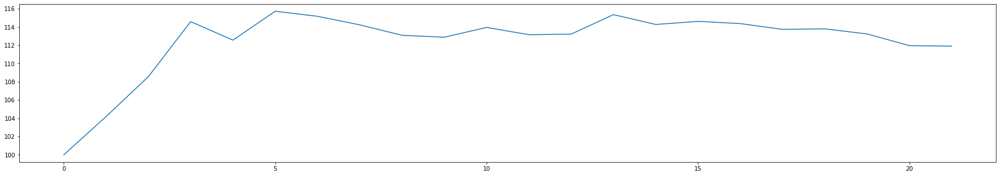

profit: 0.3226909504140423
max loss: -3.7960004619293244
max profit: 6.350194845289238
transaction count: 25
loss count: 14
profit count: 11
profit percentage: 0.3226909504140423
Hodl strategy expected return of BEARUSDT: -32.7710843373494


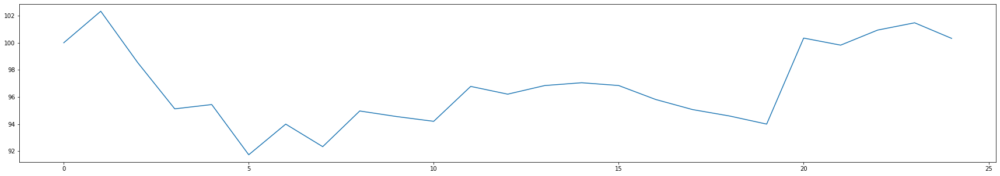

profit: 7.096486930636459
max loss: -5.527182360833194
max profit: 7.901828082974205
transaction count: 39
loss count: 18
profit count: 21
profit percentage: 7.096486930636458
Hodl strategy expected return of BULLUSDT: 5.791070587599496


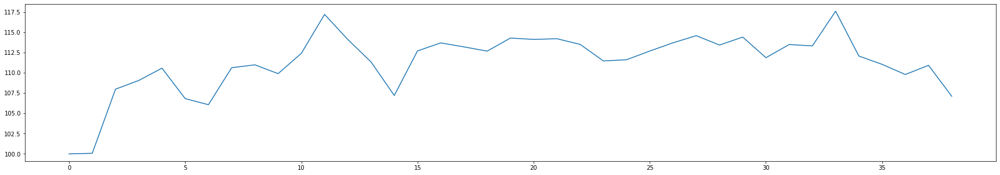

profit: -1.4411374989266648
max loss: -2.257394690958563
max profit: 2.2672995284184765
transaction count: 29
loss count: 20
profit count: 9
profit percentage: -1.4411374989266648
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


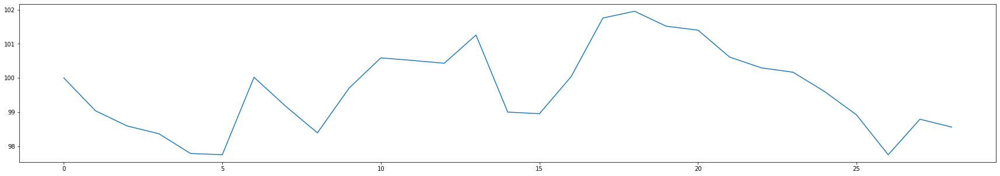

profit: 20.386442428234787
max loss: -5.556297342841603
max profit: 11.28431061210955
transaction count: 18
loss count: 5
profit count: 13
profit percentage: 20.386442428234787
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


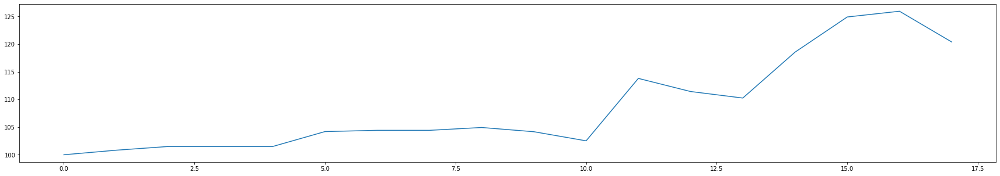

profit: 10.381861312586366
max loss: -0.9958022325825624
max profit: 6.673959904864859
transaction count: 26
loss count: 12
profit count: 14
profit percentage: 10.381861312586366
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


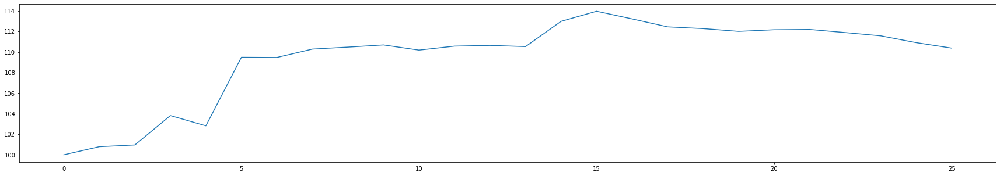

profit: -1.9771794611634448
max loss: -3.3283826390345013
max profit: 5.267871331791724
transaction count: 47
loss count: 23
profit count: 24
profit percentage: -1.9771794611634448
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


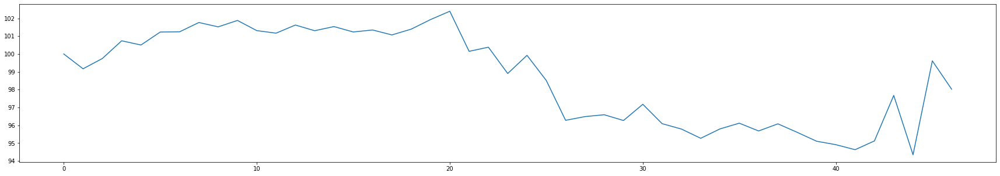

profit: 26.85894009533878
max loss: -4.522405970557969
max profit: 26.69561302310825
transaction count: 29
loss count: 11
profit count: 18
profit percentage: 26.85894009533878
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


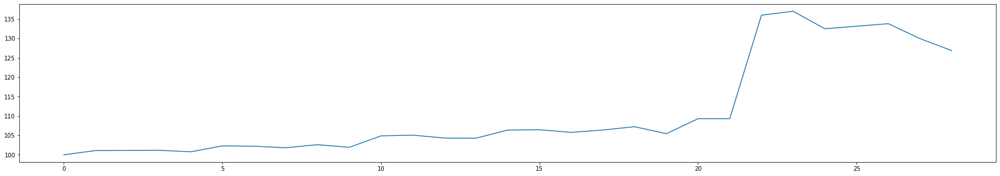

profit: 8.561627910211726
max loss: -2.179135602453073
max profit: 17.421071516681366
transaction count: 10
loss count: 7
profit count: 3
profit percentage: 8.561627910211726
Hodl strategy expected return of MOBUSDT: -45.26532479414456


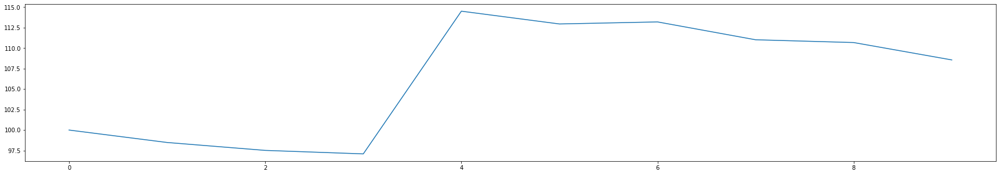

profit: 1.3370511298723073
max loss: -2.1244957533590423
max profit: 2.668207540963678
transaction count: 34
loss count: 19
profit count: 15
profit percentage: 1.3370511298723073
Hodl strategy expected return of NUUSDT: -2.4582809976673325


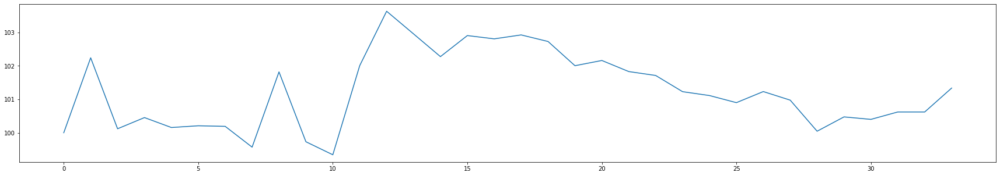

profit: 1.0817690918509726
max loss: -0.8278537352793762
max profit: 2.5489669975851967
transaction count: 13
loss count: 8
profit count: 5
profit percentage: 1.0817690918509726
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


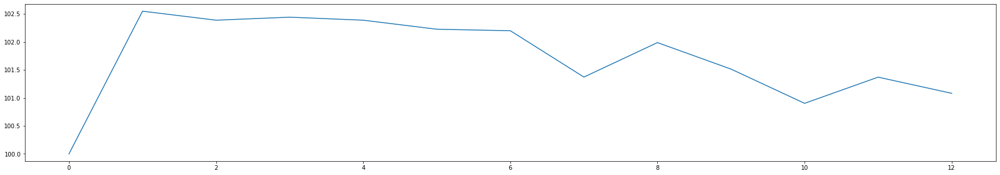

profit: 49.33936956165263
max loss: -6.984692117582853
max profit: 15.060278829944224
transaction count: 34
loss count: 17
profit count: 17
profit percentage: 49.33936956165263
Hodl strategy expected return of STORMUSDT: 81.46367521367522


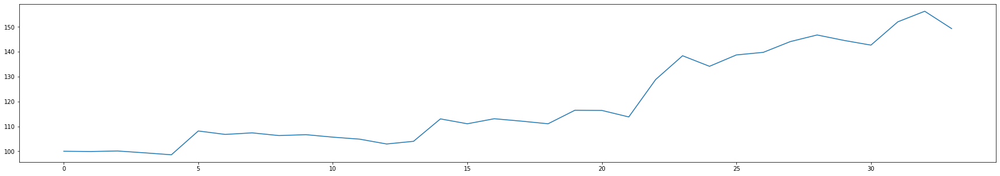

profit: 10.186496021557815
max loss: -3.520161307520951
max profit: 6.280736485434673
transaction count: 36
loss count: 24
profit count: 12
profit percentage: 10.186496021557815
Hodl strategy expected return of STRATUSDT: 28.24267782426778


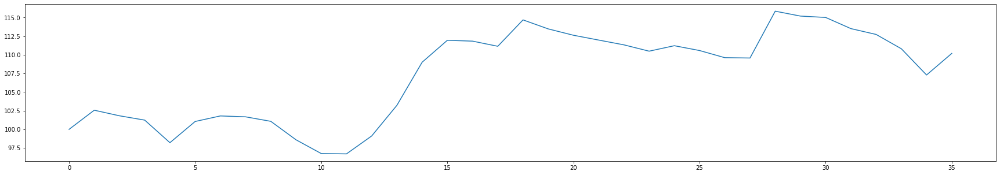

profit: 27.374207374795134
max loss: -1.7510973773374587
max profit: 6.6891722951455534
transaction count: 28
loss count: 13
profit count: 15
profit percentage: 27.374207374795134
Hodl strategy expected return of TRXUSDT: 21.927066960075457


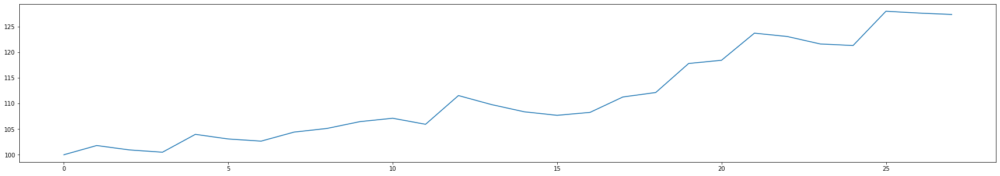

cumulative profit percentage: 175.7048251782085
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 211
cumulative profit count: 196
(profit count / loss count) ratio: 0.9289099526066351


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

## Experiments

### eliminate via sma + psar & determine via psar

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 11.981018345366195
max loss: -1.9413422153075857
max profit: 6.234966391374044
transaction count: 55
loss count: 28
profit count: 27
profit percentage: 11.981018345366195
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


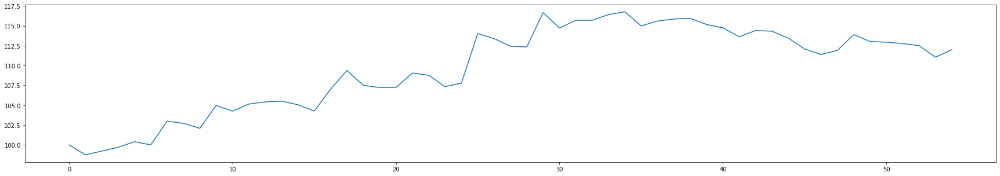

profit: 12.240870316935812
max loss: -2.462796984409181
max profit: 9.770416273405402
transaction count: 27
loss count: 15
profit count: 12
profit percentage: 12.240870316935812
Hodl strategy expected return of APEUSDT: -57.663335972000255


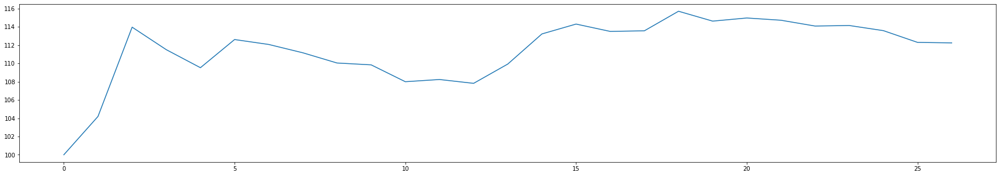

profit: 28.808778399942668
max loss: -4.496888654741184
max profit: 15.812262774011117
transaction count: 48
loss count: 26
profit count: 22
profit percentage: 28.808778399942668
Hodl strategy expected return of BEARUSDT: -32.7710843373494


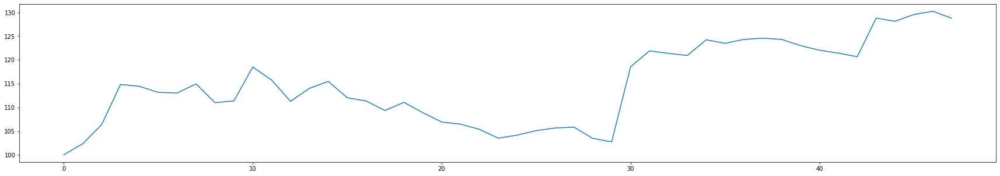

profit: 11.201973376008127
max loss: -5.739063935232508
max profit: 7.869108971852185
transaction count: 59
loss count: 30
profit count: 29
profit percentage: 11.201973376008127
Hodl strategy expected return of BULLUSDT: 5.791070587599496


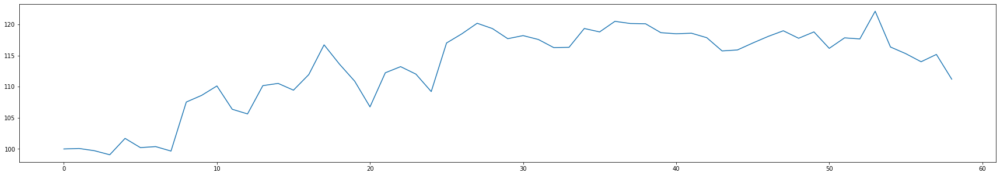

profit: 13.03532645437187
max loss: -2.2675129997481633
max profit: 12.271248106706366
transaction count: 44
loss count: 28
profit count: 16
profit percentage: 13.035326454371871
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


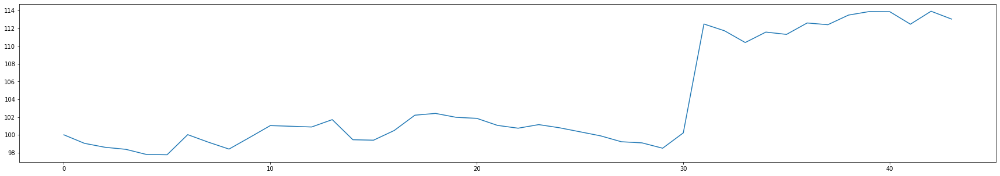

profit: 31.03177378770485
max loss: -6.0476203286632995
max profit: 12.282140793034614
transaction count: 42
loss count: 14
profit count: 28
profit percentage: 31.03177378770485
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


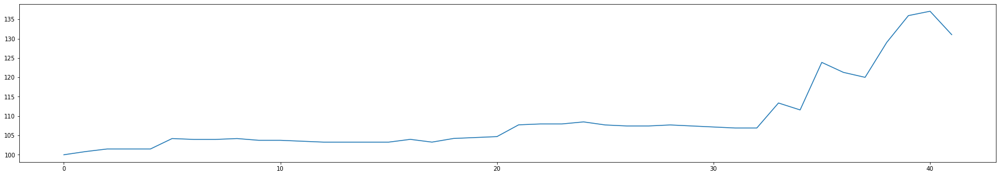

profit: 18.457450593767064
max loss: -2.1104919091439456
max profit: 6.673959904864859
transaction count: 36
loss count: 16
profit count: 20
profit percentage: 18.457450593767064
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


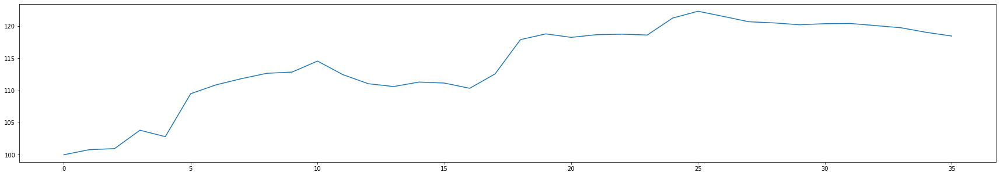

profit: 14.983568882478195
max loss: -3.9042879233518875
max profit: 6.179363568742858
transaction count: 57
loss count: 24
profit count: 33
profit percentage: 14.983568882478195
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


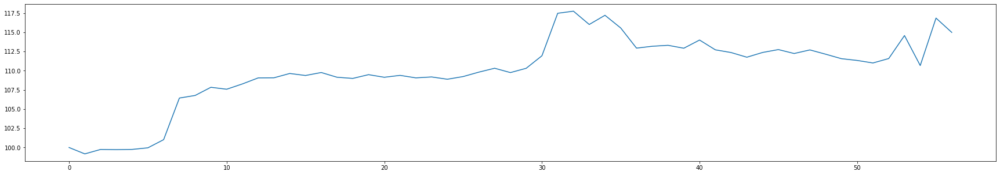

profit: 22.326242781305325
max loss: -4.522405970557969
max profit: 26.69561302310825
transaction count: 52
loss count: 25
profit count: 27
profit percentage: 22.32624278130533
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


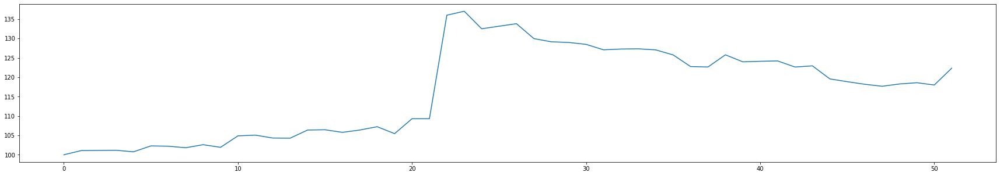

profit: 13.05332524902424
max loss: -2.269296534772039
max profit: 17.995181750173685
transaction count: 29
loss count: 16
profit count: 13
profit percentage: 13.05332524902424
Hodl strategy expected return of MOBUSDT: -45.26532479414456


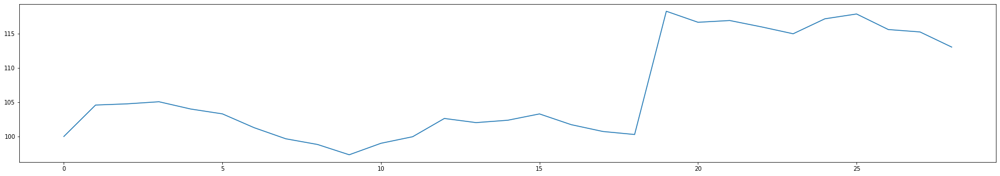

profit: 11.511010692147465
max loss: -2.195131663196989
max profit: 2.801467941278844
transaction count: 65
loss count: 32
profit count: 33
profit percentage: 11.511010692147465
Hodl strategy expected return of NUUSDT: -2.4582809976673325


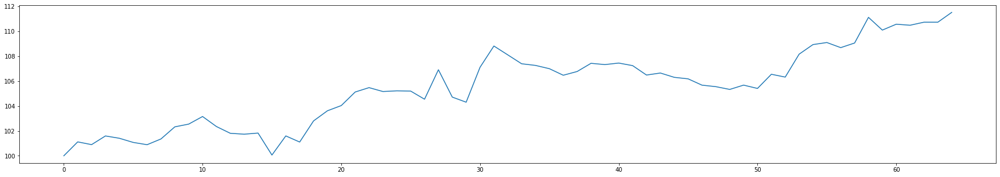

profit: 14.613758917208443
max loss: -0.8831305891539927
max profit: 5.280910296394893
transaction count: 29
loss count: 14
profit count: 15
profit percentage: 14.613758917208443
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


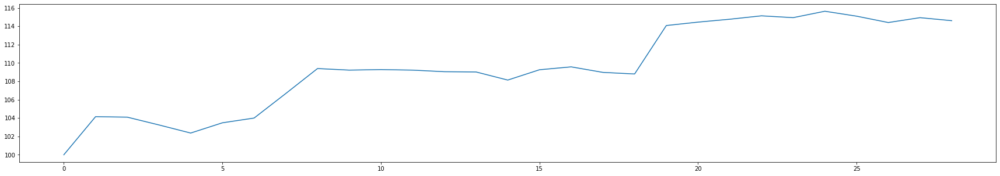

profit: 98.95303258253753
max loss: -9.348007527410914
max profit: 29.642901954380378
transaction count: 51
loss count: 27
profit count: 24
profit percentage: 98.95303258253753
Hodl strategy expected return of STORMUSDT: 81.46367521367522


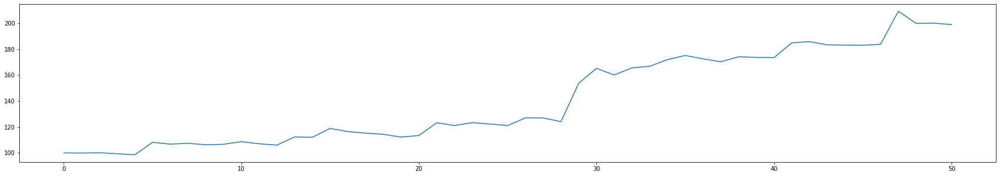

profit: 22.047460116363993
max loss: -3.7555766947101716
max profit: 6.122545756547709
transaction count: 52
loss count: 31
profit count: 21
profit percentage: 22.04746011636399
Hodl strategy expected return of STRATUSDT: 28.24267782426778


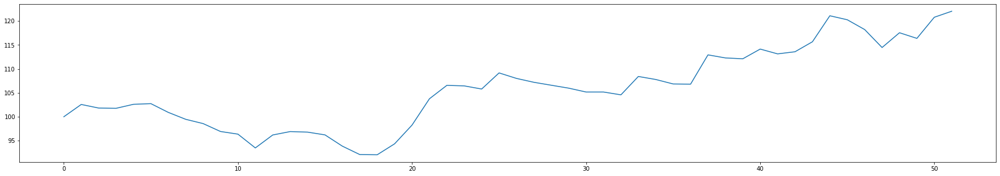

profit: 65.12541676295521
max loss: -2.624063135363116
max profit: 10.847579617315006
transaction count: 54
loss count: 26
profit count: 28
profit percentage: 65.12541676295521
Hodl strategy expected return of TRXUSDT: 21.927066960075457


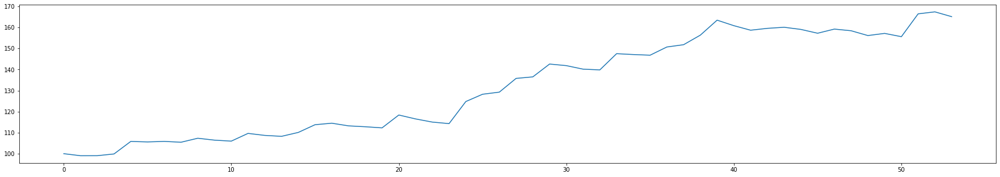

cumulative profit percentage: 389.37100725811695
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 352
cumulative profit count: 348
(profit count / loss count) ratio: 0.9886363636363636


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + macd & determine via psar

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 2.203332309330193
max loss: -2.01615071323414
max profit: 6.11438570910525
transaction count: 58
loss count: 36
profit count: 22
profit percentage: 2.203332309330193
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


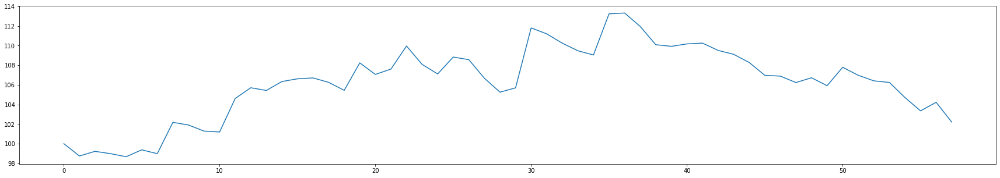

profit: 8.96013373422005
max loss: -2.2310213337208324
max profit: 9.277270187978885
transaction count: 33
loss count: 19
profit count: 14
profit percentage: 8.96013373422005
Hodl strategy expected return of APEUSDT: -57.663335972000255


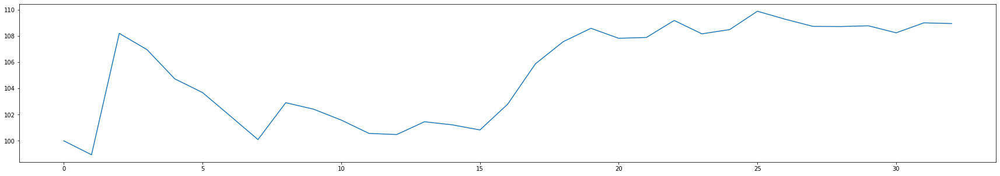

profit: 31.272955053031524
max loss: -4.460716764239905
max profit: 15.38128162784487
transaction count: 51
loss count: 26
profit count: 25
profit percentage: 31.272955053031524
Hodl strategy expected return of BEARUSDT: -32.7710843373494


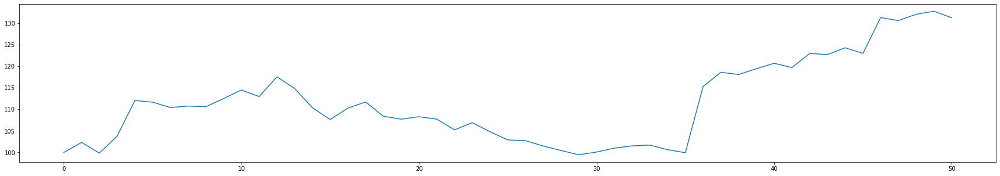

profit: -3.947515776306062
max loss: -6.842637349064759
max profit: 7.281516470817138
transaction count: 59
loss count: 31
profit count: 28
profit percentage: -3.947515776306062
Hodl strategy expected return of BULLUSDT: 5.791070587599496


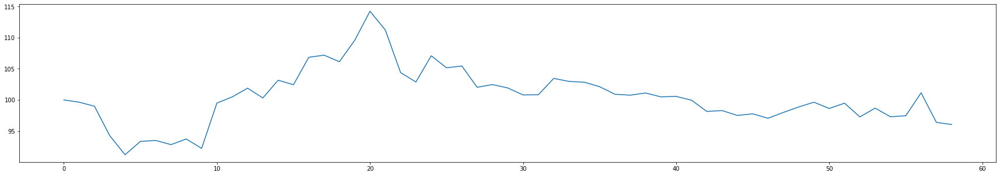

profit: 8.628136319644767
max loss: -2.628623532017997
max profit: 12.422535183590142
transaction count: 47
loss count: 31
profit count: 16
profit percentage: 8.628136319644767
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


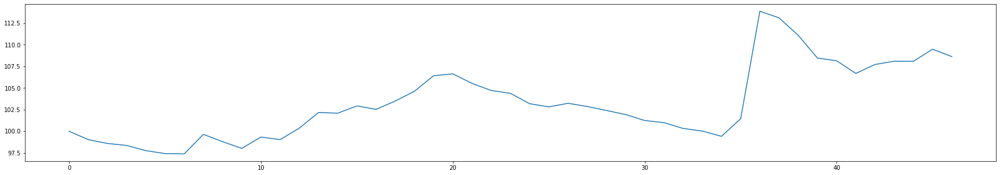

profit: 14.14003320052413
max loss: -5.897554775985682
max profit: 11.844390590451695
transaction count: 55
loss count: 29
profit count: 26
profit percentage: 14.140033200524131
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


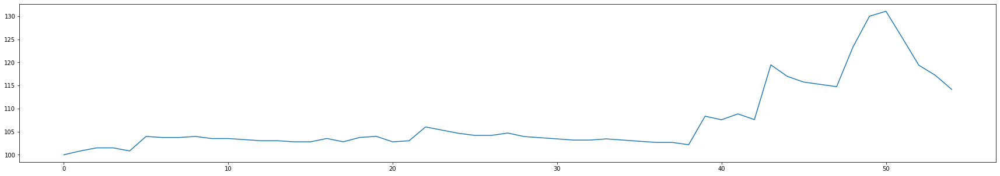

profit: 18.576814048916134
max loss: -2.1102746763818914
max profit: 6.673959904864859
transaction count: 41
loss count: 21
profit count: 20
profit percentage: 18.576814048916134
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


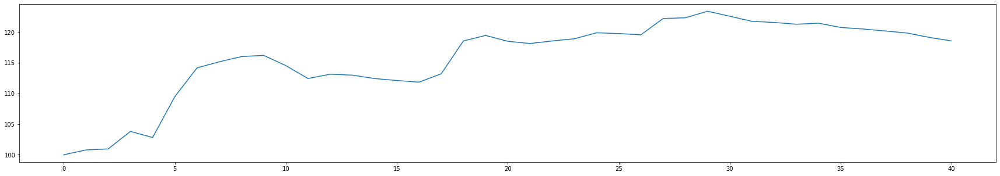

profit: 13.300273611002808
max loss: -3.9609956052013615
max profit: 5.374158484168703
transaction count: 58
loss count: 26
profit count: 32
profit percentage: 13.300273611002808
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


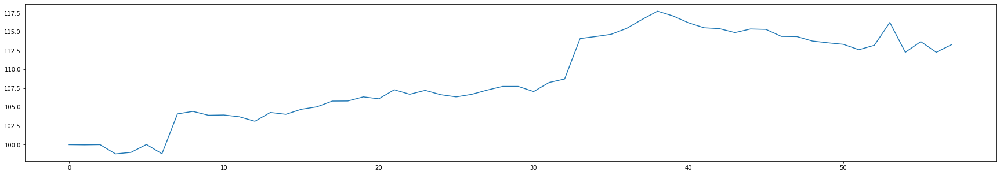

profit: 11.169365209183582
max loss: -4.381903462987225
max profit: 25.866231363145914
transaction count: 57
loss count: 30
profit count: 27
profit percentage: 11.169365209183582
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


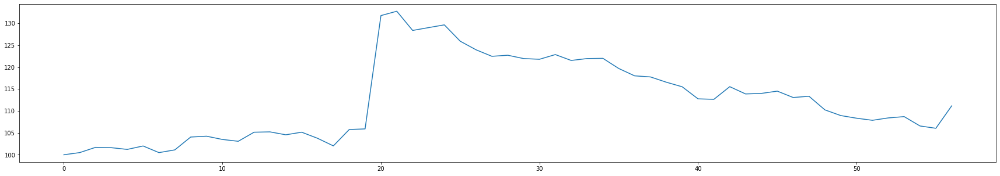

profit: 14.077341198076539
max loss: -2.3420156101096694
max profit: 19.8719140906733
transaction count: 37
loss count: 21
profit count: 16
profit percentage: 14.077341198076537
Hodl strategy expected return of MOBUSDT: -45.26532479414456


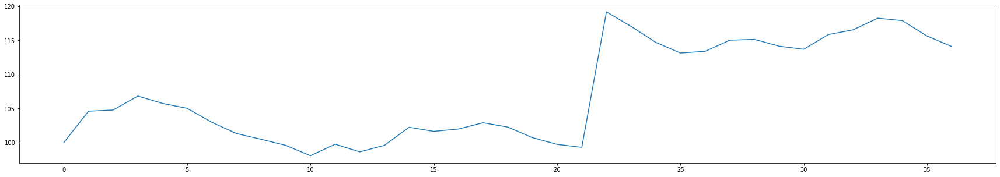

profit: 8.088361058975153
max loss: -2.15904027025519
max profit: 3.2418513406732217
transaction count: 66
loss count: 33
profit count: 33
profit percentage: 8.088361058975153
Hodl strategy expected return of NUUSDT: -2.4582809976673325


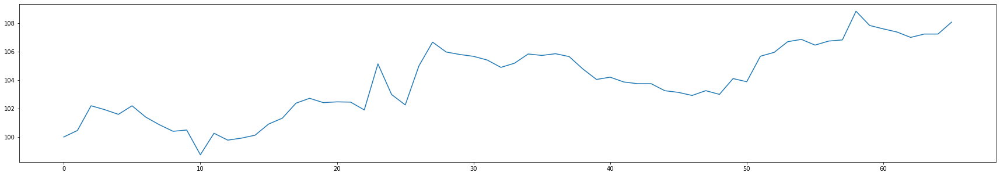

profit: 14.625376413789894
max loss: -0.8901095728945307
max profit: 5.305839030587549
transaction count: 34
loss count: 16
profit count: 18
profit percentage: 14.625376413789896
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


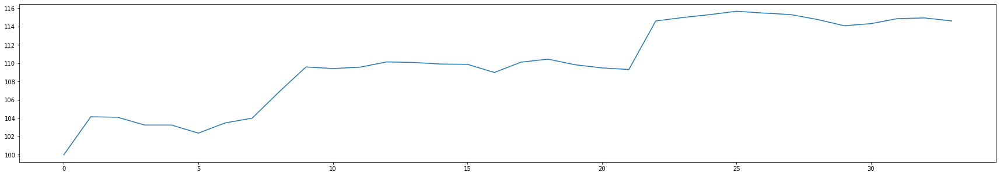

profit: 81.01787299963436
max loss: -8.490394166363188
max profit: 23.11930567969577
transaction count: 59
loss count: 31
profit count: 28
profit percentage: 81.01787299963436
Hodl strategy expected return of STORMUSDT: 81.46367521367522


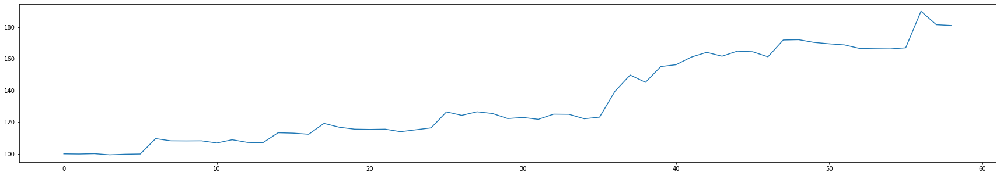

profit: 39.34330379799525
max loss: -4.244835792958668
max profit: 7.21432904939536
transaction count: 59
loss count: 32
profit count: 27
profit percentage: 39.34330379799525
Hodl strategy expected return of STRATUSDT: 28.24267782426778


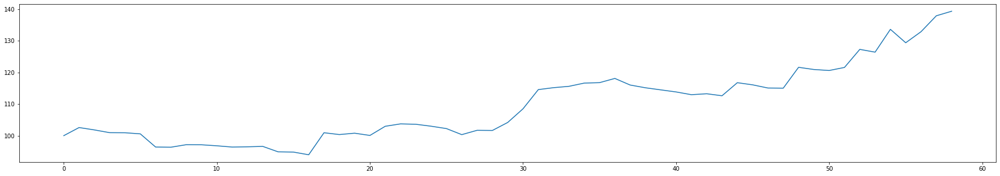

profit: 51.638069557050045
max loss: -3.6342475250710606
max profit: 9.987461293469892
transaction count: 53
loss count: 27
profit count: 26
profit percentage: 51.638069557050045
Hodl strategy expected return of TRXUSDT: 21.927066960075457


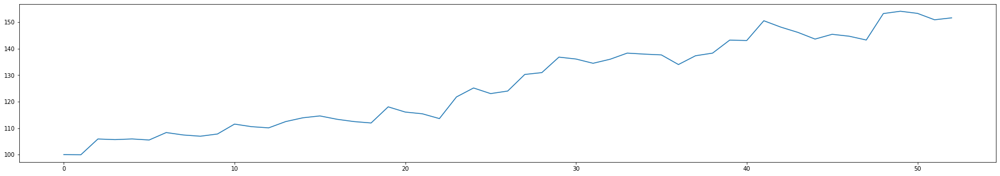

cumulative profit percentage: 313.09385273506837
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 409
cumulative profit count: 358
(profit count / loss count) ratio: 0.8753056234718827


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + psar & determine via psar

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 15.286675627708576
max loss: -2.040411011954788
max profit: 6.5531434817698795
transaction count: 55
loss count: 28
profit count: 27
profit percentage: 15.286675627708576
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


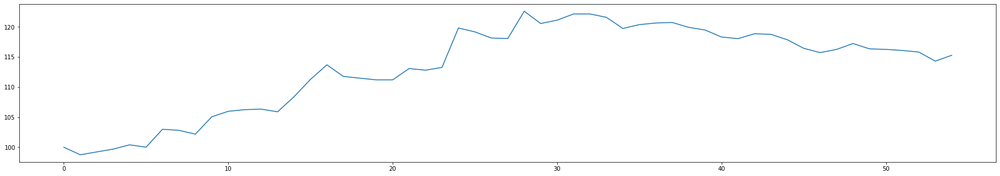

profit: 13.915252361070216
max loss: -2.462796984409181
max profit: 9.770416273405402
transaction count: 34
loss count: 18
profit count: 16
profit percentage: 13.915252361070216
Hodl strategy expected return of APEUSDT: -57.663335972000255


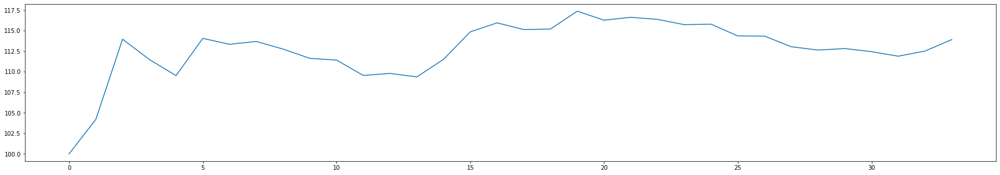

profit: 26.778743721476985
max loss: -4.46206640918723
max profit: 15.563060490013157
transaction count: 53
loss count: 29
profit count: 24
profit percentage: 26.778743721476985
Hodl strategy expected return of BEARUSDT: -32.7710843373494


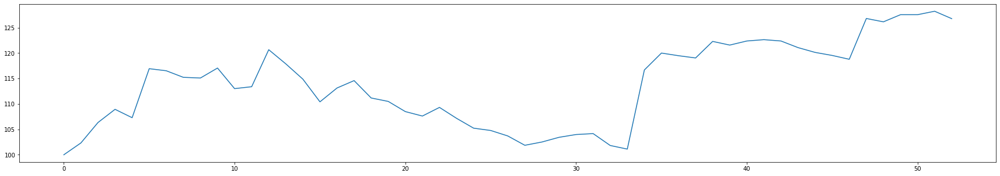

profit: 10.76060535748671
max loss: -5.7162852092768475
max profit: 7.904994787124608
transaction count: 67
loss count: 35
profit count: 32
profit percentage: 10.76060535748671
Hodl strategy expected return of BULLUSDT: 5.791070587599496


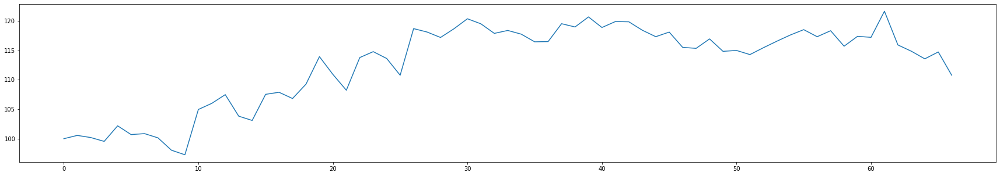

profit: 17.205193066936644
max loss: -2.2633969438184494
max profit: 12.384767531898007
transaction count: 44
loss count: 25
profit count: 19
profit percentage: 17.205193066936644
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


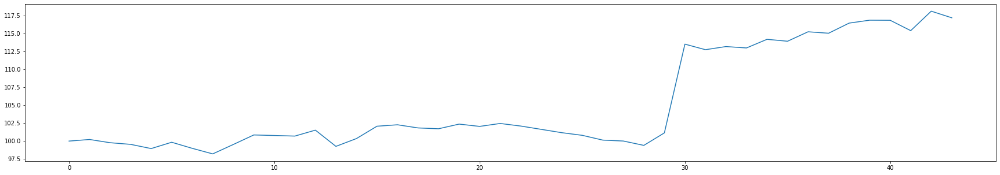

profit: 28.23186863958537
max loss: -5.9183939372116185
max profit: 12.019694302063172
transaction count: 47
loss count: 17
profit count: 30
profit percentage: 28.23186863958537
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


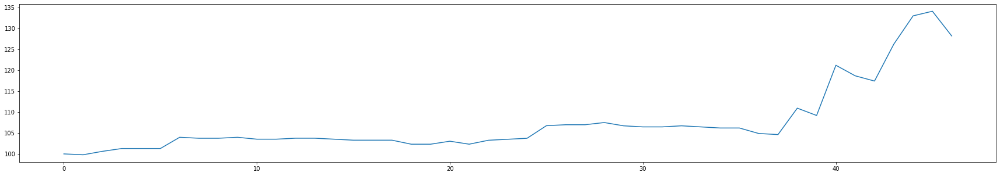

profit: 17.204163522410965
max loss: -2.10369746768383
max profit: 6.6524739992879205
transaction count: 39
loss count: 18
profit count: 21
profit percentage: 17.204163522410965
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


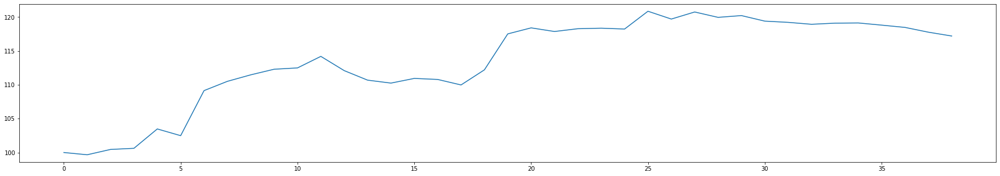

profit: 16.934664916982484
max loss: -3.9705377428595767
max profit: 6.284217956825529
transaction count: 62
loss count: 26
profit count: 36
profit percentage: 16.934664916982484
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


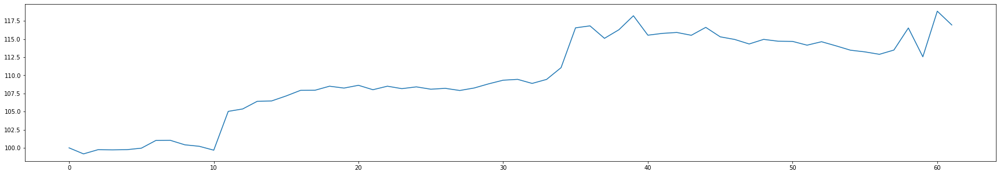

profit: 21.26881536248115
max loss: -4.482932480634446
max profit: 26.462602316300732
transaction count: 55
loss count: 28
profit count: 27
profit percentage: 21.26881536248115
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


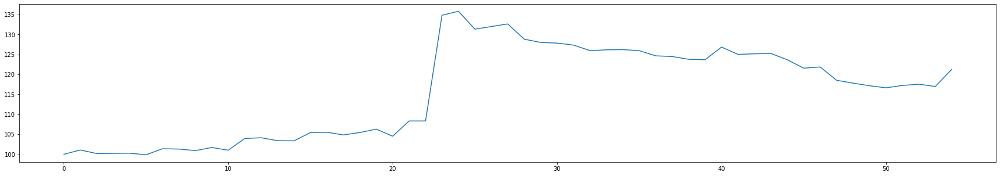

profit: 14.747495293674675
max loss: -2.3033032674636473
max profit: 18.264850048757836
transaction count: 34
loss count: 18
profit count: 16
profit percentage: 14.747495293674675
Hodl strategy expected return of MOBUSDT: -45.26532479414456


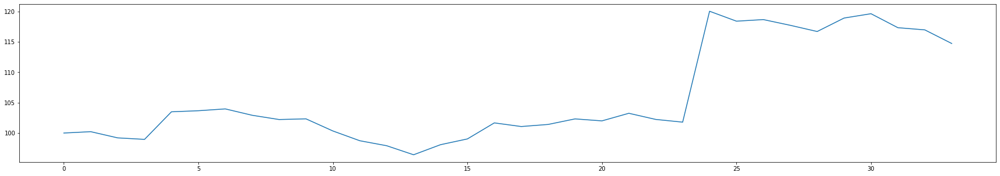

profit: 14.326300356458518
max loss: -2.184833926142261
max profit: 2.78832577732112
transaction count: 65
loss count: 29
profit count: 36
profit percentage: 14.32630035645852
Hodl strategy expected return of NUUSDT: -2.4582809976673325


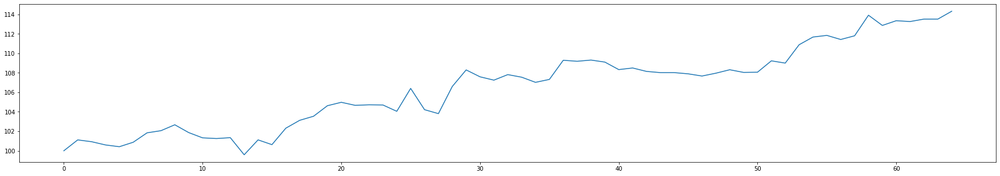

profit: 14.758876039993012
max loss: -0.8966426122214415
max profit: 5.291354427607018
transaction count: 37
loss count: 19
profit count: 18
profit percentage: 14.758876039993012
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


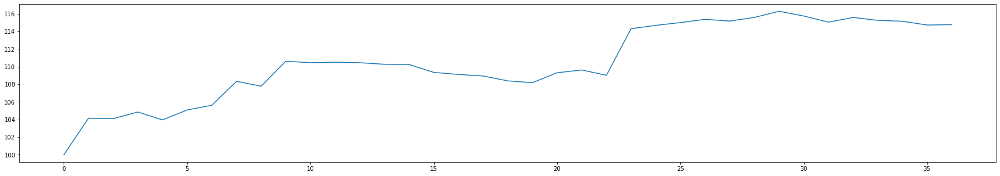

profit: 94.8756989468036
max loss: -9.156429922265346
max profit: 29.134608102531473
transaction count: 50
loss count: 26
profit count: 24
profit percentage: 94.87569894680361
Hodl strategy expected return of STORMUSDT: 81.46367521367522


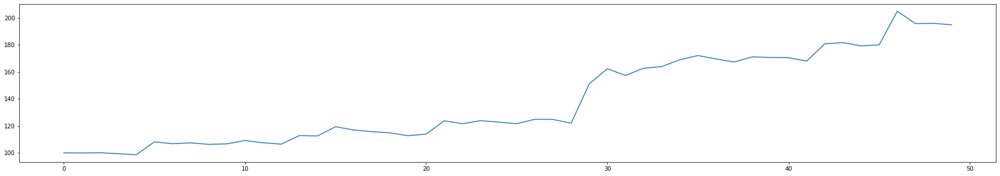

profit: 29.171562225473906
max loss: -4.025889391256371
max profit: 6.563224242893369
transaction count: 53
loss count: 30
profit count: 23
profit percentage: 29.17156222547391
Hodl strategy expected return of STRATUSDT: 28.24267782426778


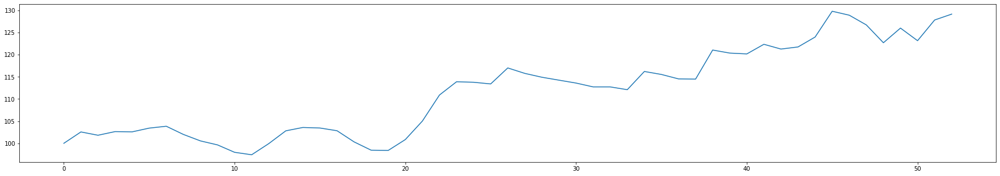

profit: 74.61589418838963
max loss: -2.7300943600656353
max profit: 11.471037298736121
transaction count: 55
loss count: 24
profit count: 31
profit percentage: 74.61589418838963
Hodl strategy expected return of TRXUSDT: 21.927066960075457


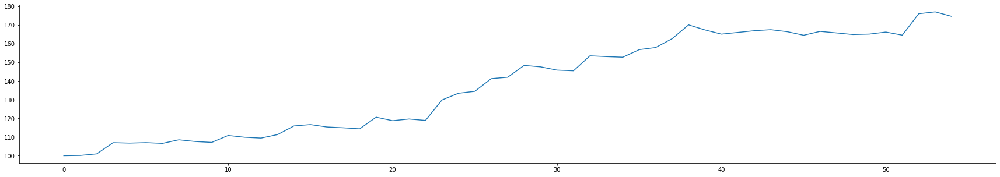

cumulative profit percentage: 410.0818096269324
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 370
cumulative profit count: 380
(profit count / loss count) ratio: 1.027027027027027


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + macd & determine via psar

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 4.416694589112652
max loss: -2.059813398571265
max profit: 6.279918320928132
transaction count: 55
loss count: 31
profit count: 24
profit percentage: 4.416694589112652
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


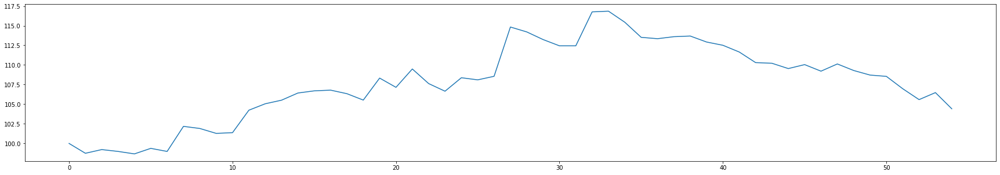

profit: 8.414136405648904
max loss: -2.2310213337208324
max profit: 9.277270187978885
transaction count: 41
loss count: 23
profit count: 18
profit percentage: 8.414136405648904
Hodl strategy expected return of APEUSDT: -57.663335972000255


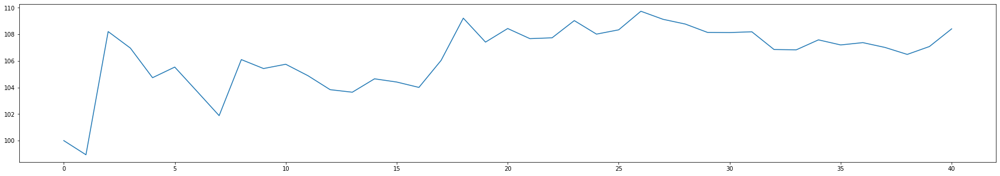

profit: 27.780220020110477
max loss: -4.460716764239905
max profit: 15.005381518368509
transaction count: 51
loss count: 27
profit count: 24
profit percentage: 27.780220020110477
Hodl strategy expected return of BEARUSDT: -32.7710843373494


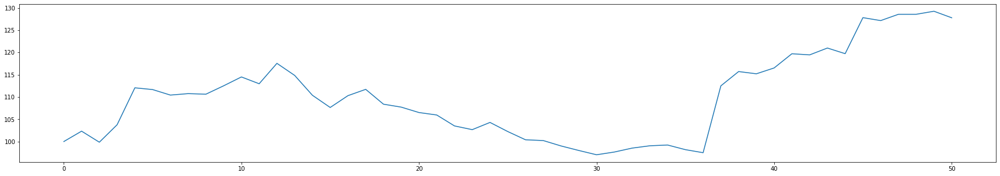

profit: 5.178277359806657
max loss: -7.065868464242627
max profit: 7.5889079462758815
transaction count: 56
loss count: 28
profit count: 28
profit percentage: 5.178277359806657
Hodl strategy expected return of BULLUSDT: 5.791070587599496


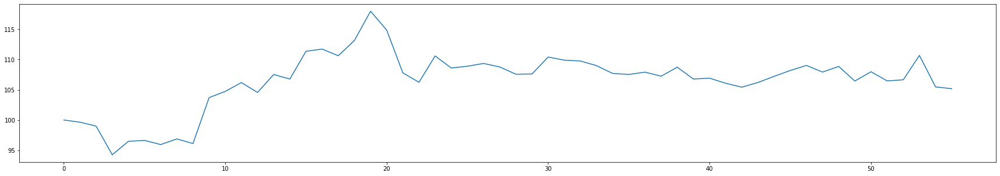

profit: 7.238041715637735
max loss: -2.2625688109532405
max profit: 11.939351249041223
transaction count: 42
loss count: 27
profit count: 15
profit percentage: 7.238041715637735
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


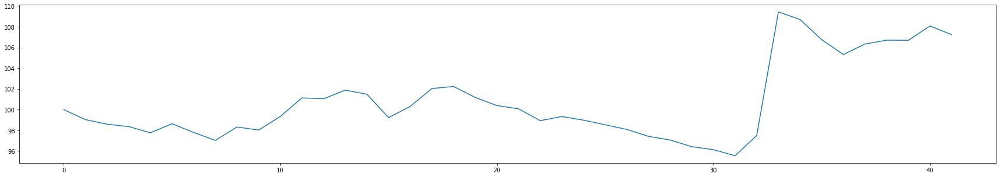

profit: 11.933858711335972
max loss: -5.783562914142507
max profit: 11.615454330071188
transaction count: 58
loss count: 32
profit count: 26
profit percentage: 11.933858711335972
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


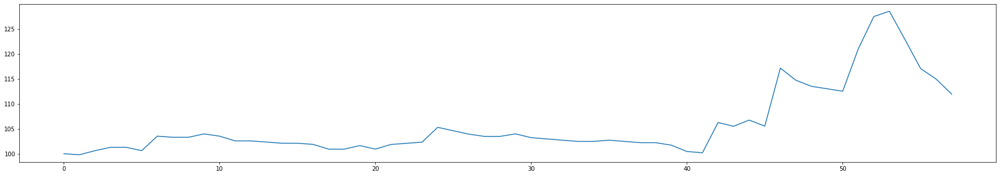

profit: 16.052636741199862
max loss: -2.073245215981771
max profit: 6.6524739992879205
transaction count: 42
loss count: 21
profit count: 21
profit percentage: 16.052636741199862
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


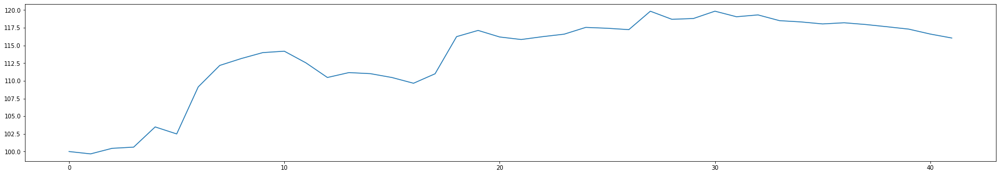

profit: 12.456844237902104
max loss: -3.9315091800262536
max profit: 5.446912550256485
transaction count: 54
loss count: 25
profit count: 29
profit percentage: 12.456844237902104
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


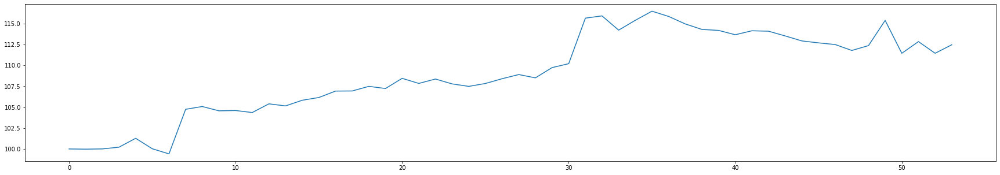

profit: 15.873752029027756
max loss: -4.37433831217831
max profit: 25.82157452787483
transaction count: 55
loss count: 29
profit count: 26
profit percentage: 15.873752029027756
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


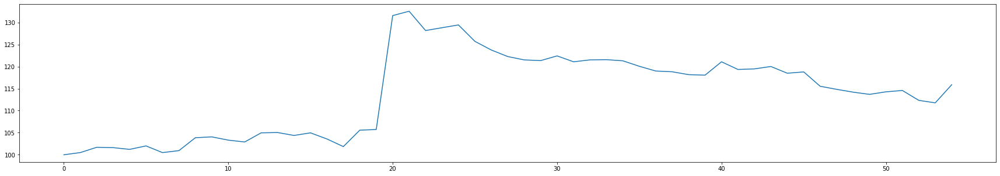

profit: 16.098624646151535
max loss: -2.417736715092147
max profit: 20.51440480959384
transaction count: 41
loss count: 23
profit count: 18
profit percentage: 16.098624646151535
Hodl strategy expected return of MOBUSDT: -45.26532479414456


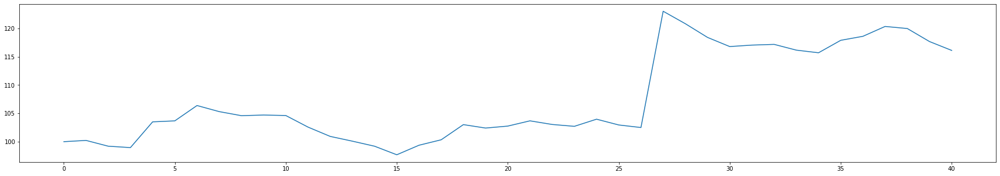

profit: 10.493380751510543
max loss: -2.15904027025519
max profit: 3.2418513406732217
transaction count: 67
loss count: 31
profit count: 36
profit percentage: 10.493380751510543
Hodl strategy expected return of NUUSDT: -2.4582809976673325


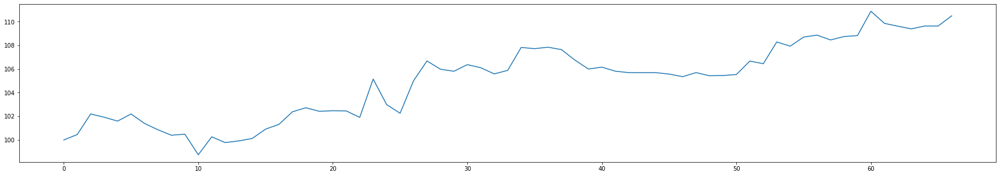

profit: 15.697032860123585
max loss: -0.9000396655375908
max profit: 5.373592371038669
transaction count: 36
loss count: 16
profit count: 20
profit percentage: 15.697032860123587
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


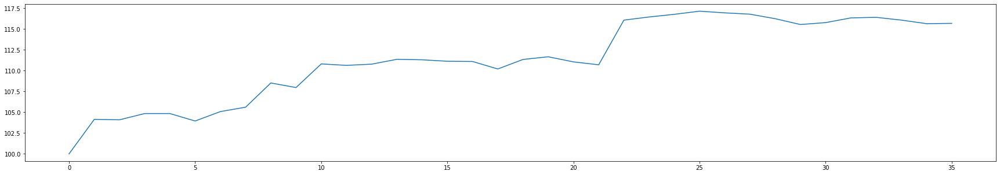

profit: 74.98555549294079
max loss: -8.147209899928356
max profit: 22.18481644342424
transaction count: 56
loss count: 28
profit count: 28
profit percentage: 74.98555549294079
Hodl strategy expected return of STORMUSDT: 81.46367521367522


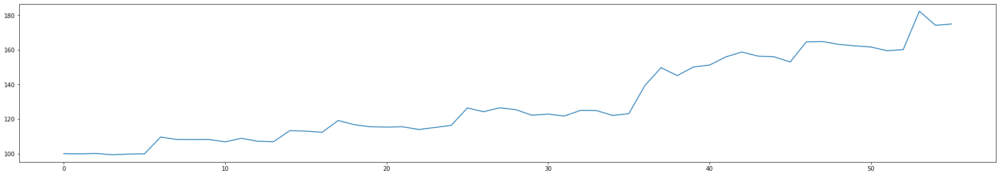

profit: 42.69001940848878
max loss: -4.346787288474161
max profit: 7.387601154984651
transaction count: 51
loss count: 26
profit count: 25
profit percentage: 42.69001940848878
Hodl strategy expected return of STRATUSDT: 28.24267782426778


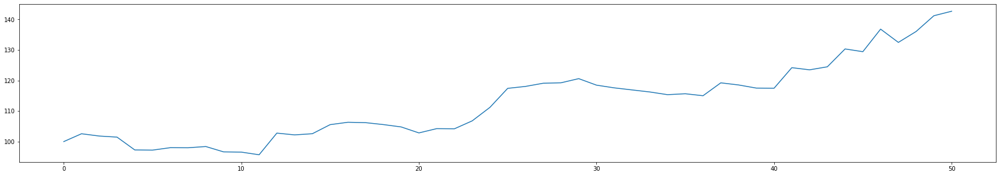

profit: 53.89882836665896
max loss: -3.69699851169068
max profit: 10.136363486506212
transaction count: 52
loss count: 26
profit count: 26
profit percentage: 53.89882836665896
Hodl strategy expected return of TRXUSDT: 21.927066960075457


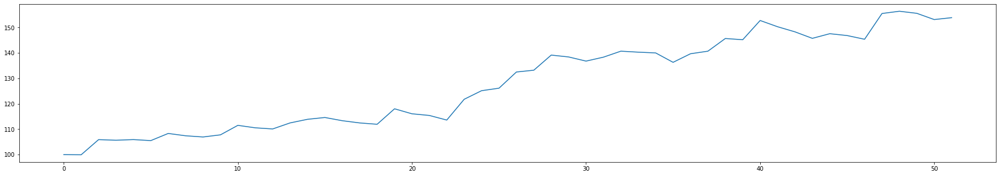

cumulative profit percentage: 323.20790333565634
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 393
cumulative profit count: 364
(profit count / loss count) ratio: 0.926208651399491


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + psar & determine via psar

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 9.427689049149365
max loss: -2.63737615698318
max profit: 6.4809821715770255
transaction count: 52
loss count: 28
profit count: 24
profit percentage: 9.427689049149365
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


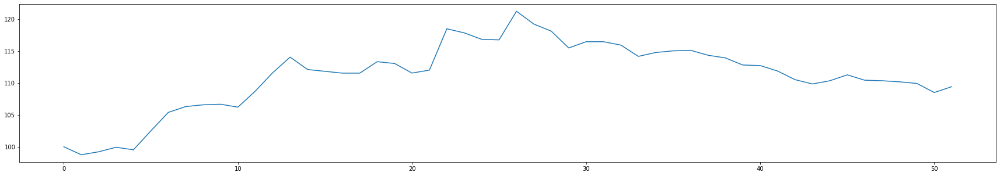

profit: 16.089268355398843
max loss: -2.462796984409181
max profit: 9.770416273405402
transaction count: 21
loss count: 10
profit count: 11
profit percentage: 16.089268355398843
Hodl strategy expected return of APEUSDT: -57.663335972000255


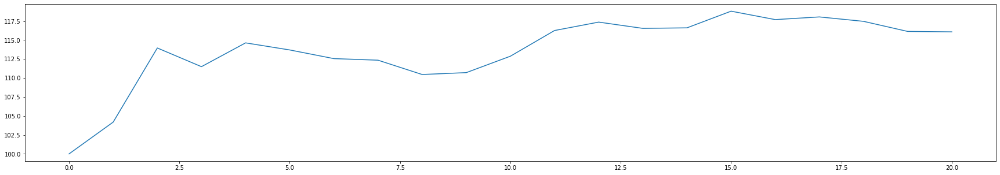

profit: 31.090329161102062
max loss: -4.606637501759266
max profit: 16.198169061987613
transaction count: 49
loss count: 26
profit count: 23
profit percentage: 31.090329161102062
Hodl strategy expected return of BEARUSDT: -32.7710843373494


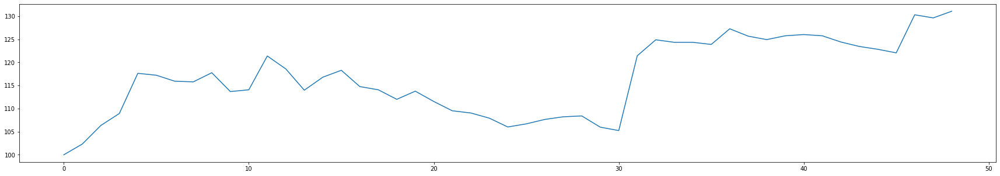

profit: 9.675298998073842
max loss: -5.578979288777418
max profit: 7.74315359744557
transaction count: 57
loss count: 29
profit count: 28
profit percentage: 9.675298998073842
Hodl strategy expected return of BULLUSDT: 5.791070587599496


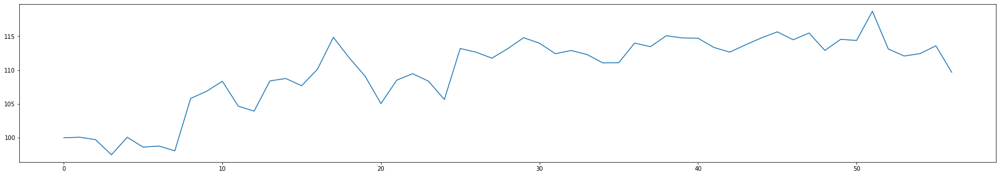

profit: 17.767161321294367
max loss: -2.26186939911193
max profit: 12.444149253888355
transaction count: 40
loss count: 22
profit count: 18
profit percentage: 17.767161321294367
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


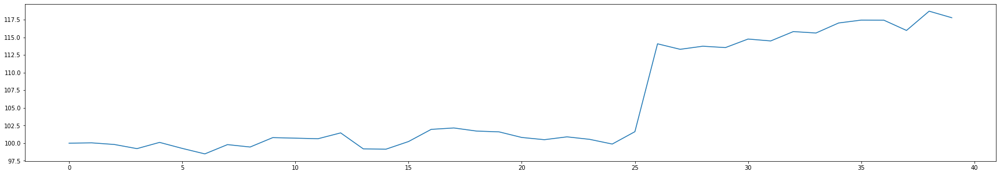

profit: 29.57921576543444
max loss: -5.980579189173881
max profit: 12.14598662505027
transaction count: 38
loss count: 11
profit count: 27
profit percentage: 29.57921576543444
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


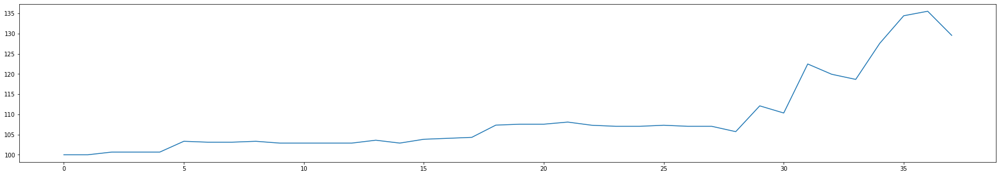

profit: 19.521511071059464
max loss: -2.1235376387238603
max profit: 6.715214114733584
transaction count: 32
loss count: 13
profit count: 19
profit percentage: 19.521511071059464
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


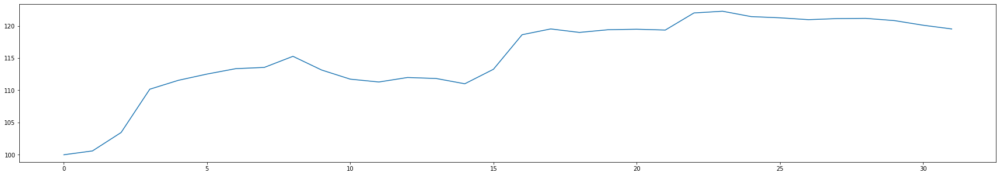

profit: 18.31975086284629
max loss: -4.0175685872123665
max profit: 6.358654241214964
transaction count: 57
loss count: 23
profit count: 34
profit percentage: 18.31975086284629
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


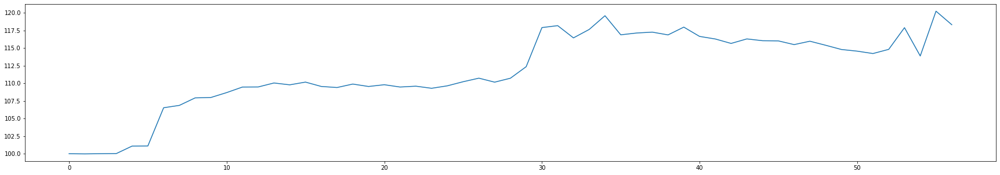

profit: 24.161417142529444
max loss: -4.482932480634446
max profit: 26.462602316300732
transaction count: 52
loss count: 25
profit count: 27
profit percentage: 24.161417142529444
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


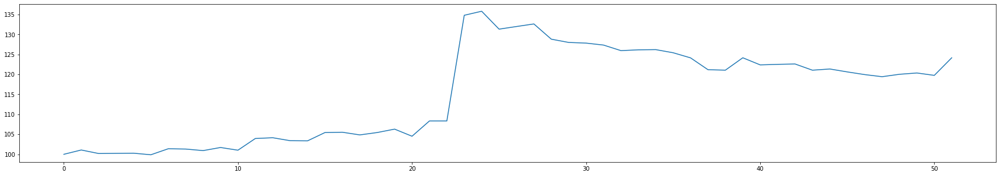

profit: 11.358593046883314
max loss: -2.2601063252182882
max profit: 17.922304764417106
transaction count: 29
loss count: 17
profit count: 12
profit percentage: 11.358593046883314
Hodl strategy expected return of MOBUSDT: -45.26532479414456


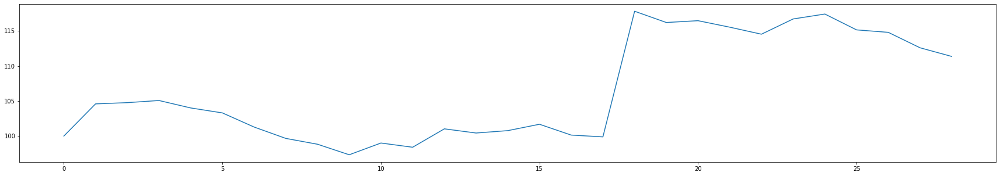

profit: 8.622890100371222
max loss: -2.208468977789451
max profit: 2.7768748824446874
transaction count: 68
loss count: 32
profit count: 36
profit percentage: 8.622890100371222
Hodl strategy expected return of NUUSDT: -2.4582809976673325


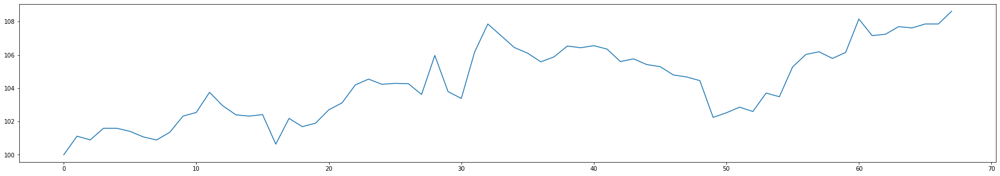

profit: 15.548766307228362
max loss: -0.8862166404129681
max profit: 5.299364146900018
transaction count: 26
loss count: 12
profit count: 14
profit percentage: 15.54876630722836
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


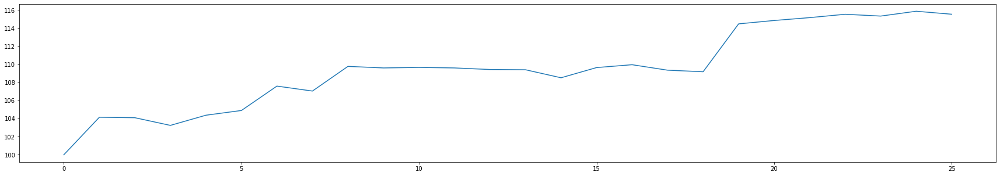

profit: 97.65855028311756
max loss: -9.287184979887996
max profit: 30.215991619621988
transaction count: 52
loss count: 26
profit count: 26
profit percentage: 97.65855028311756
Hodl strategy expected return of STORMUSDT: 81.46367521367522


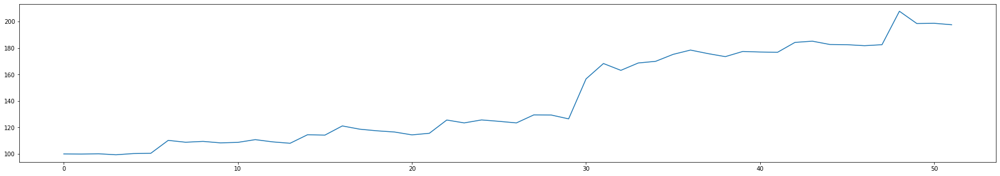

profit: 30.738081909767175
max loss: -3.9826936384246068
max profit: 6.4928041730347275
transaction count: 51
loss count: 29
profit count: 22
profit percentage: 30.738081909767175
Hodl strategy expected return of STRATUSDT: 28.24267782426778


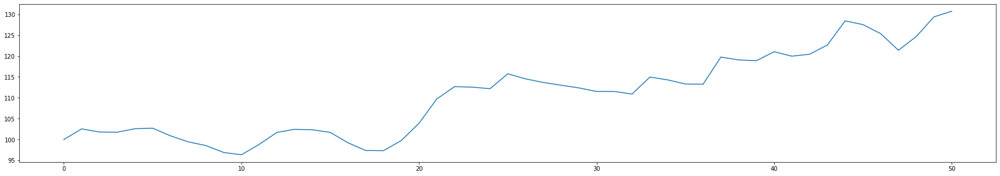

profit: 62.64274233940594
max loss: -2.581578855921151
max profit: 10.711654473560259
transaction count: 54
loss count: 26
profit count: 28
profit percentage: 62.64274233940594
Hodl strategy expected return of TRXUSDT: 21.927066960075457


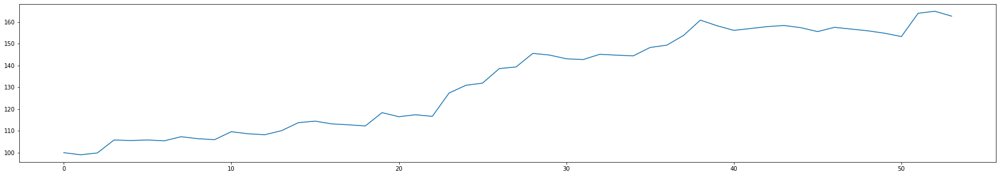

cumulative profit percentage: 402.20126571366166
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 329
cumulative profit count: 349
(profit count / loss count) ratio: 1.060790273556231


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + macd & determine via psar

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_sar = df1["psar"][index]
    
    return True if curr_sar < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 2.992949245860615
max loss: -2.0317273751080194
max profit: 6.2186771778077485
transaction count: 51
loss count: 30
profit count: 21
profit percentage: 2.992949245860615
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


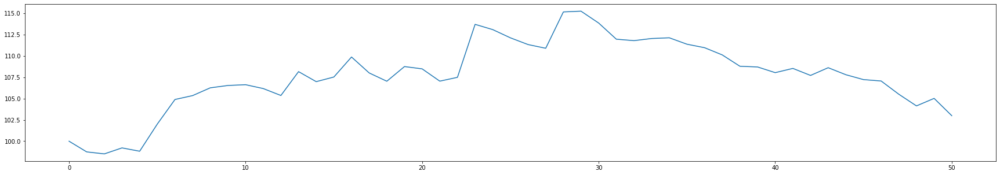

profit: 9.452072353128273
max loss: -2.2310213337208324
max profit: 9.277270187978885
transaction count: 25
loss count: 14
profit count: 11
profit percentage: 9.452072353128273
Hodl strategy expected return of APEUSDT: -57.663335972000255


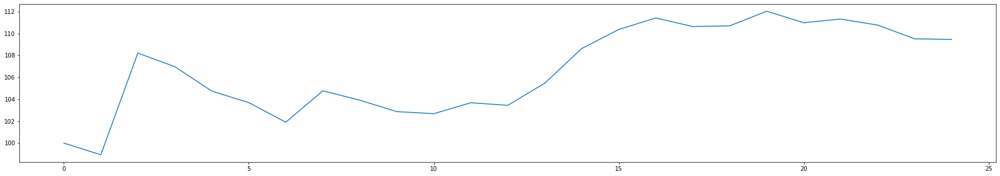

profit: 26.171906183748376
max loss: -4.225379189148114
max profit: 14.693701494730192
transaction count: 48
loss count: 26
profit count: 22
profit percentage: 26.17190618374838
Hodl strategy expected return of BEARUSDT: -32.7710843373494


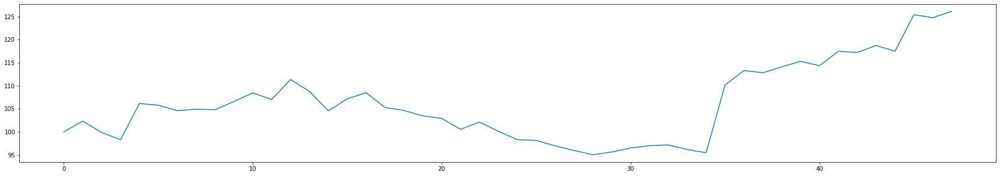

profit: 4.334322558795321
max loss: -6.959385242476685
max profit: 7.405752443797425
transaction count: 48
loss count: 24
profit count: 24
profit percentage: 4.334322558795321
Hodl strategy expected return of BULLUSDT: 5.791070587599496


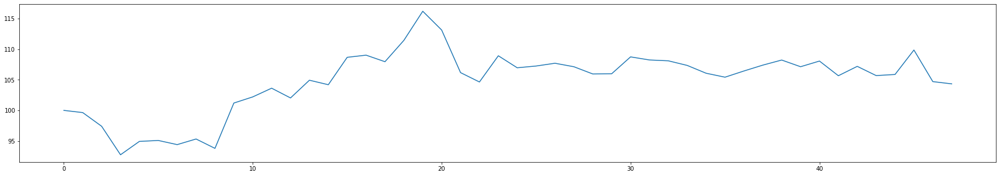

profit: 12.825242101584564
max loss: -2.730186638949249
max profit: 12.902509304585607
transaction count: 38
loss count: 21
profit count: 17
profit percentage: 12.825242101584562
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


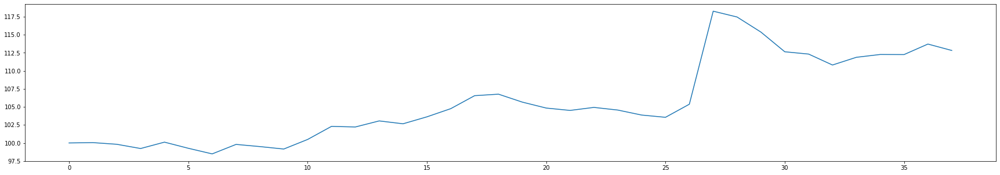

profit: 18.16938803792317
max loss: -6.105749396217618
max profit: 11.995943031158944
transaction count: 49
loss count: 22
profit count: 27
profit percentage: 18.16938803792317
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


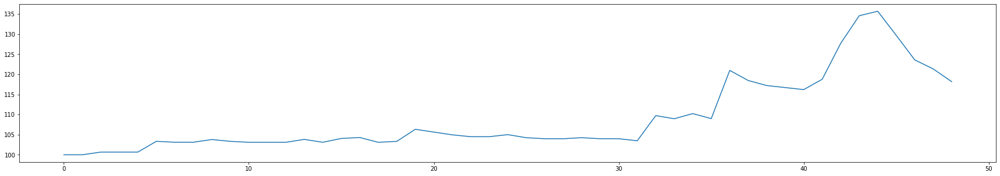

profit: 18.513500319426186
max loss: -2.092798188937664
max profit: 6.715214114733584
transaction count: 34
loss count: 15
profit count: 19
profit percentage: 18.513500319426186
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


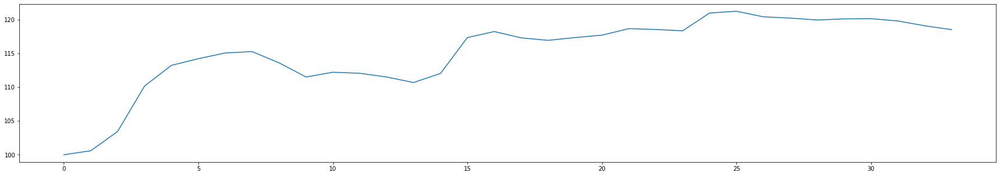

profit: 14.880024041363598
max loss: -4.016223931775912
max profit: 5.4309703761853
transaction count: 56
loss count: 24
profit count: 32
profit percentage: 14.880024041363598
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


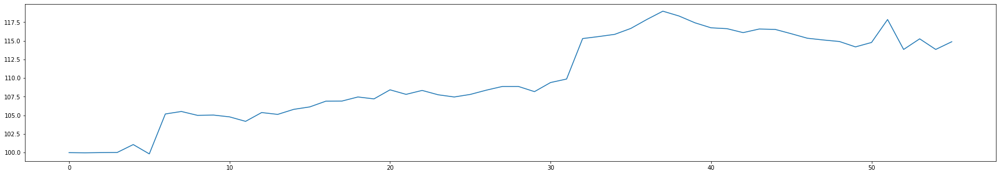

profit: 15.285260682440466
max loss: -4.381903462987225
max profit: 25.866231363145914
transaction count: 56
loss count: 29
profit count: 27
profit percentage: 15.285260682440466
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


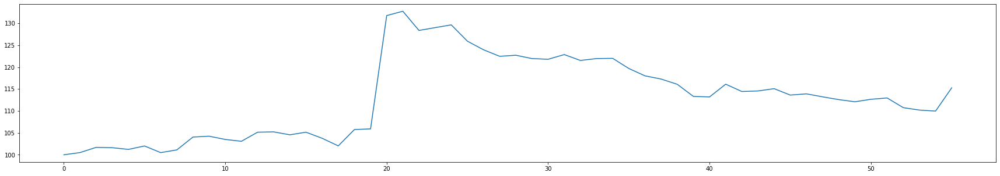

profit: 12.029039148309096
max loss: -2.34760567337878
max profit: 19.919345566606054
transaction count: 36
loss count: 22
profit count: 14
profit percentage: 12.029039148309096
Hodl strategy expected return of MOBUSDT: -45.26532479414456


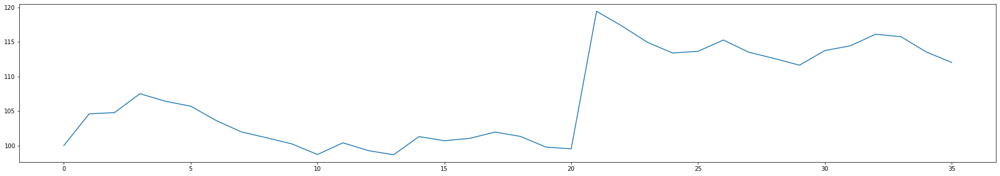

profit: 6.1938246634341425
max loss: -2.1841291219810017
max profit: 3.2418513406732217
transaction count: 65
loss count: 32
profit count: 33
profit percentage: 6.193824663434143
Hodl strategy expected return of NUUSDT: -2.4582809976673325


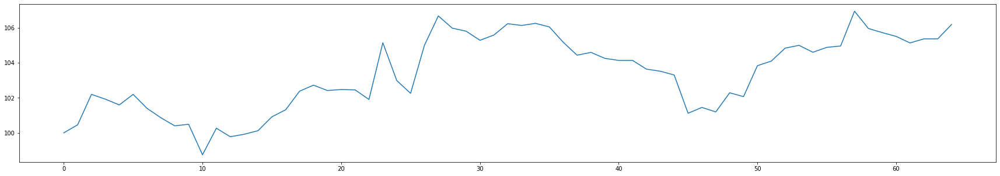

profit: 16.488854173963006
max loss: -0.8932200118282481
max profit: 5.3243799931828875
transaction count: 30
loss count: 13
profit count: 17
profit percentage: 16.488854173963006
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


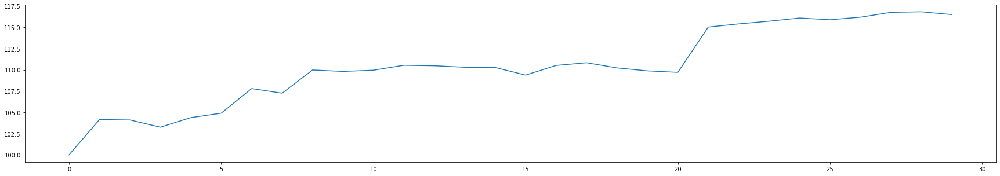

profit: 74.82008210526703
max loss: -8.199695315570807
max profit: 22.327733997566867
transaction count: 60
loss count: 33
profit count: 27
profit percentage: 74.82008210526703
Hodl strategy expected return of STORMUSDT: 81.46367521367522


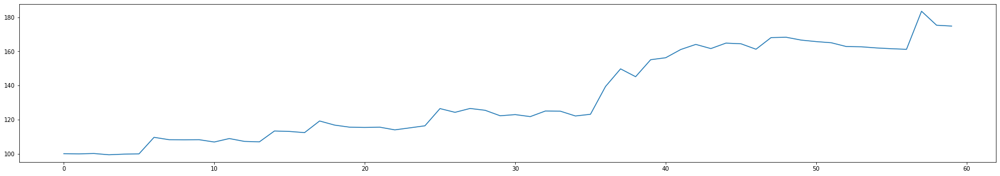

profit: 41.51387418596087
max loss: -4.310958201591461
max profit: 7.326707675255676
transaction count: 54
loss count: 28
profit count: 26
profit percentage: 41.51387418596087
Hodl strategy expected return of STRATUSDT: 28.24267782426778


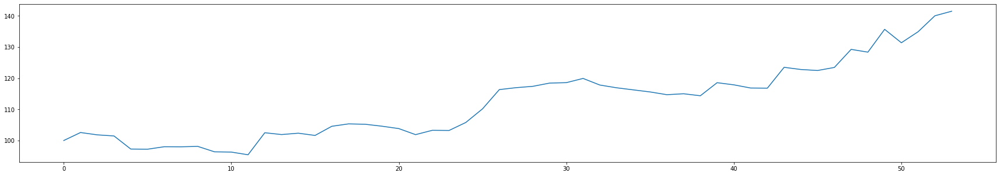

profit: 51.638069557050045
max loss: -3.6342475250710606
max profit: 9.987461293469892
transaction count: 53
loss count: 27
profit count: 26
profit percentage: 51.638069557050045
Hodl strategy expected return of TRXUSDT: 21.927066960075457


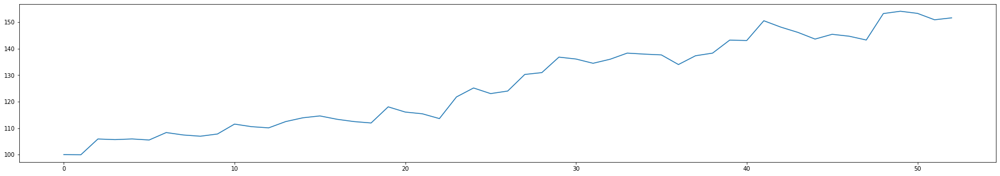

cumulative profit percentage: 325.3084093582547
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 360
cumulative profit count: 343
(profit count / loss count) ratio: 0.9527777777777777


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + psar & determine via macd

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_macd = df1["macd_hist"][index]
    
    return True if curr_macd > 0 else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 6.6519126272552995
max loss: -2.362466435380412
max profit: 6.628454785867177
transaction count: 32
loss count: 17
profit count: 15
profit percentage: 6.651912627255299
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


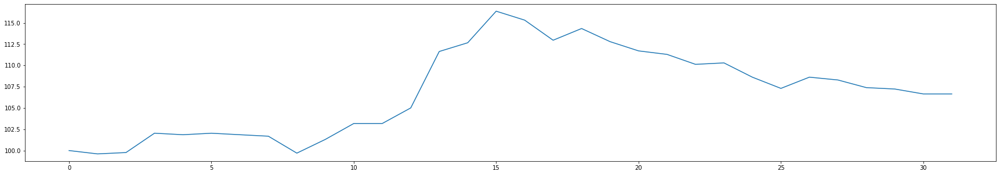

profit: 11.78132552388756
max loss: -5.956828920101046
max profit: 11.36361517448421
transaction count: 18
loss count: 10
profit count: 8
profit percentage: 11.78132552388756
Hodl strategy expected return of APEUSDT: -57.663335972000255


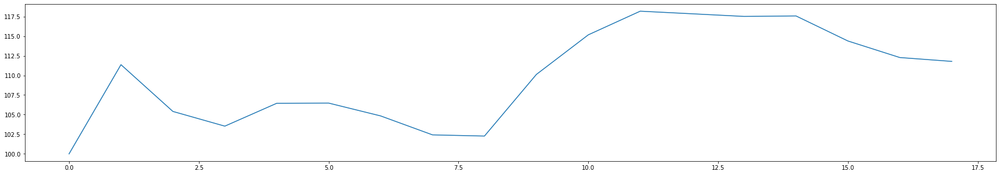

profit: 23.928397106563935
max loss: -7.4529604012213895
max profit: 18.804271689861224
transaction count: 28
loss count: 18
profit count: 10
profit percentage: 23.928397106563935
Hodl strategy expected return of BEARUSDT: -32.7710843373494


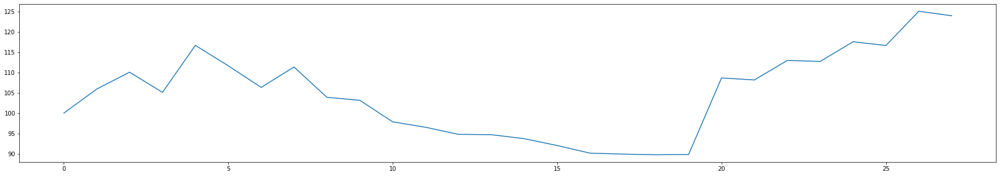

profit: 49.24529965696692
max loss: -4.7993498409118445
max profit: 15.733621461323338
transaction count: 23
loss count: 9
profit count: 14
profit percentage: 49.24529965696692
Hodl strategy expected return of BULLUSDT: 5.791070587599496


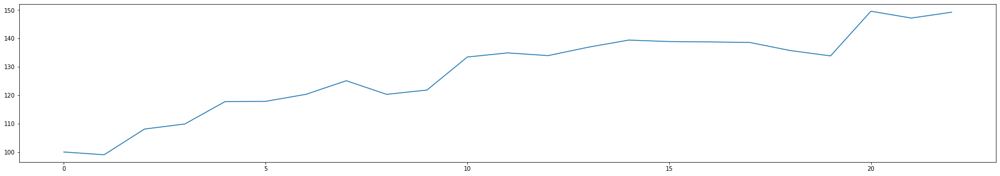

profit: 14.35079173944446
max loss: -2.1167078521945086
max profit: 18.188740276683802
transaction count: 25
loss count: 15
profit count: 10
profit percentage: 14.35079173944446
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


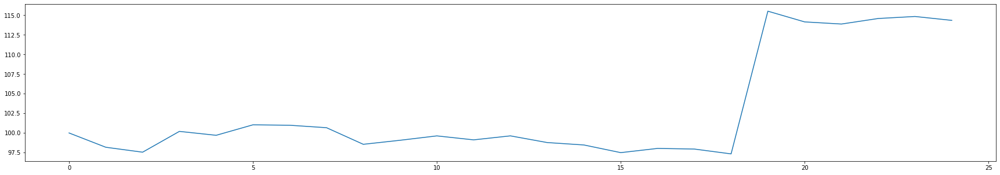

profit: 38.06412087546684
max loss: -5.179626290628605
max profit: 33.554283246823985
transaction count: 22
loss count: 6
profit count: 16
profit percentage: 38.06412087546684
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


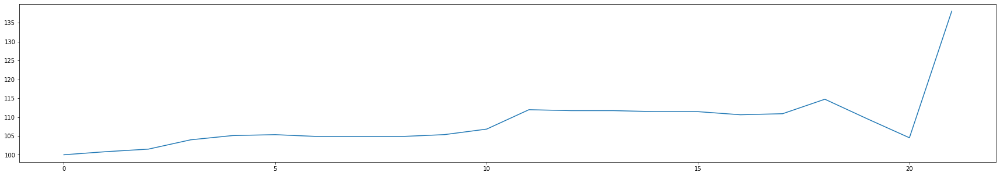

profit: 5.903346923695139
max loss: -1.294650607146096
max profit: 5.511482584874372
transaction count: 22
loss count: 12
profit count: 10
profit percentage: 5.90334692369514
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


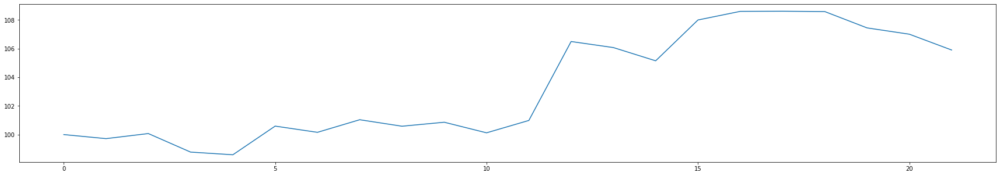

profit: 24.574396764480042
max loss: -3.2161542558527145
max profit: 12.234917055643933
transaction count: 30
loss count: 11
profit count: 19
profit percentage: 24.574396764480042
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


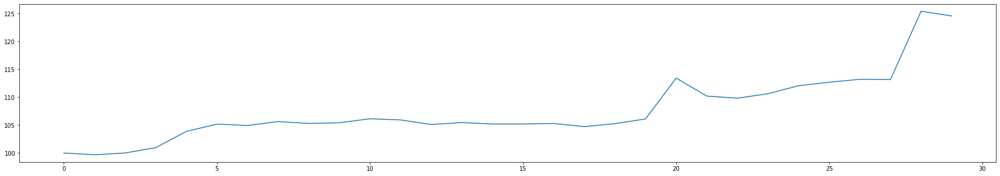

profit: 31.986768861094475
max loss: -5.182075151123939
max profit: 29.676774045130756
transaction count: 26
loss count: 14
profit count: 12
profit percentage: 31.986768861094475
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


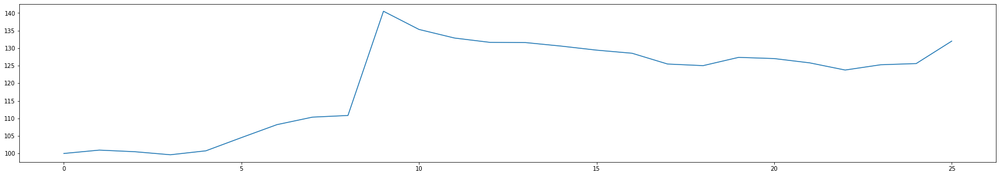

profit: 14.678093084250875
max loss: -3.2166265659062816
max profit: 15.268191919937891
transaction count: 18
loss count: 11
profit count: 7
profit percentage: 14.678093084250875
Hodl strategy expected return of MOBUSDT: -45.26532479414456


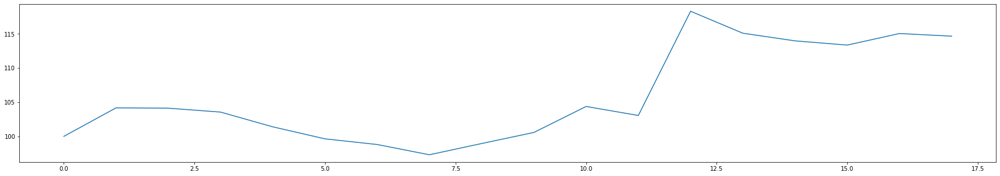

profit: 8.316932204927653
max loss: -1.9163709977705565
max profit: 6.43738941380731
transaction count: 28
loss count: 16
profit count: 12
profit percentage: 8.316932204927653
Hodl strategy expected return of NUUSDT: -2.4582809976673325


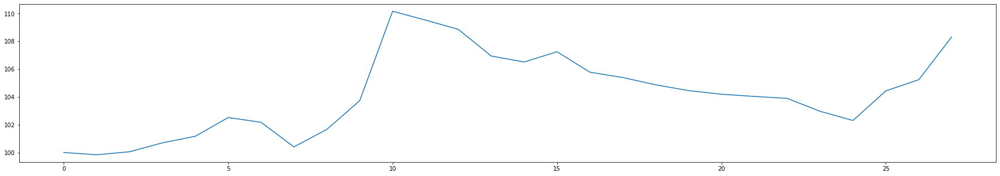

profit: 10.368457300568991
max loss: -1.3770366100224862
max profit: 5.487663995421755
transaction count: 13
loss count: 5
profit count: 8
profit percentage: 10.368457300568991
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


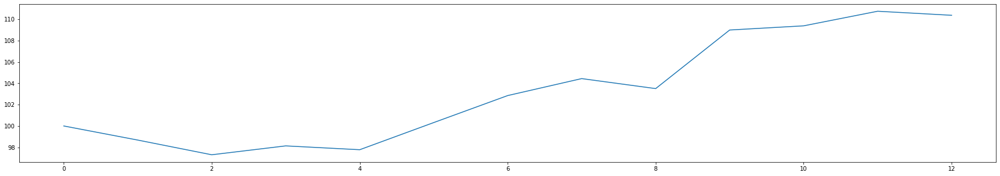

profit: 145.55876500563997
max loss: -5.468053366665288
max profit: 56.750196698410946
transaction count: 22
loss count: 8
profit count: 14
profit percentage: 145.55876500563997
Hodl strategy expected return of STORMUSDT: 81.46367521367522


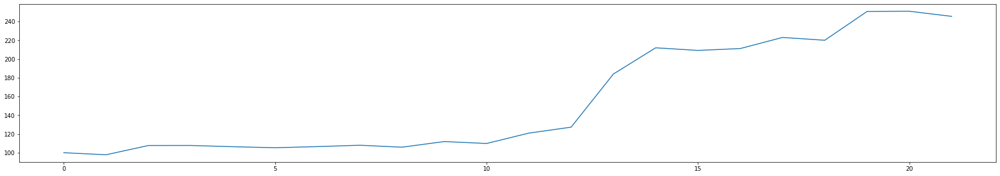

profit: 19.606897333906858
max loss: -4.756802959059783
max profit: 7.5639626189034175
transaction count: 33
loss count: 14
profit count: 19
profit percentage: 19.606897333906858
Hodl strategy expected return of STRATUSDT: 28.24267782426778


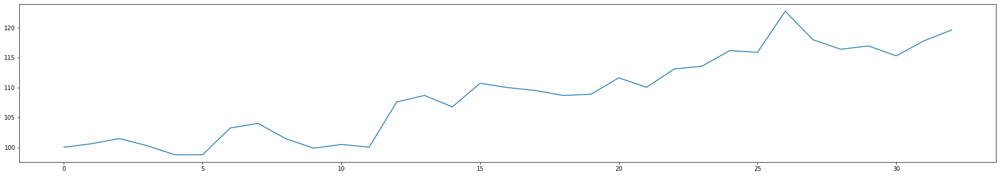

profit: 49.86354040589296
max loss: -3.4447260813819014
max profit: 10.84630063568207
transaction count: 27
loss count: 10
profit count: 17
profit percentage: 49.86354040589296
Hodl strategy expected return of TRXUSDT: 21.927066960075457


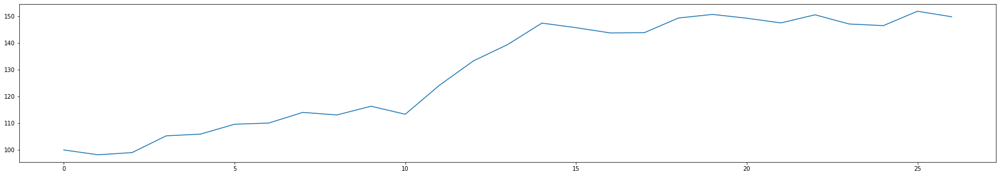

cumulative profit percentage: 454.879045414042
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 176
cumulative profit count: 191
(profit count / loss count) ratio: 1.0852272727272727


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + macd & determine via macd

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_macd = df1["macd_hist"][index]
    
    return True if curr_macd > 0 else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 0.4293136280684564
max loss: -2.0933610479995366
max profit: 6.602406721610606
transaction count: 27
loss count: 17
profit count: 10
profit percentage: 0.4293136280684564
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


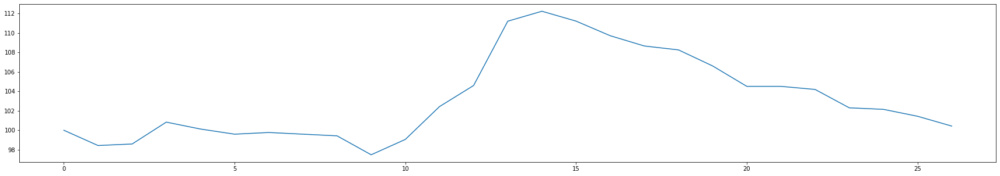

profit: 3.132391705433136
max loss: -5.656167537689001
max profit: 7.2207224326214
transaction count: 19
loss count: 10
profit count: 9
profit percentage: 3.132391705433136
Hodl strategy expected return of APEUSDT: -57.663335972000255


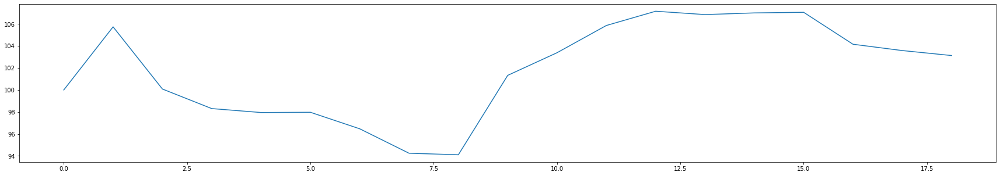

profit: 10.1599715446673
max loss: -7.043268065840138
max profit: 16.927836800560314
transaction count: 26
loss count: 17
profit count: 9
profit percentage: 10.1599715446673
Hodl strategy expected return of BEARUSDT: -32.7710843373494


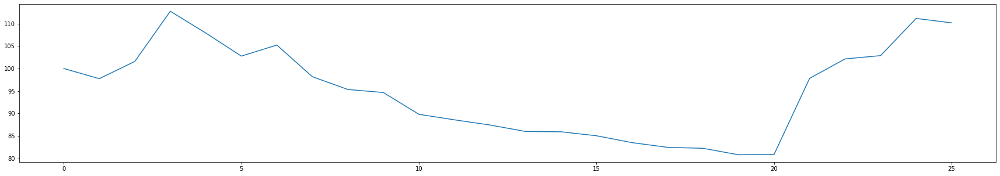

profit: 16.139973413896712
max loss: -3.8837138951056005
max profit: 12.513185889507852
transaction count: 24
loss count: 13
profit count: 11
profit percentage: 16.139973413896712
Hodl strategy expected return of BULLUSDT: 5.791070587599496


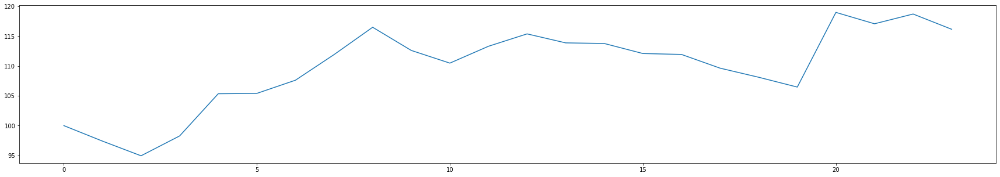

profit: 10.334208885128916
max loss: -2.620723027743267
max profit: 18.02027771514615
transaction count: 22
loss count: 14
profit count: 8
profit percentage: 10.334208885128916
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


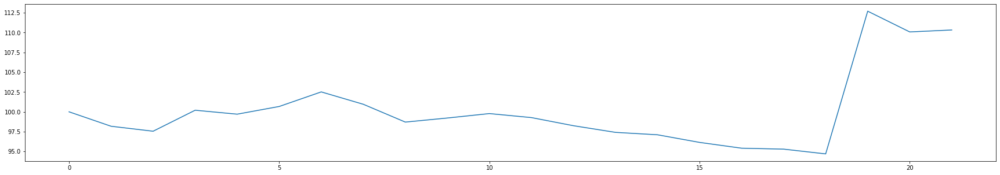

profit: 35.8716274114492
max loss: -4.95923370879845
max profit: 33.021432668107636
transaction count: 20
loss count: 8
profit count: 12
profit percentage: 35.8716274114492
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


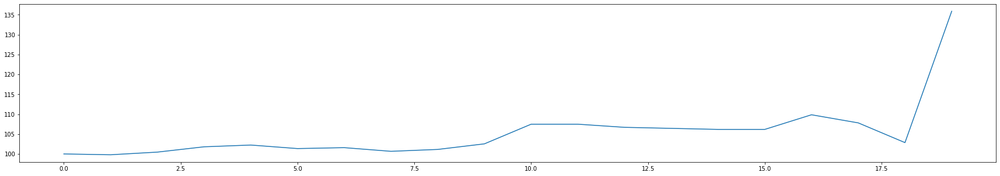

profit: 2.656164931993416
max loss: -2.070002344338249
max profit: 5.36962382719409
transaction count: 21
loss count: 12
profit count: 9
profit percentage: 2.656164931993416
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


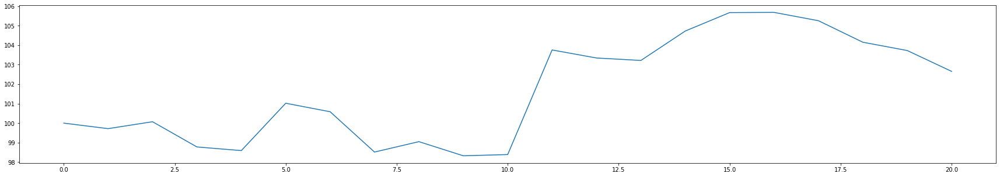

profit: 3.0157174123339274
max loss: -5.231420548239939
max profit: 6.886627980132204
transaction count: 26
loss count: 14
profit count: 12
profit percentage: 3.0157174123339274
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


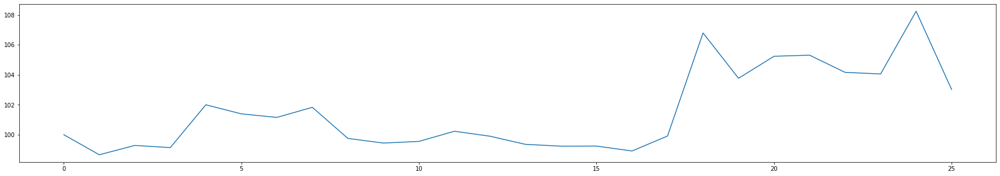

profit: 20.842873018263788
max loss: -5.131240447802128
max profit: 29.38565321802247
transaction count: 24
loss count: 13
profit count: 11
profit percentage: 20.84287301826379
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


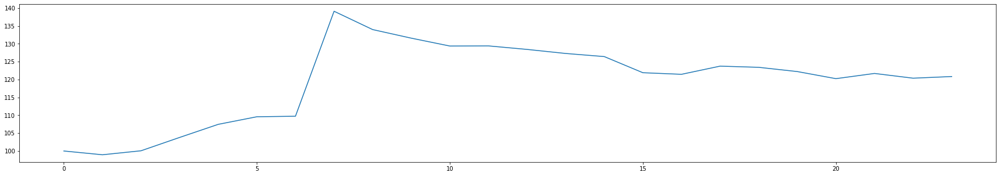

profit: 14.187893064114093
max loss: -3.1701577463810935
max profit: 16.070274663772025
transaction count: 18
loss count: 11
profit count: 7
profit percentage: 14.18789306411409
Hodl strategy expected return of MOBUSDT: -45.26532479414456


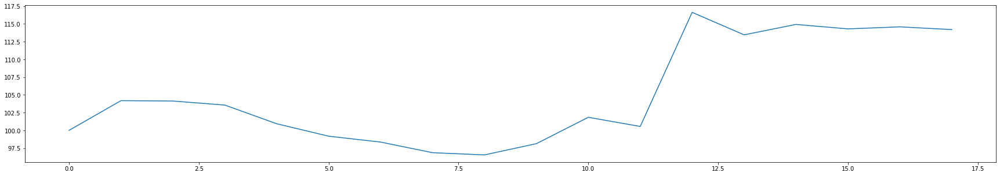

profit: 3.8814597257330803
max loss: -1.8766062757948703
max profit: 6.303813503617135
transaction count: 26
loss count: 15
profit count: 11
profit percentage: 3.8814597257330803
Hodl strategy expected return of NUUSDT: -2.4582809976673325


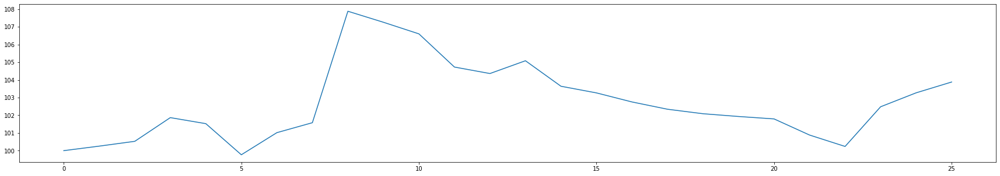

profit: 8.073509816698461
max loss: -1.3770366100224862
max profit: 5.4467070972047225
transaction count: 14
loss count: 6
profit count: 8
profit percentage: 8.073509816698461
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


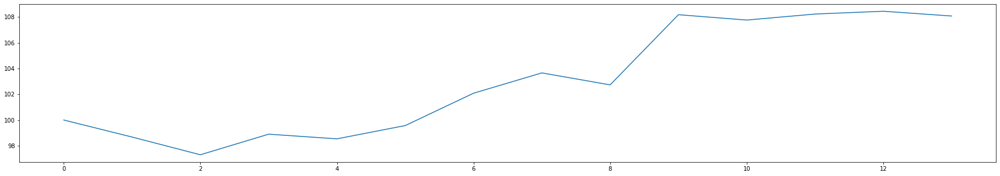

profit: 126.96778870519111
max loss: -3.2433297695153556
max profit: 39.217147552366015
transaction count: 15
loss count: 4
profit count: 11
profit percentage: 126.96778870519111
Hodl strategy expected return of STORMUSDT: 81.46367521367522


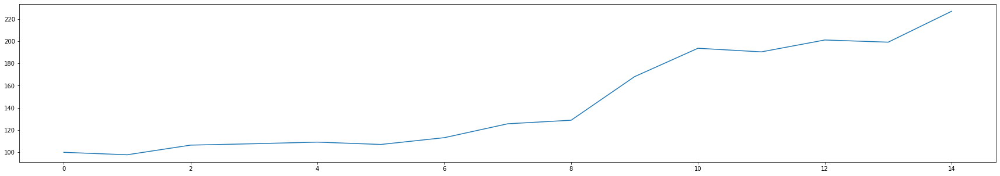

profit: 13.681626419078142
max loss: -4.515262758833103
max profit: 7.920648566161475
transaction count: 32
loss count: 16
profit count: 16
profit percentage: 13.681626419078142
Hodl strategy expected return of STRATUSDT: 28.24267782426778


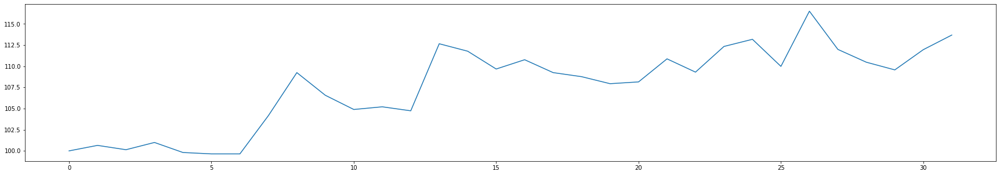

profit: 48.428491983135956
max loss: -3.0747248518684387
max profit: 9.295985950924688
transaction count: 20
loss count: 5
profit count: 15
profit percentage: 48.428491983135956
Hodl strategy expected return of TRXUSDT: 21.927066960075457


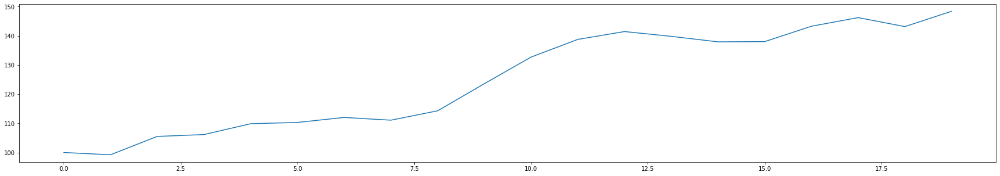

cumulative profit percentage: 317.80301166518564
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 175
cumulative profit count: 159
(profit count / loss count) ratio: 0.9085714285714286


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + psar & determine via macd

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_macd = df1["macd_hist"][index]
    
    return True if curr_macd > 0 else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 13.367685867307003
max loss: -2.4035044753376127
max profit: 8.431746214289632
transaction count: 34
loss count: 15
profit count: 19
profit percentage: 13.367685867307003
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


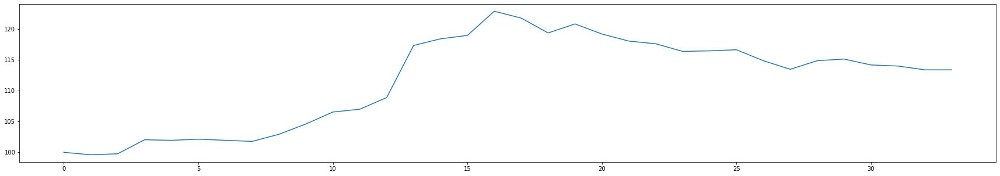

profit: 14.523189495145502
max loss: -5.956828920101046
max profit: 11.36361517448421
transaction count: 21
loss count: 12
profit count: 9
profit percentage: 14.523189495145502
Hodl strategy expected return of APEUSDT: -57.663335972000255


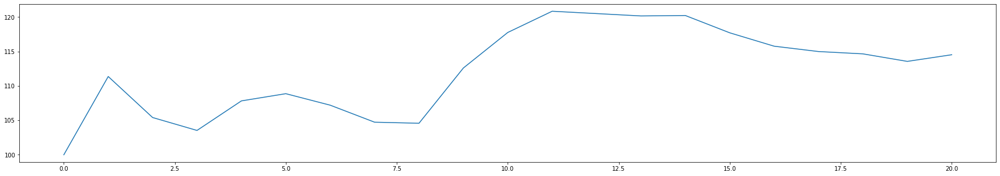

profit: 29.228900742488605
max loss: -7.583227662757281
max profit: 19.579493759149983
transaction count: 28
loss count: 17
profit count: 11
profit percentage: 29.228900742488605
Hodl strategy expected return of BEARUSDT: -32.7710843373494


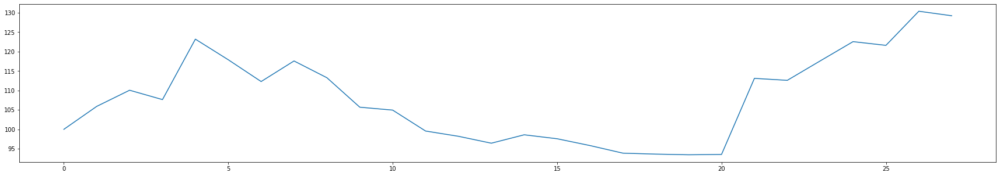

profit: 59.64352118998758
max loss: -3.669440227567975
max profit: 18.57621064093209
transaction count: 24
loss count: 9
profit count: 15
profit percentage: 59.64352118998758
Hodl strategy expected return of BULLUSDT: 5.791070587599496


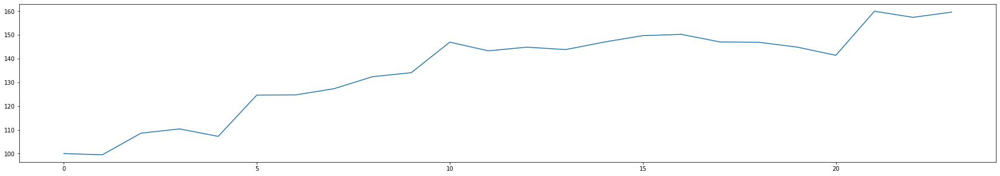

profit: 17.227803274230936
max loss: -2.1286148244263075
max profit: 18.536312747577455
transaction count: 24
loss count: 13
profit count: 11
profit percentage: 17.227803274230936
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


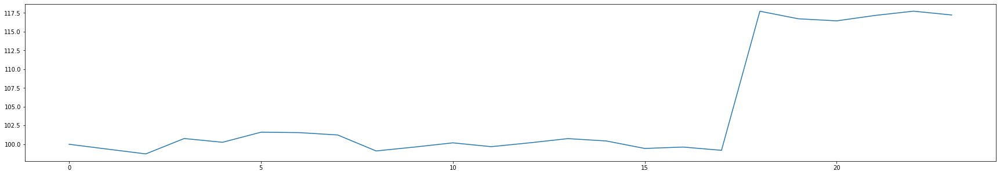

profit: 35.20541181321869
max loss: -5.072378697827617
max profit: 32.859519589280694
transaction count: 25
loss count: 9
profit count: 16
profit percentage: 35.20541181321869
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


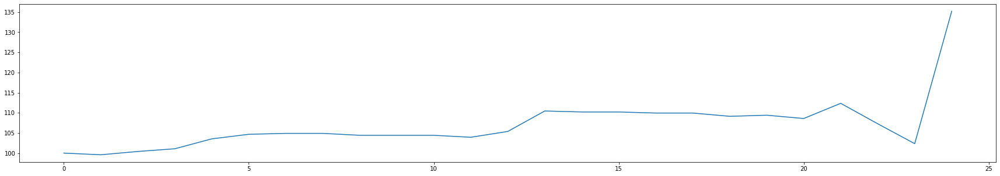

profit: 4.090017322650752
max loss: -1.5318969917862262
max profit: 5.483487278735083
transaction count: 24
loss count: 13
profit count: 11
profit percentage: 4.090017322650752
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


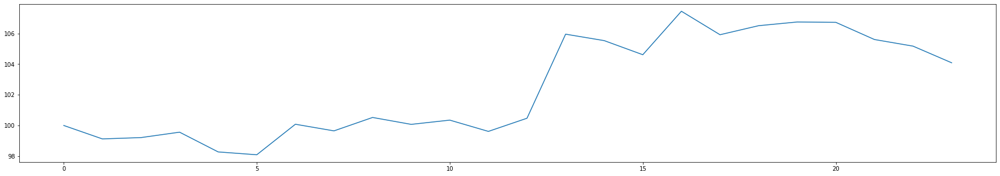

profit: 28.645414571649155
max loss: -3.2032242031711604
max profit: 12.634746928365942
transaction count: 33
loss count: 11
profit count: 22
profit percentage: 28.64541457164915
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


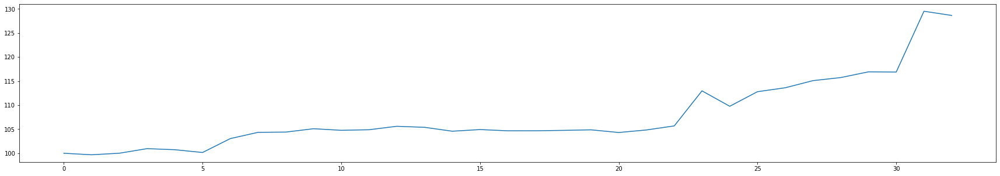

profit: 33.71858510653914
max loss: -5.08140296902792
max profit: 29.100243309167652
transaction count: 28
loss count: 15
profit count: 13
profit percentage: 33.71858510653914
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


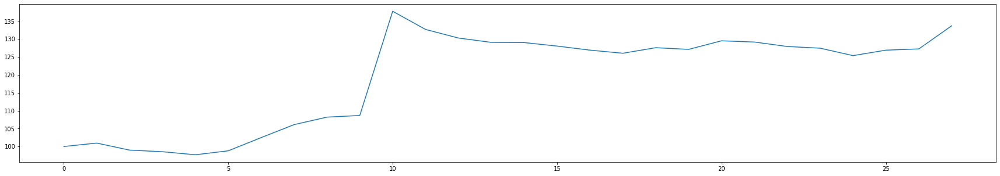

profit: 15.995466143695396
max loss: -3.255978965451149
max profit: 15.454983882402402
transaction count: 22
loss count: 14
profit count: 8
profit percentage: 15.995466143695396
Hodl strategy expected return of MOBUSDT: -45.26532479414456


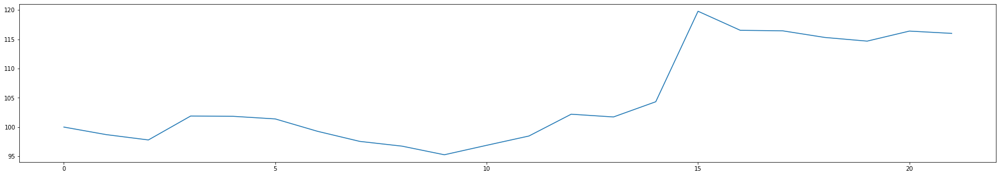

profit: 9.41453840560159
max loss: -1.9122200136598622
max profit: 6.423445610022881
transaction count: 27
loss count: 15
profit count: 12
profit percentage: 9.41453840560159
Hodl strategy expected return of NUUSDT: -2.4582809976673325


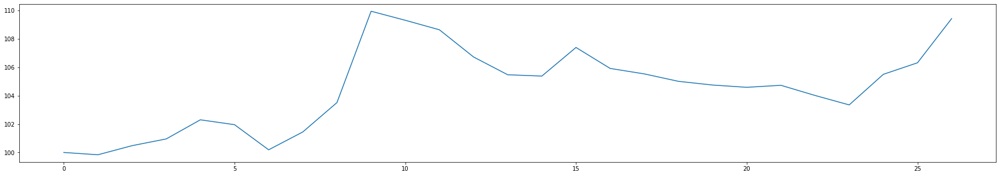

profit: 10.921208428805869
max loss: -1.3210368893319924
max profit: 5.551255044682549
transaction count: 16
loss count: 7
profit count: 9
profit percentage: 10.921208428805869
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


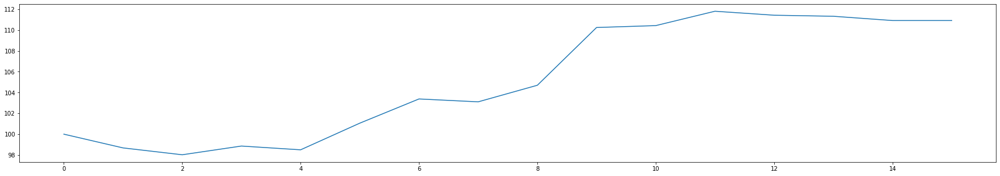

profit: 139.8322724617478
max loss: -5.340536978345398
max profit: 55.51826125853397
transaction count: 22
loss count: 8
profit count: 14
profit percentage: 139.8322724617478
Hodl strategy expected return of STORMUSDT: 81.46367521367522


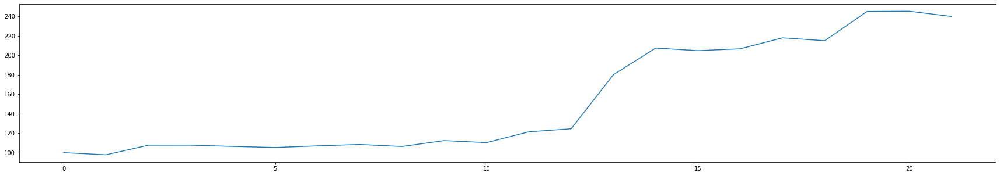

profit: 30.2112645649446
max loss: -5.058133452418431
max profit: 8.019987617956986
transaction count: 33
loss count: 13
profit count: 20
profit percentage: 30.2112645649446
Hodl strategy expected return of STRATUSDT: 28.24267782426778


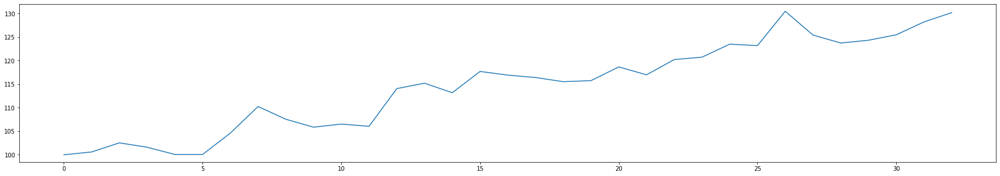

profit: 57.16913120958168
max loss: -2.1695125473715393
max profit: 11.497185011512471
transaction count: 27
loss count: 10
profit count: 17
profit percentage: 57.169131209581685
Hodl strategy expected return of TRXUSDT: 21.927066960075457


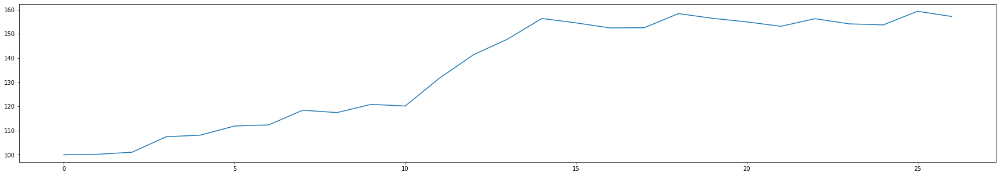

cumulative profit percentage: 499.19441059759436
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 181
cumulative profit count: 207
(profit count / loss count) ratio: 1.143646408839779


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + macd & determine via macd

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_macd = df1["macd_hist"][index]
    
    return True if curr_macd > 0 else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 1.037853190779046
max loss: -2.094834633281266
max profit: 7.998013186625371
transaction count: 27
loss count: 16
profit count: 11
profit percentage: 1.037853190779046
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


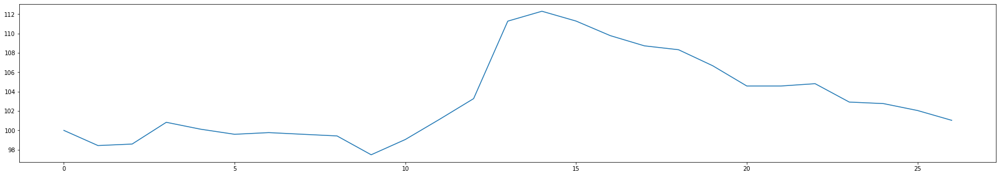

profit: 4.240905778778796
max loss: -5.656167537689001
max profit: 7.289744819810707
transaction count: 22
loss count: 11
profit count: 11
profit percentage: 4.240905778778796
Hodl strategy expected return of APEUSDT: -57.663335972000255


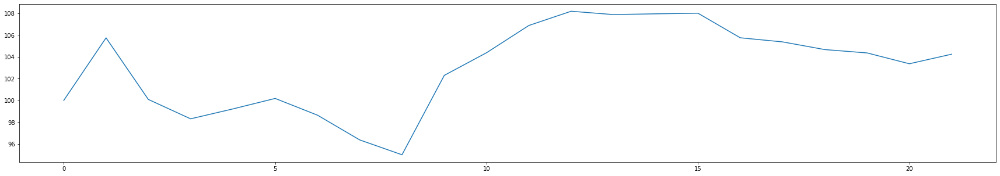

profit: 12.930730799885936
max loss: -6.869360212362594
max profit: 17.353608156782613
transaction count: 26
loss count: 16
profit count: 10
profit percentage: 12.930730799885938
Hodl strategy expected return of BEARUSDT: -32.7710843373494


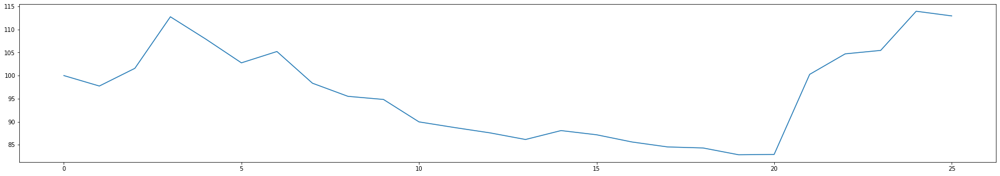

profit: 26.76429956441082
max loss: -4.211113627404629
max profit: 15.950880636089906
transaction count: 24
loss count: 13
profit count: 11
profit percentage: 26.76429956441082
Hodl strategy expected return of BULLUSDT: 5.791070587599496


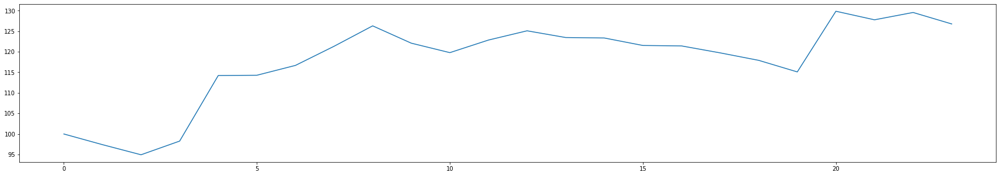

profit: 10.210588591912483
max loss: -2.6177867258256384
max profit: 18.00008749456545
transaction count: 22
loss count: 14
profit count: 8
profit percentage: 10.210588591912483
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


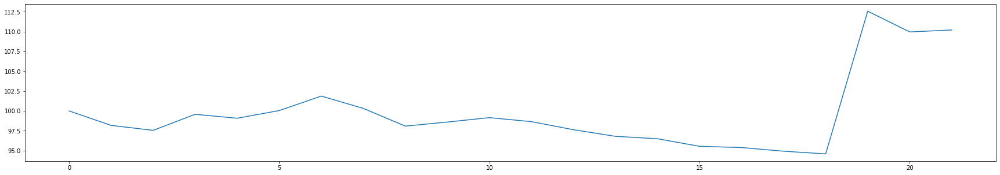

profit: 32.86023163435178
max loss: -4.849319551348259
max profit: 32.289560938998804
transaction count: 24
loss count: 12
profit count: 12
profit percentage: 32.86023163435178
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


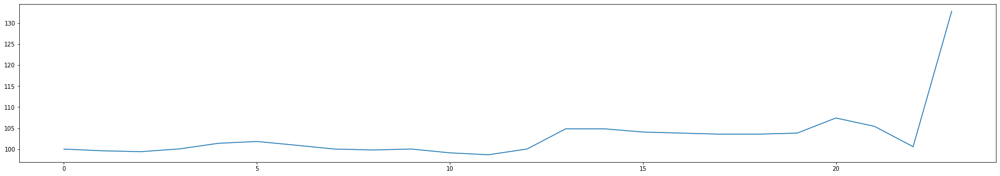

profit: 0.8984351906000541
max loss: -2.0594878687055314
max profit: 5.342349085673959
transaction count: 23
loss count: 13
profit count: 10
profit percentage: 0.8984351906000541
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


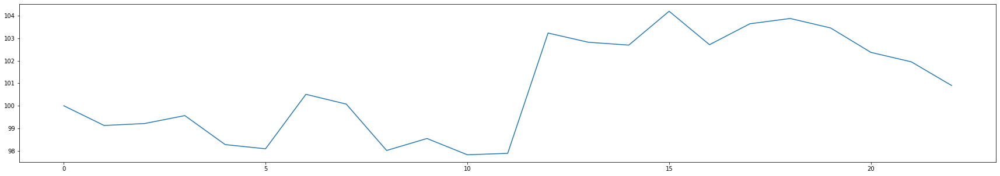

profit: 3.9291477686338965
max loss: -5.2778070459061865
max profit: 6.948087938778571
transaction count: 27
loss count: 14
profit count: 13
profit percentage: 3.9291477686338965
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


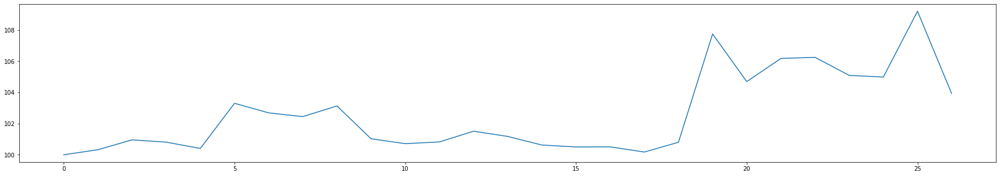

profit: 25.279038066160467
max loss: -5.131240447802128
max profit: 29.38565321802247
transaction count: 24
loss count: 12
profit count: 12
profit percentage: 25.279038066160464
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


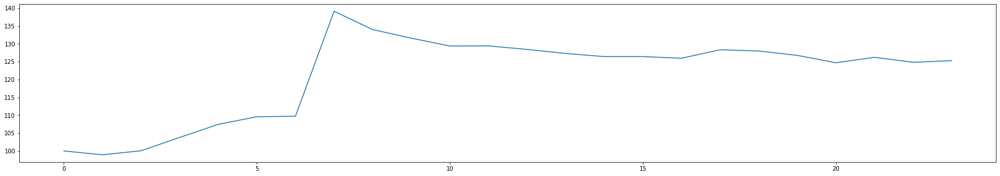

profit: 12.877362395702008
max loss: -3.136086699179799
max profit: 15.897560518164582
transaction count: 21
loss count: 13
profit count: 8
profit percentage: 12.877362395702008
Hodl strategy expected return of MOBUSDT: -45.26532479414456


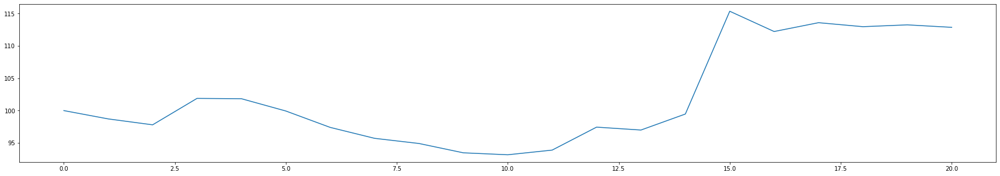

profit: 6.225212078361523
max loss: -1.8766062757948703
max profit: 6.303813503617135
transaction count: 25
loss count: 14
profit count: 11
profit percentage: 6.225212078361523
Hodl strategy expected return of NUUSDT: -2.4582809976673325


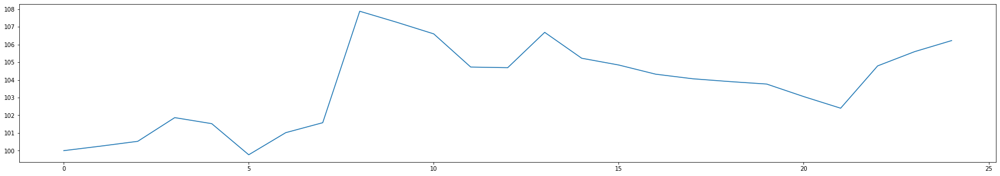

profit: 8.964977967890135
max loss: -1.3210368893319924
max profit: 5.524622956518954
transaction count: 14
loss count: 6
profit count: 8
profit percentage: 8.964977967890135
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


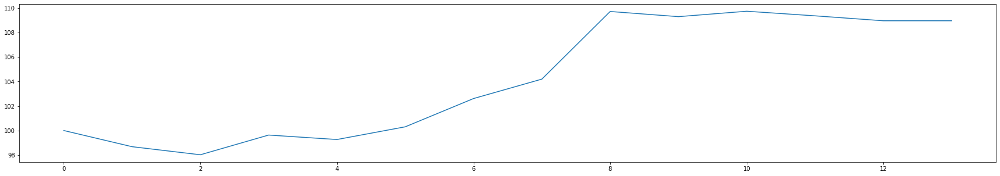

profit: 131.39866441872226
max loss: -3.2433297695153556
max profit: 39.217147552366015
transaction count: 15
loss count: 4
profit count: 11
profit percentage: 131.39866441872226
Hodl strategy expected return of STORMUSDT: 81.46367521367522


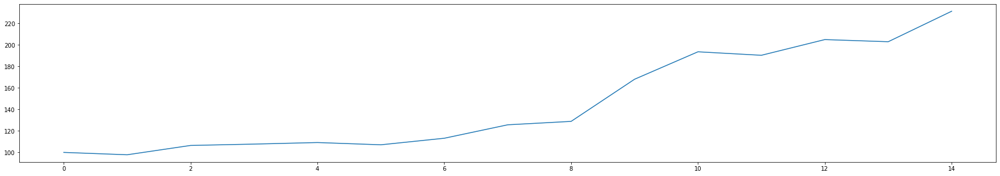

profit: 13.992741981254085
max loss: -4.527619799771344
max profit: 7.942325217957205
transaction count: 32
loss count: 16
profit count: 16
profit percentage: 13.992741981254085
Hodl strategy expected return of STRATUSDT: 28.24267782426778


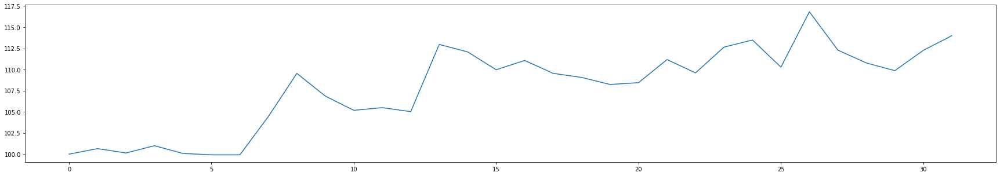

profit: 48.428491983135956
max loss: -3.0747248518684387
max profit: 9.295985950924688
transaction count: 20
loss count: 5
profit count: 15
profit percentage: 48.428491983135956
Hodl strategy expected return of TRXUSDT: 21.927066960075457


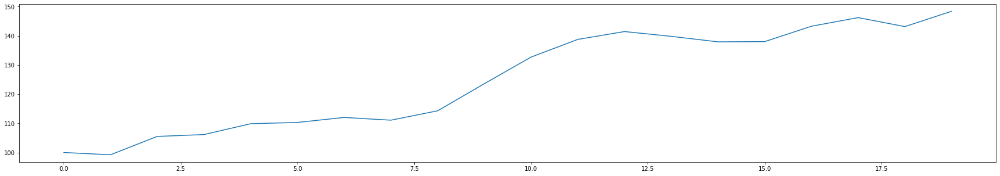

cumulative profit percentage: 340.0386814105792
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 179
cumulative profit count: 167
(profit count / loss count) ratio: 0.9329608938547486


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + psar & determine via macd

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_macd = df1["macd_hist"][index]
    
    return True if curr_macd > 0 else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 8.567438529021288
max loss: -2.319373768698867
max profit: 6.880321443220211
transaction count: 33
loss count: 16
profit count: 17
profit percentage: 8.567438529021288
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


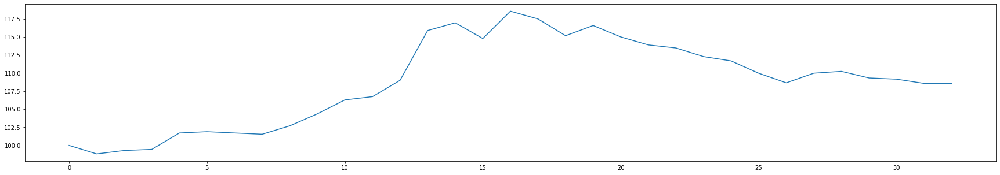

profit: 14.158982317890235
max loss: -5.956828920101046
max profit: 11.36361517448421
transaction count: 13
loss count: 7
profit count: 6
profit percentage: 14.158982317890237
Hodl strategy expected return of APEUSDT: -57.663335972000255


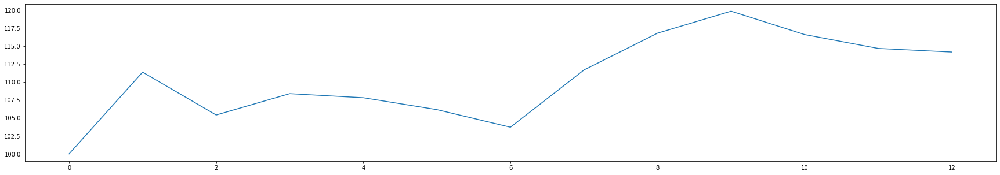

profit: 26.668562635167845
max loss: -7.634853677596624
max profit: 19.2631994720293
transaction count: 27
loss count: 17
profit count: 10
profit percentage: 26.668562635167845
Hodl strategy expected return of BEARUSDT: -32.7710843373494


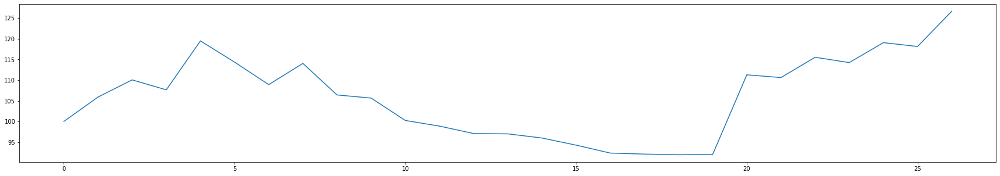

profit: 48.21228651357191
max loss: -4.57419683180153
max profit: 15.624719956216609
transaction count: 21
loss count: 7
profit count: 14
profit percentage: 48.21228651357191
Hodl strategy expected return of BULLUSDT: 5.791070587599496


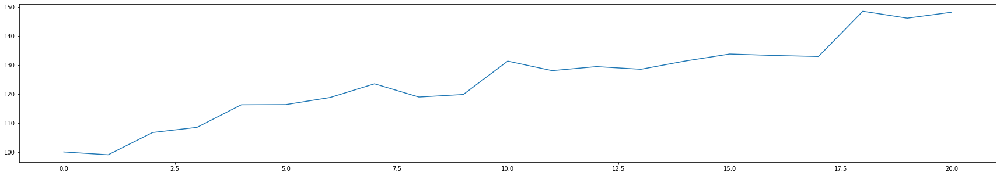

profit: 17.459680838536144
max loss: -2.136210877086711
max profit: 18.572977727480335
transaction count: 23
loss count: 13
profit count: 10
profit percentage: 17.459680838536144
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


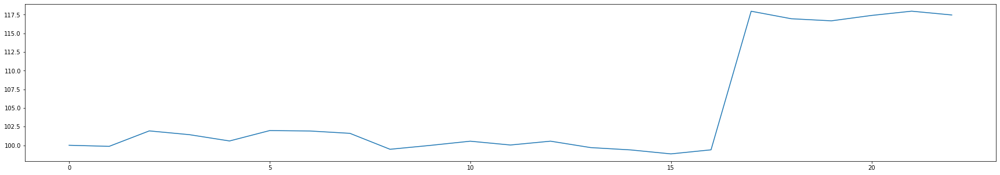

profit: 35.53453138308811
max loss: -5.08472597796127
max profit: 32.93950685316538
transaction count: 23
loss count: 7
profit count: 16
profit percentage: 35.53453138308811
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


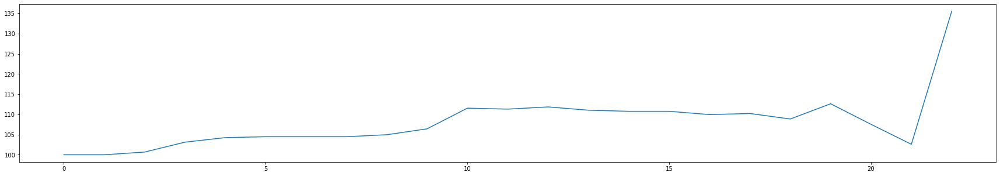

profit: 9.017821488894612
max loss: -1.1368347354808463
max profit: 5.632968778417549
transaction count: 19
loss count: 9
profit count: 10
profit percentage: 9.017821488894612
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


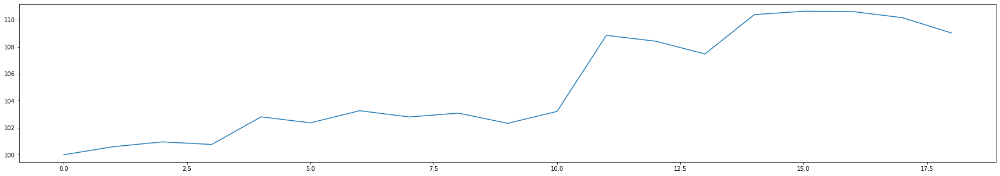

profit: 29.939917465614002
max loss: -3.235272036235372
max profit: 12.761884895294202
transaction count: 30
loss count: 8
profit count: 22
profit percentage: 29.939917465614002
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


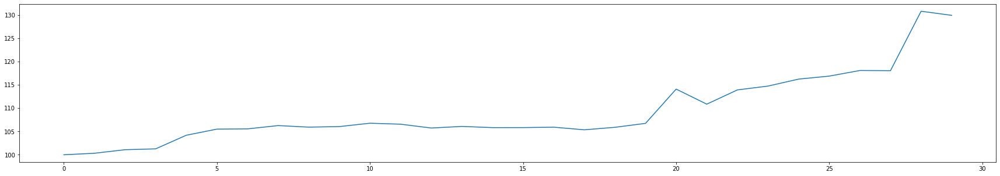

profit: 33.07360055231527
max loss: -5.08140296902792
max profit: 29.100243309167652
transaction count: 27
loss count: 14
profit count: 13
profit percentage: 33.07360055231527
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


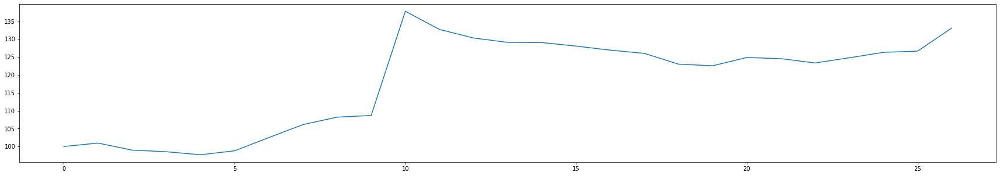

profit: 9.232334968250768
max loss: -3.1316053306414773
max profit: 14.86462610006555
transaction count: 19
loss count: 13
profit count: 6
profit percentage: 9.232334968250768
Hodl strategy expected return of MOBUSDT: -45.26532479414456


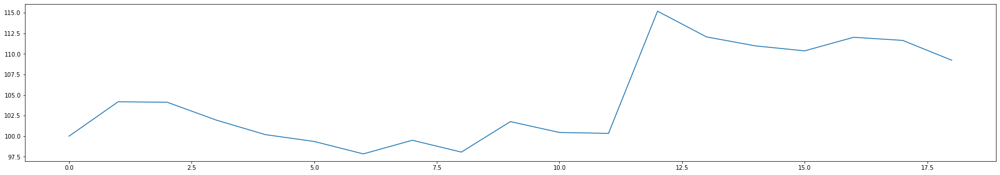

profit: 4.622507315701185
max loss: -1.8861759123064132
max profit: 6.335959406913062
transaction count: 32
loss count: 19
profit count: 13
profit percentage: 4.622507315701185
Hodl strategy expected return of NUUSDT: -2.4582809976673325


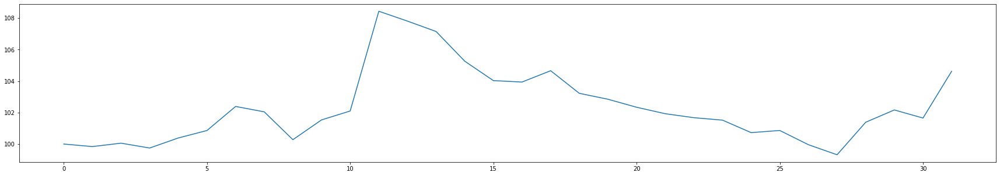

profit: 10.446377548255327
max loss: -1.3770366100224862
max profit: 5.511253839594048
transaction count: 13
loss count: 6
profit count: 7
profit percentage: 10.446377548255327
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


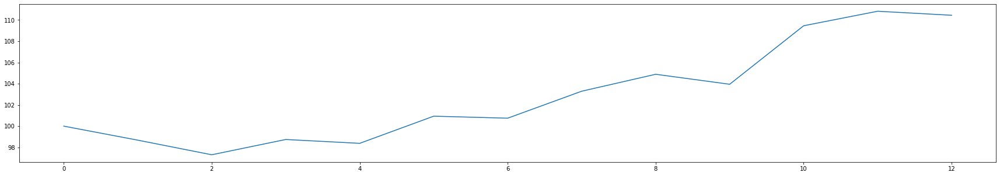

profit: 140.16709693318805
max loss: -5.347992782573186
max profit: 56.750196698410946
transaction count: 22
loss count: 8
profit count: 14
profit percentage: 140.16709693318805
Hodl strategy expected return of STORMUSDT: 81.46367521367522


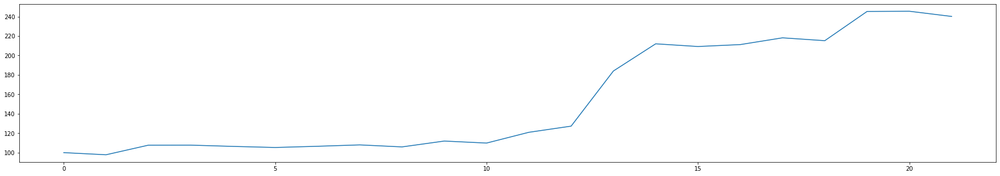

profit: 27.31157169657162
max loss: -4.991435433747213
max profit: 7.914233728915221
transaction count: 32
loss count: 13
profit count: 19
profit percentage: 27.31157169657162
Hodl strategy expected return of STRATUSDT: 28.24267782426778


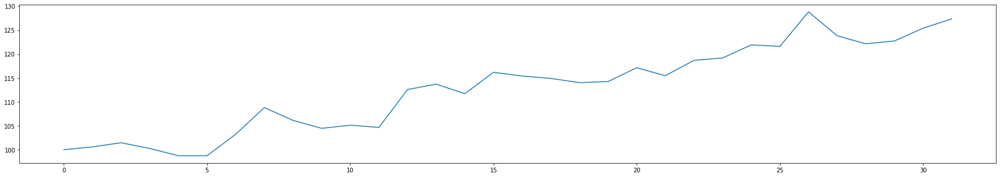

profit: 43.725061482460404
max loss: -2.5210416274364036
max profit: 11.072296831279417
transaction count: 27
loss count: 11
profit count: 16
profit percentage: 43.725061482460404
Hodl strategy expected return of TRXUSDT: 21.927066960075457


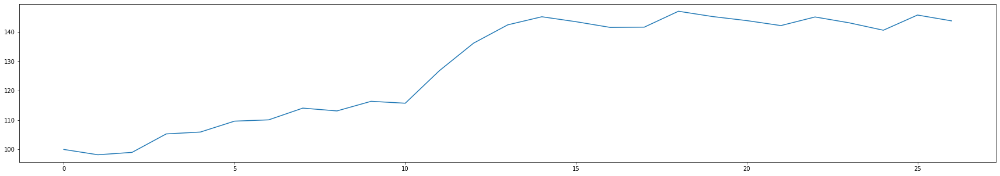

cumulative profit percentage: 458.13777166852674
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 168
cumulative profit count: 193
(profit count / loss count) ratio: 1.1488095238095237


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + macd & determine via macd

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_macd = df1["macd_hist"][index]
    
    return True if curr_macd > 0 else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 1.898419283908126
max loss: -2.1126768933767153
max profit: 6.663328399442378
transaction count: 26
loss count: 15
profit count: 11
profit percentage: 1.898419283908126
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


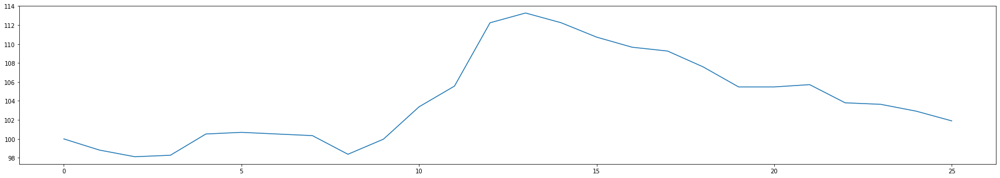

profit: 2.266512998855461
max loss: -5.656167537689001
max profit: 7.322127594800307
transaction count: 13
loss count: 8
profit count: 5
profit percentage: 2.266512998855461
Hodl strategy expected return of APEUSDT: -57.663335972000255


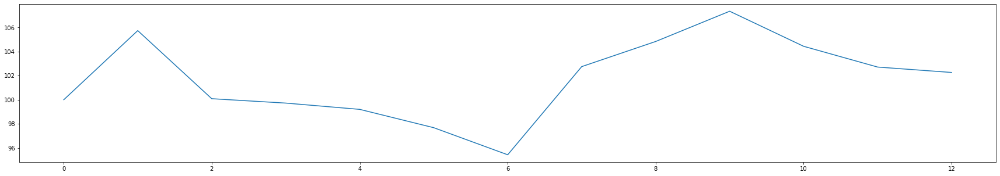

profit: 7.666498580991984
max loss: -6.625232371284881
max profit: 16.397611129112306
transaction count: 24
loss count: 16
profit count: 8
profit percentage: 7.666498580991983
Hodl strategy expected return of BEARUSDT: -32.7710843373494


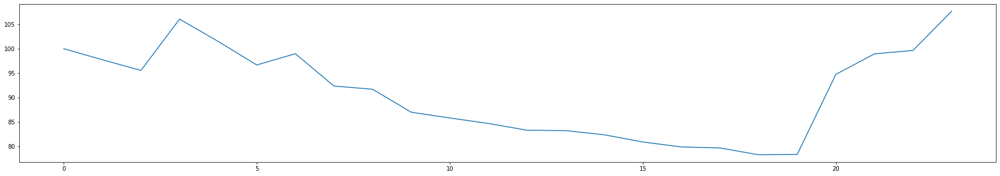

profit: 22.31400328344725
max loss: -3.8343310816149057
max profit: 13.178389963300205
transaction count: 19
loss count: 8
profit count: 11
profit percentage: 22.31400328344725
Hodl strategy expected return of BULLUSDT: 5.791070587599496


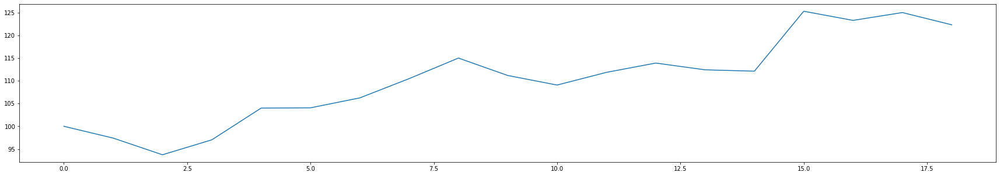

profit: 13.10925905405918
max loss: -2.6866376516332053
max profit: 18.19198877689719
transaction count: 20
loss count: 12
profit count: 8
profit percentage: 13.10925905405918
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


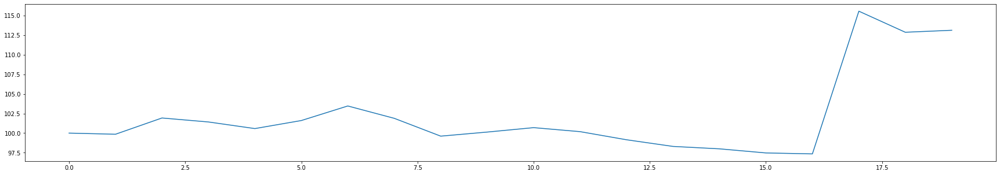

profit: 37.0866470229044
max loss: -5.003581203038237
max profit: 33.316723812068105
transaction count: 21
loss count: 6
profit count: 15
profit percentage: 37.0866470229044
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


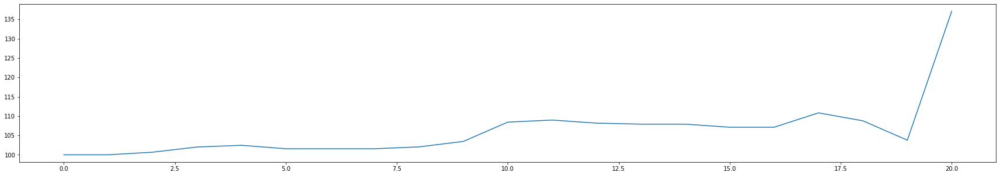

profit: 5.715033538394508
max loss: -2.115630122629568
max profit: 5.4879831160930195
transaction count: 18
loss count: 9
profit count: 9
profit percentage: 5.715033538394507
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


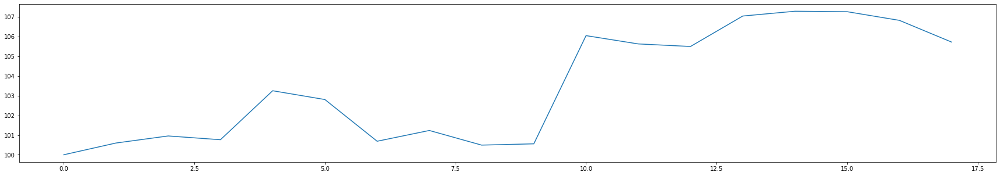

profit: 4.556959128411094
max loss: -5.309689027903275
max profit: 6.989660396861396
transaction count: 26
loss count: 13
profit count: 13
profit percentage: 4.556959128411094
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


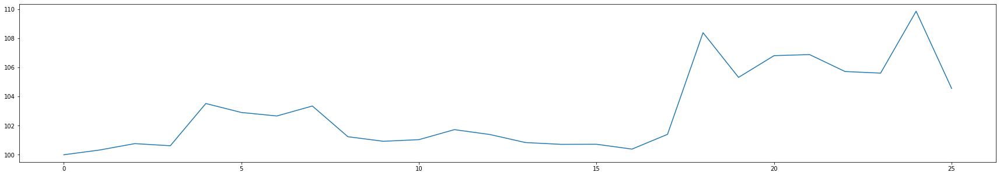

profit: 25.192671113682863
max loss: -5.131240447802128
max profit: 29.38565321802247
transaction count: 24
loss count: 12
profit count: 12
profit percentage: 25.192671113682863
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


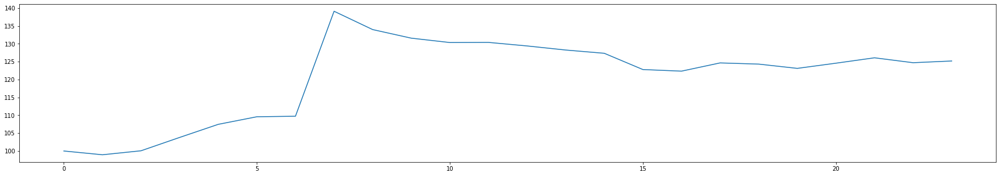

profit: 9.189972887320522
max loss: -3.1007553858717927
max profit: 15.718457787475657
transaction count: 18
loss count: 13
profit count: 5
profit percentage: 9.189972887320522
Hodl strategy expected return of MOBUSDT: -45.26532479414456


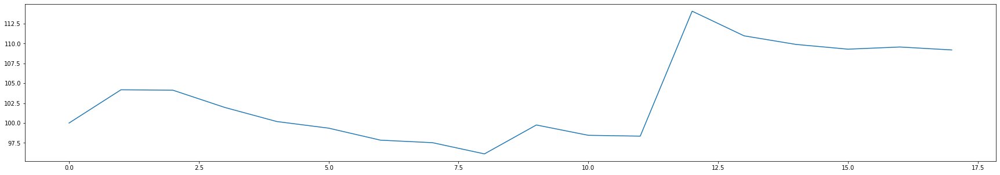

profit: 3.3417061295826045
max loss: -1.8766062757948703
max profit: 6.303813503617135
transaction count: 27
loss count: 16
profit count: 11
profit percentage: 3.3417061295826045
Hodl strategy expected return of NUUSDT: -2.4582809976673325


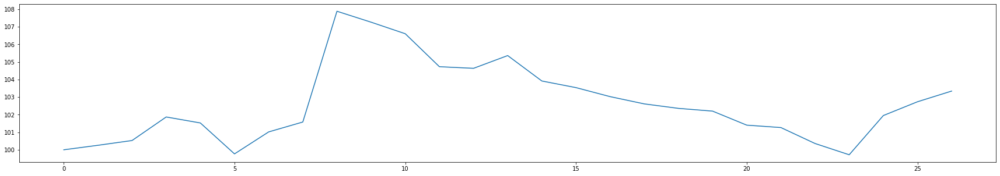

profit: 7.647302135229367
max loss: -1.3770366100224862
max profit: 5.427728173877696
transaction count: 14
loss count: 7
profit count: 7
profit percentage: 7.647302135229368
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


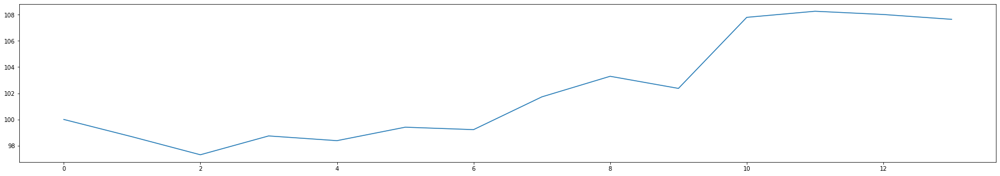

profit: 121.98431772296541
max loss: -3.2433297695153556
max profit: 39.217147552366015
transaction count: 15
loss count: 4
profit count: 11
profit percentage: 121.9843177229654
Hodl strategy expected return of STORMUSDT: 81.46367521367522


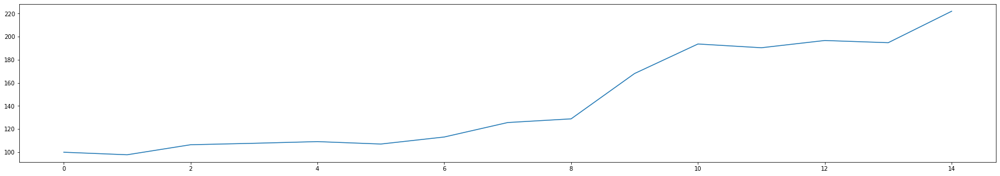

profit: 13.681626419078142
max loss: -4.515262758833103
max profit: 7.920648566161475
transaction count: 32
loss count: 16
profit count: 16
profit percentage: 13.681626419078142
Hodl strategy expected return of STRATUSDT: 28.24267782426778


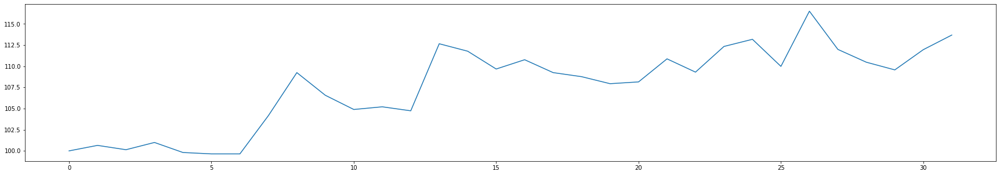

profit: 48.428491983135956
max loss: -3.0747248518684387
max profit: 9.295985950924688
transaction count: 20
loss count: 5
profit count: 15
profit percentage: 48.428491983135956
Hodl strategy expected return of TRXUSDT: 21.927066960075457


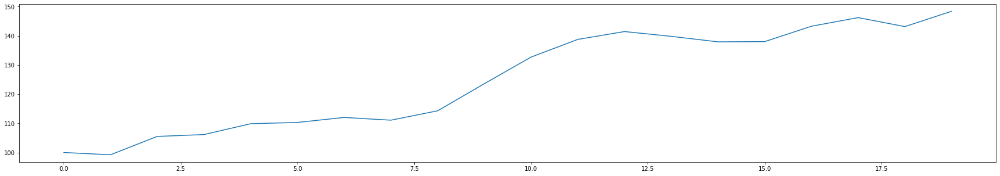

cumulative profit percentage: 324.0794212819669
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 160
cumulative profit count: 157
(profit count / loss count) ratio: 0.98125


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + psar & determine via sma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["sma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 9.670443275258336
max loss: -1.913323177129655
max profit: 6.7216659826335245
transaction count: 39
loss count: 24
profit count: 15
profit percentage: 9.670443275258336
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


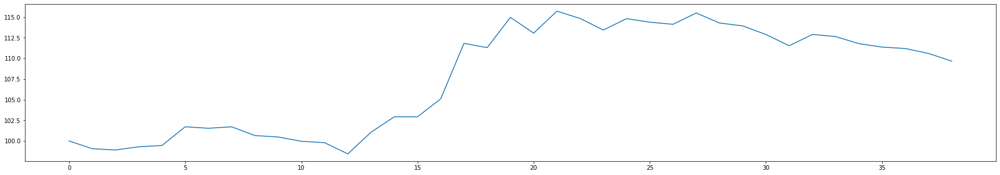

profit: 10.67533319472868
max loss: -2.5049285424762076
max profit: 11.36361517448421
transaction count: 22
loss count: 13
profit count: 9
profit percentage: 10.67533319472868
Hodl strategy expected return of APEUSDT: -57.663335972000255


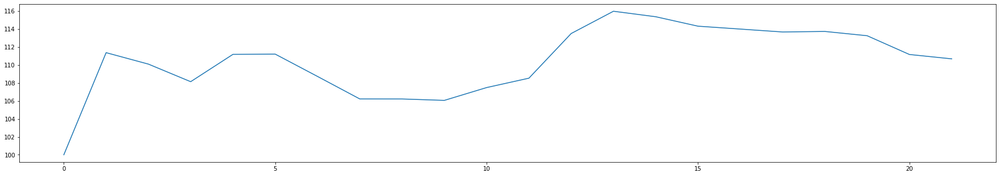

profit: 18.83054451153646
max loss: -7.2878354010060775
max profit: 18.301419281106334
transaction count: 33
loss count: 20
profit count: 13
profit percentage: 18.83054451153646
Hodl strategy expected return of BEARUSDT: -32.7710843373494


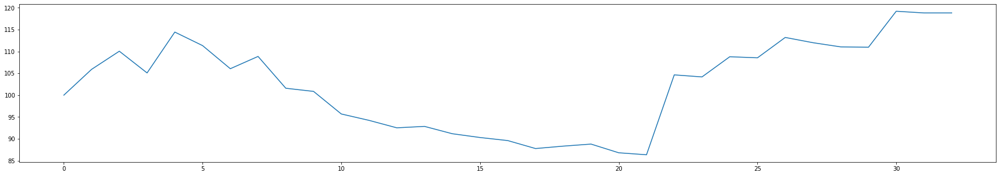

profit: 45.05331534248509
max loss: -4.80843419822186
max profit: 16.8872834177684
transaction count: 32
loss count: 15
profit count: 17
profit percentage: 45.05331534248509
Hodl strategy expected return of BULLUSDT: 5.791070587599496


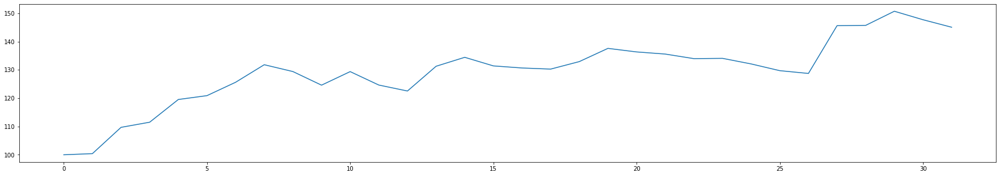

profit: 17.45029263881017
max loss: -2.678145126384223
max profit: 17.06685662755318
transaction count: 25
loss count: 11
profit count: 14
profit percentage: 17.45029263881017
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


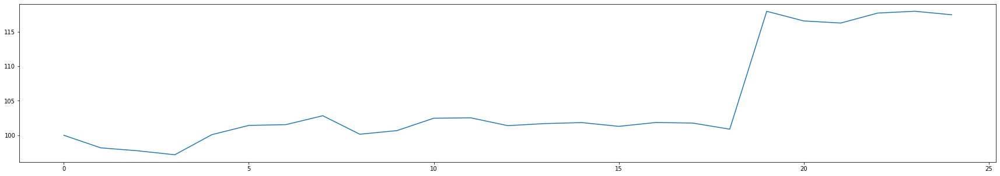

profit: 49.01970722341588
max loss: -5.14266240501685
max profit: 31.10605539129554
transaction count: 26
loss count: 6
profit count: 20
profit percentage: 49.01970722341588
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


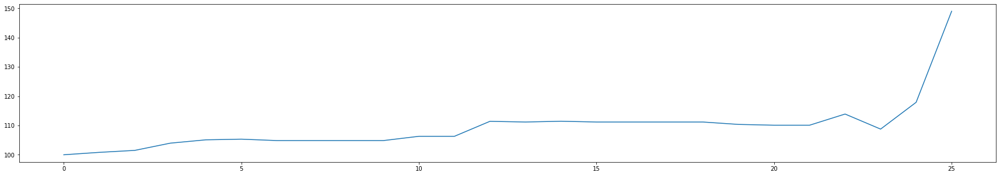

profit: 10.66252449440087
max loss: -1.2914118950939582
max profit: 5.197251519013534
transaction count: 24
loss count: 11
profit count: 13
profit percentage: 10.66252449440087
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


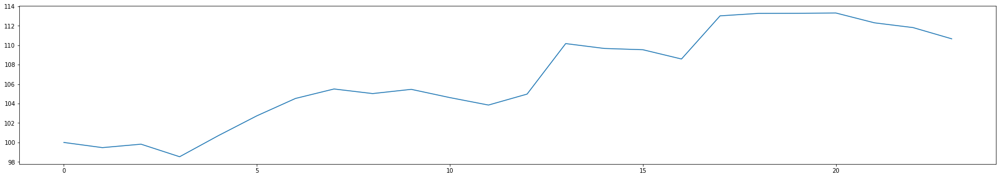

profit: 22.86770689000363
max loss: -2.0932890985700254
max profit: 12.170826906780363
transaction count: 35
loss count: 16
profit count: 19
profit percentage: 22.86770689000363
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


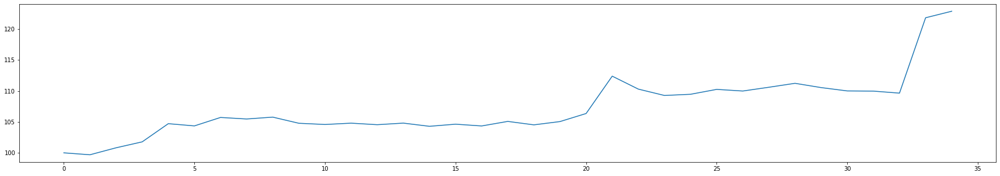

profit: 31.260209944251784
max loss: -3.1107626131385473
max profit: 26.70792776677112
transaction count: 33
loss count: 20
profit count: 13
profit percentage: 31.260209944251784
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


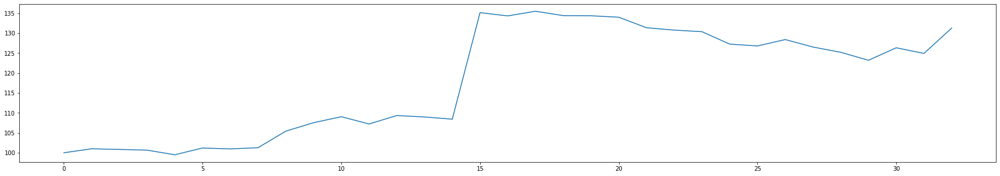

profit: 14.468988817878724
max loss: -2.145027169146573
max profit: 14.733085269778783
transaction count: 21
loss count: 13
profit count: 8
profit percentage: 14.468988817878724
Hodl strategy expected return of MOBUSDT: -45.26532479414456


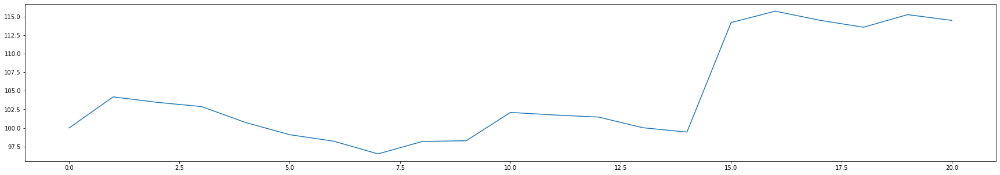

profit: 11.035042364265621
max loss: -1.470544564074217
max profit: 6.377199396296774
transaction count: 36
loss count: 20
profit count: 16
profit percentage: 11.035042364265621
Hodl strategy expected return of NUUSDT: -2.4582809976673325


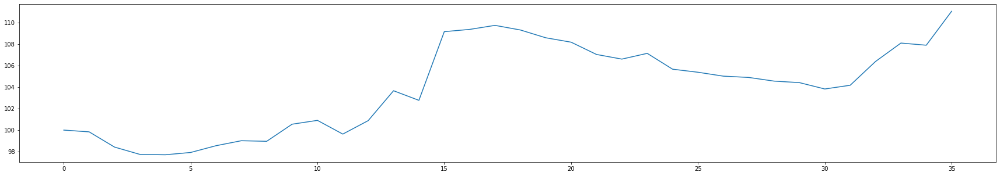

profit: 7.272804158944254
max loss: -1.3770366100224862
max profit: 5.370666551022765
transaction count: 19
loss count: 11
profit count: 8
profit percentage: 7.272804158944255
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


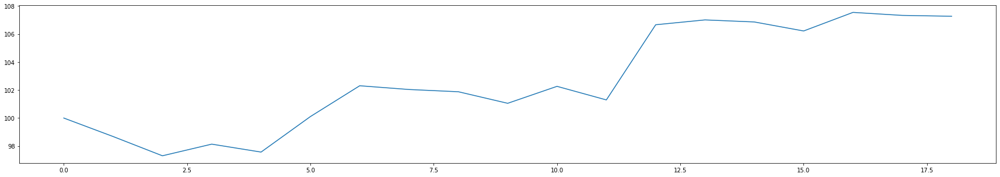

profit: 133.4676369680167
max loss: -6.091328992236441
max profit: 49.85939745045442
transaction count: 32
loss count: 16
profit count: 16
profit percentage: 133.4676369680167
Hodl strategy expected return of STORMUSDT: 81.46367521367522


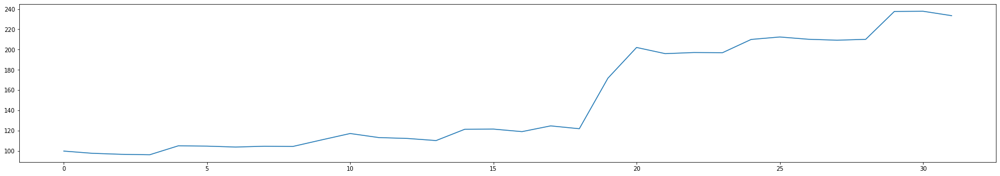

profit: 16.489206542785382
max loss: -3.4422065488573566
max profit: 7.559511280055133
transaction count: 39
loss count: 18
profit count: 21
profit percentage: 16.489206542785382
Hodl strategy expected return of STRATUSDT: 28.24267782426778


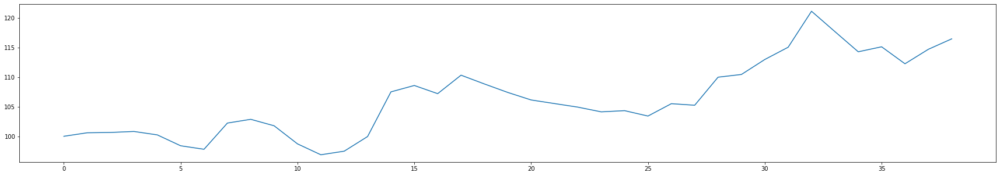

profit: 62.457630950268396
max loss: -3.7265111172724232
max profit: 16.45306374103339
transaction count: 32
loss count: 13
profit count: 19
profit percentage: 62.457630950268396
Hodl strategy expected return of TRXUSDT: 21.927066960075457


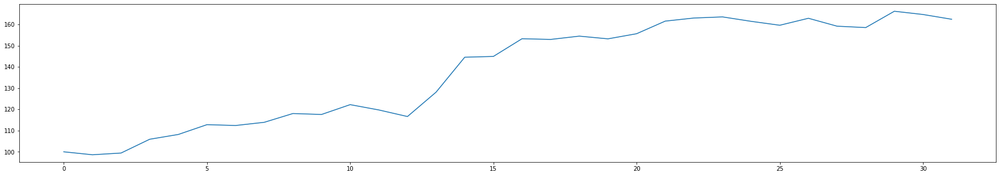

cumulative profit percentage: 460.68138731704994
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 227
cumulative profit count: 221
(profit count / loss count) ratio: 0.973568281938326


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + macd & determine via sma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["sma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 1.9293867894011214
max loss: -1.883707115907896
max profit: 6.632040828982326
transaction count: 37
loss count: 24
profit count: 13
profit percentage: 1.9293867894011214
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


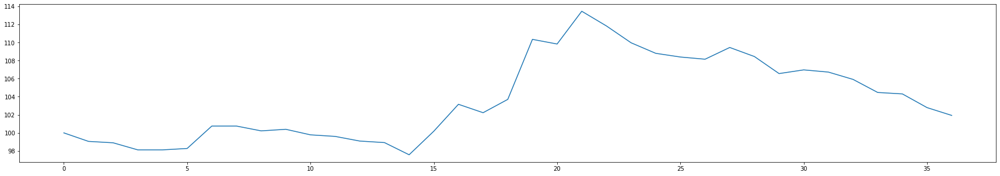

profit: 4.005625447335376
max loss: -2.214588027229354
max profit: 5.448310716959099
transaction count: 23
loss count: 12
profit count: 11
profit percentage: 4.005625447335376
Hodl strategy expected return of APEUSDT: -57.663335972000255


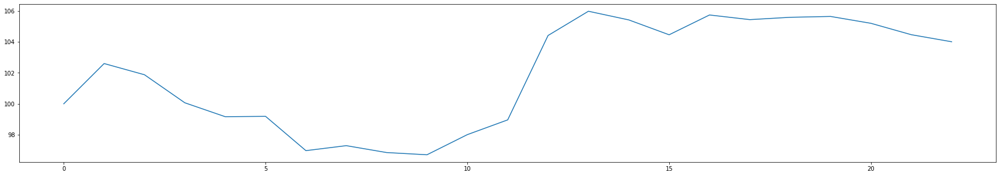

profit: 10.456131646225202
max loss: -6.957257593030775
max profit: 17.35894572525592
transaction count: 32
loss count: 21
profit count: 11
profit percentage: 10.456131646225204
Hodl strategy expected return of BEARUSDT: -32.7710843373494


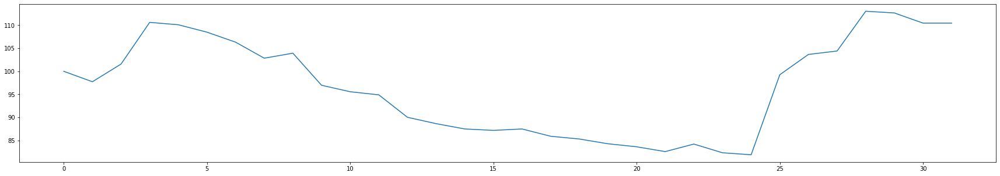

profit: 19.0303721423478
max loss: -4.093984609400451
max profit: 13.873201438272943
transaction count: 34
loss count: 21
profit count: 13
profit percentage: 19.0303721423478
Hodl strategy expected return of BULLUSDT: 5.791070587599496


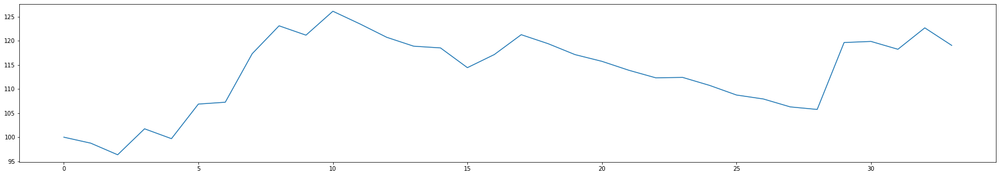

profit: 12.208542645771843
max loss: -2.761003956185675
max profit: 17.171071842637417
transaction count: 25
loss count: 14
profit count: 11
profit percentage: 12.208542645771843
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


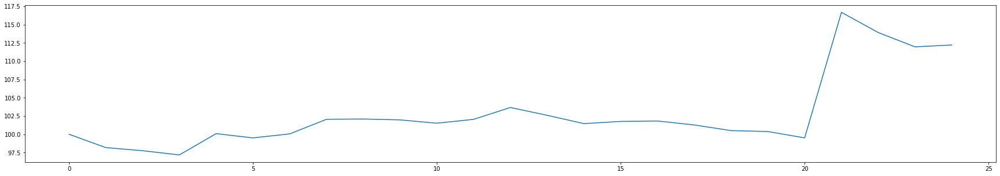

profit: 39.30406708657051
max loss: -5.1248987891380295
max profit: 30.14779384784208
transaction count: 34
loss count: 16
profit count: 18
profit percentage: 39.30406708657051
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


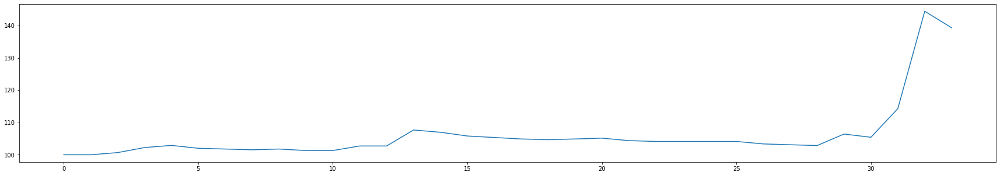

profit: 6.425834133008394
max loss: -2.123217469485766
max profit: 5.0923618357818725
transaction count: 25
loss count: 12
profit count: 13
profit percentage: 6.425834133008393
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


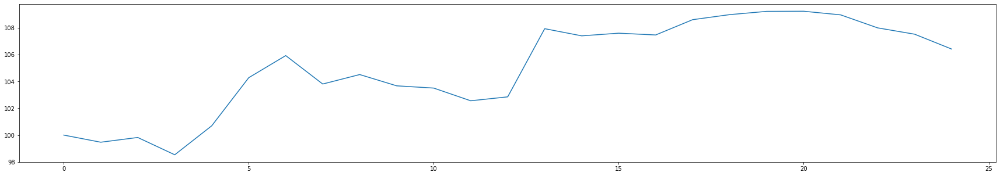

profit: -0.49944316994248084
max loss: -3.457254933766805
max profit: 5.459591410039607
transaction count: 39
loss count: 26
profit count: 13
profit percentage: -0.49944316994248084
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


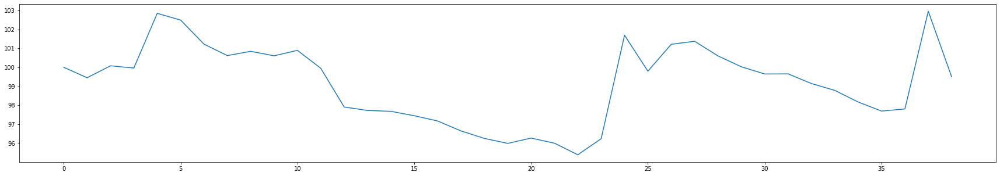

profit: 16.299224411407806
max loss: -3.322403224339496
max profit: 25.833957113297075
transaction count: 35
loss count: 22
profit count: 13
profit percentage: 16.299224411407806
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


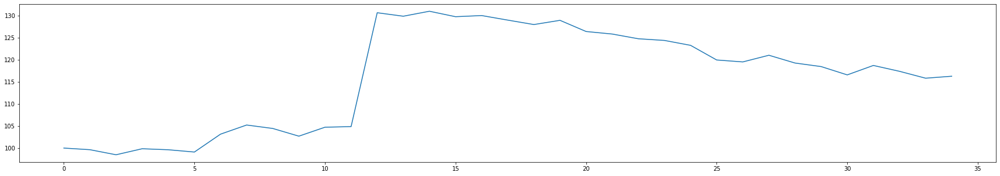

profit: 11.518370942692158
max loss: -2.6466124048785957
max profit: 16.568841345056498
transaction count: 23
loss count: 15
profit count: 8
profit percentage: 11.518370942692158
Hodl strategy expected return of MOBUSDT: -45.26532479414456


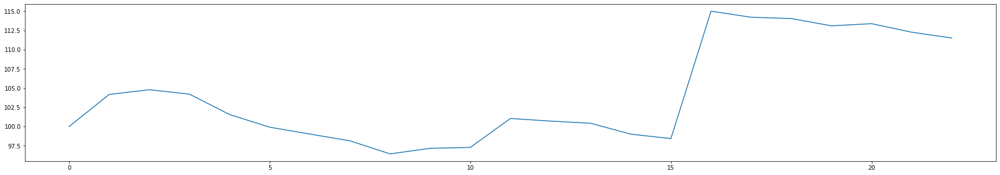

profit: 8.742862098054772
max loss: -1.4703996666879107
max profit: 6.335551854590875
transaction count: 33
loss count: 19
profit count: 14
profit percentage: 8.742862098054772
Hodl strategy expected return of NUUSDT: -2.4582809976673325


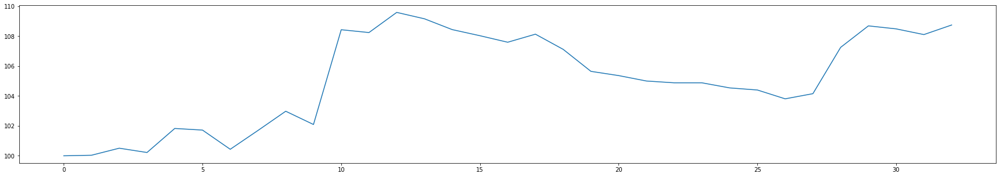

profit: 5.344506141023359
max loss: -1.3770366100224862
max profit: 5.31947952757487
transaction count: 20
loss count: 11
profit count: 9
profit percentage: 5.34450614102336
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


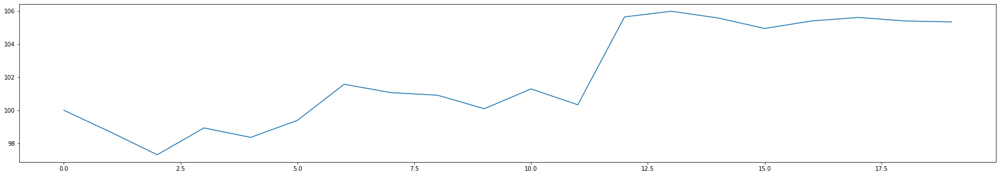

profit: 105.67345084761948
max loss: -3.9560038509041107
max profit: 33.514062025644805
transaction count: 33
loss count: 17
profit count: 16
profit percentage: 105.67345084761948
Hodl strategy expected return of STORMUSDT: 81.46367521367522


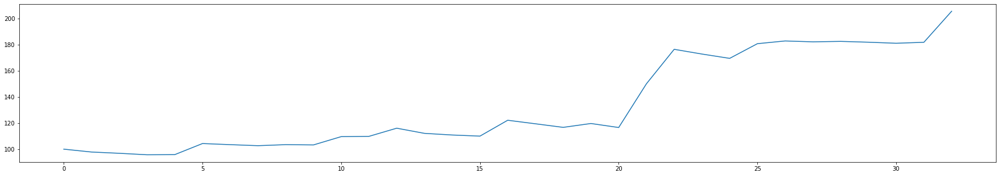

profit: 19.306235359946314
max loss: -4.14431316870342
max profit: 10.724645892550896
transaction count: 43
loss count: 26
profit count: 17
profit percentage: 19.306235359946314
Hodl strategy expected return of STRATUSDT: 28.24267782426778


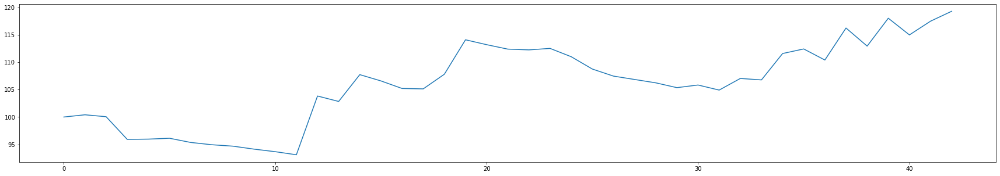

profit: 48.70226231452227
max loss: -3.8259694955245322
max profit: 16.17234948090153
transaction count: 28
loss count: 12
profit count: 16
profit percentage: 48.702262314522265
Hodl strategy expected return of TRXUSDT: 21.927066960075457


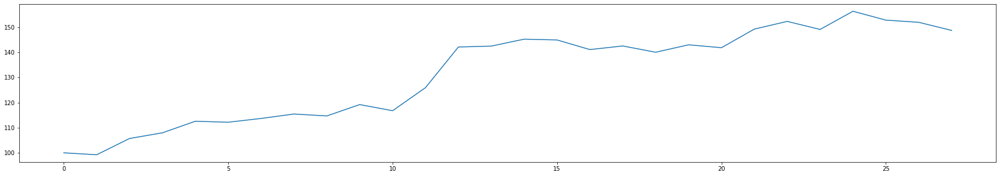

cumulative profit percentage: 308.44742883598394
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 268
cumulative profit count: 196
(profit count / loss count) ratio: 0.7313432835820896


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + psar & determine via sma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["sma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 16.820224720970174
max loss: -2.4186577216076586
max profit: 8.62080400746595
transaction count: 40
loss count: 21
profit count: 19
profit percentage: 16.820224720970174
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


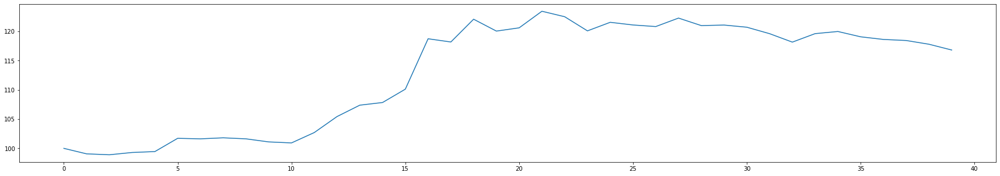

profit: 10.272712456530286
max loss: -2.5125359102770517
max profit: 11.36361517448421
transaction count: 26
loss count: 16
profit count: 10
profit percentage: 10.272712456530284
Hodl strategy expected return of APEUSDT: -57.663335972000255


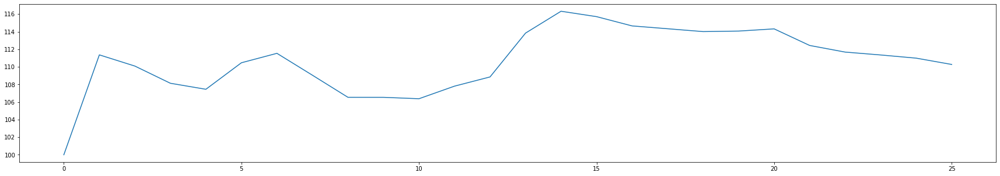

profit: 18.495505279334353
max loss: -7.258384435634412
max profit: 18.222782197807675
transaction count: 35
loss count: 21
profit count: 14
profit percentage: 18.495505279334353
Hodl strategy expected return of BEARUSDT: -32.7710843373494


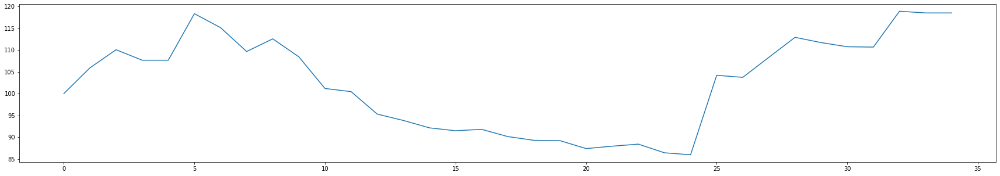

profit: 53.50490929905385
max loss: -5.217732125467734
max profit: 19.532811861298484
transaction count: 35
loss count: 17
profit count: 18
profit percentage: 53.50490929905385
Hodl strategy expected return of BULLUSDT: 5.791070587599496


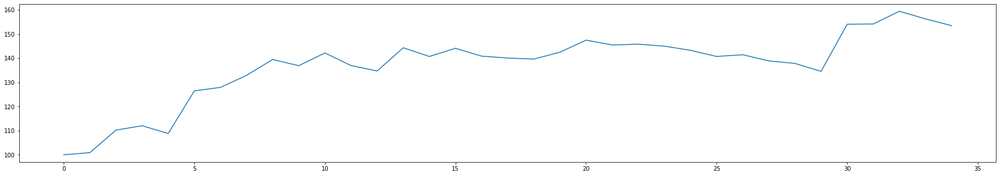

profit: 20.362567591515614
max loss: -2.6932103134007264
max profit: 17.392990787379006
transaction count: 24
loss count: 9
profit count: 15
profit percentage: 20.362567591515614
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


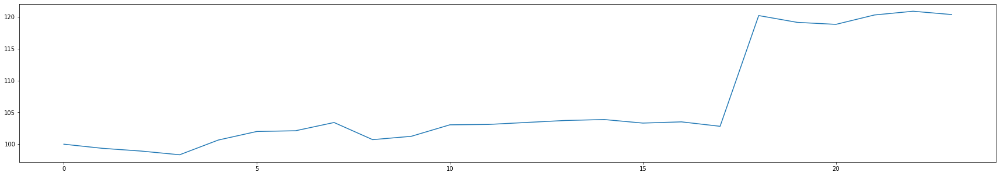

profit: 45.46978413753715
max loss: -5.020154742543198
max profit: 30.3650520287092
transaction count: 31
loss count: 9
profit count: 22
profit percentage: 45.46978413753715
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


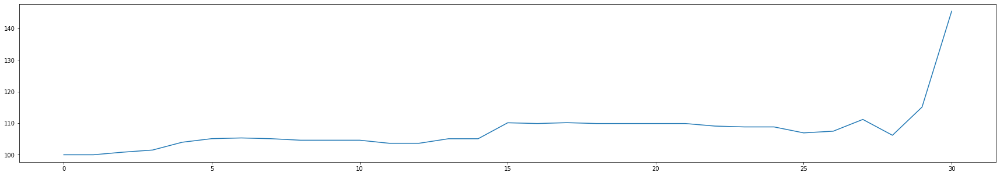

profit: 8.001824643491304
max loss: -1.5274963124342804
max profit: 5.156970290002164
transaction count: 27
loss count: 14
profit count: 13
profit percentage: 8.001824643491304
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


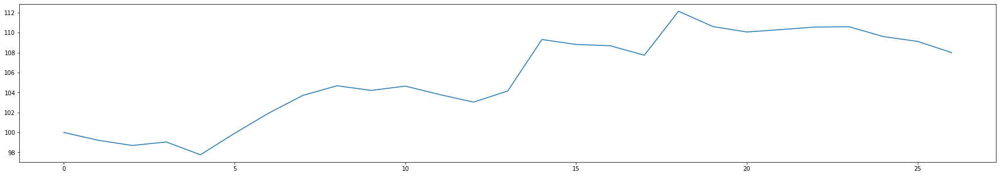

profit: 23.624636529639034
max loss: -2.0848733522565652
max profit: 12.245805596118657
transaction count: 38
loss count: 17
profit count: 21
profit percentage: 23.624636529639034
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


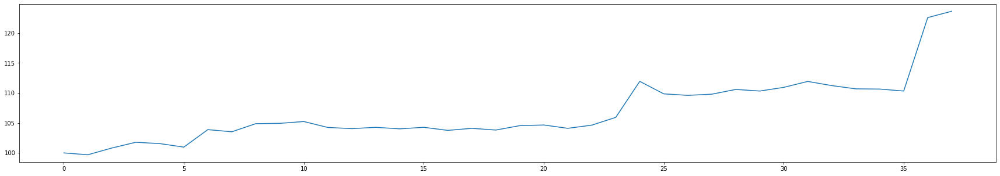

profit: 29.772895968515826
max loss: -3.7104269135733006
max profit: 26.28407650286678
transaction count: 35
loss count: 21
profit count: 14
profit percentage: 29.772895968515826
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


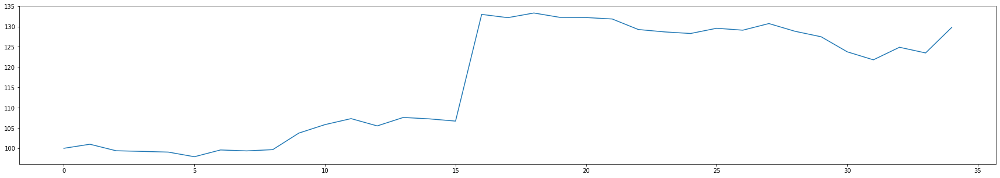

profit: 12.820214214662627
max loss: -2.100119827005173
max profit: 14.520874634647924
transaction count: 25
loss count: 16
profit count: 9
profit percentage: 12.820214214662629
Hodl strategy expected return of MOBUSDT: -45.26532479414456


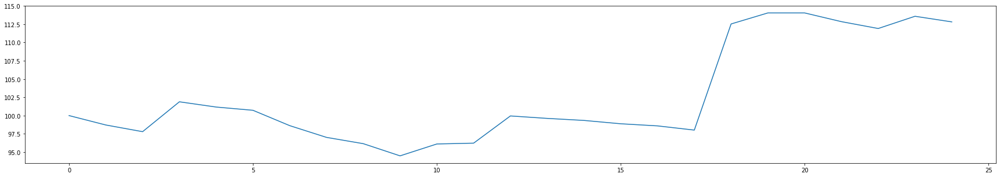

profit: 14.04652957473877
max loss: -1.4988798101261125
max profit: 6.409935552438782
transaction count: 34
loss count: 16
profit count: 18
profit percentage: 14.04652957473877
Hodl strategy expected return of NUUSDT: -2.4582809976673325


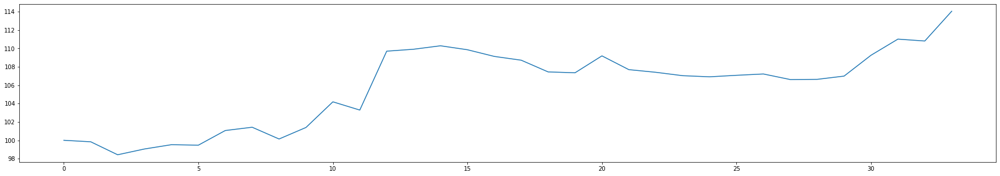

profit: 8.471668147015507
max loss: -1.3210368893319924
max profit: 5.484077119535442
transaction count: 23
loss count: 13
profit count: 10
profit percentage: 8.471668147015507
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


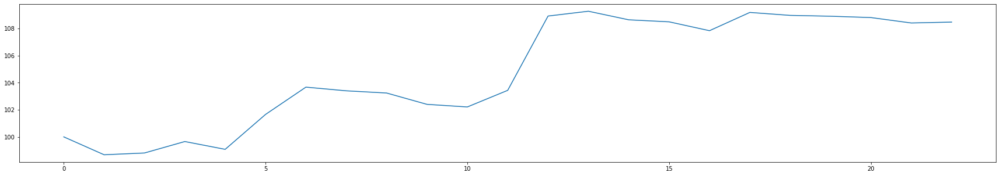

profit: 130.09885276335945
max loss: -5.986879533100904
max profit: 49.004446568116435
transaction count: 31
loss count: 15
profit count: 16
profit percentage: 130.09885276335945
Hodl strategy expected return of STORMUSDT: 81.46367521367522


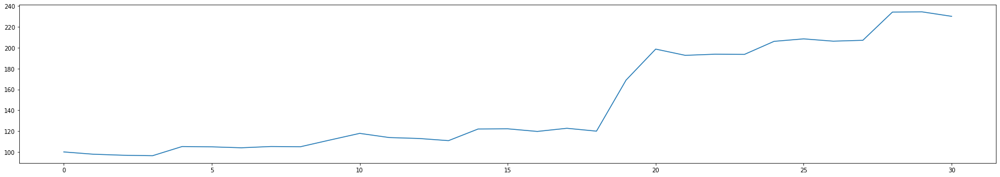

profit: 23.595807884572466
max loss: -4.618941768359591
max profit: 8.10042886588596
transaction count: 39
loss count: 18
profit count: 21
profit percentage: 23.595807884572466
Hodl strategy expected return of STRATUSDT: 28.24267782426778


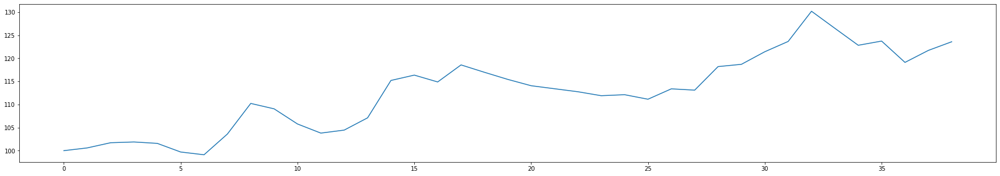

profit: 72.14806321681337
max loss: -2.598561510988546
max profit: 17.440408872178807
transaction count: 32
loss count: 13
profit count: 19
profit percentage: 72.14806321681337
Hodl strategy expected return of TRXUSDT: 21.927066960075457


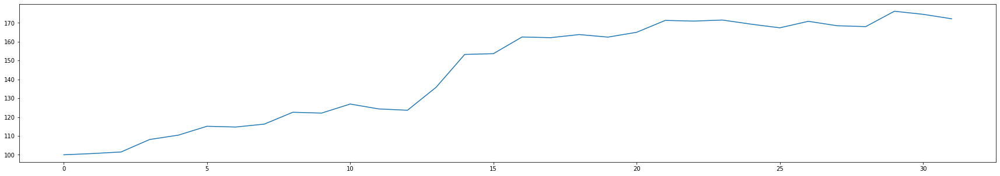

cumulative profit percentage: 487.50619642774984
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 236
cumulative profit count: 239
(profit count / loss count) ratio: 1.0127118644067796


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + macd & determine via sma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["sma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 3.8026936135619422
max loss: -1.9081151571234471
max profit: 8.113918060044611
transaction count: 37
loss count: 22
profit count: 15
profit percentage: 3.8026936135619422
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


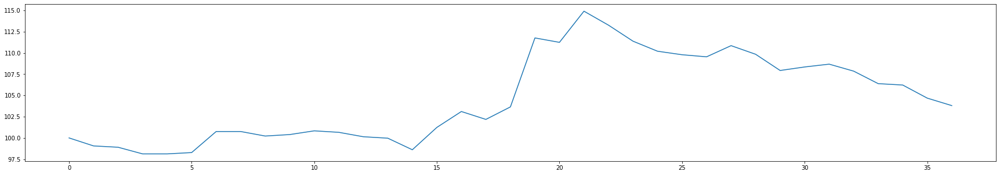

profit: -0.08811564882815048
max loss: -2.2213136424973356
max profit: 2.803794842224221
transaction count: 27
loss count: 15
profit count: 12
profit percentage: -0.08811564882815048
Hodl strategy expected return of APEUSDT: -57.663335972000255


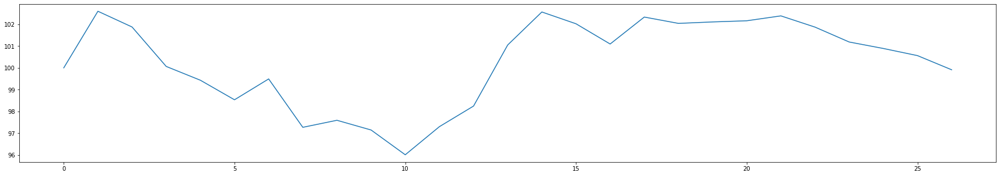

profit: 10.427777598604322
max loss: -6.957257593030775
max profit: 17.354489690390267
transaction count: 33
loss count: 22
profit count: 11
profit percentage: 10.427777598604322
Hodl strategy expected return of BEARUSDT: -32.7710843373494


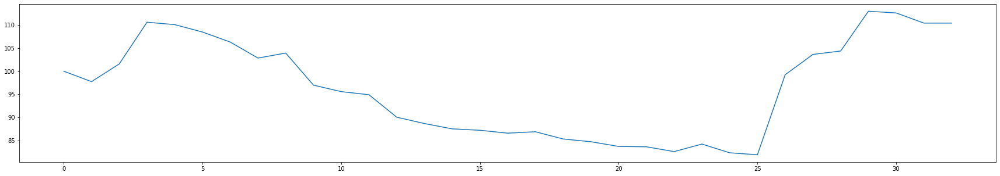

profit: 37.72010021819196
max loss: -4.206450887099123
max profit: 17.207889205708426
transaction count: 31
loss count: 18
profit count: 13
profit percentage: 37.72010021819196
Hodl strategy expected return of BULLUSDT: 5.791070587599496


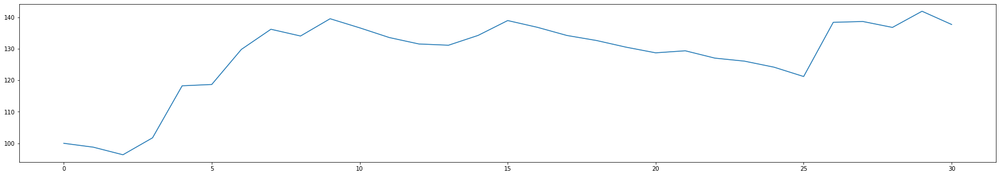

profit: 12.743456401826535
max loss: -2.2589839056196155
max profit: 16.84466041937911
transaction count: 24
loss count: 13
profit count: 11
profit percentage: 12.743456401826533
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


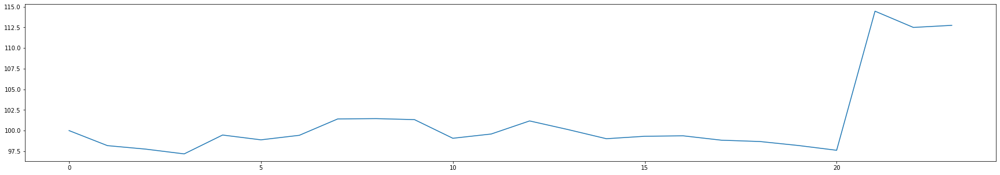

profit: 37.88517811069059
max loss: -5.072698860259521
max profit: 29.84072189199445
transaction count: 39
loss count: 19
profit count: 20
profit percentage: 37.88517811069059
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


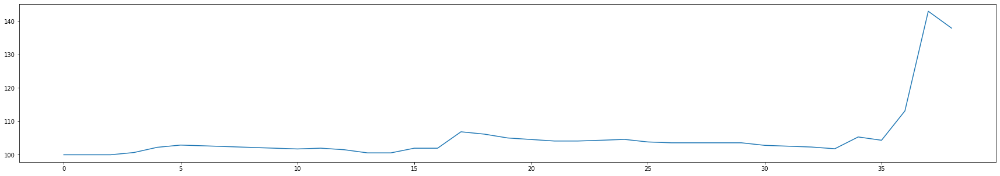

profit: 4.059329727066469
max loss: -2.1067615006306113
max profit: 5.062250025842516
transaction count: 28
loss count: 15
profit count: 13
profit percentage: 4.059329727066469
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


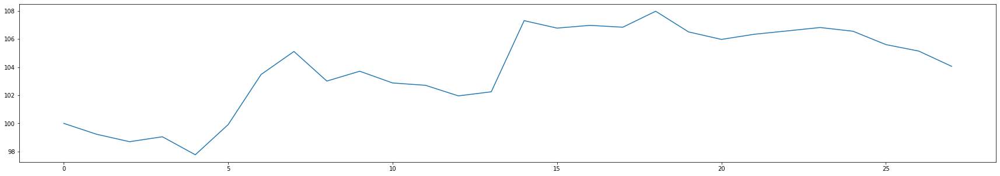

profit: 0.5265891627627326
max loss: -3.4929055417378407
max profit: 5.516204865081946
transaction count: 39
loss count: 25
profit count: 14
profit percentage: 0.5265891627627326
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


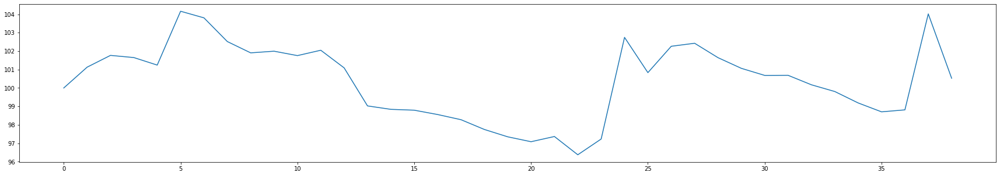

profit: 22.722927522103078
max loss: -2.5317964733494165
max profit: 25.833957113297075
transaction count: 32
loss count: 19
profit count: 13
profit percentage: 22.722927522103078
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


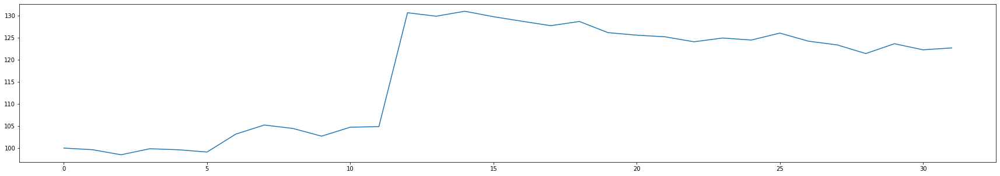

profit: 8.8873206624191
max loss: -2.5890631943999836
max profit: 16.177933064239582
transaction count: 27
loss count: 19
profit count: 8
profit percentage: 8.8873206624191
Hodl strategy expected return of MOBUSDT: -45.26532479414456


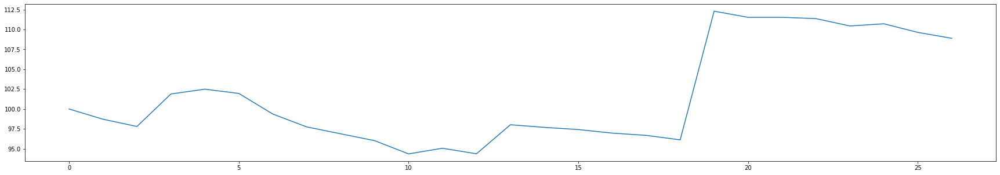

profit: 10.312686484141238
max loss: -1.4928738600531943
max profit: 6.335551854590875
transaction count: 34
loss count: 18
profit count: 16
profit percentage: 10.312686484141238
Hodl strategy expected return of NUUSDT: -2.4582809976673325


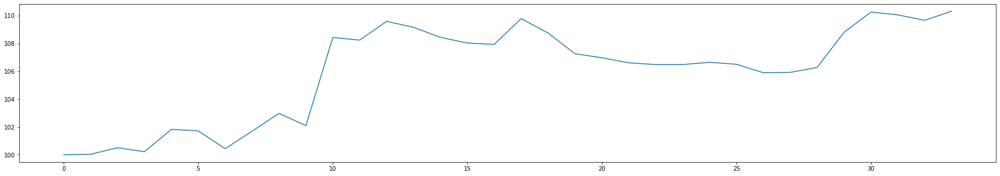

profit: 7.193685890940927
max loss: -1.3210368893319924
max profit: 5.442013884006073
transaction count: 20
loss count: 10
profit count: 10
profit percentage: 7.193685890940926
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


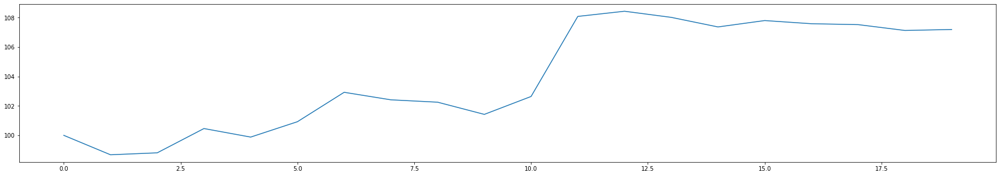

profit: 110.61556434929017
max loss: -3.9560038509041107
max profit: 33.514062025644805
transaction count: 32
loss count: 16
profit count: 16
profit percentage: 110.61556434929017
Hodl strategy expected return of STORMUSDT: 81.46367521367522


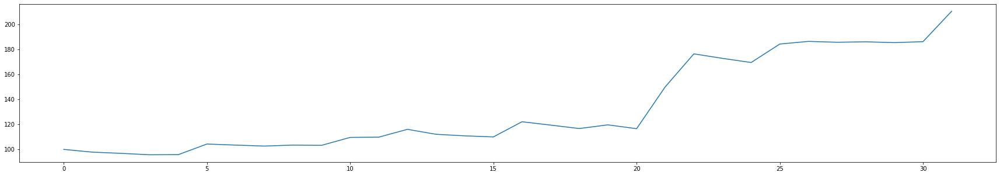

profit: 23.11975483028506
max loss: -4.14431316870342
max profit: 10.918003817875245
transaction count: 40
loss count: 22
profit count: 18
profit percentage: 23.11975483028506
Hodl strategy expected return of STRATUSDT: 28.24267782426778


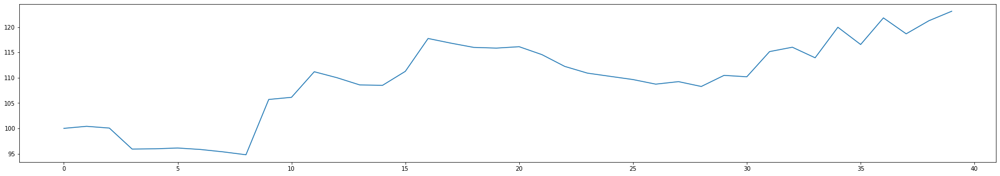

profit: 51.31917709013277
max loss: -3.8259694955245322
max profit: 16.17234948090153
transaction count: 28
loss count: 12
profit count: 16
profit percentage: 51.31917709013277
Hodl strategy expected return of TRXUSDT: 21.927066960075457


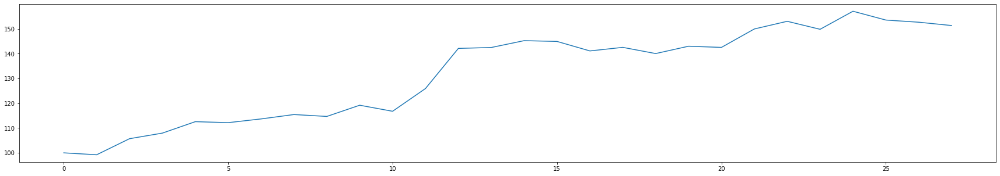

cumulative profit percentage: 341.2481260131887
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 265
cumulative profit count: 206
(profit count / loss count) ratio: 0.7773584905660378


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + psar & determine via sma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["sma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 9.785998337857492
max loss: -2.9679141465482104
max profit: 7.032277246628553
transaction count: 39
loss count: 22
profit count: 17
profit percentage: 9.785998337857492
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


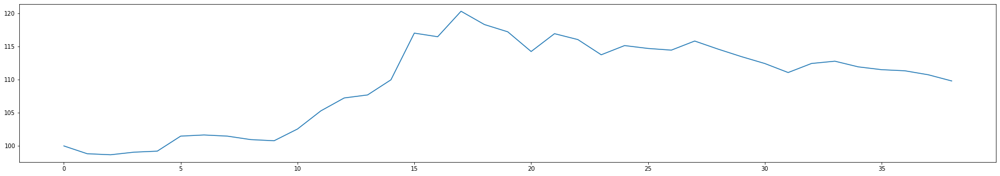

profit: 13.029464859080093
max loss: -2.5363493325817217
max profit: 11.36361517448421
transaction count: 17
loss count: 10
profit count: 7
profit percentage: 13.029464859080095
Hodl strategy expected return of APEUSDT: -57.663335972000255


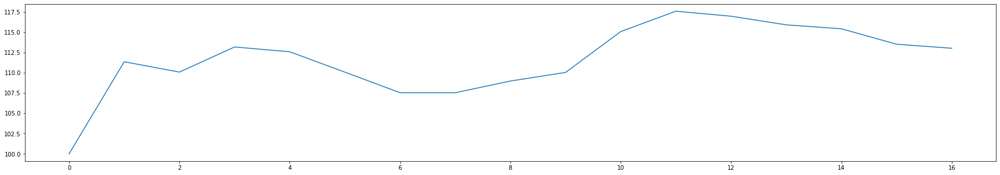

profit: 21.036642140390143
max loss: -7.465698718051911
max profit: 18.878837204124252
transaction count: 32
loss count: 20
profit count: 12
profit percentage: 21.03664214039014
Hodl strategy expected return of BEARUSDT: -32.7710843373494


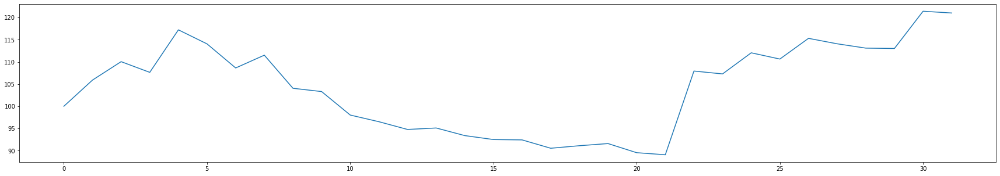

profit: 42.44105803771603
max loss: -4.665201996286839
max profit: 16.598611431885203
transaction count: 30
loss count: 14
profit count: 16
profit percentage: 42.44105803771603
Hodl strategy expected return of BULLUSDT: 5.791070587599496


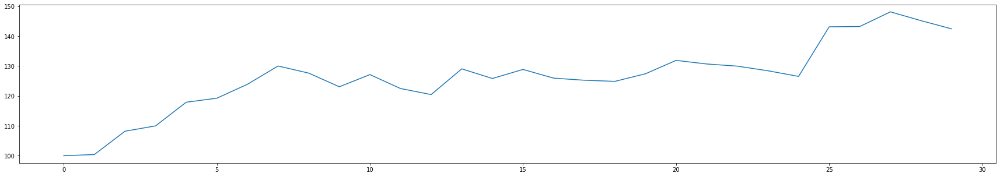

profit: 21.459608100117975
max loss: -2.728093932358803
max profit: 17.551518607458902
transaction count: 22
loss count: 7
profit count: 15
profit percentage: 21.459608100117975
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


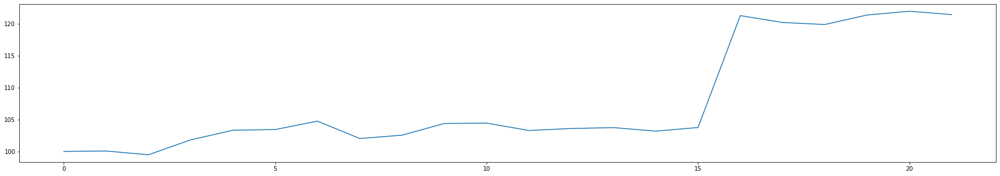

profit: 46.292040620730745
max loss: -5.0485307713395855
max profit: 30.53668809073507
transaction count: 25
loss count: 6
profit count: 19
profit percentage: 46.29204062073075
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


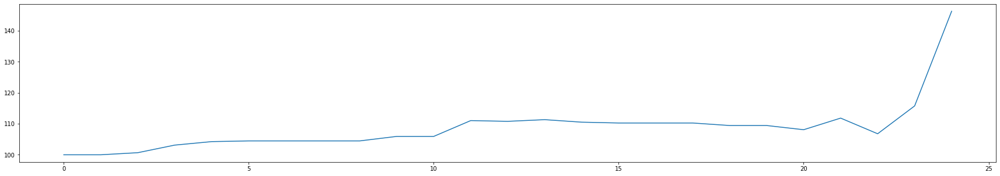

profit: 14.399374948681938
max loss: -1.192953421585372
max profit: 5.325132721978321
transaction count: 21
loss count: 8
profit count: 13
profit percentage: 14.399374948681938
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


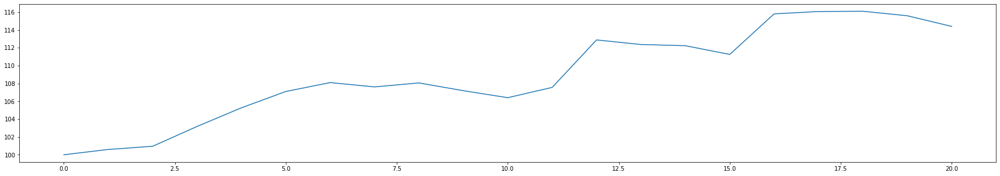

profit: 24.86861751633677
max loss: -2.1057322334697517
max profit: 12.369029815465225
transaction count: 35
loss count: 14
profit count: 21
profit percentage: 24.868617516336773
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


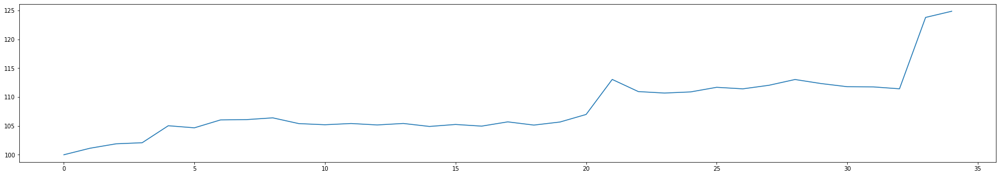

profit: 32.26958663529527
max loss: -3.0488656391016917
max profit: 26.28407650286678
transaction count: 34
loss count: 20
profit count: 14
profit percentage: 32.26958663529527
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


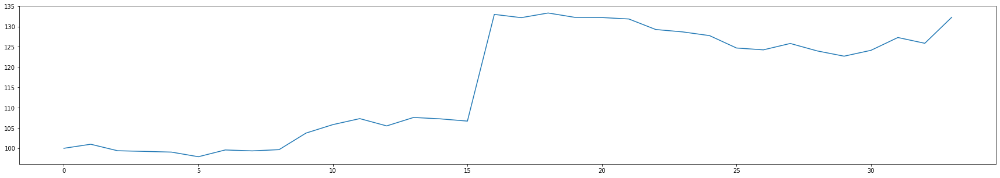

profit: 11.340282551824203
max loss: -2.4612062458824226
max profit: 14.647172615038542
transaction count: 21
loss count: 14
profit count: 7
profit percentage: 11.340282551824203
Hodl strategy expected return of MOBUSDT: -45.26532479414456


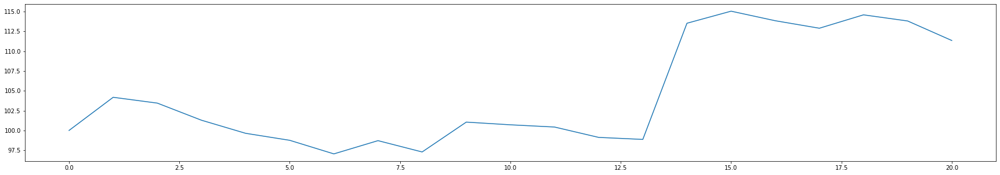

profit: 7.800943633366529
max loss: -1.439365835883919
max profit: 6.2961185306930645
transaction count: 40
loss count: 22
profit count: 18
profit percentage: 7.800943633366529
Hodl strategy expected return of NUUSDT: -2.4582809976673325


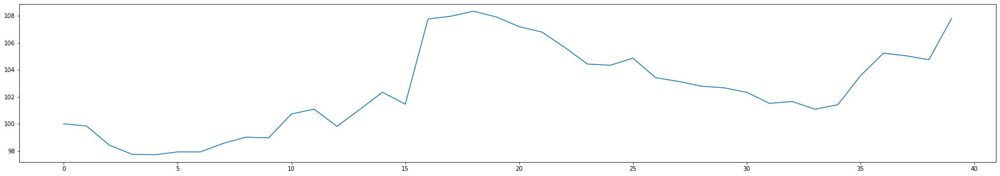

profit: 8.53581998217858
max loss: -1.3770366100224862
max profit: 5.393753457791405
transaction count: 18
loss count: 10
profit count: 8
profit percentage: 8.53581998217858
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


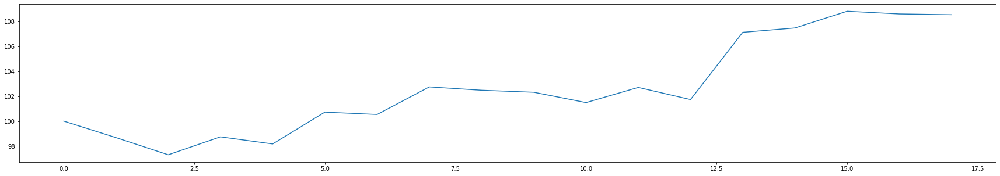

profit: 130.64792985591217
max loss: -6.152857567915589
max profit: 50.36302772773175
transaction count: 32
loss count: 16
profit count: 16
profit percentage: 130.64792985591217
Hodl strategy expected return of STORMUSDT: 81.46367521367522


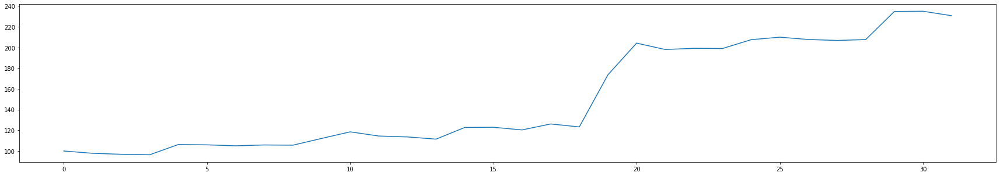

profit: 26.69523644059059
max loss: -3.650372562910931
max profit: 7.993614255155691
transaction count: 38
loss count: 17
profit count: 21
profit percentage: 26.69523644059059
Hodl strategy expected return of STRATUSDT: 28.24267782426778


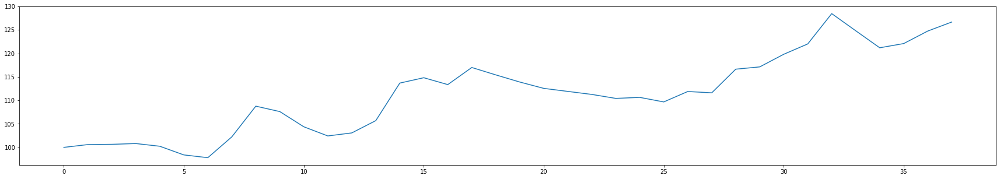

profit: 57.422712586799605
max loss: -2.755614780882752
max profit: 16.795883835763334
transaction count: 32
loss count: 14
profit count: 18
profit percentage: 57.422712586799605
Hodl strategy expected return of TRXUSDT: 21.927066960075457


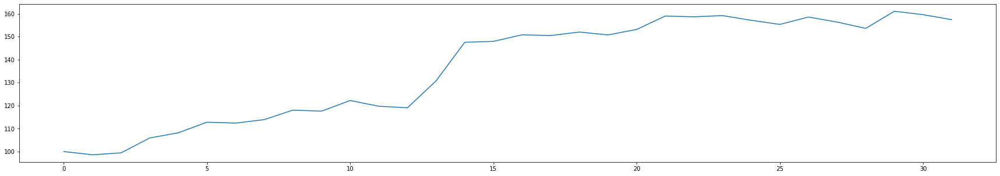

cumulative profit percentage: 468.0253162468781
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 214
cumulative profit count: 222
(profit count / loss count) ratio: 1.0373831775700935


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + macd & determine via sma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["sma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 3.8558394624707404
max loss: -1.9090920913080112
max profit: 6.721414698133486
transaction count: 34
loss count: 21
profit count: 13
profit percentage: 3.8558394624707404
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


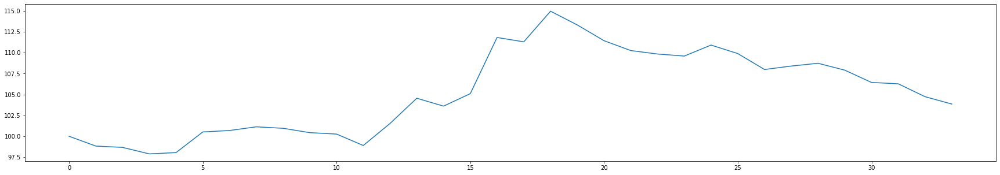

profit: 3.2854809008598522
max loss: -2.2423669057058504
max profit: 5.524824782831274
transaction count: 17
loss count: 10
profit count: 7
profit percentage: 3.2854809008598522
Hodl strategy expected return of APEUSDT: -57.663335972000255


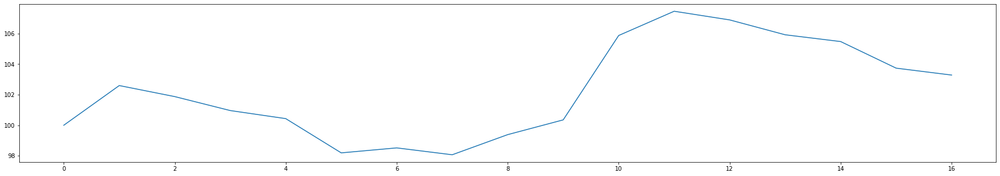

profit: 6.296225111360201
max loss: -6.552668872093136
max profit: 16.70518761618017
transaction count: 30
loss count: 21
profit count: 9
profit percentage: 6.296225111360201
Hodl strategy expected return of BEARUSDT: -32.7710843373494


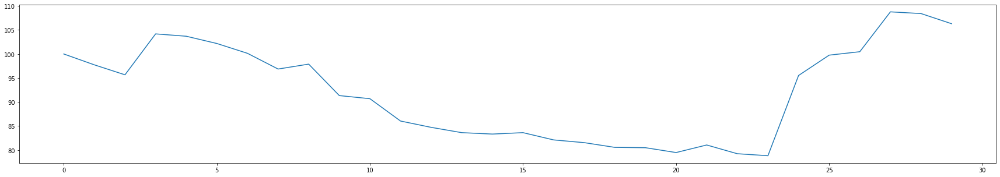

profit: 31.11898148111345
max loss: -4.004829760455749
max profit: 15.282150343050986
transaction count: 26
loss count: 14
profit count: 12
profit percentage: 31.11898148111345
Hodl strategy expected return of BULLUSDT: 5.791070587599496


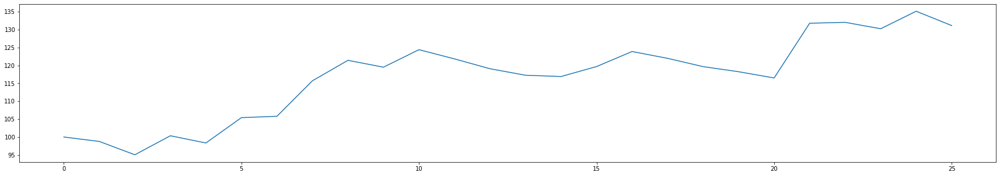

profit: 15.850026159667266
max loss: -2.8506063175672836
max profit: 17.430366543867592
transaction count: 22
loss count: 10
profit count: 12
profit percentage: 15.850026159667266
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


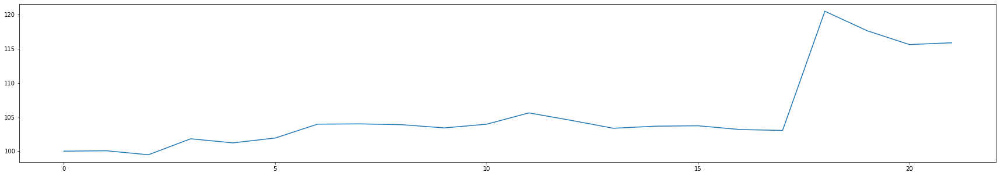

profit: 40.04127970193366
max loss: -5.152020323482503
max profit: 30.307339325693675
transaction count: 32
loss count: 14
profit count: 18
profit percentage: 40.04127970193366
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


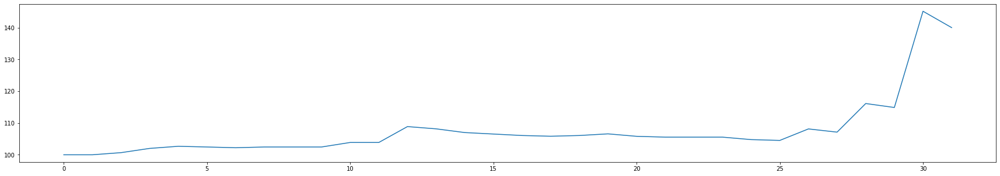

profit: 10.14476776823517
max loss: -2.175460391183975
max profit: 5.2273237469898675
transaction count: 21
loss count: 8
profit count: 13
profit percentage: 10.14476776823517
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


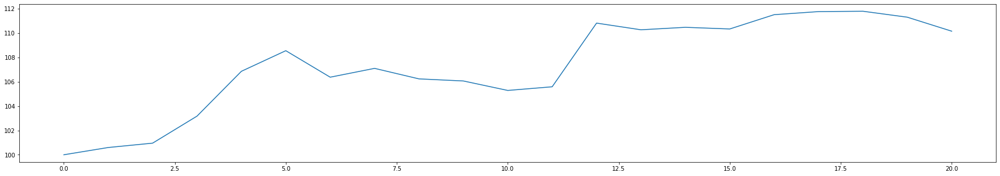

profit: 0.9892074244670397
max loss: -3.5089797157795033
max profit: 5.54127360616711
transaction count: 39
loss count: 25
profit count: 14
profit percentage: 0.9892074244670397
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


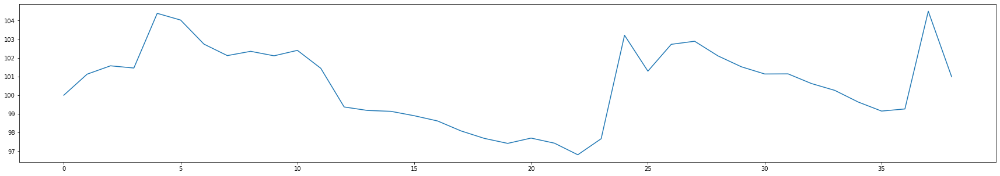

profit: 21.06840606719311
max loss: -3.3639602795204127
max profit: 25.833957113297075
transaction count: 34
loss count: 20
profit count: 14
profit percentage: 21.06840606719311
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


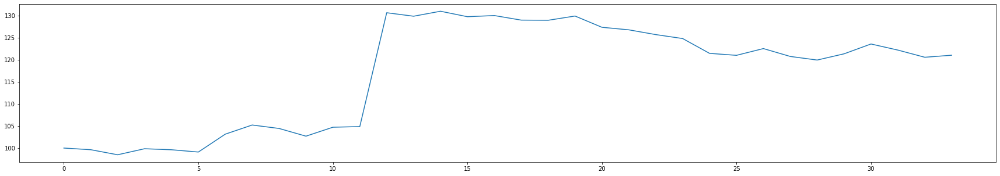

profit: 8.722162546830802
max loss: -2.1849772788024637
max profit: 16.549028009732154
transaction count: 23
loss count: 16
profit count: 7
profit percentage: 8.722162546830802
Hodl strategy expected return of MOBUSDT: -45.26532479414456


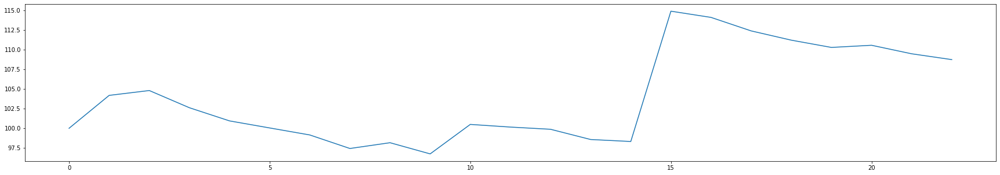

profit: 8.214349225118184
max loss: -1.4750536484006602
max profit: 6.335551854590875
transaction count: 34
loss count: 20
profit count: 14
profit percentage: 8.214349225118184
Hodl strategy expected return of NUUSDT: -2.4582809976673325


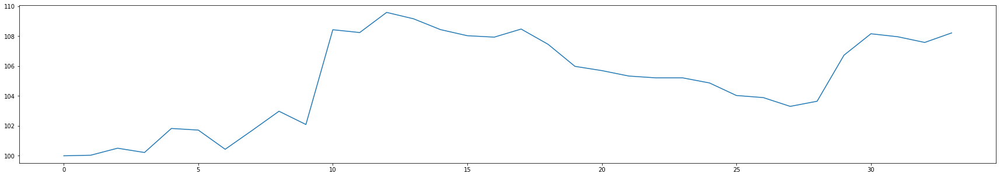

profit: 5.536388207978362
max loss: -1.3770366100224862
max profit: 5.29951625433003
transaction count: 19
loss count: 11
profit count: 8
profit percentage: 5.536388207978361
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


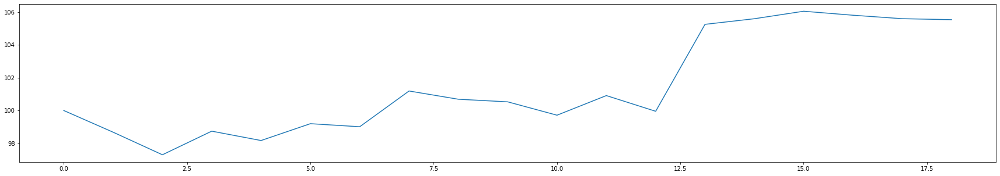

profit: 100.6489181795194
max loss: -3.9560038509041107
max profit: 33.514062025644805
transaction count: 33
loss count: 17
profit count: 16
profit percentage: 100.6489181795194
Hodl strategy expected return of STORMUSDT: 81.46367521367522


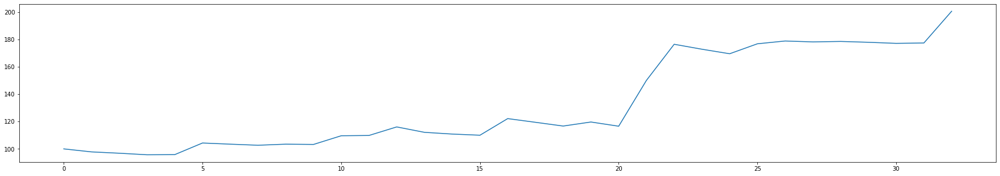

profit: 21.1257559045533
max loss: -4.14431316870342
max profit: 10.888205772520791
transaction count: 40
loss count: 23
profit count: 17
profit percentage: 21.1257559045533
Hodl strategy expected return of STRATUSDT: 28.24267782426778


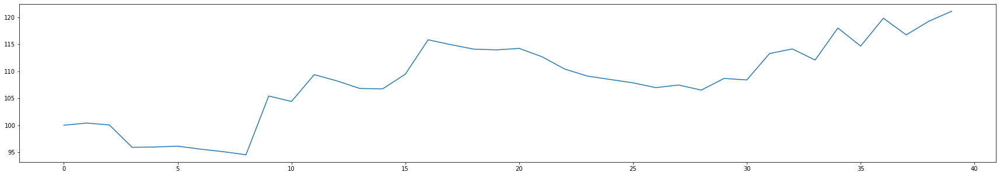

profit: 48.70226231452227
max loss: -3.8259694955245322
max profit: 16.17234948090153
transaction count: 28
loss count: 12
profit count: 16
profit percentage: 48.702262314522265
Hodl strategy expected return of TRXUSDT: 21.927066960075457


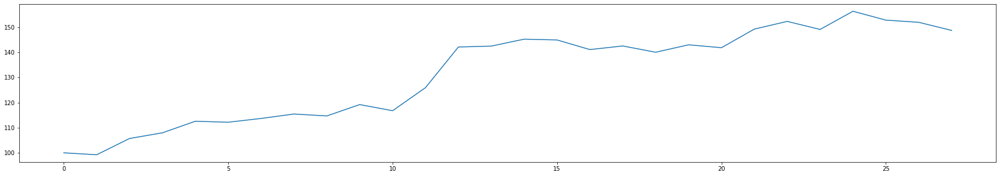

cumulative profit percentage: 325.6000504558228
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 242
cumulative profit count: 190
(profit count / loss count) ratio: 0.7851239669421488


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + psar & determine via wma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["wma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 4.987987073462193
max loss: -1.8830013656312872
max profit: 7.147847670581811
transaction count: 46
loss count: 31
profit count: 15
profit percentage: 4.987987073462193
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


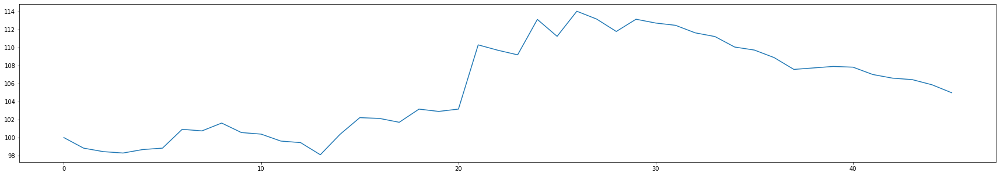

profit: 8.309873238056667
max loss: -2.450617769487451
max profit: 11.36361517448421
transaction count: 24
loss count: 15
profit count: 9
profit percentage: 8.309873238056667
Hodl strategy expected return of APEUSDT: -57.663335972000255


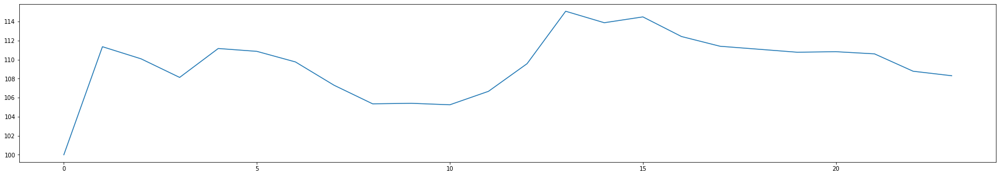

profit: 29.335192286126926
max loss: -5.3407706514639415
max profit: 20.138955778096914
transaction count: 41
loss count: 25
profit count: 16
profit percentage: 29.335192286126926
Hodl strategy expected return of BEARUSDT: -32.7710843373494


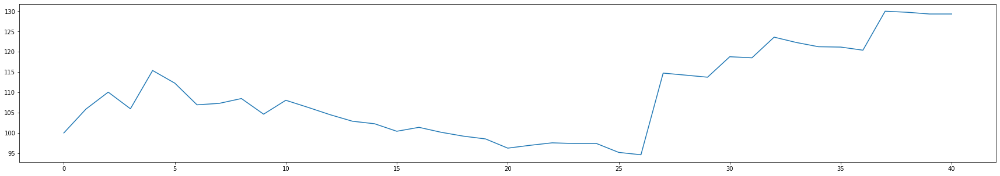

profit: 45.32425831253494
max loss: -5.186061411888801
max profit: 14.974254097277765
transaction count: 38
loss count: 17
profit count: 21
profit percentage: 45.32425831253494
Hodl strategy expected return of BULLUSDT: 5.791070587599496


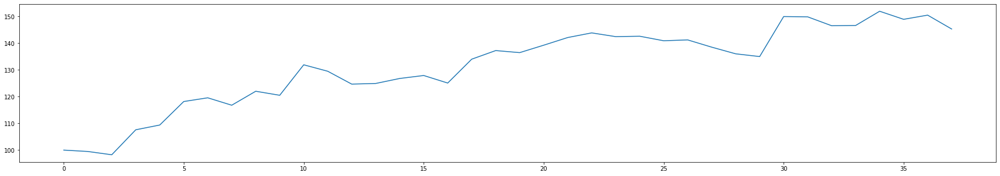

profit: 17.778050871733285
max loss: -2.6838553554653544
max profit: 18.545575286979698
transaction count: 31
loss count: 17
profit count: 14
profit percentage: 17.778050871733285
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


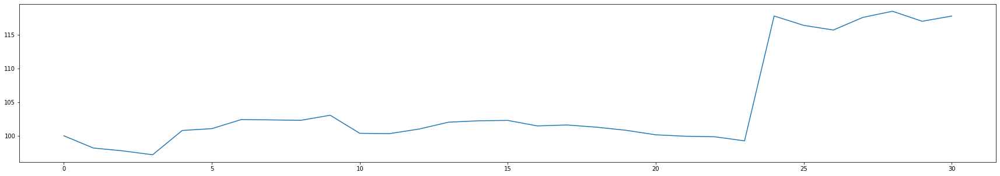

profit: 53.09875355342717
max loss: -5.215153810796906
max profit: 22.703446273301765
transaction count: 29
loss count: 8
profit count: 21
profit percentage: 53.09875355342718
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


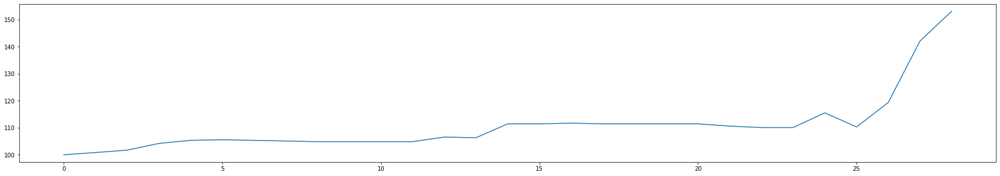

profit: 13.3911334609287
max loss: -1.3695745321864194
max profit: 4.572028355824486
transaction count: 27
loss count: 12
profit count: 15
profit percentage: 13.3911334609287
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


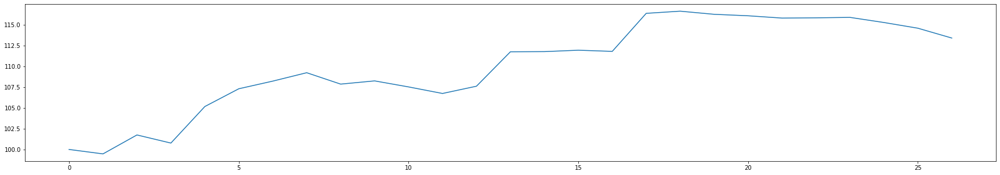

profit: 15.277924163213967
max loss: -2.4410077525017044
max profit: 6.043977920653347
transaction count: 46
loss count: 16
profit count: 30
profit percentage: 15.277924163213967
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


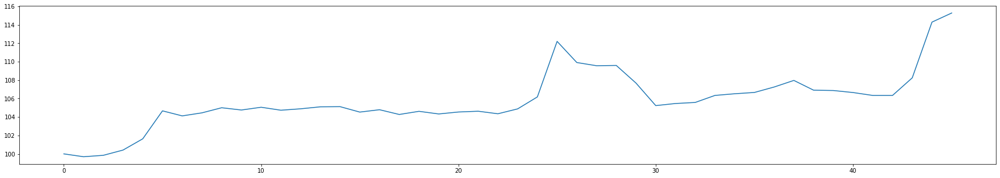

profit: 36.66185177744444
max loss: -3.262374607754623
max profit: 28.675609482700892
transaction count: 35
loss count: 18
profit count: 17
profit percentage: 36.66185177744444
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


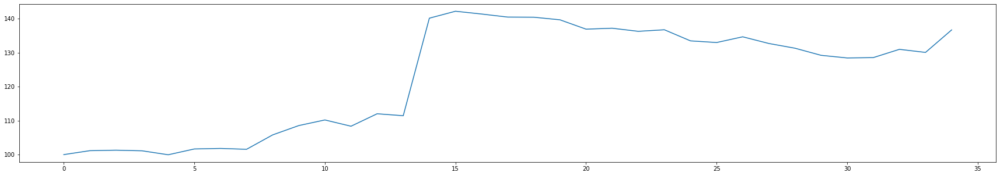

profit: 13.027537342607346
max loss: -2.085404402190477
max profit: 14.280923831633118
transaction count: 27
loss count: 16
profit count: 11
profit percentage: 13.027537342607346
Hodl strategy expected return of MOBUSDT: -45.26532479414456


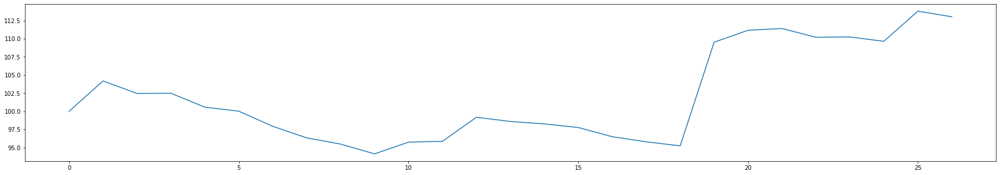

profit: 13.058293254615535
max loss: -1.295464583917152
max profit: 5.641075701188427
transaction count: 42
loss count: 23
profit count: 19
profit percentage: 13.058293254615535
Hodl strategy expected return of NUUSDT: -2.4582809976673325


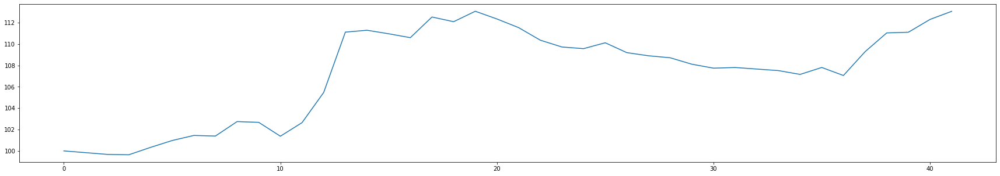

profit: 11.474359545483182
max loss: -3.114286918478413
max profit: 5.343851277625589
transaction count: 22
loss count: 11
profit count: 11
profit percentage: 11.474359545483182
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


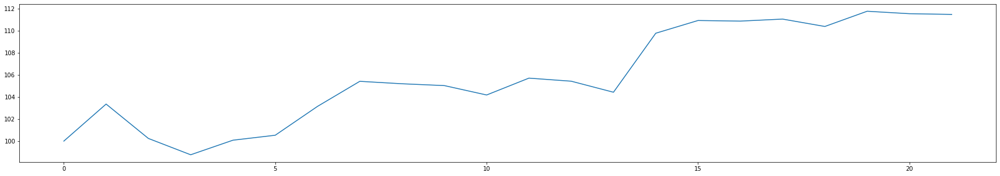

profit: 111.07110011293264
max loss: -6.540679895897341
max profit: 48.28007661440081
transaction count: 36
loss count: 20
profit count: 16
profit percentage: 111.07110011293264
Hodl strategy expected return of STORMUSDT: 81.46367521367522


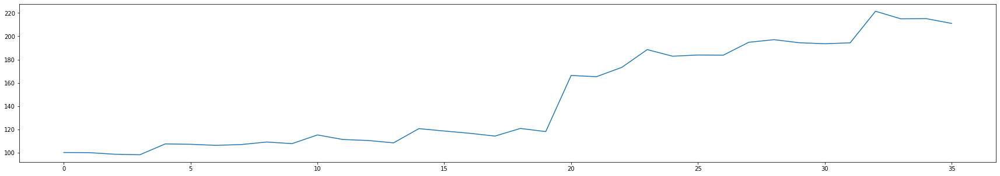

profit: 14.721754911412475
max loss: -4.044789683641994
max profit: 6.956713119981941
transaction count: 45
loss count: 24
profit count: 21
profit percentage: 14.721754911412475
Hodl strategy expected return of STRATUSDT: 28.24267782426778


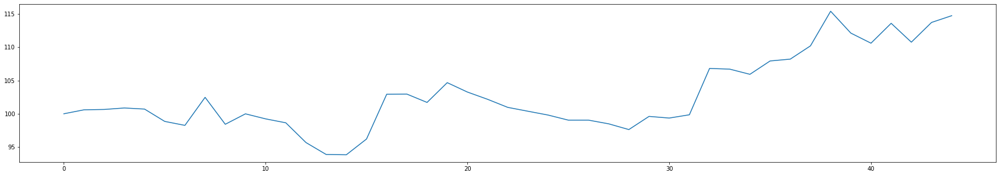

profit: 62.281612785693
max loss: -2.4603285520023093
max profit: 16.351511552603952
transaction count: 36
loss count: 17
profit count: 19
profit percentage: 62.281612785693
Hodl strategy expected return of TRXUSDT: 21.927066960075457


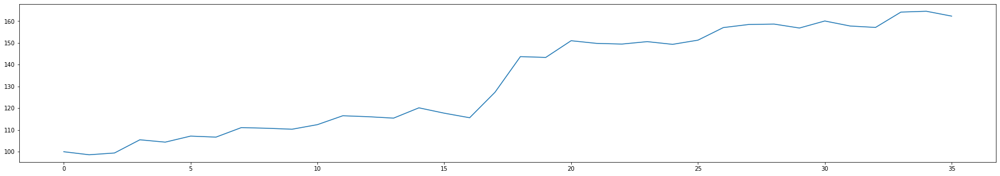

cumulative profit percentage: 449.7996826896724
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 270
cumulative profit count: 255
(profit count / loss count) ratio: 0.9444444444444444


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + macd & determine via wma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["wma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: -1.2094655140942052
max loss: -1.8569008248444163
max profit: 7.053659957386131
transaction count: 45
loss count: 32
profit count: 13
profit percentage: -1.2094655140942052
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


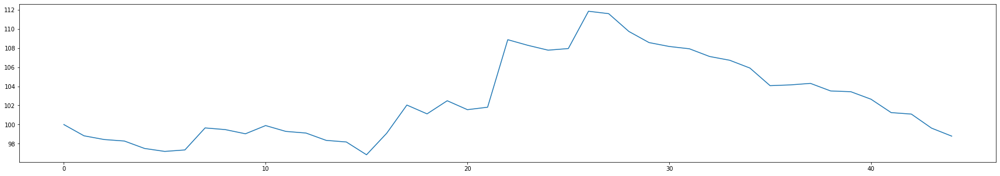

profit: 3.54546268826941
max loss: -2.130819693663369
max profit: 6.071123353776187
transaction count: 27
loss count: 19
profit count: 8
profit percentage: 3.54546268826941
Hodl strategy expected return of APEUSDT: -57.663335972000255


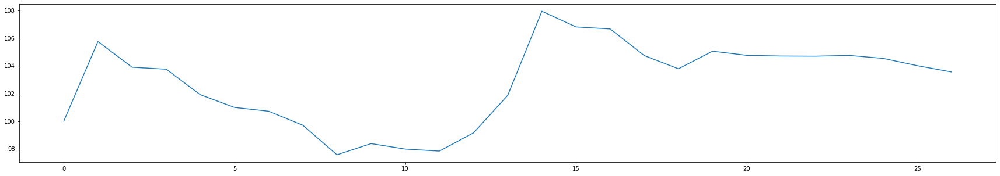

profit: 18.326103728838646
max loss: -3.7672261485225818
max profit: 18.71689697289355
transaction count: 41
loss count: 26
profit count: 15
profit percentage: 18.326103728838646
Hodl strategy expected return of BEARUSDT: -32.7710843373494


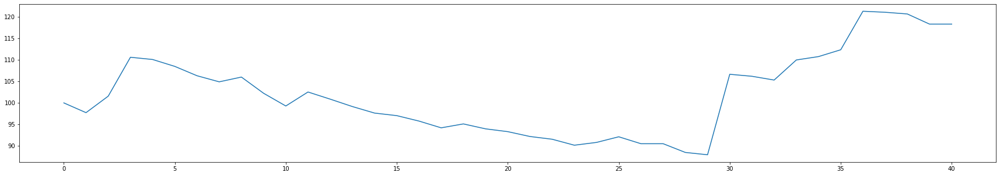

profit: 26.82623123778893
max loss: -4.124915869066527
max profit: 13.00407207166387
transaction count: 38
loss count: 23
profit count: 15
profit percentage: 26.826231237788935
Hodl strategy expected return of BULLUSDT: 5.791070587599496


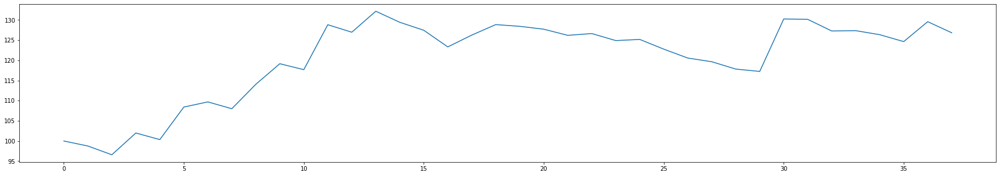

profit: 16.59131529966598
max loss: -2.8237231358635313
max profit: 19.078620710064882
transaction count: 28
loss count: 15
profit count: 13
profit percentage: 16.59131529966598
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


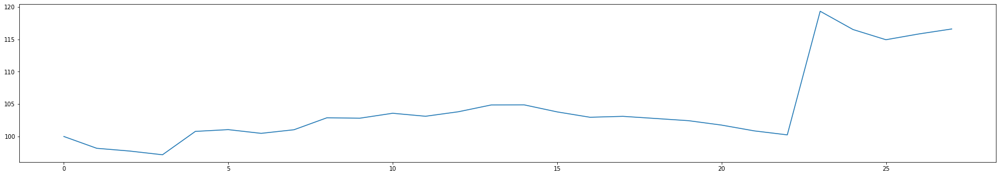

profit: 44.39002671387493
max loss: -3.380368518385012
max profit: 22.319090626754132
transaction count: 41
loss count: 20
profit count: 21
profit percentage: 44.39002671387493
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


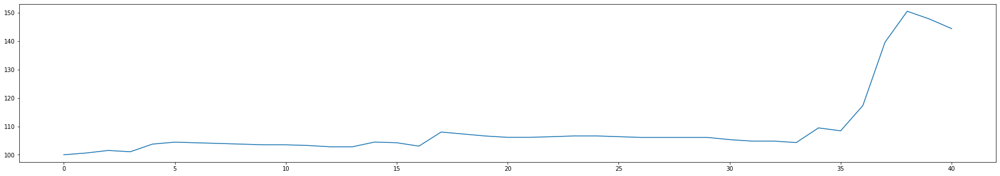

profit: 12.153837321898635
max loss: -2.200333084018112
max profit: 4.39293161220445
transaction count: 29
loss count: 13
profit count: 16
profit percentage: 12.153837321898637
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


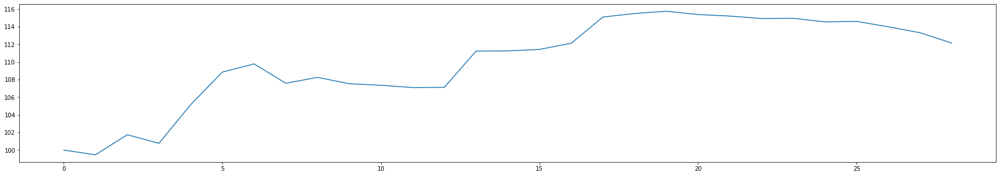

profit: 2.7882466799394763
max loss: -1.220637508605094
max profit: 5.612623511943127
transaction count: 50
loss count: 26
profit count: 24
profit percentage: 2.7882466799394763
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


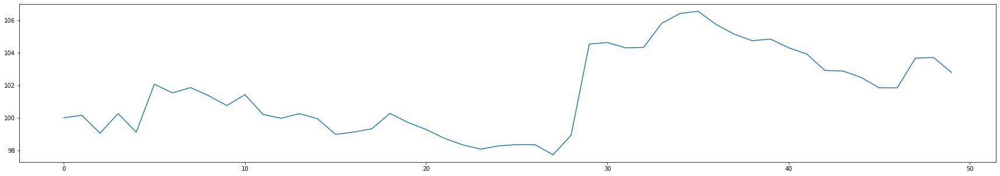

profit: 20.157361834669388
max loss: -3.405592829134605
max profit: 27.36302617426621
transaction count: 40
loss count: 23
profit count: 17
profit percentage: 20.157361834669388
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


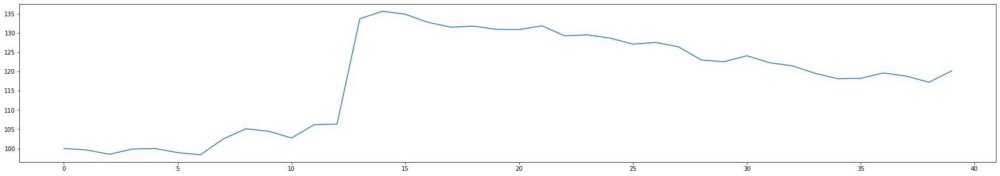

profit: 7.855759219878848
max loss: -2.9569081808296716
max profit: 15.683431491562743
transaction count: 30
loss count: 20
profit count: 10
profit percentage: 7.855759219878848
Hodl strategy expected return of MOBUSDT: -45.26532479414456


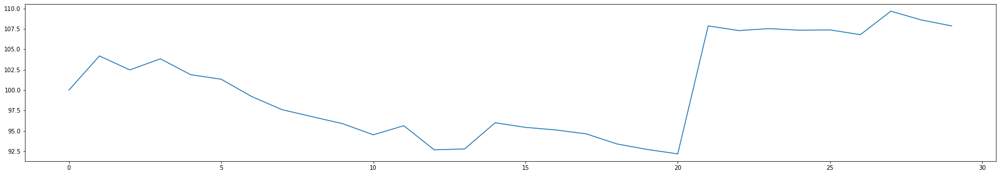

profit: 7.703300271618318
max loss: -1.5407136137196318
max profit: 5.4531162512220845
transaction count: 41
loss count: 23
profit count: 18
profit percentage: 7.7033002716183185
Hodl strategy expected return of NUUSDT: -2.4582809976673325


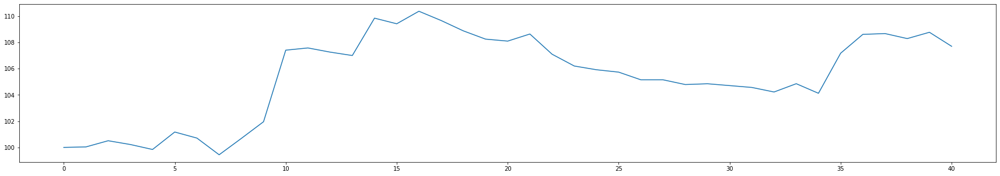

profit: 10.036311017162333
max loss: -3.114286918478413
max profit: 5.292919826556869
transaction count: 24
loss count: 12
profit count: 12
profit percentage: 10.036311017162333
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


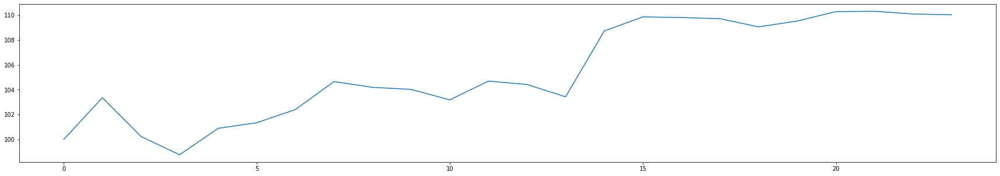

profit: 97.99447363583027
max loss: -6.0228518973902965
max profit: 35.03219434835752
transaction count: 39
loss count: 19
profit count: 20
profit percentage: 97.99447363583027
Hodl strategy expected return of STORMUSDT: 81.46367521367522


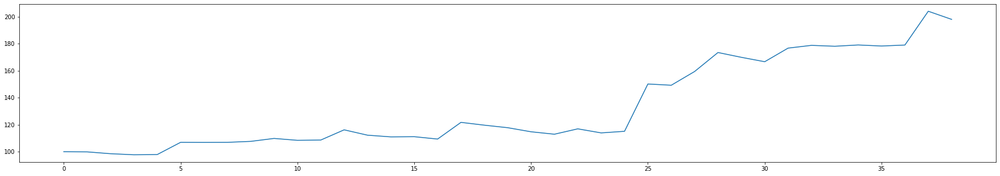

profit: 24.346842139140975
max loss: -4.122104150775556
max profit: 12.95708422475927
transaction count: 51
loss count: 29
profit count: 22
profit percentage: 24.346842139140975
Hodl strategy expected return of STRATUSDT: 28.24267782426778


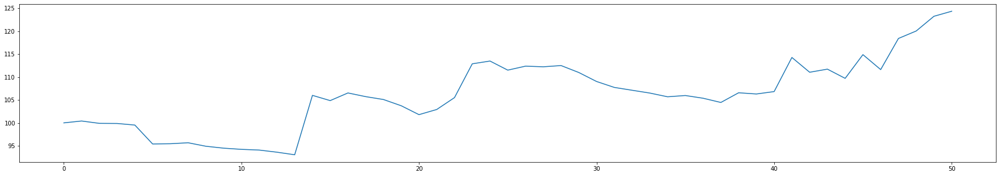

profit: 41.563860924270244
max loss: -3.8855152023865003
max profit: 16.143942164711405
transaction count: 34
loss count: 19
profit count: 15
profit percentage: 41.563860924270244
Hodl strategy expected return of TRXUSDT: 21.927066960075457


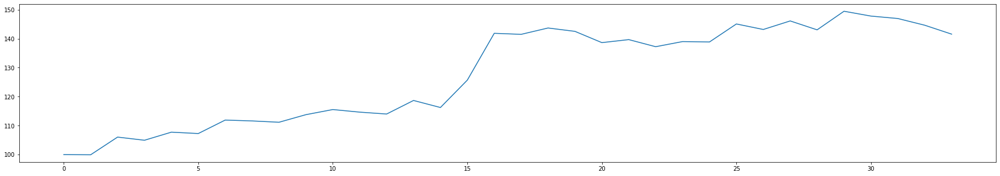

cumulative profit percentage: 333.0696671987522
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 319
cumulative profit count: 239
(profit count / loss count) ratio: 0.7492163009404389


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + psar & determine via wma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["wma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 9.940592873379103
max loss: -2.3562548752585144
max profit: 7.501953775330762
transaction count: 48
loss count: 29
profit count: 19
profit percentage: 9.940592873379103
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


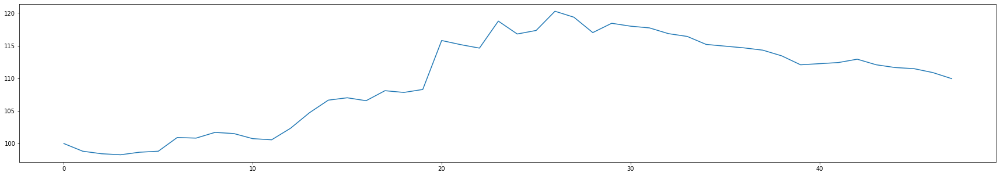

profit: 7.8976831733371995
max loss: -2.48009867621127
max profit: 11.36361517448421
transaction count: 30
loss count: 18
profit count: 12
profit percentage: 7.8976831733372
Hodl strategy expected return of APEUSDT: -57.663335972000255


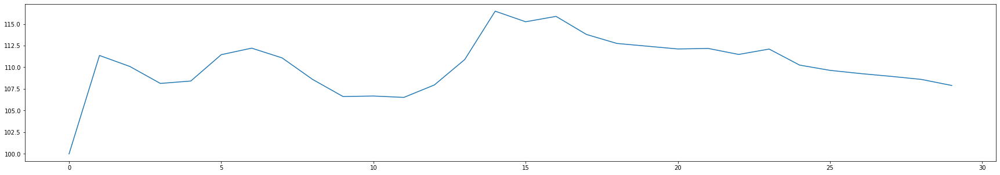

profit: 27.297927181752442
max loss: -5.521739855211337
max profit: 19.895526968848557
transaction count: 44
loss count: 27
profit count: 17
profit percentage: 27.297927181752442
Hodl strategy expected return of BEARUSDT: -32.7710843373494


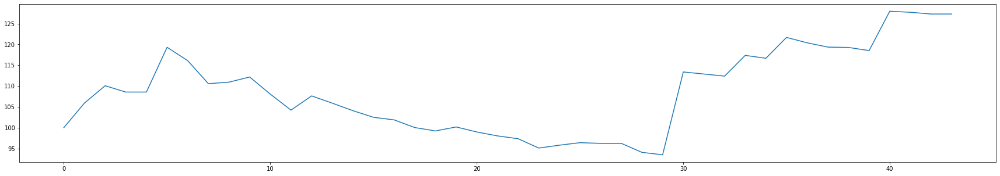

profit: 55.694079495544685
max loss: -5.5561202727414525
max profit: 18.192143525634293
transaction count: 42
loss count: 20
profit count: 22
profit percentage: 55.694079495544685
Hodl strategy expected return of BULLUSDT: 5.791070587599496


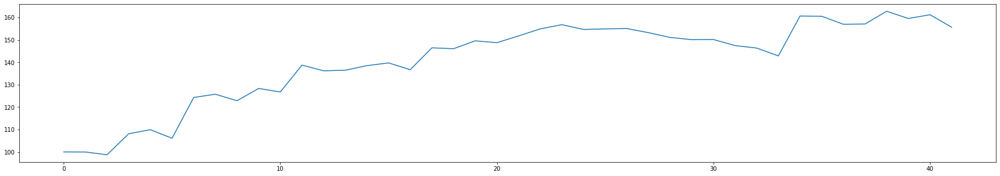

profit: 21.07035948571054
max loss: -2.6780390191925108
max profit: 18.762617687224278
transaction count: 30
loss count: 15
profit count: 15
profit percentage: 21.07035948571054
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


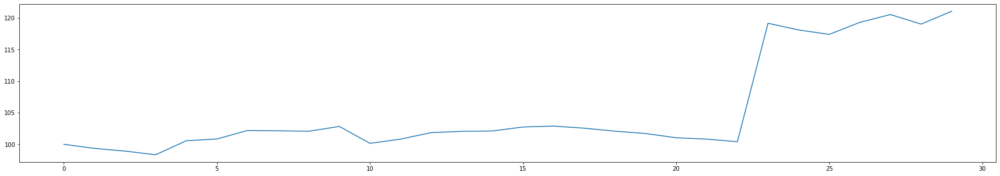

profit: 49.81976763038156
max loss: -5.103458479938752
max profit: 22.21719619610046
transaction count: 34
loss count: 11
profit count: 23
profit percentage: 49.81976763038156
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


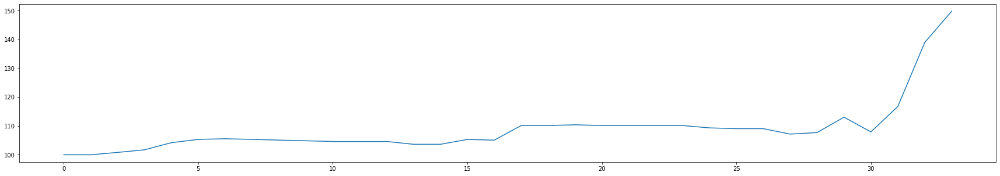

profit: 10.954229623021789
max loss: -1.8468791411842744
max profit: 4.536592910652416
transaction count: 29
loss count: 14
profit count: 15
profit percentage: 10.954229623021789
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


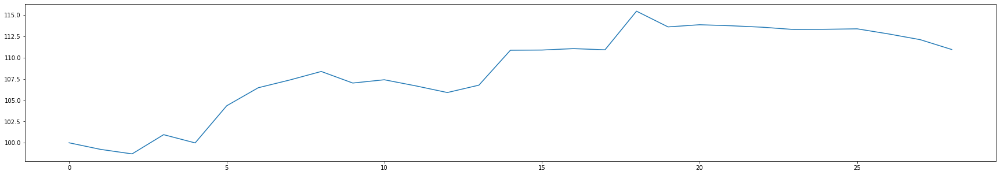

profit: 18.532043427376735
max loss: -2.496061786175929
max profit: 6.214590161692016
transaction count: 50
loss count: 17
profit count: 33
profit percentage: 18.532043427376735
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


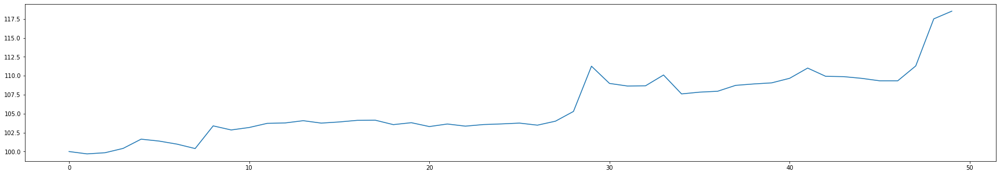

profit: 36.80056102712166
max loss: -2.702800378644355
max profit: 28.220531371489614
transaction count: 37
loss count: 19
profit count: 18
profit percentage: 36.80056102712166
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


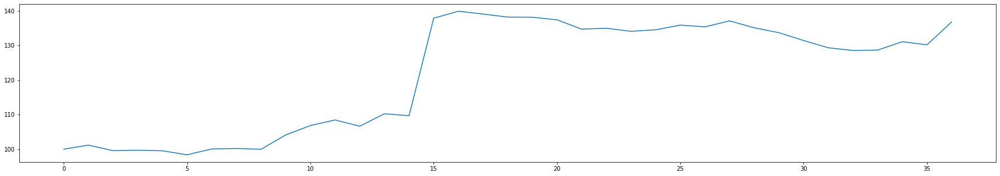

profit: 10.435137954595376
max loss: -2.7772499119519836
max profit: 13.979149356960278
transaction count: 32
loss count: 20
profit count: 12
profit percentage: 10.435137954595374
Hodl strategy expected return of MOBUSDT: -45.26532479414456


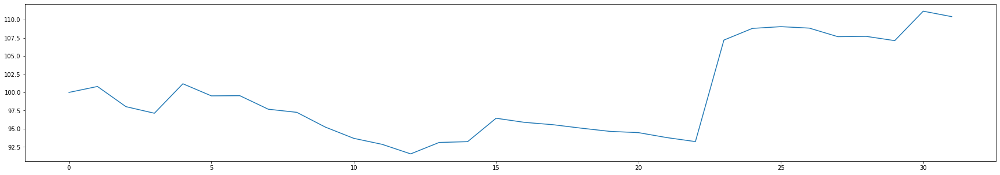

profit: 14.780810524826208
max loss: -1.299277002792266
max profit: 5.604417042577069
transaction count: 41
loss count: 20
profit count: 21
profit percentage: 14.780810524826208
Hodl strategy expected return of NUUSDT: -2.4582809976673325


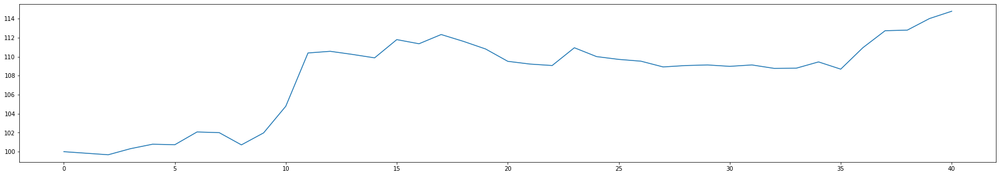

profit: 12.548389011668618
max loss: -3.114286918478413
max profit: 5.459624580126274
transaction count: 26
loss count: 14
profit count: 12
profit percentage: 12.548389011668618
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


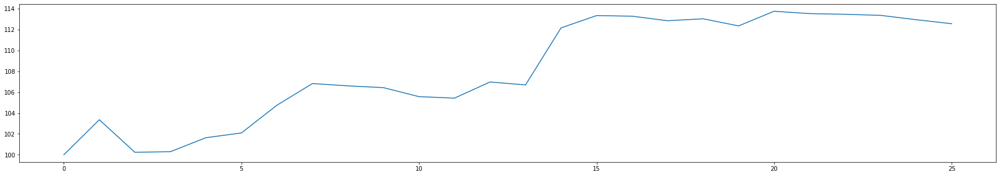

profit: 102.69089000540171
max loss: -6.280993601826793
max profit: 47.452206720027434
transaction count: 37
loss count: 21
profit count: 16
profit percentage: 102.69089000540171
Hodl strategy expected return of STORMUSDT: 81.46367521367522


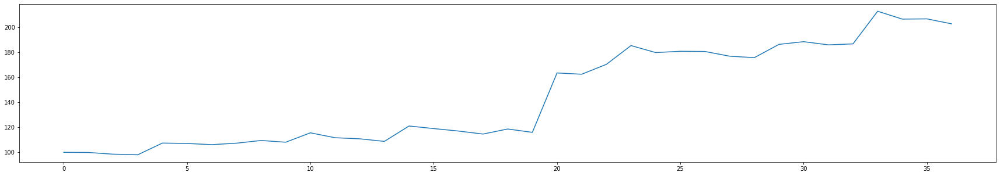

profit: 21.720530176365187
max loss: -4.5561068490025605
max profit: 7.475998147650714
transaction count: 45
loss count: 22
profit count: 23
profit percentage: 21.720530176365187
Hodl strategy expected return of STRATUSDT: 28.24267782426778


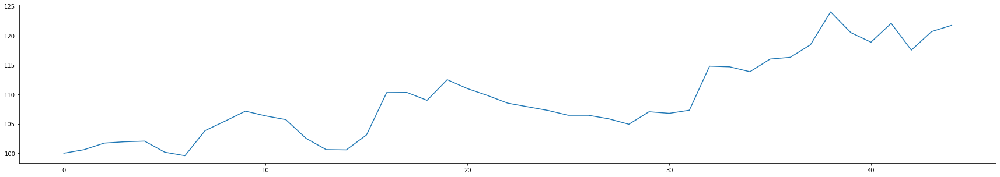

profit: 73.03116301815098
max loss: -2.5547411691101303
max profit: 17.33276255682074
transaction count: 36
loss count: 15
profit count: 21
profit percentage: 73.03116301815098
Hodl strategy expected return of TRXUSDT: 21.927066960075457


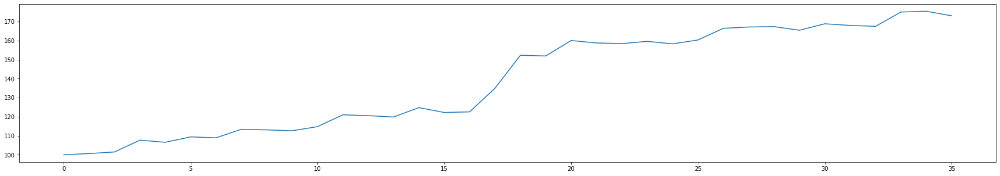

cumulative profit percentage: 473.21416460863384
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 282
cumulative profit count: 279
(profit count / loss count) ratio: 0.9893617021276596


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + macd & determine via wma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["wma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: -0.5636850126012547
max loss: -1.859089879239363
max profit: 7.061975342420993
transaction count: 45
loss count: 30
profit count: 15
profit percentage: -0.5636850126012547
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


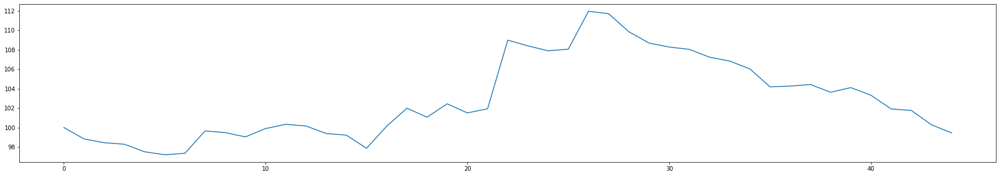

profit: 0.7962474751360276
max loss: -2.2929916275592888
max profit: 5.742715373958163
transaction count: 33
loss count: 22
profit count: 11
profit percentage: 0.7962474751360276
Hodl strategy expected return of APEUSDT: -57.663335972000255


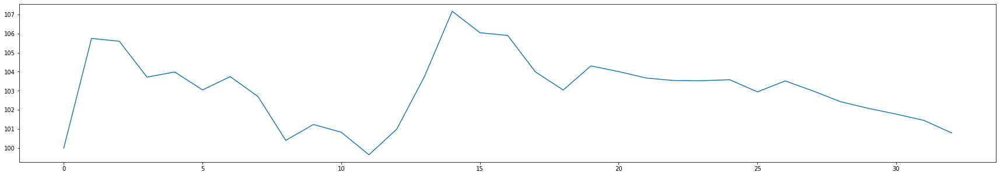

profit: 18.350460321964917
max loss: -3.7672261485225818
max profit: 18.565683263058673
transaction count: 41
loss count: 26
profit count: 15
profit percentage: 18.350460321964917
Hodl strategy expected return of BEARUSDT: -32.7710843373494


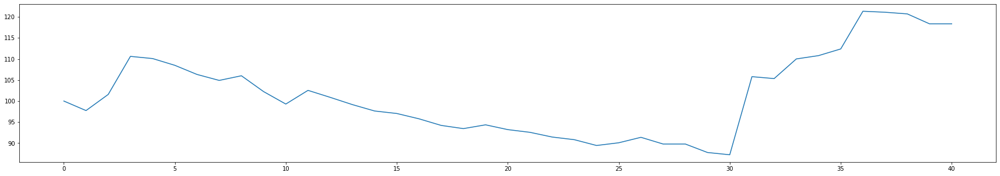

profit: 45.58505518859232
max loss: -3.3159044943318463
max profit: 17.485457095445668
transaction count: 35
loss count: 20
profit count: 15
profit percentage: 45.58505518859232
Hodl strategy expected return of BULLUSDT: 5.791070587599496


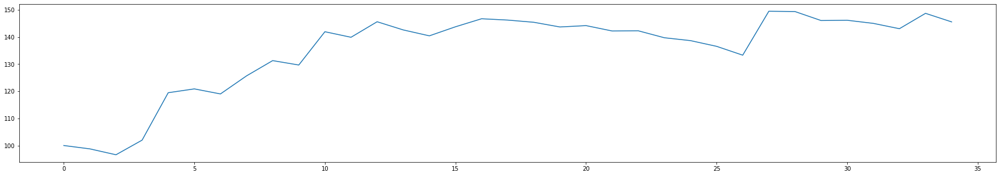

profit: 16.239372711129306
max loss: -2.2770096842591414
max profit: 18.570921826896324
transaction count: 28
loss count: 14
profit count: 14
profit percentage: 16.239372711129306
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


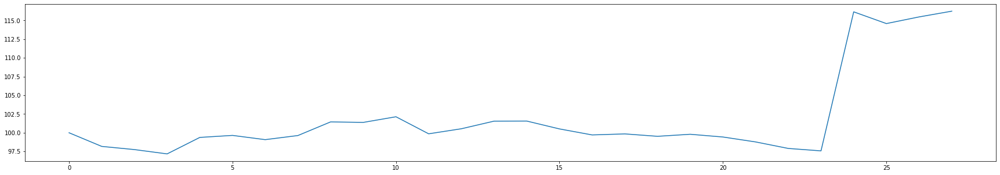

profit: 43.30816276468096
max loss: -3.3550405998420274
max profit: 22.15186148996807
transaction count: 45
loss count: 22
profit count: 23
profit percentage: 43.30816276468096
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


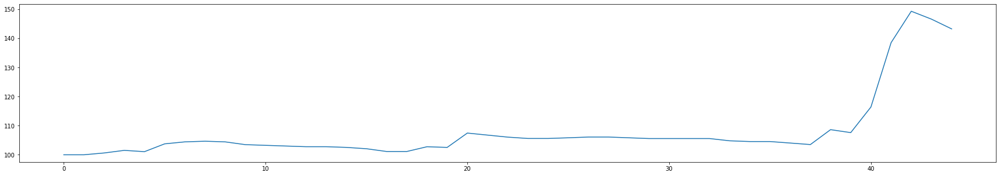

profit: 9.236972689738579
max loss: -2.1844351703804676
max profit: 4.3588842539699755
transaction count: 30
loss count: 15
profit count: 15
profit percentage: 9.236972689738579
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


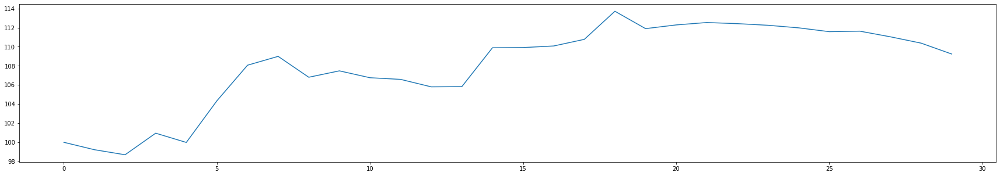

profit: 2.016207741973119
max loss: -2.1683092514121114
max profit: 5.692546159640557
transaction count: 50
loss count: 27
profit count: 23
profit percentage: 2.016207741973119
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


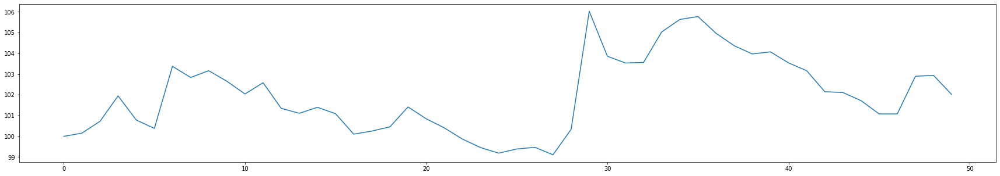

profit: 26.610951414370845
max loss: -2.5881626947028735
max profit: 27.36302617426621
transaction count: 37
loss count: 20
profit count: 17
profit percentage: 26.61095141437085
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


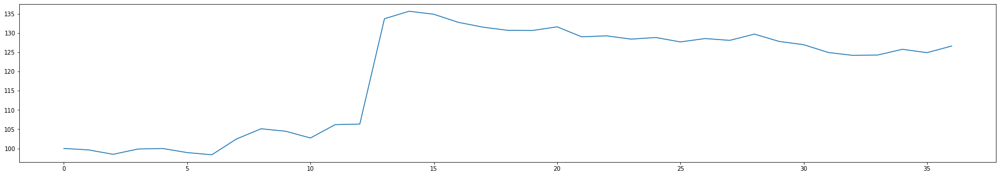

profit: 8.654470644112962
max loss: -2.7772499119519836
max profit: 15.828755858929938
transaction count: 34
loss count: 23
profit count: 11
profit percentage: 8.654470644112962
Hodl strategy expected return of MOBUSDT: -45.26532479414456


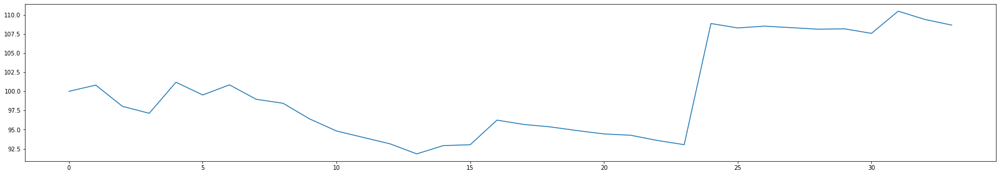

profit: 9.344096662940018
max loss: -1.5642625143754998
max profit: 5.4531162512220845
transaction count: 43
loss count: 22
profit count: 21
profit percentage: 9.344096662940018
Hodl strategy expected return of NUUSDT: -2.4582809976673325


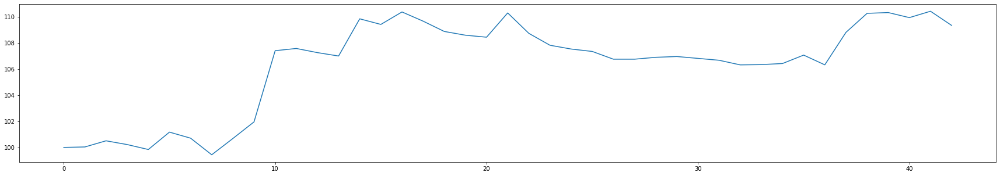

profit: 11.520802950037947
max loss: -3.114286918478413
max profit: 5.414842379548574
transaction count: 24
loss count: 12
profit count: 12
profit percentage: 11.520802950037947
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


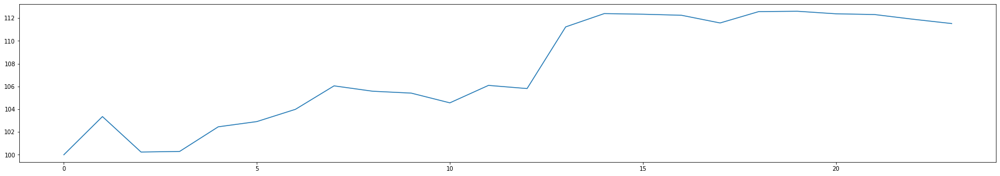

profit: 93.91640232725905
max loss: -5.898799851555424
max profit: 35.03219434835752
transaction count: 39
loss count: 19
profit count: 20
profit percentage: 93.91640232725905
Hodl strategy expected return of STORMUSDT: 81.46367521367522


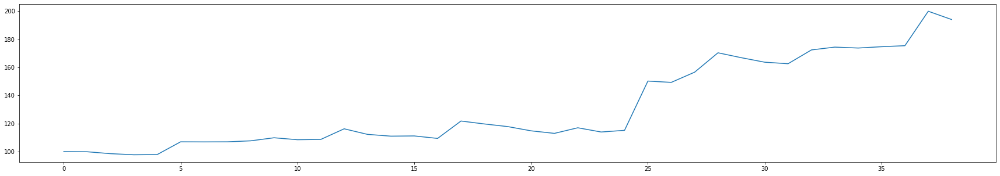

profit: 32.92890757737263
max loss: -4.14431316870342
max profit: 13.261760096543753
transaction count: 45
loss count: 21
profit count: 24
profit percentage: 32.92890757737263
Hodl strategy expected return of STRATUSDT: 28.24267782426778


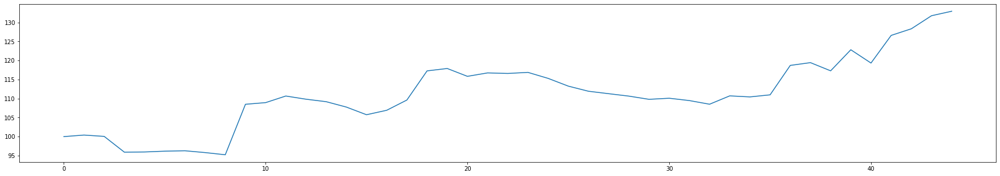

profit: 43.04080186042978
max loss: -3.8855152023865003
max profit: 16.143942164711405
transaction count: 34
loss count: 19
profit count: 15
profit percentage: 43.04080186042978
Hodl strategy expected return of TRXUSDT: 21.927066960075457


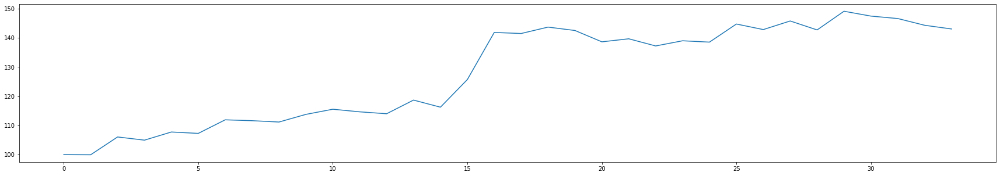

cumulative profit percentage: 360.98522731713723
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 312
cumulative profit count: 251
(profit count / loss count) ratio: 0.8044871794871795


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + psar & determine via wma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["wma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 6.0012229004226185
max loss: -2.5888781156654517
max profit: 7.519223445828331
transaction count: 45
loss count: 27
profit count: 18
profit percentage: 6.0012229004226185
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


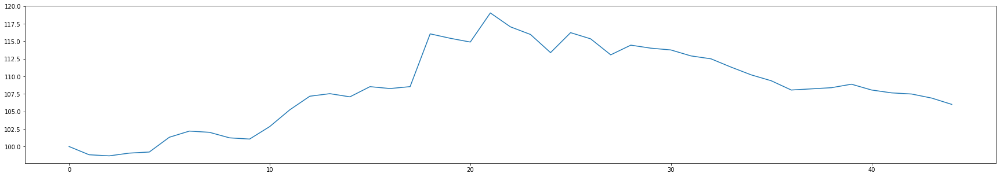

profit: 10.396905958272143
max loss: -2.481357307665178
max profit: 11.36361517448421
transaction count: 19
loss count: 11
profit count: 8
profit percentage: 10.396905958272143
Hodl strategy expected return of APEUSDT: -57.663335972000255


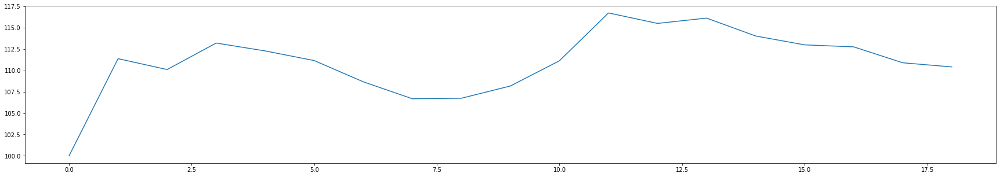

profit: 30.340478820682023
max loss: -5.471114866361987
max profit: 20.630457201967886
transaction count: 41
loss count: 26
profit count: 15
profit percentage: 30.340478820682023
Hodl strategy expected return of BEARUSDT: -32.7710843373494


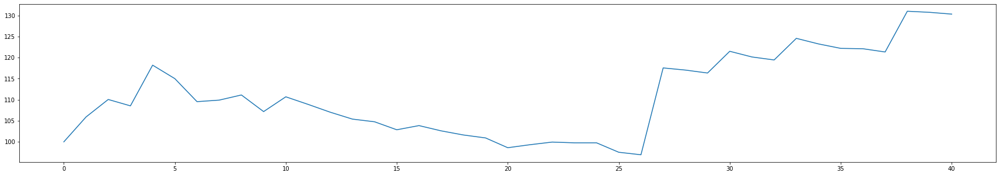

profit: 43.410715961365554
max loss: -5.117774477122055
max profit: 14.790849634241226
transaction count: 36
loss count: 17
profit count: 19
profit percentage: 43.41071596136555
Hodl strategy expected return of BULLUSDT: 5.791070587599496


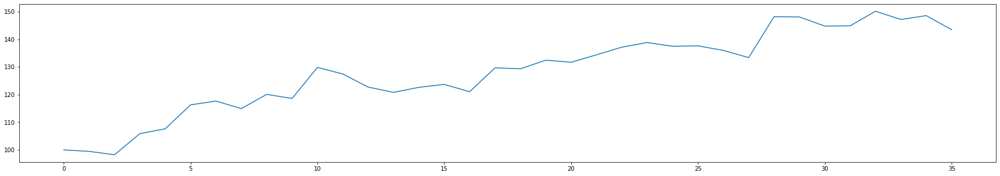

profit: 22.354874353278532
max loss: -2.712726133019288
max profit: 18.96168260679758
transaction count: 27
loss count: 12
profit count: 15
profit percentage: 22.354874353278532
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


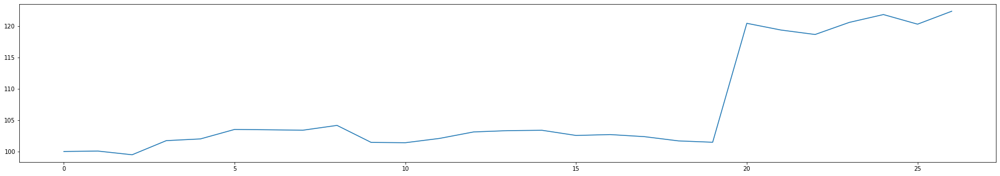

profit: 50.66661205223184
max loss: -5.132305376541495
max profit: 22.342777145566615
transaction count: 27
loss count: 7
profit count: 20
profit percentage: 50.66661205223184
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


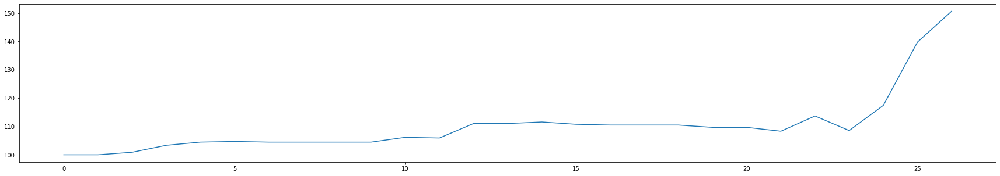

profit: 15.729047137290408
max loss: -1.3985340272600837
max profit: 4.668703366592823
transaction count: 24
loss count: 10
profit count: 14
profit percentage: 15.729047137290408
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


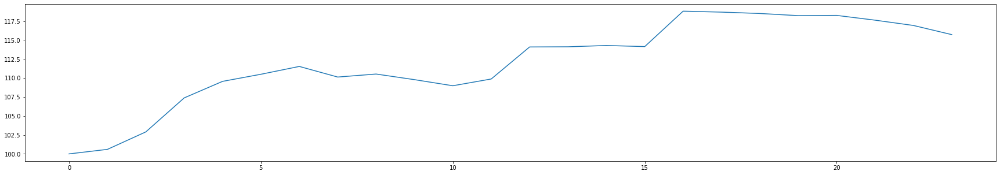

profit: 19.72477986306869
max loss: -2.521034553103121
max profit: 6.277124881455663
transaction count: 46
loss count: 14
profit count: 32
profit percentage: 19.72477986306869
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


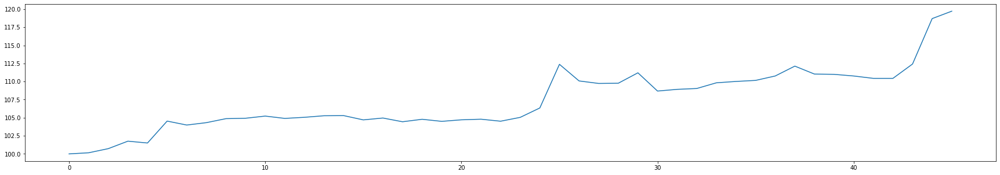

profit: 37.71276650474502
max loss: -3.197460906033456
max profit: 28.220531371489614
transaction count: 36
loss count: 19
profit count: 17
profit percentage: 37.71276650474502
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


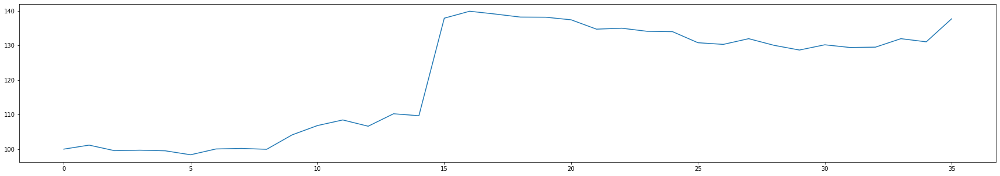

profit: 10.904365362454286
max loss: -2.451570181696354
max profit: 14.322416637837236
transaction count: 26
loss count: 15
profit count: 11
profit percentage: 10.904365362454287
Hodl strategy expected return of MOBUSDT: -45.26532479414456


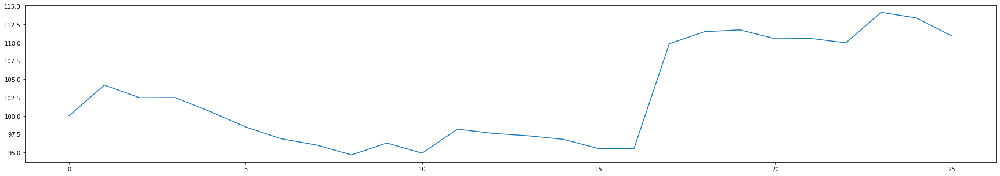

profit: 7.967220107163996
max loss: -2.2279255331964976
max profit: 5.569354045275645
transaction count: 46
loss count: 25
profit count: 21
profit percentage: 7.967220107163996
Hodl strategy expected return of NUUSDT: -2.4582809976673325


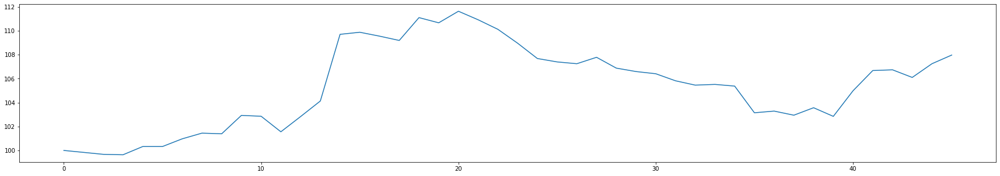

profit: 12.44647210692085
max loss: -3.114286918478413
max profit: 5.366822913466308
transaction count: 21
loss count: 11
profit count: 10
profit percentage: 12.44647210692085
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


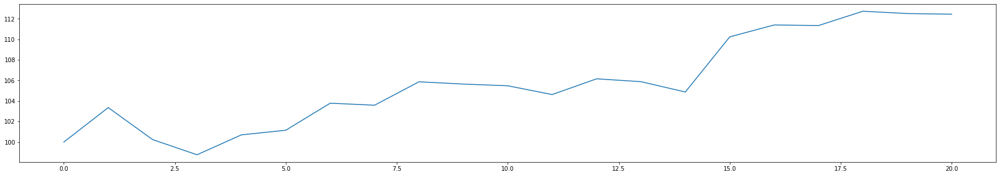

profit: 108.71916443336741
max loss: -6.467798016722298
max profit: 48.767754155960404
transaction count: 37
loss count: 20
profit count: 17
profit percentage: 108.71916443336741
Hodl strategy expected return of STORMUSDT: 81.46367521367522


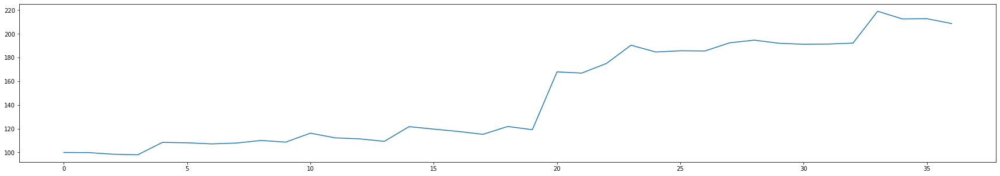

profit: 24.772932143223315
max loss: -3.476478788488393
max profit: 7.377417461963262
transaction count: 44
loss count: 22
profit count: 22
profit percentage: 24.772932143223315
Hodl strategy expected return of STRATUSDT: 28.24267782426778


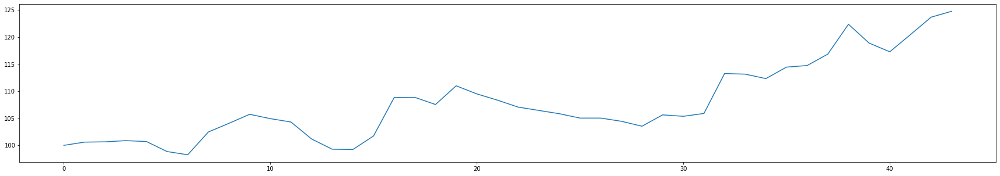

profit: 58.23027302990698
max loss: -2.7474139856098247
max profit: 16.692215680885027
transaction count: 36
loss count: 16
profit count: 20
profit percentage: 58.23027302990698
Hodl strategy expected return of TRXUSDT: 21.927066960075457


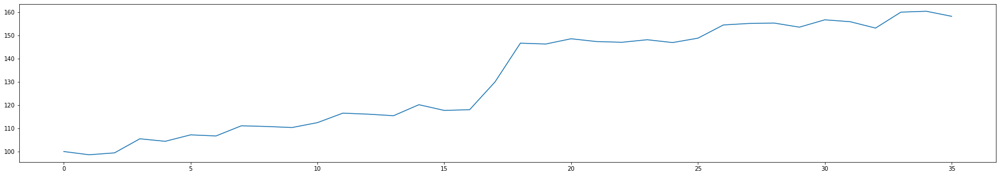

cumulative profit percentage: 459.37783073439374
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 252
cumulative profit count: 259
(profit count / loss count) ratio: 1.0277777777777777


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + macd & determine via wma

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["wma"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 1.7072194215175642
max loss: -1.9015473601981512
max profit: 7.2232551637898155
transaction count: 41
loss count: 26
profit count: 15
profit percentage: 1.7072194215175642
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


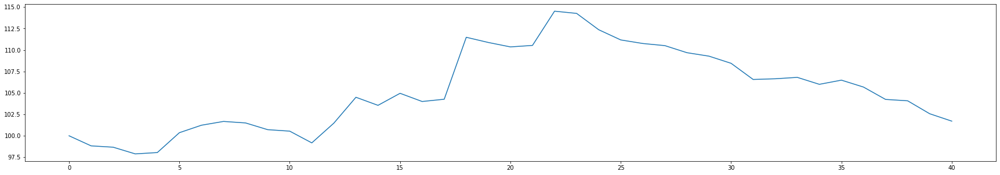

profit: 2.732104719972682
max loss: -2.2539875653113057
max profit: 6.150374476382893
transaction count: 20
loss count: 14
profit count: 6
profit percentage: 2.732104719972682
Hodl strategy expected return of APEUSDT: -57.663335972000255


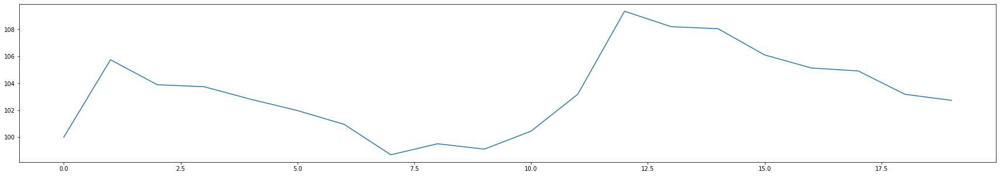

profit: 15.423390423115848
max loss: -3.5684756083127667
max profit: 18.25774396968501
transaction count: 39
loss count: 26
profit count: 13
profit percentage: 15.423390423115848
Hodl strategy expected return of BEARUSDT: -32.7710843373494


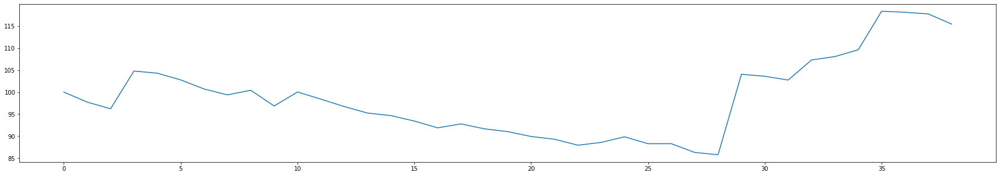

profit: 36.144609910370775
max loss: -3.7194818694660228
max profit: 13.959527947523767
transaction count: 30
loss count: 17
profit count: 13
profit percentage: 36.144609910370775
Hodl strategy expected return of BULLUSDT: 5.791070587599496


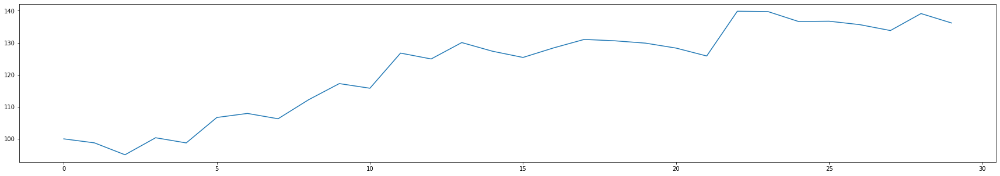

profit: 18.613157381516515
max loss: -2.87269009578597
max profit: 19.113682458920152
transaction count: 25
loss count: 11
profit count: 14
profit percentage: 18.613157381516515
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


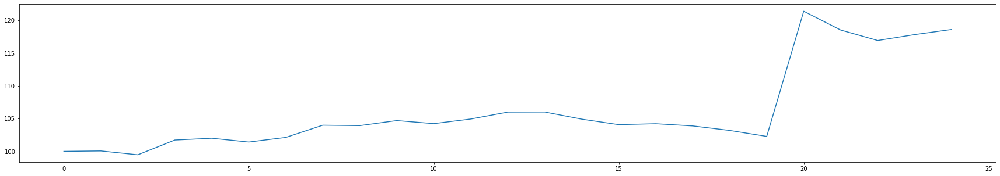

profit: 44.564779543774904
max loss: -3.3844597217606065
max profit: 22.34610304815598
transaction count: 35
loss count: 15
profit count: 20
profit percentage: 44.564779543774904
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


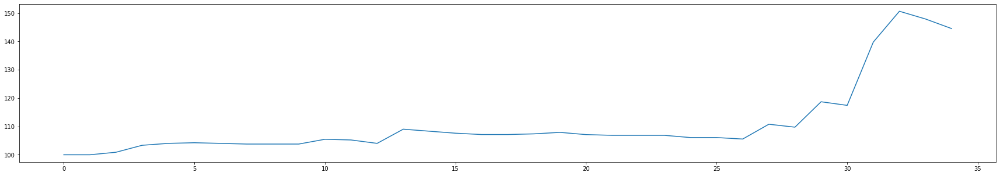

profit: 13.98089779311276
max loss: -2.248048267701506
max profit: 4.48581964304384
transaction count: 24
loss count: 10
profit count: 14
profit percentage: 13.98089779311276
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


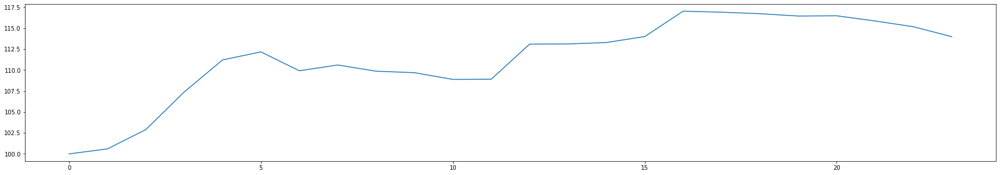

profit: 4.326085154348675
max loss: -1.238899745628018
max profit: 5.696595256357796
transaction count: 50
loss count: 25
profit count: 25
profit percentage: 4.326085154348675
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


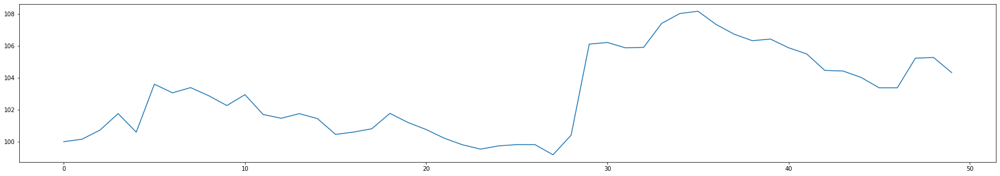

profit: 24.870064581761056
max loss: -3.422275428285488
max profit: 27.36302617426621
transaction count: 39
loss count: 22
profit count: 17
profit percentage: 24.870064581761056
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


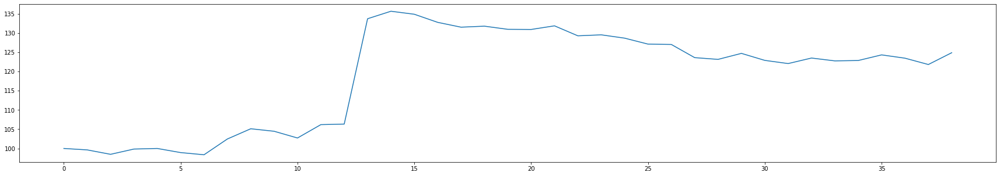

profit: 5.549609253892967
max loss: -2.9731951991762884
max profit: 15.72899924272275
transaction count: 29
loss count: 19
profit count: 10
profit percentage: 5.549609253892968
Hodl strategy expected return of MOBUSDT: -45.26532479414456


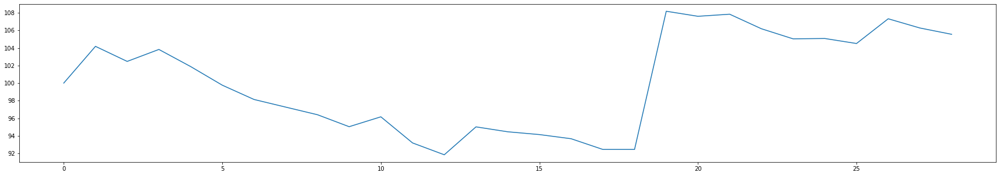

profit: 5.759830485461549
max loss: -2.2208702479236706
max profit: 5.4531162512220845
transaction count: 42
loss count: 24
profit count: 18
profit percentage: 5.759830485461549
Hodl strategy expected return of NUUSDT: -2.4582809976673325


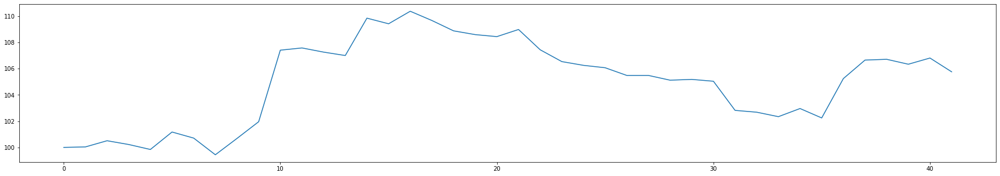

profit: 9.904063045138145
max loss: -3.114286918478413
max profit: 5.273056228208034
transaction count: 23
loss count: 11
profit count: 12
profit percentage: 9.904063045138145
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


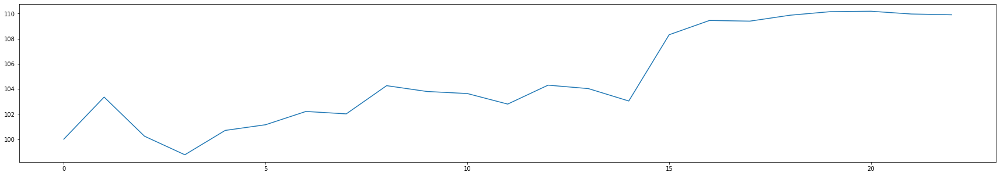

profit: 92.60977223486438
max loss: -5.859053087988485
max profit: 35.03219434835752
transaction count: 40
loss count: 20
profit count: 20
profit percentage: 92.60977223486438
Hodl strategy expected return of STORMUSDT: 81.46367521367522


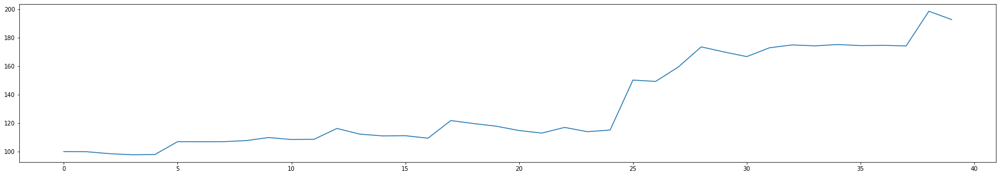

profit: 26.923407810418126
max loss: -4.14431316870342
max profit: 13.225565336454935
transaction count: 46
loss count: 24
profit count: 22
profit percentage: 26.923407810418126
Hodl strategy expected return of STRATUSDT: 28.24267782426778


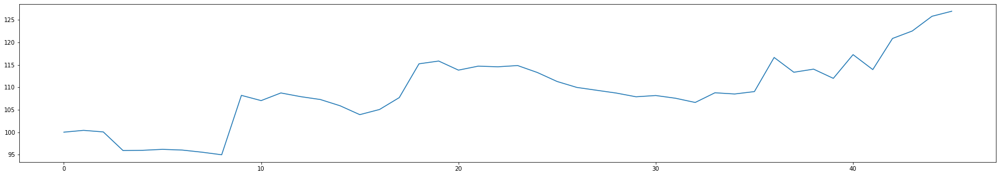

profit: 41.563860924270244
max loss: -3.8855152023865003
max profit: 16.143942164711405
transaction count: 34
loss count: 19
profit count: 15
profit percentage: 41.563860924270244
Hodl strategy expected return of TRXUSDT: 21.927066960075457


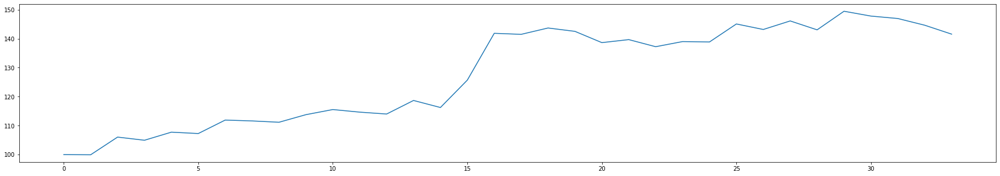

cumulative profit percentage: 344.6728526835361
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 283
cumulative profit count: 234
(profit count / loss count) ratio: 0.8268551236749117


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + psar & determine via ema

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["ema"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 2.822916071486773
max loss: -2.14841858165083
max profit: 6.9852000022405605
transaction count: 44
loss count: 29
profit count: 15
profit percentage: 2.822916071486773
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


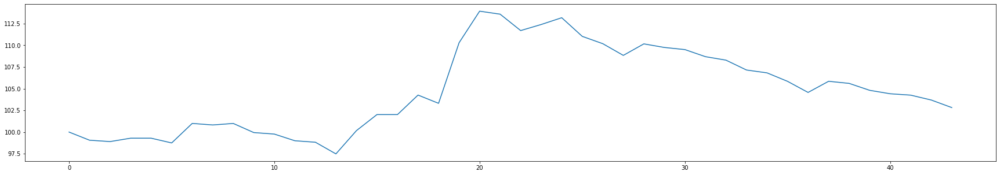

profit: 15.785730583748162
max loss: -2.5049285424762076
max profit: 11.36361517448421
transaction count: 21
loss count: 12
profit count: 9
profit percentage: 15.785730583748162
Hodl strategy expected return of APEUSDT: -57.663335972000255


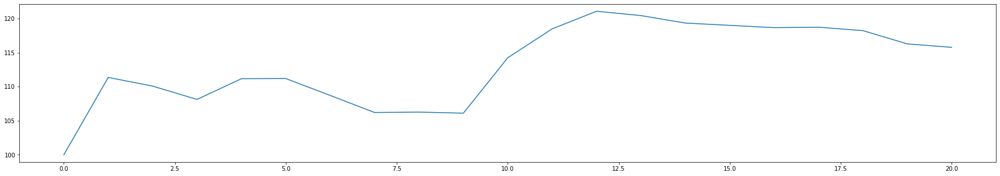

profit: 18.5103268671875
max loss: -7.364891588098288
max profit: 18.037612101205397
transaction count: 34
loss count: 21
profit count: 13
profit percentage: 18.5103268671875
Hodl strategy expected return of BEARUSDT: -32.7710843373494


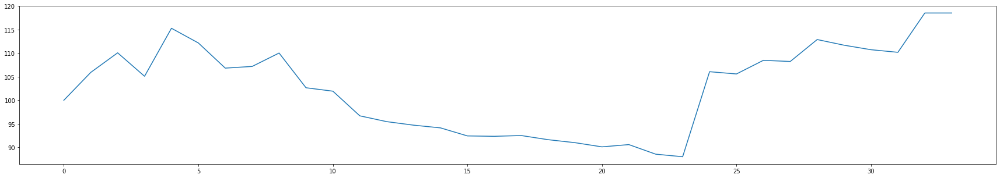

profit: 47.44327594050765
max loss: -4.678393905526747
max profit: 17.13126054794776
transaction count: 35
loss count: 18
profit count: 17
profit percentage: 47.44327594050765
Hodl strategy expected return of BULLUSDT: 5.791070587599496


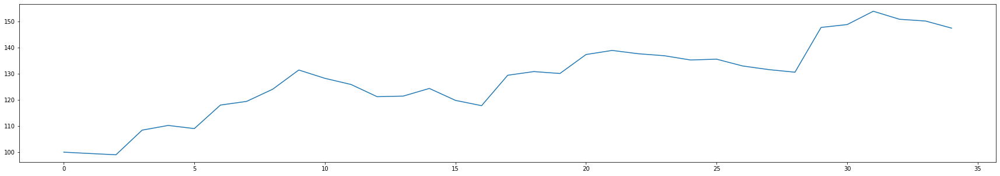

profit: 14.058173958178259
max loss: -2.6866486275188635
max profit: 16.838280739423652
transaction count: 26
loss count: 15
profit count: 11
profit percentage: 14.058173958178259
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


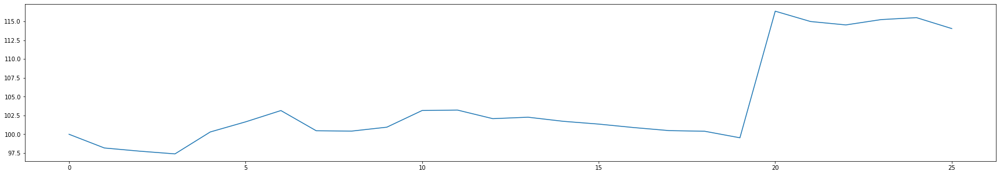

profit: 58.832910283396075
max loss: -5.142033480627489
max profit: 42.66385616026497
transaction count: 31
loss count: 10
profit count: 21
profit percentage: 58.832910283396075
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


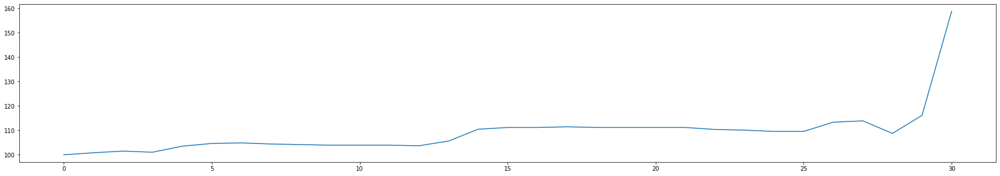

profit: 11.380027340800268
max loss: -1.3124012442402346
max profit: 6.069287762526528
transaction count: 25
loss count: 11
profit count: 14
profit percentage: 11.380027340800268
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


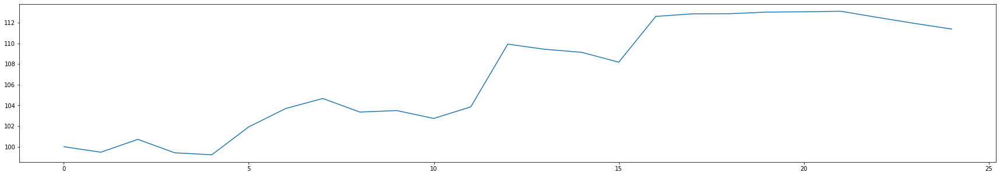

profit: 21.818430138411372
max loss: -2.2919592761224834
max profit: 12.06688937881485
transaction count: 40
loss count: 17
profit count: 23
profit percentage: 21.818430138411372
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


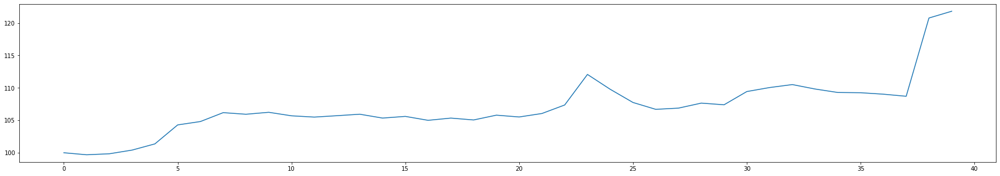

profit: 37.13854700496563
max loss: -3.185181469599115
max profit: 33.20782090280218
transaction count: 30
loss count: 19
profit count: 11
profit percentage: 37.13854700496563
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


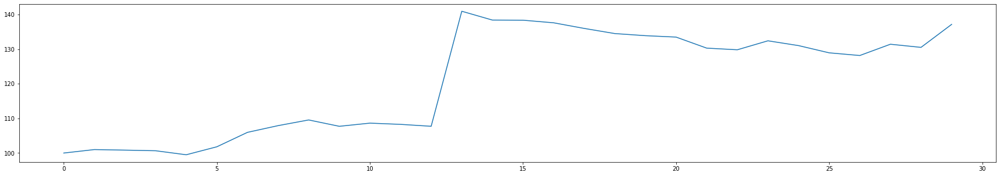

profit: 14.34258313301605
max loss: -2.145027169146573
max profit: 14.678135608366532
transaction count: 23
loss count: 15
profit count: 8
profit percentage: 14.34258313301605
Hodl strategy expected return of MOBUSDT: -45.26532479414456


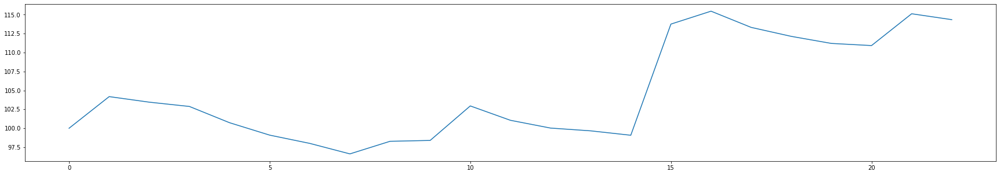

profit: 17.22383411503212
max loss: -1.3105382284933285
max profit: 7.741709682506695
transaction count: 35
loss count: 16
profit count: 19
profit percentage: 17.22383411503212
Hodl strategy expected return of NUUSDT: -2.4582809976673325


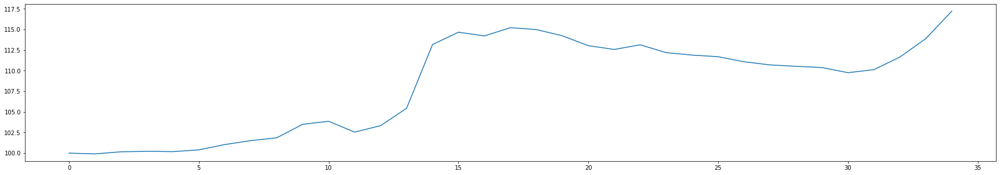

profit: 8.171575742801835
max loss: -1.3770366100224862
max profit: 5.903112623788118
transaction count: 19
loss count: 11
profit count: 8
profit percentage: 8.171575742801835
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


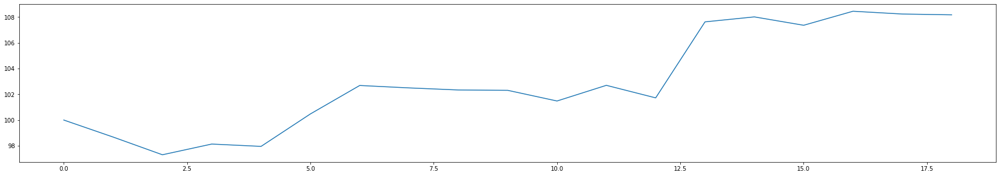

profit: 128.2301688019786
max loss: -6.159252164861414
max profit: 52.14077020052781
transaction count: 31
loss count: 15
profit count: 16
profit percentage: 128.2301688019786
Hodl strategy expected return of STORMUSDT: 81.46367521367522


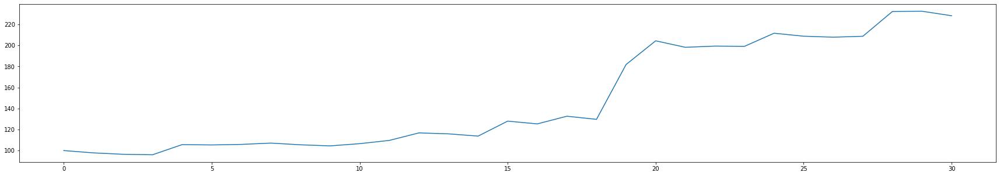

profit: 27.813394286587595
max loss: -3.6582230026707947
max profit: 7.589882626150853
transaction count: 37
loss count: 16
profit count: 21
profit percentage: 27.813394286587595
Hodl strategy expected return of STRATUSDT: 28.24267782426778


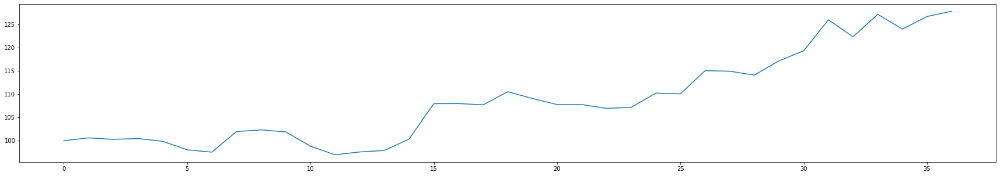

profit: 59.57980898372213
max loss: -3.6061714437178125
max profit: 15.03000052121476
transaction count: 33
loss count: 13
profit count: 20
profit percentage: 59.57980898372213
Hodl strategy expected return of TRXUSDT: 21.927066960075457


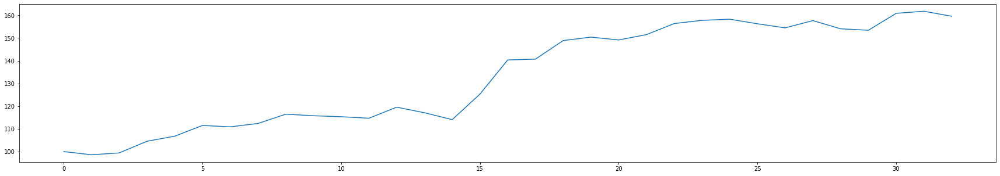

cumulative profit percentage: 483.15170325182
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 238
cumulative profit count: 226
(profit count / loss count) ratio: 0.9495798319327731


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via sma + macd & determine via ema

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["sma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["ema"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: -2.0278517741367637
max loss: -1.8275630601722952
max profit: 6.728000486152297
transaction count: 42
loss count: 29
profit count: 13
profit percentage: -2.0278517741367637
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


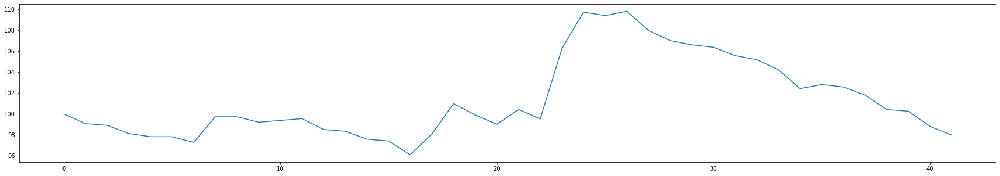

profit: 6.018921999982268
max loss: -2.130586806722235
max profit: 7.469526673882655
transaction count: 24
loss count: 14
profit count: 10
profit percentage: 6.018921999982268
Hodl strategy expected return of APEUSDT: -57.663335972000255


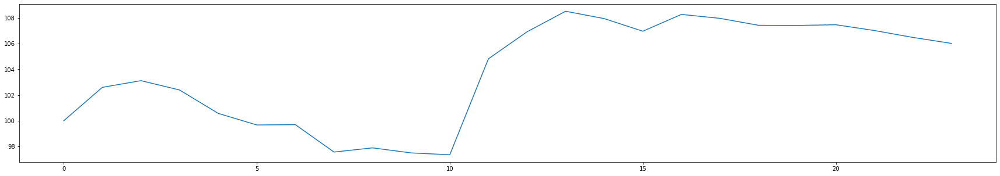

profit: 12.576759535031968
max loss: -7.2319470747303
max profit: 17.188331909033806
transaction count: 30
loss count: 19
profit count: 11
profit percentage: 12.576759535031968
Hodl strategy expected return of BEARUSDT: -32.7710843373494


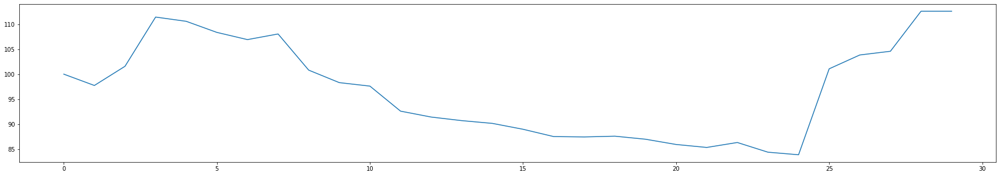

profit: 22.035172515678752
max loss: -7.794358377488464
max profit: 14.006503544429066
transaction count: 33
loss count: 21
profit count: 12
profit percentage: 22.035172515678752
Hodl strategy expected return of BULLUSDT: 5.791070587599496


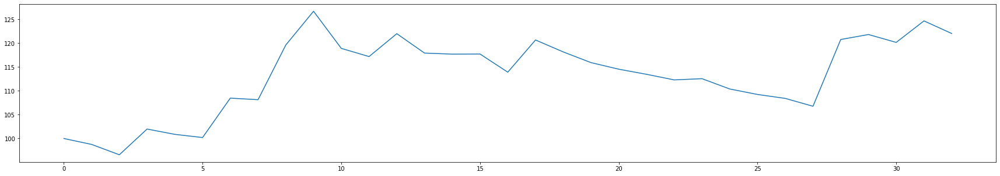

profit: 7.817433689585684
max loss: -2.6694143508236436
max profit: 16.78094738670228
transaction count: 28
loss count: 19
profit count: 9
profit percentage: 7.817433689585685
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


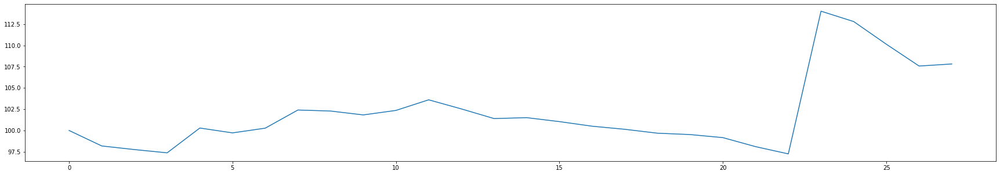

profit: 44.09026594337692
max loss: -5.8022925883239225
max profit: 40.26240245349895
transaction count: 40
loss count: 20
profit count: 20
profit percentage: 44.09026594337692
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


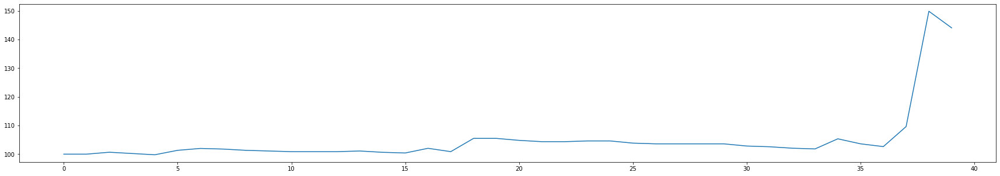

profit: 7.70552885712938
max loss: -2.1063543878002235
max profit: 6.036155865353749
transaction count: 27
loss count: 14
profit count: 13
profit percentage: 7.705528857129379
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


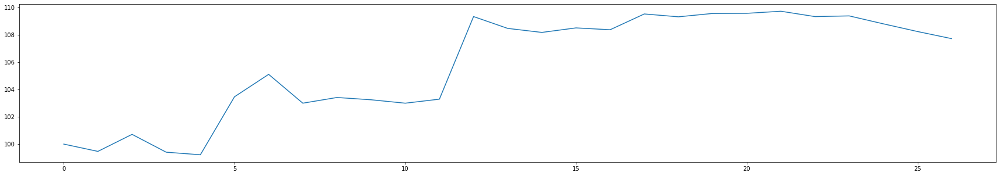

profit: -0.6373103385575831
max loss: -2.065706600363569
max profit: 5.082655900410401
transaction count: 46
loss count: 32
profit count: 14
profit percentage: -0.6373103385575831
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


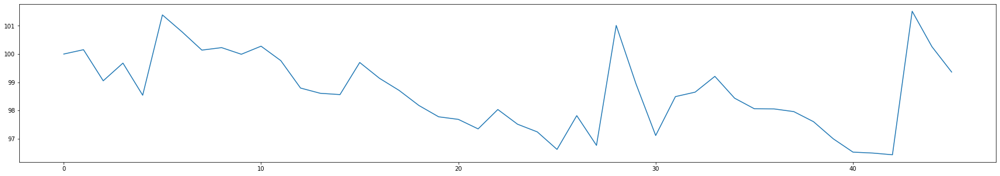

profit: 18.207728585295925
max loss: -3.2848442490173255
max profit: 32.16534693167439
transaction count: 37
loss count: 24
profit count: 13
profit percentage: 18.207728585295925
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


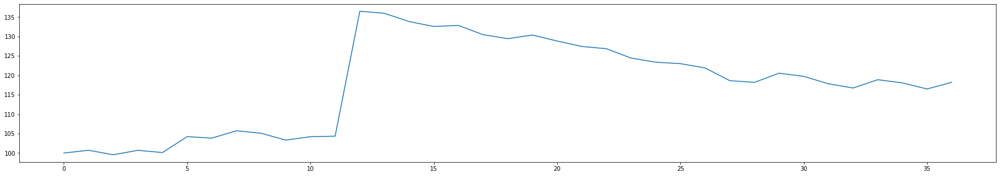

profit: 12.240519099885148
max loss: -3.0240272510787776
max profit: 15.982931375679925
transaction count: 27
loss count: 18
profit count: 9
profit percentage: 12.240519099885148
Hodl strategy expected return of MOBUSDT: -45.26532479414456


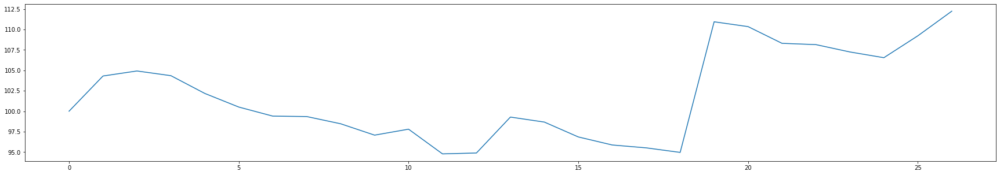

profit: 12.259934121062372
max loss: -1.2902493798573715
max profit: 7.100531044620368
transaction count: 35
loss count: 19
profit count: 16
profit percentage: 12.259934121062372
Hodl strategy expected return of NUUSDT: -2.4582809976673325


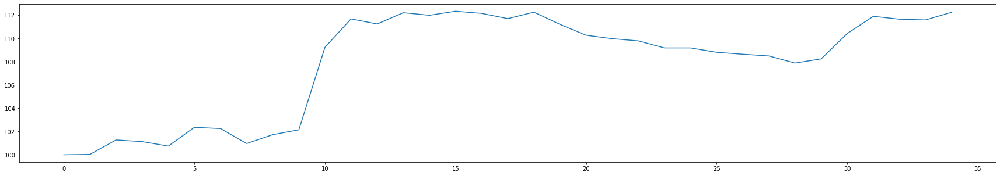

profit: 5.855678691721366
max loss: -1.3770366100224862
max profit: 5.8468509360778995
transaction count: 21
loss count: 12
profit count: 9
profit percentage: 5.855678691721367
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


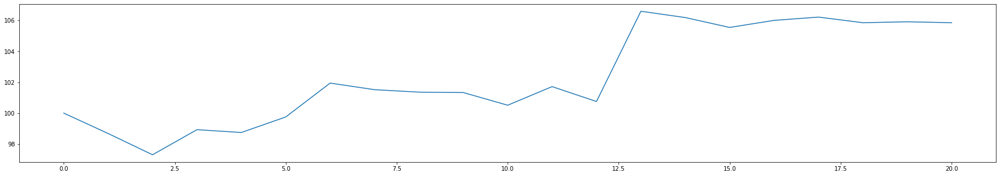

profit: 101.63913534245825
max loss: -3.6588517576415427
max profit: 34.87541198934717
transaction count: 30
loss count: 13
profit count: 17
profit percentage: 101.63913534245825
Hodl strategy expected return of STORMUSDT: 81.46367521367522


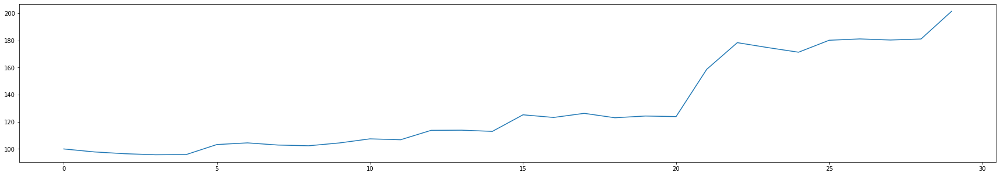

profit: 30.41739481531667
max loss: -4.122104150775556
max profit: 10.684661125361245
transaction count: 44
loss count: 24
profit count: 20
profit percentage: 30.41739481531667
Hodl strategy expected return of STRATUSDT: 28.24267782426778


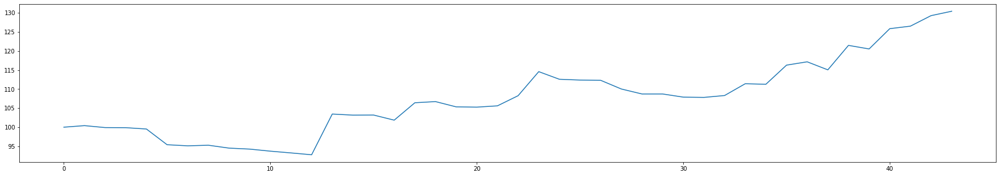

profit: 42.03985087047698
max loss: -3.0860290592284514
max profit: 14.954904376027102
transaction count: 30
loss count: 15
profit count: 15
profit percentage: 42.03985087047698
Hodl strategy expected return of TRXUSDT: 21.927066960075457


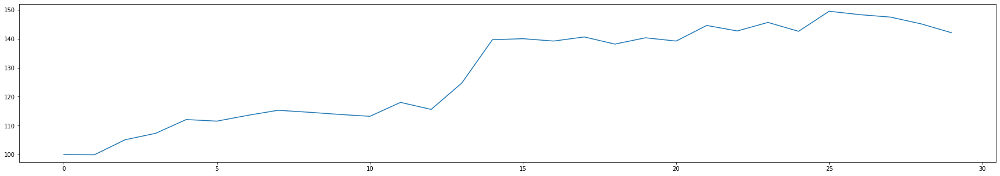

cumulative profit percentage: 320.23916195430735
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 293
cumulative profit count: 201
(profit count / loss count) ratio: 0.6860068259385665


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + psar & determine via ema

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["ema"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 8.940134573511529
max loss: -2.3206331259428055
max profit: 7.4174984844857335
transaction count: 46
loss count: 27
profit count: 19
profit percentage: 8.940134573511529
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


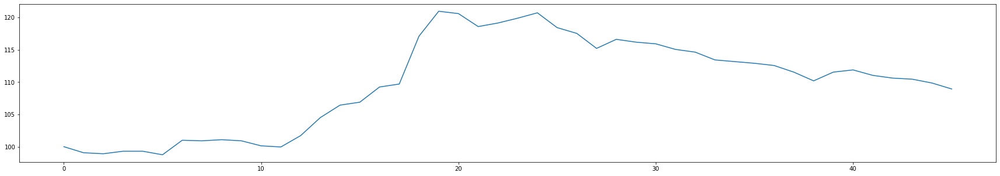

profit: 16.89094293738755
max loss: -2.5613853320562043
max profit: 11.36361517448421
transaction count: 25
loss count: 15
profit count: 10
profit percentage: 16.89094293738755
Hodl strategy expected return of APEUSDT: -57.663335972000255


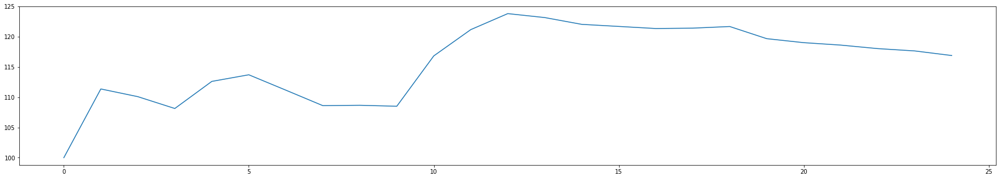

profit: 17.357654094962456
max loss: -7.335129229977909
max profit: 17.835709517860835
transaction count: 36
loss count: 22
profit count: 14
profit percentage: 17.357654094962456
Hodl strategy expected return of BEARUSDT: -32.7710843373494


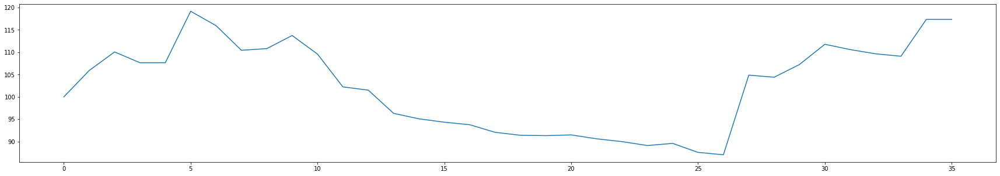

profit: 54.7968303539252
max loss: -4.985619758191973
max profit: 19.65788442480971
transaction count: 38
loss count: 20
profit count: 18
profit percentage: 54.796830353925195
Hodl strategy expected return of BULLUSDT: 5.791070587599496


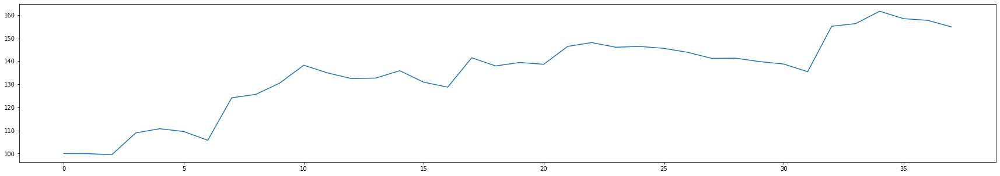

profit: 16.309524810974892
max loss: -2.7017616486999856
max profit: 17.168376665054154
transaction count: 26
loss count: 14
profit count: 12
profit percentage: 16.309524810974892
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


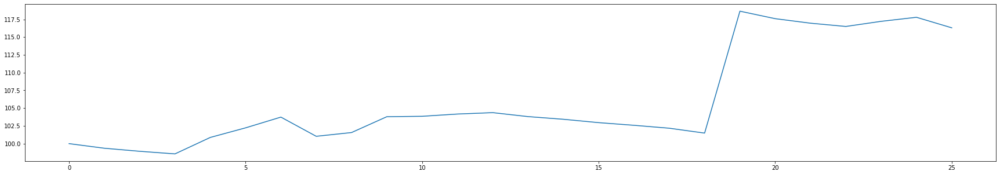

profit: 56.17821500954034
max loss: -5.056090762870355
max profit: 41.95078267246552
transaction count: 37
loss count: 12
profit count: 25
profit percentage: 56.17821500954034
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


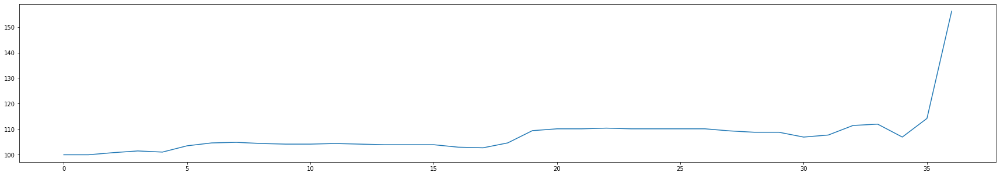

profit: 8.887646824135842
max loss: -1.7855613707973532
max profit: 6.016794103041633
transaction count: 27
loss count: 13
profit count: 14
profit percentage: 8.887646824135842
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


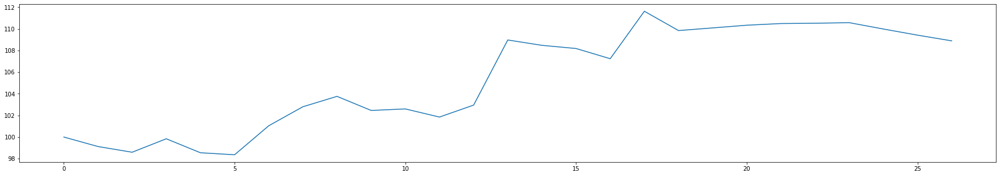

profit: 20.663557815263616
max loss: -2.272905970639485
max profit: 11.952491938671812
transaction count: 45
loss count: 20
profit count: 25
profit percentage: 20.663557815263616
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


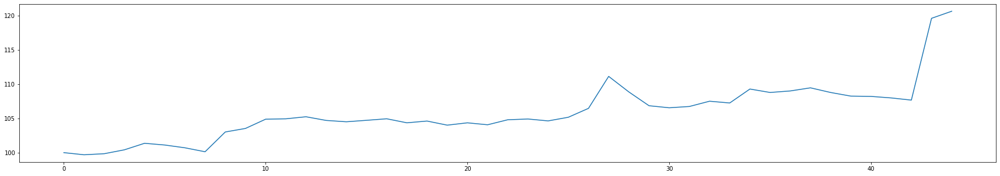

profit: 37.27774009147433
max loss: -2.506409045082137
max profit: 32.680817198730736
transaction count: 32
loss count: 20
profit count: 12
profit percentage: 37.27774009147433
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


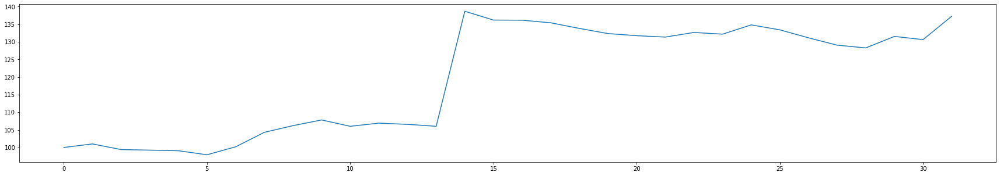

profit: 11.72002185718081
max loss: -2.7772499119519836
max profit: 14.367967532784476
transaction count: 28
loss count: 19
profit count: 9
profit percentage: 11.72002185718081
Hodl strategy expected return of MOBUSDT: -45.26532479414456


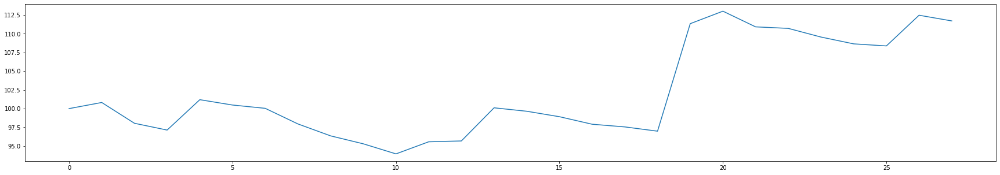

profit: 19.572203486667178
max loss: -1.337092374213242
max profit: 7.7277461349505785
transaction count: 34
loss count: 13
profit count: 21
profit percentage: 19.572203486667178
Hodl strategy expected return of NUUSDT: -2.4582809976673325


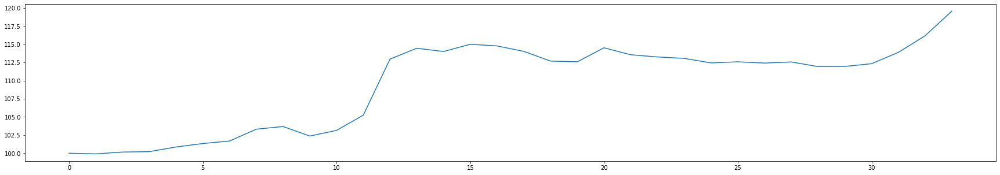

profit: 9.380484260740971
max loss: -1.3210368893319924
max profit: 6.0277666778609245
transaction count: 23
loss count: 13
profit count: 10
profit percentage: 9.380484260740971
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


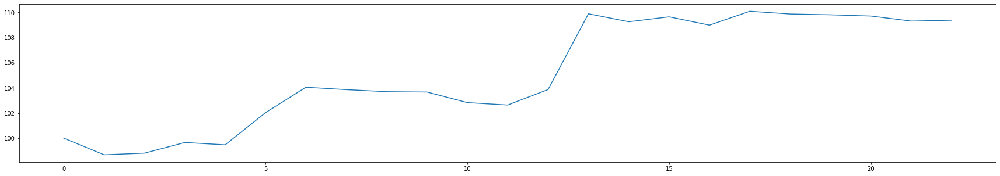

profit: 122.50144550853801
max loss: -5.98809204647452
max profit: 50.691824750425894
transaction count: 30
loss count: 14
profit count: 16
profit percentage: 122.50144550853801
Hodl strategy expected return of STORMUSDT: 81.46367521367522


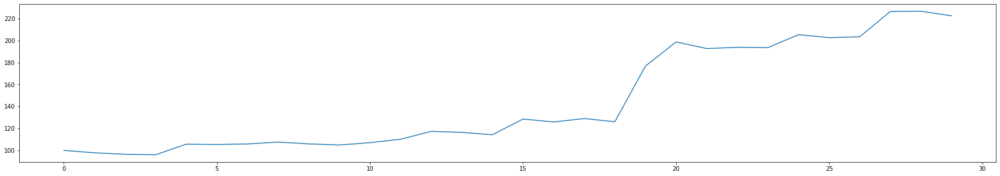

profit: 34.18514894527675
max loss: -5.046984836226443
max profit: 8.04747032082787
transaction count: 37
loss count: 15
profit count: 22
profit percentage: 34.18514894527675
Hodl strategy expected return of STRATUSDT: 28.24267782426778


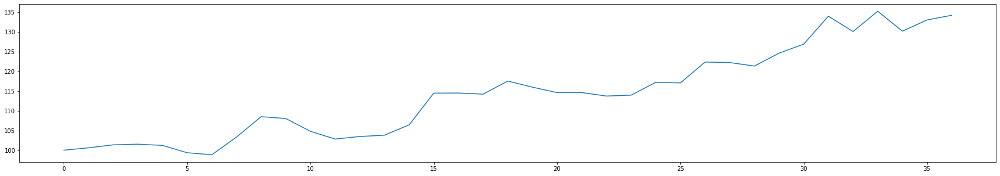

profit: 69.09858210025448
max loss: -2.541727931253291
max profit: 15.931947907386046
transaction count: 33
loss count: 13
profit count: 20
profit percentage: 69.09858210025448
Hodl strategy expected return of TRXUSDT: 21.927066960075457


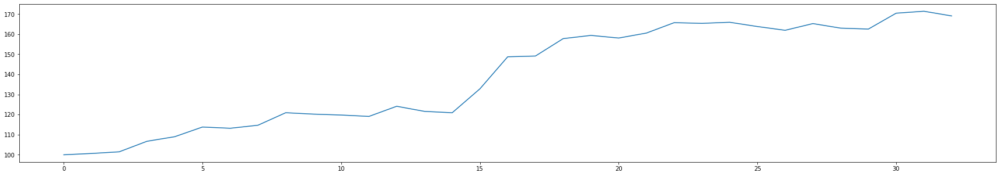

cumulative profit percentage: 503.76013266983387
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 250
cumulative profit count: 247
(profit count / loss count) ratio: 0.988


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via wma + macd & determine via ema

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["wma"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["ema"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: -0.22727296531483887
max loss: -1.8512436175795415
max profit: 6.815178217646448
transaction count: 41
loss count: 26
profit count: 15
profit percentage: -0.22727296531483887
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


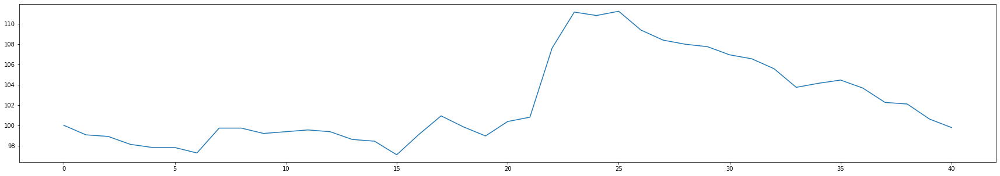

profit: 5.405088495166041
max loss: -2.2759876255192353
max profit: 7.552300502917419
transaction count: 29
loss count: 17
profit count: 12
profit percentage: 5.405088495166041
Hodl strategy expected return of APEUSDT: -57.663335972000255


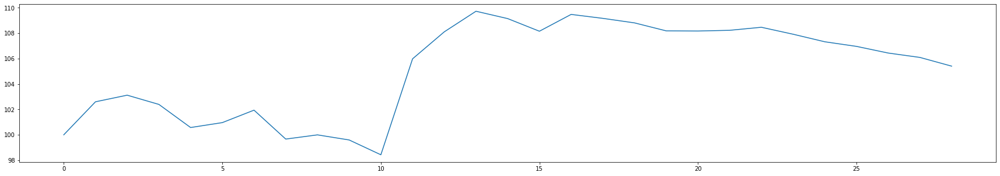

profit: 11.768308838191516
max loss: -7.2319470747303
max profit: 17.0648968504411
transaction count: 31
loss count: 20
profit count: 11
profit percentage: 11.768308838191516
Hodl strategy expected return of BEARUSDT: -32.7710843373494


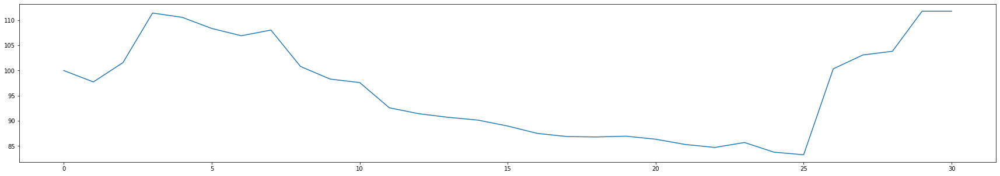

profit: 38.06577000186198
max loss: -8.507815421881872
max profit: 17.53592792569171
transaction count: 31
loss count: 19
profit count: 12
profit percentage: 38.06577000186198
Hodl strategy expected return of BULLUSDT: 5.791070587599496


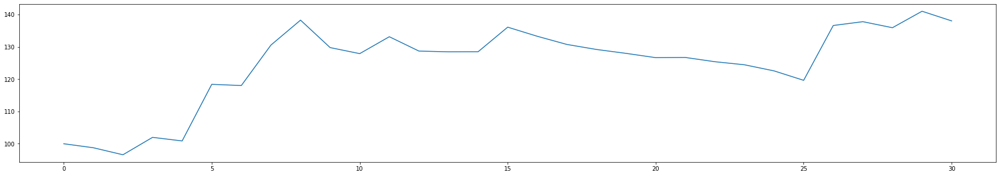

profit: 8.072118518773436
max loss: -2.566992526805734
max profit: 16.42254959737842
transaction count: 27
loss count: 18
profit count: 9
profit percentage: 8.072118518773436
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


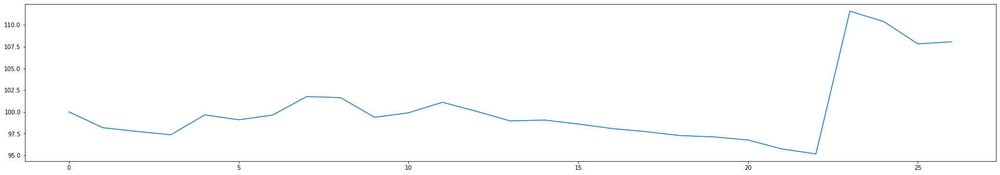

profit: 43.69880144217487
max loss: -5.786528917134575
max profit: 40.153017539879244
transaction count: 43
loss count: 20
profit count: 23
profit percentage: 43.69880144217487
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


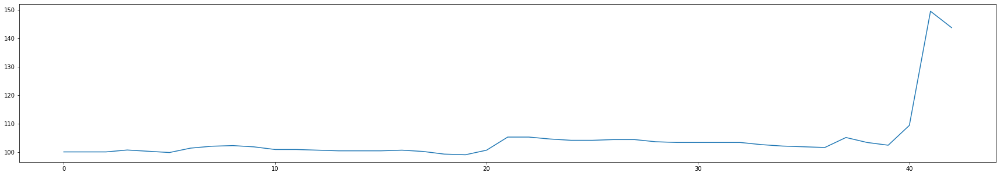

profit: 4.776820198710936
max loss: -2.088136393479644
max profit: 5.954479315151104
transaction count: 29
loss count: 16
profit count: 13
profit percentage: 4.776820198710936
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


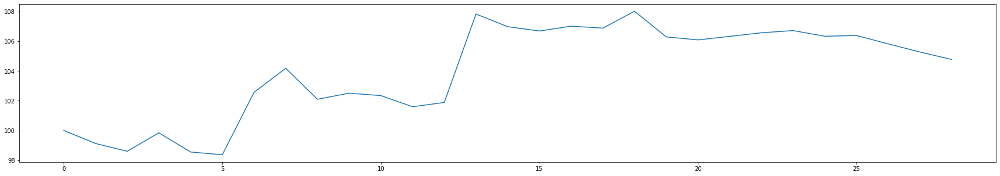

profit: 0.5234789169658427
max loss: -2.0899582835162107
max profit: 5.1420332419338735
transaction count: 46
loss count: 31
profit count: 15
profit percentage: 0.5234789169658427
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


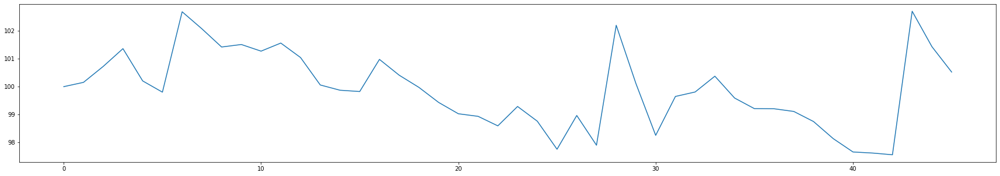

profit: 26.206412346966644
max loss: -2.3771915170950706
max profit: 32.16534693167439
transaction count: 33
loss count: 20
profit count: 13
profit percentage: 26.206412346966644
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


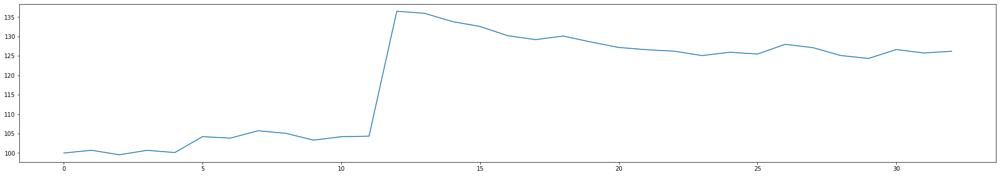

profit: 13.071701277966895
max loss: -2.7772499119519836
max profit: 16.131030941268847
transaction count: 31
loss count: 21
profit count: 10
profit percentage: 13.071701277966895
Hodl strategy expected return of MOBUSDT: -45.26532479414456


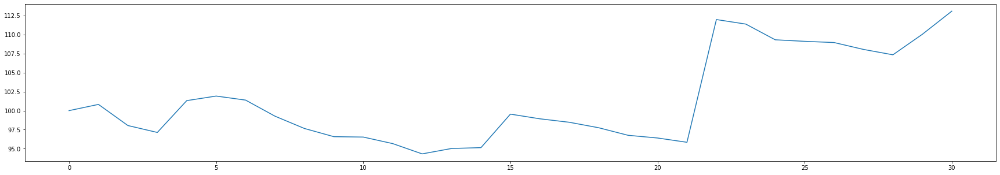

profit: 14.213721419028033
max loss: -1.2902493798573715
max profit: 7.100531044620368
transaction count: 37
loss count: 18
profit count: 19
profit percentage: 14.213721419028033
Hodl strategy expected return of NUUSDT: -2.4582809976673325


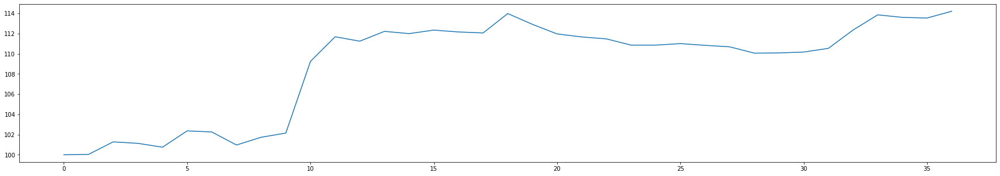

profit: 7.713831381605985
max loss: -1.3210368893319924
max profit: 5.981533307330125
transaction count: 21
loss count: 11
profit count: 10
profit percentage: 7.713831381605985
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


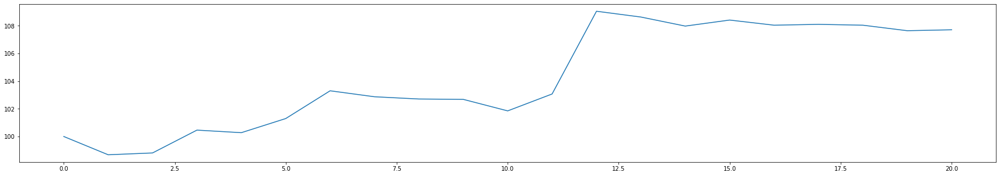

profit: 106.4843085485007
max loss: -3.6588517576415427
max profit: 34.87541198934717
transaction count: 29
loss count: 12
profit count: 17
profit percentage: 106.4843085485007
Hodl strategy expected return of STORMUSDT: 81.46367521367522


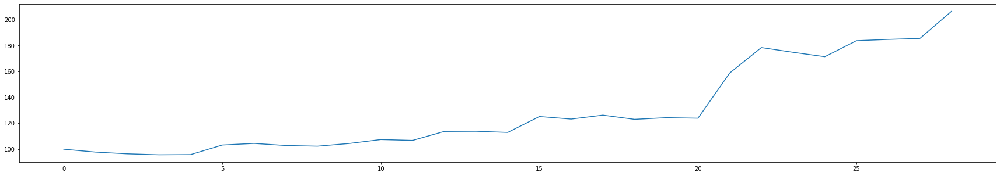

profit: 34.41295737382384
max loss: -4.14431316870342
max profit: 10.88777993118893
transaction count: 39
loss count: 19
profit count: 20
profit percentage: 34.41295737382384
Hodl strategy expected return of STRATUSDT: 28.24267782426778


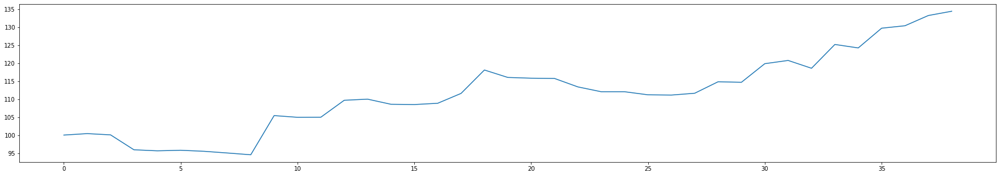

profit: 44.53951818342114
max loss: -3.0760027119416975
max profit: 14.954904376027102
transaction count: 30
loss count: 15
profit count: 15
profit percentage: 44.53951818342113
Hodl strategy expected return of TRXUSDT: 21.927066960075457


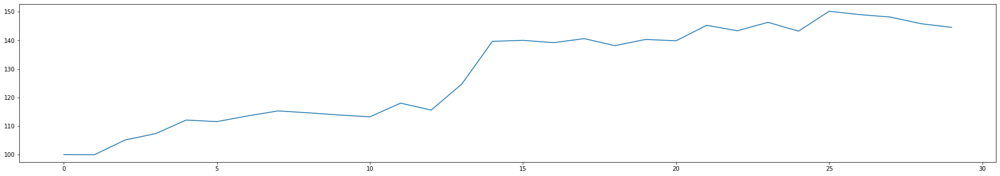

cumulative profit percentage: 358.72556397784297
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 283
cumulative profit count: 214
(profit count / loss count) ratio: 0.7561837455830389


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + psar & determine via ema

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_psar = df2["psar"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_psar < curr_ha_close and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["ema"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 3.1607871605178275
max loss: -2.582476907931337
max profit: 7.301801326770388
transaction count: 44
loss count: 27
profit count: 17
profit percentage: 3.1607871605178275
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


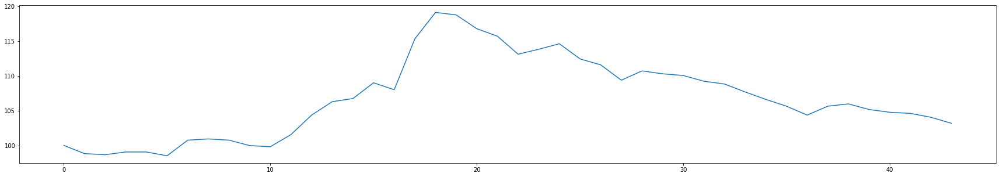

profit: 18.016816273703768
max loss: -2.5363493325817217
max profit: 11.36361517448421
transaction count: 16
loss count: 9
profit count: 7
profit percentage: 18.016816273703768
Hodl strategy expected return of APEUSDT: -57.663335972000255


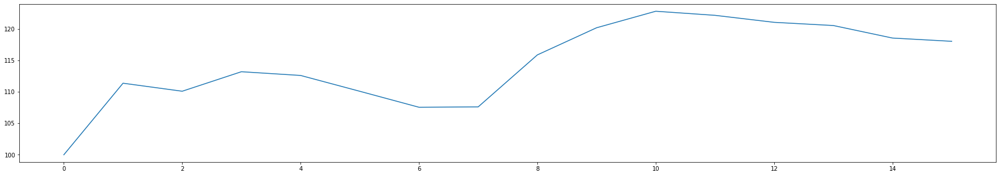

profit: 20.77664937764591
max loss: -7.544635500448621
max profit: 18.47782916750515
transaction count: 34
loss count: 20
profit count: 14
profit percentage: 20.77664937764591
Hodl strategy expected return of BEARUSDT: -32.7710843373494


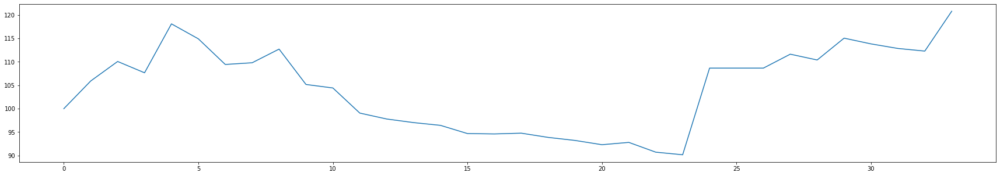

profit: 42.25008752386802
max loss: -4.603510096178056
max profit: 16.543268776760627
transaction count: 34
loss count: 18
profit count: 16
profit percentage: 42.25008752386802
Hodl strategy expected return of BULLUSDT: 5.791070587599496


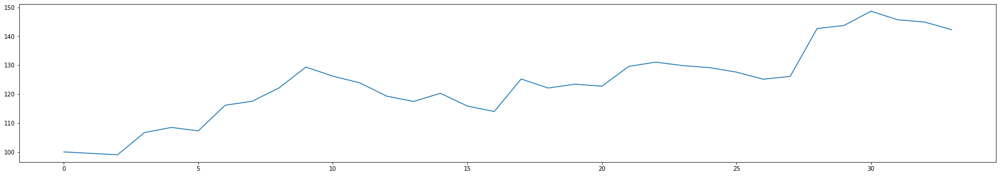

profit: 18.228094017879087
max loss: -2.7355293334644273
max profit: 17.451575473196797
transaction count: 23
loss count: 10
profit count: 13
profit percentage: 18.228094017879087
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


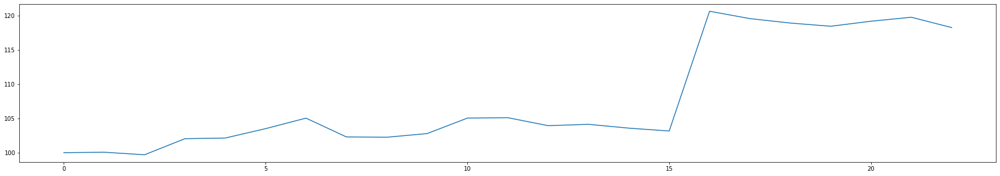

profit: 56.69467461826727
max loss: -5.072810550946556
max profit: 42.089508068984415
transaction count: 28
loss count: 8
profit count: 20
profit percentage: 56.69467461826727
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


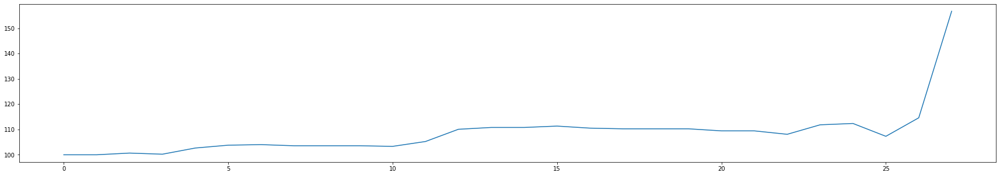

profit: 14.074654089147401
max loss: -1.344846010583126
max profit: 6.219330765142615
transaction count: 22
loss count: 9
profit count: 13
profit percentage: 14.074654089147403
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


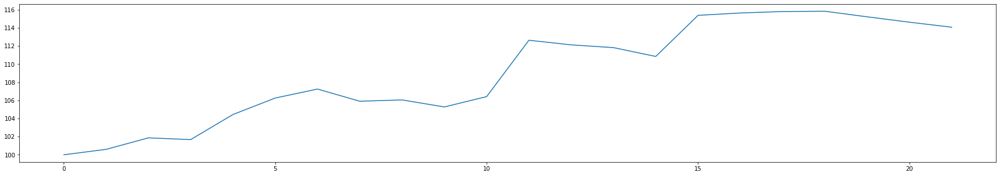

profit: 21.87774275382553
max loss: -2.2956460932464466
max profit: 12.07276467016574
transaction count: 41
loss count: 17
profit count: 24
profit percentage: 21.87774275382553
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


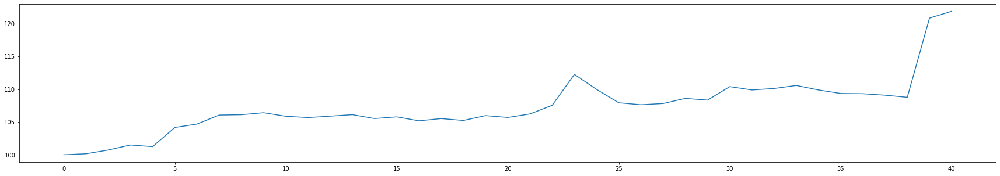

profit: 38.19312746654785
max loss: -3.1218037326114825
max profit: 32.680817198730736
transaction count: 31
loss count: 19
profit count: 12
profit percentage: 38.19312746654785
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


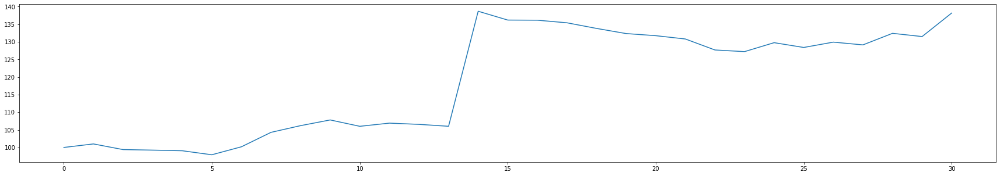

profit: 13.22879450594634
max loss: -2.502952299605113
max profit: 14.856462284299425
transaction count: 21
loss count: 14
profit count: 7
profit percentage: 13.22879450594634
Hodl strategy expected return of MOBUSDT: -45.26532479414456


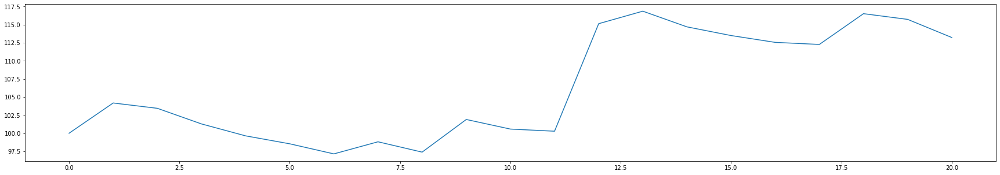

profit: 13.44824303773251
max loss: -1.3129033940383437
max profit: 7.643280186531584
transaction count: 39
loss count: 18
profit count: 21
profit percentage: 13.448243037732508
Hodl strategy expected return of NUUSDT: -2.4582809976673325


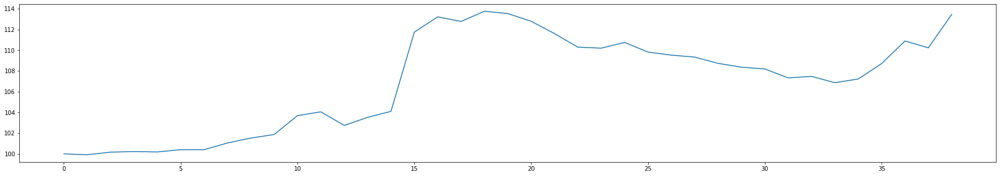

profit: 8.903812461491825
max loss: -1.3770366100224862
max profit: 5.928488358717004
transaction count: 18
loss count: 11
profit count: 7
profit percentage: 8.903812461491825
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


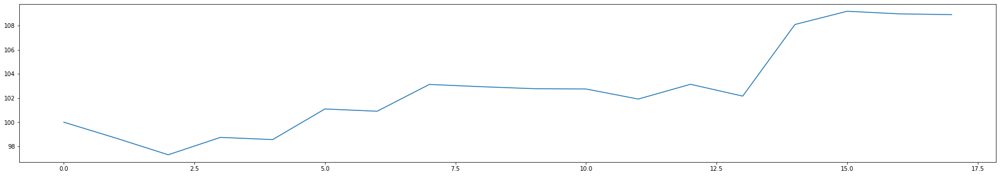

profit: 125.68703202545478
max loss: -6.221466833193347
max profit: 52.66744464699778
transaction count: 32
loss count: 15
profit count: 17
profit percentage: 125.6870320254548
Hodl strategy expected return of STORMUSDT: 81.46367521367522


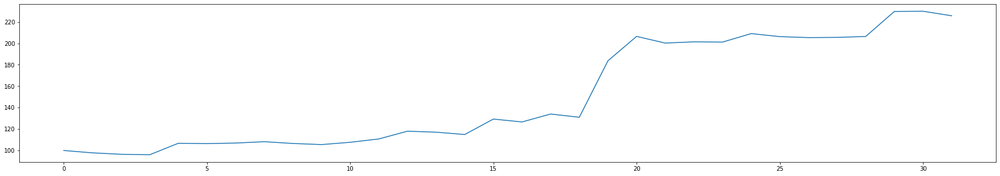

profit: 37.550127819179465
max loss: -3.8386672891931823
max profit: 7.941354036873733
transaction count: 36
loss count: 15
profit count: 21
profit percentage: 37.550127819179465
Hodl strategy expected return of STRATUSDT: 28.24267782426778


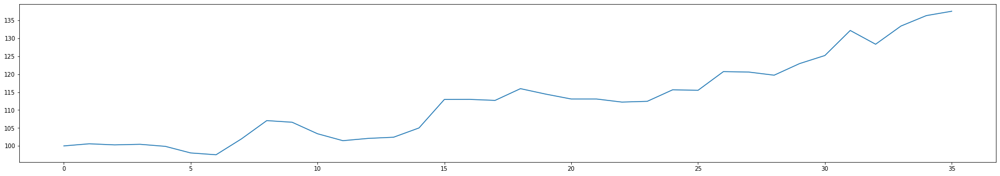

profit: 54.63408063602182
max loss: -2.6666281194350745
max profit: 15.343169319657065
transaction count: 33
loss count: 14
profit count: 19
profit percentage: 54.63408063602182
Hodl strategy expected return of TRXUSDT: 21.927066960075457


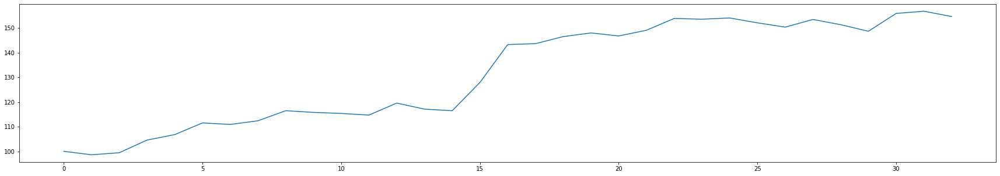

cumulative profit percentage: 486.7247237672294
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 224
cumulative profit count: 228
(profit count / loss count) ratio: 1.0178571428571428


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

### eliminate via ema + macd & determine via ema

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
                
        curr_macd = df2["macd_hist"][index]
        curr_ma = df2["ema"][index]
            
        ready = True if curr_macd > 0 and curr_ma < curr_ha_close else False
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    curr_ma = df1["ema"][index]
    
    return True if curr_ma < curr_ha_close else False
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


profit: 0.14096227587786814
max loss: -1.8580760773136404
max profit: 6.8403312716856846
transaction count: 38
loss count: 25
profit count: 13
profit percentage: 0.14096227587786814
Hodl strategy expected return of 1INCHUSDT: 5.693664795509218


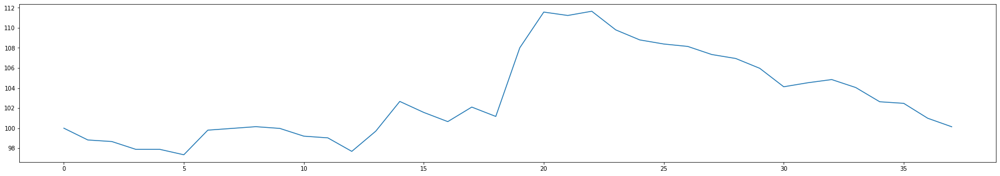

profit: 5.665793892938154
max loss: -2.253741216795291
max profit: 7.567032249004555
transaction count: 17
loss count: 10
profit count: 7
profit percentage: 5.665793892938154
Hodl strategy expected return of APEUSDT: -57.663335972000255


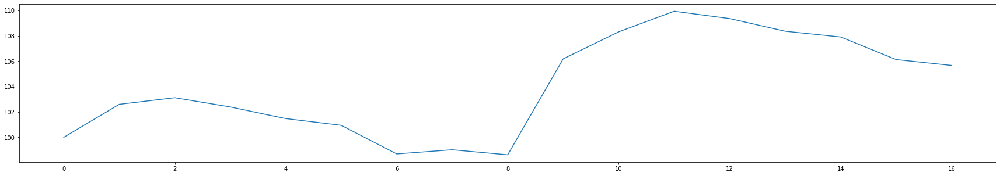

profit: 9.347787857247994
max loss: -6.850405502442371
max profit: 16.695329293290982
transaction count: 28
loss count: 19
profit count: 9
profit percentage: 9.347787857247994
Hodl strategy expected return of BEARUSDT: -32.7710843373494


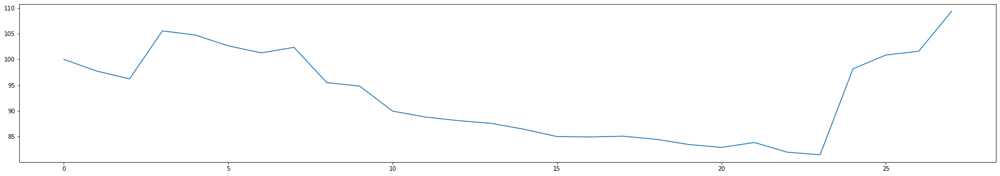

profit: 31.591525435876747
max loss: -7.669599484047339
max profit: 15.103327421425448
transaction count: 27
loss count: 15
profit count: 12
profit percentage: 31.591525435876747
Hodl strategy expected return of BULLUSDT: 5.791070587599496


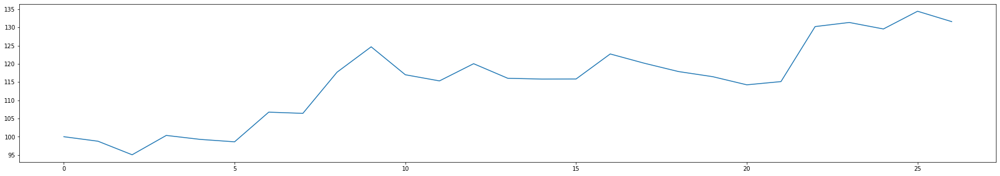

profit: 12.457502119116796
max loss: -2.784296191642227
max profit: 17.20896766475093
transaction count: 22
loss count: 11
profit count: 11
profit percentage: 12.457502119116796
Hodl strategy expected return of ERDUSDT: 2.2515044615065203


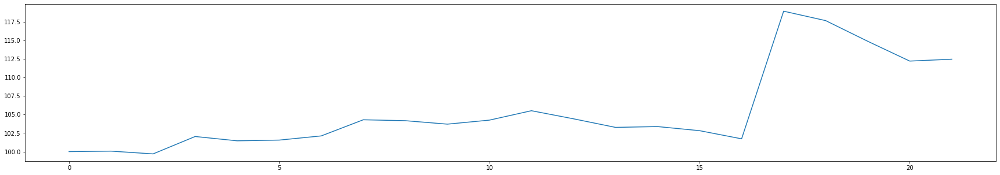

profit: 45.89291234169497
max loss: -5.874882376175634
max profit: 40.766106671790496
transaction count: 33
loss count: 15
profit count: 18
profit percentage: 45.89291234169497
Hodl strategy expected return of FORTHUSDT: 10.408163265306117


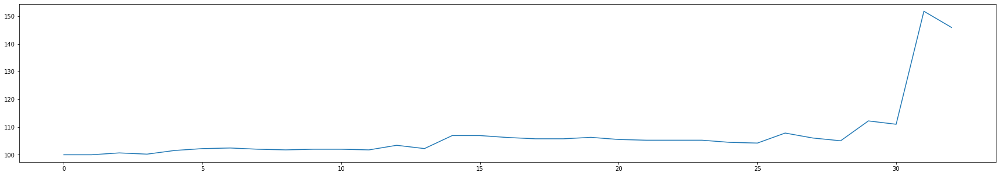

profit: 10.39868619674877
max loss: -2.1584270113575457
max profit: 6.154918343707919
transaction count: 23
loss count: 10
profit count: 13
profit percentage: 10.39868619674877
Hodl strategy expected return of GLMRUSDT: -34.81445312499999


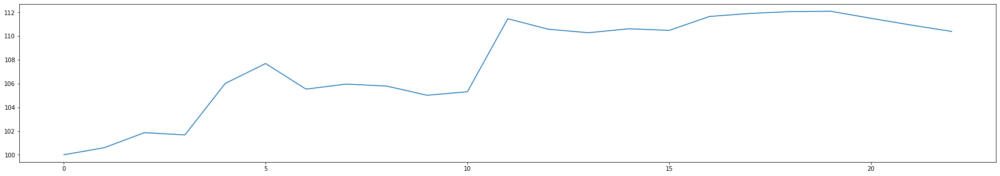

profit: 0.8492775936011299
max loss: -2.0966121094026704
max profit: 5.158698678143267
transaction count: 46
loss count: 31
profit count: 15
profit percentage: 0.8492775936011299
Hodl strategy expected return of GXSUSDT: 3.1242807825086314


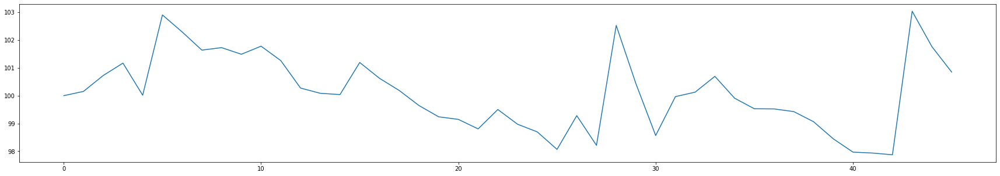

profit: 23.466042596436694
max loss: -3.3259315116099657
max profit: 32.16534693167439
transaction count: 36
loss count: 22
profit count: 14
profit percentage: 23.46604259643669
Hodl strategy expected return of KEEPUSDT: 22.209188660801573


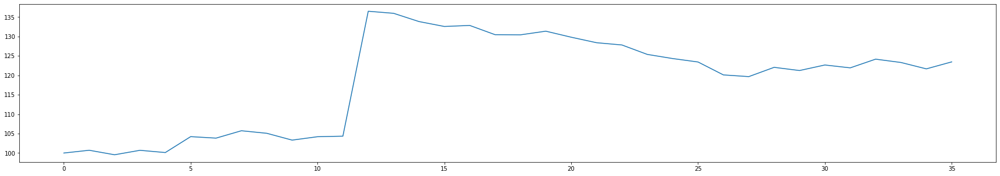

profit: 11.29868451301293
max loss: -3.0406839696195647
max profit: 16.177110193748874
transaction count: 25
loss count: 17
profit count: 8
profit percentage: 11.29868451301293
Hodl strategy expected return of MOBUSDT: -45.26532479414456


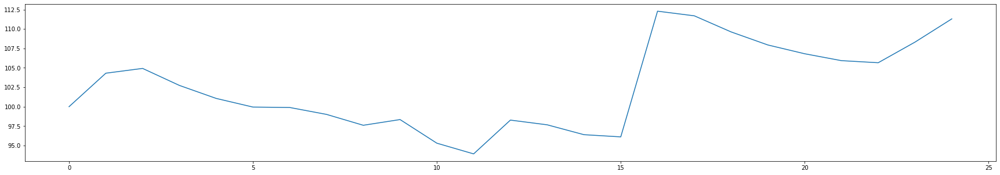

profit: 11.71432754833404
max loss: -1.2902493798573715
max profit: 7.100531044620368
transaction count: 36
loss count: 20
profit count: 16
profit percentage: 11.71432754833404
Hodl strategy expected return of NUUSDT: -2.4582809976673325


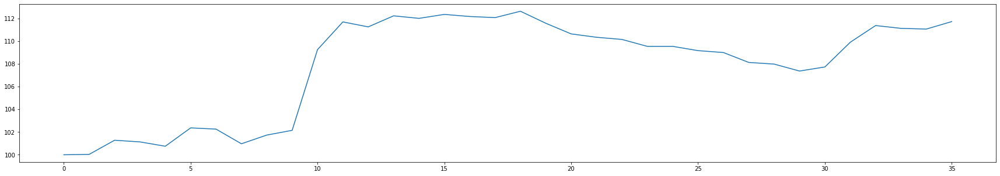

profit: 6.048491845158168
max loss: -1.3770366100224862
max profit: 5.8249085106481715
transaction count: 20
loss count: 12
profit count: 8
profit percentage: 6.048491845158168
Hodl strategy expected return of SCRTUSDT: -36.46607528170703


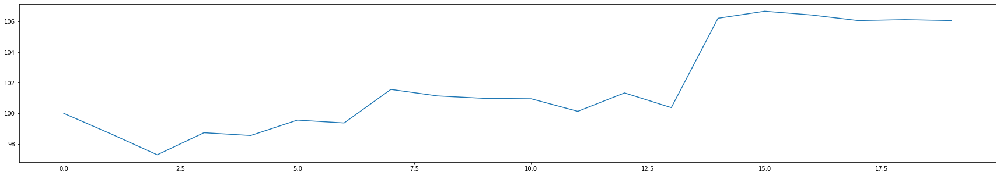

profit: 96.15531291736818
max loss: -3.6588517576415427
max profit: 34.87541198934717
transaction count: 31
loss count: 14
profit count: 17
profit percentage: 96.15531291736818
Hodl strategy expected return of STORMUSDT: 81.46367521367522


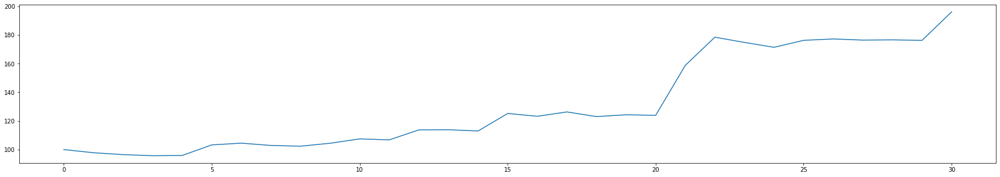

profit: 32.533961710041666
max loss: -4.14431316870342
max profit: 10.858064374608176
transaction count: 40
loss count: 20
profit count: 20
profit percentage: 32.533961710041666
Hodl strategy expected return of STRATUSDT: 28.24267782426778


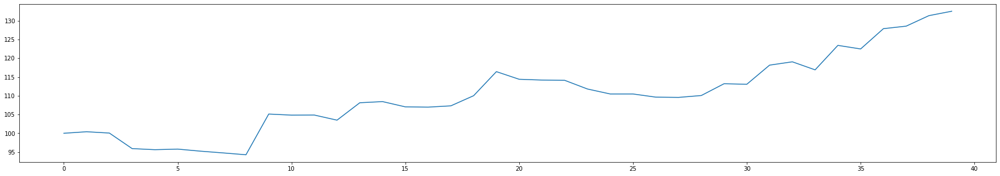

profit: 42.03985087047698
max loss: -3.0860290592284514
max profit: 14.954904376027102
transaction count: 30
loss count: 15
profit count: 15
profit percentage: 42.03985087047698
Hodl strategy expected return of TRXUSDT: 21.927066960075457


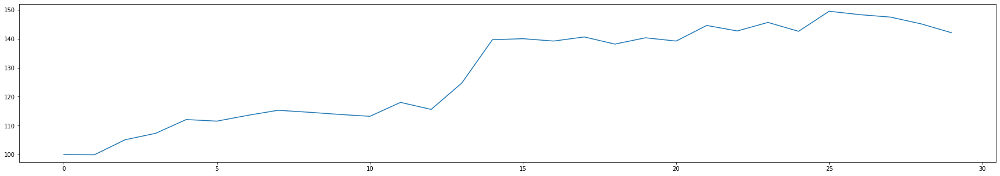

cumulative profit percentage: 339.60111971393115
cumulative hodl return percentage: -28.327261956618585
cumulative loss count: 256
cumulative profit count: 196
(profit count / loss count) ratio: 0.765625


In [ ]:
for i in range(len(dataframes_15m)):
    flow(dataframes_15m[i], dataframes_1h[i])
    time.sleep(1)
    
print("cumulative profit percentage: {}".format(cum_profit_percentage))
print("cumulative hodl return percentage: {}".format(cum_hodl_return_percentage))
print("cumulative loss count: {}".format(cum_loss_count))
print("cumulative profit count: {}".format(cum_profit_count))
print("(profit count / loss count) ratio: {}".format(cum_profit_count / cum_loss_count))

# BACKETSTING TEMPLATES

In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]    
    
    return True
    
    
def flow(df1):    
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count    
    
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    
    for index in range(len(df1["closes"])):        
        curr_close = df1["closes"][index]                 
              
        if not in_position:                  
            if determinator(df1, index):
                bought_at = curr_close
                in_position = True                    
        else:
            if not determinator(df1, index):
                sold_at = curr_close
                in_position = False                        

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)                                            
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()


In [ ]:
cum_profit_percentage = 0
cum_hodl_return_percentage = 0
cum_loss_count = 0
cum_profit_count = 0

ready = bool()

def eliminator(df2, curr_time):   
    global ready 
    if curr_time in df2["times"].values:        
        index = df2.index[df2['times'] == curr_time].tolist()[0]
        curr_ha_close = df2["ha_closes"][index]
            
        ready = True
                    
    return ready

def determinator(df1, index):
    curr_ha_close = df1["ha_closes"][index]
    
    return True
    

def flow(df1, df2):
    global cum_profit_percentage
    global cum_hodl_return_percentage
    global cum_loss_count
    global cum_profit_count
    
    global ready  
    curr_wallet = 100
    wallet_list = [curr_wallet]    
    in_position = False
    ready = False
    
    for index in range(len(df1["closes"])):
        curr_time = df1["times"][index]  
        curr_close = df1["closes"][index] 
        
        ready = eliminator(df2, curr_time)
        
        if ready == True:            
            if not in_position:                  
                if determinator(df1, index):
                    bought_at = curr_close
                    in_position = True                    
            else:
                if not determinator(df1, index):
                    sold_at = curr_close
                    in_position = False

                    curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet
                    
                    curr_wallet += curr_profit
                    wallet_list.append(curr_wallet)
        else:
            if in_position:
                sold_at = curr_close
                in_position = False

                curr_profit = ((sold_at - bought_at) / bought_at) * curr_wallet                
                
                curr_wallet += curr_profit
                wallet_list.append(curr_wallet)
    
    profit = wallet_list[-1] - wallet_list[0]
    wallet_change_list = [x - wallet_list[i - 1] for i, x in enumerate(wallet_list)][1:]
    max_loss = min(wallet_change_list)
    max_prof = max(wallet_change_list)
    transaction_count = len(wallet_list)
    loss_count = len([x for x in wallet_change_list if x < 0])
    profit_count = transaction_count - loss_count
    profit_percentage = (100 * (wallet_list[-1] - wallet_list[0])) / wallet_list[0]
    hodl_return_percentage = (100 * (df1["closes"].iloc[-1] - df1["closes"].iloc[0])) / df1["closes"].iloc[0]
    
    print("profit: {}".format(profit))
    print("max loss: {}".format(max_loss))
    print("max profit: {}".format(max_prof))
    print("transaction count: {}".format(transaction_count))
    print("loss count: {}".format(loss_count))
    print("profit count: {}".format(profit_count))
    print("profit percentage: {}".format(profit_percentage))
    print("Hodl strategy expected return of {}: {}".format(df1.name.split("_")[-1], hodl_return_percentage))
    
    cum_profit_percentage += profit_percentage
    cum_hodl_return_percentage += hodl_return_percentage
    cum_loss_count += loss_count
    cum_profit_count += profit_count
    
    plt.plot(wallet_list)
    plt.show()
